In [1]:
import numpy as np
import logging
import sys
import matplotlib.pyplot as plt
import matplotlib as mpl
mpl.rcParams['axes.formatter.useoffset'] = False
import scipy.signal as sps
from pprint import pprint

sys.path.insert(1, '/home/jsipple/one_d_spherical_collapse/one-d-spherical-collapse-of-fuzzy-dark-matter/')
sys.path.insert(1, '/home/jsipple/one_d_spherical_collapse/one-d-spherical-collapse-of-fuzzy-dark-matter/src')
import importlib
import simulation_strategies, collapse, plotting, utils, analtyic_formulas
importlib.reload(simulation_strategies)
importlib.reload(collapse)
importlib.reload(plotting)
importlib.reload(utils)
importlib.reload(analtyic_formulas)
from simulation_strategies import *
from collapse import *
from plotting import *
from utils import *
from analtyic_formulas import *
import cProfile
import pstats

import warnings
warnings.filterwarnings('ignore', category=np.VisibleDeprecationWarning)

import faulthandler
faulthandler.enable(all_threads=True)

In [2]:
# Default plotting settings
def my_mpl():
    plt.rc('font', family='serif', size=20)
    plt.rc('axes', grid=True)
    plt.rc('lines', lw=3)
    ts = 8
    plt.rc('xtick.minor', size=ts-2)
    plt.rc('ytick.minor', size=ts-2)
    plt.rc('xtick.major', size=ts)
    plt.rc('ytick.major', size=ts)
    plt.rc('figure', figsize=[9, 5])
my_mpl()
logging.basicConfig(level=logging.DEBUG,
                    format='%(asctime)s - %(levelname)s - %(message)s')
logger = logging.getLogger(__name__)
logging.getLogger('matplotlib').setLevel(logging.ERROR)

In [3]:
t_i = 1
G = 1
rho_H = 1/(6*np.pi*G*t_i**2)
H0 = 2/(3*t_i)

def compute_r0_min(r_min, r_max, N):
    """
    Compute r0_min such that the spacing dR in np.linspace(r0_min, r_max, N)
    satisfies dR = r0_min - r_min. That is, the inner edge of the innermost shell is at r_min.
    
    Parameters:
    - r_min (float): The minimum radius.
    - r_max (float): The maximum radius.
    - N (int): Number of points.
    
    Returns:
    - float: The computed r0_min.
    """
    return (r_max + r_min * (N - 1)) / N

def make_config(no_pm=False, **kwargs):
    # Set defaults directly in kwargs
    kwargs.setdefault('r_min', 0)
    kwargs.setdefault('r_max', 1)
    kwargs.setdefault('N', 1)
    kwargs.setdefault('H', 0)
    kwargs.setdefault('rho_bar', rho_H)
    kwargs.setdefault('delta', 0)
    kwargs.setdefault('j_coef', 0)
    kwargs.setdefault('r_min_strategy', 'nothing')
    kwargs.setdefault('t_max', 5000)
    kwargs.setdefault('dt_min', 0)
    kwargs.setdefault('stepper_strategy', 'leapfrog_kdk')
    kwargs.setdefault('timescale_strategy', 'dyn')
    kwargs.setdefault('save_strategy', 'vflip')
    kwargs.setdefault('safety_factor', 1e-2)
    kwargs.setdefault('save_dt', 1e-2)
    kwargs.setdefault('initial_radius_strategy', 'r0min_start_equal')
    kwargs.setdefault('m_enc_strategy', 'inclusive')
    kwargs.setdefault('density_strategy', 'background_plus_tophat2')
    kwargs.setdefault('timestep_strategy', 'simple_adaptive')
    kwargs.setdefault('problematic_shell_strategy', 'energy')
    kwargs.setdefault('energy_strategy', 'kin_grav_rot_absorbed')
    
    # Set r_th default after r_max is set
    kwargs.setdefault('tophat_radius', kwargs['r_max'])

    # Extract values for computation
    r_min = kwargs['r_min']
    r_max = kwargs['r_max']
    N = kwargs['N']
    rho_bar = kwargs['rho_bar']
    delta_i = kwargs['delta']
    r_th = kwargs['tophat_radius']
    j_coeff = kwargs['j_coef']
    reflect_bool = kwargs['r_min_strategy'] == 'reflect'

    # m_pert = rho_bar * delta_i * 4/3 * np.pi * min(r_max, r_th)**3
    # if no_pm:
    #     point_mass = 0
    #     shell_volume_strategy = 'keep_edges'
    # else:
    #     point_mass = 4/3 * np.pi * r_min**3 * rho_bar * (1+delta_i)
    #     shell_volume_strategy = 'inner_not_zero'

    r0_min = compute_r0_min(r_min=r_min, r_max=r_max, N=N)
    r_min_strategy = 'reflect' if reflect_bool else 'nothing'
    t_ta_strategy = 't_ta_cycloid'
    r_ta_strategy = 'r_ta_cycloid'
    #ang_mom_strategy = 'const' if j_coeff > 0 else 'zero'

    # Start with all user-supplied kwargs (now with defaults), then update/override with computed values
    config = dict(kwargs)
    config.update({
        'r0_min': r0_min,
        'r_min_strategy': r_min_strategy,
        't_ta_strategy': t_ta_strategy,
        'r_ta_strategy': r_ta_strategy,
    })
    return config

def run_sc(config, profile=False, plot=True):
    sc = SphericalCollapse(config)
    if profile:
        # Profile the run method
        profiler = cProfile.Profile()
        profiler.enable()
        results = sc.run()
        profiler.disable()
        # Print the profiling results
        stats = pstats.Stats(profiler).sort_stats('cumulative')
        stats.print_stats(50)  # Print top 50 time-consuming functions
    else:
        results = sc.run()
    if not plot:
        return sc, results, None
    plotter = SimulationPlotter(results, sc)
    plotter.plot_radius_analysis()
    plotter.plot_mass_density_timescales()
    return sc, results, plotter

In [4]:
def find_turnaround_indices(results):
    r_data = results['r']
    
    # Find turnaround indices for each shell
    ta_indices = []
    for i in range(r_data.shape[1]):
        # Find indices of local maxima for this shell
        maxima_indices = argrelmax(r_data[:, i])[0]
        # If maxima found, use the first one; otherwise use None
        ta_idx = maxima_indices[0] if len(maxima_indices) > 0 else None
        ta_indices.append(ta_idx)
    
    # Process shells that have turnaround points
    valid_shells = [i for i in range(r_data.shape[1]) if ta_indices[i] is not None]

    r_ta = np.zeros(r_data.shape[1])
    t_ta = np.zeros(r_data.shape[1])
    
    for i in valid_shells:
        r_ta[i] = r_data[ta_indices[i], i]
        t_ta[i] = results['t'][ta_indices[i]]
    r_normalized = np.zeros_like(r_data)
    for i in valid_shells:
        r_normalized[:, i] = r_data[:, i] / r_ta[i]
    return r_ta, t_ta, r_normalized

def plot_results(results, sc, params=None):
    r_ta, t_ta, r_normalized = find_turnaround_indices(results)

    tvals = results['t']
    rvals = results['r']
    mvals = results['m'][0,:]
    mvals_w_point_mass = mvals.copy()
    if sc is not None:
        N = sc.N
        mvals_w_point_mass[0] += sc.point_mass
    else:
        N = params['N']
        mvals_w_point_mass += params['point_mass']
    mencvals = results['m_enc']
    #volvals = 4/3 * np.pi * np.array([np.diff(np.array([0, *rvals[i,:]]))**3 for i in range(len(rvals))])
    rhovals = results['rho_r']

    rho0 = results['rho_r'][0,:]
    #vol0 = volvals[0,:]
    rvals0 = rvals[0,:]
    menc0 = mencvals[0,:]

    upper_bounds = rvals0
    if sc is not None:
        lower_bounds = np.array([sc.r_min, *rvals0[:-1]])
    else:
        lower_bounds = np.array([params['r_min'], *rvals0[:-1]])
    volumes = 4/3 * np.pi * (upper_bounds**3 - lower_bounds**3)

    cmap = plt.cm.viridis
    norm = mpl.colors.Normalize(vmin=0, vmax=N-1)  # assuming i goes from 0 to 999

    #plt.plot(rvals0, rho0/rho_H, label='initial profile')
    #plt.plot(rvals0, 1/rho_H * mvals_w_point_mass/vol0, label='initial mass density')
    plt.plot(rvals0, mvals/(rho_H * volumes), label='initial mass density')
    plt.xlabel('r')
    plt.ylabel(r'$\rho/\rho_H$')
    plt.yscale('log')
    plt.xscale('log')
    plt.legend()

    plt.figure()
    plt.plot(rvals0, menc0, label='initial enclosed mass')
    plt.xlabel('r')
    plt.ylabel(r'$M_{enc}$')
    plt.yscale('log')
    plt.xscale('log')
    plt.legend()

    plt.figure()
    for i in range(N):
        color = cmap(norm(i))
        plt.plot(tvals, rvals[:,i], alpha=40/N, color=color, lw=1)

    plt.figure()
    for i in range(N):
        color = cmap(norm(i))
        plt.semilogy(tvals, rvals[:,i], alpha=40/N, color=color, lw=1)

    plt.figure()
    print(tvals.shape, t_ta.shape)
    for i in range(N):
        color = cmap(norm(i))
        plt.plot((tvals+1)/t_ta[i], r_normalized[:,i], alpha=40/N, color=color, lw=1)

    # 1. Create a grid of normalized time values
    max_ta = (tvals[-1]+1)/np.min(t_ta[t_ta != 0])
    n_points = int(20*max_ta)
    norm_time_grid = np.linspace(
        0, 
        max_ta, 
        n_points
    )

    mean_r = np.empty(n_points)
    std_r = np.empty(n_points)
    median_r = np.empty(n_points)

    for j, norm_time in enumerate(norm_time_grid):
        r_values_at_time = []
        for i in range(r_normalized.shape[1]):
            shell_norm_time = (tvals + 1) / t_ta[i]
            # Only interpolate if norm_time is within the shell's time range
            if norm_time >= shell_norm_time[0] and norm_time <= shell_norm_time[-1]:
                r_val = np.interp(norm_time, shell_norm_time, r_normalized[:, i])
                r_values_at_time.append(r_val)
        if r_values_at_time:
            mean_r[j] = np.mean(r_values_at_time)
            std_r[j] = np.std(r_values_at_time)
            median_r[j] = np.median(r_values_at_time)
        else:
            mean_r[j] = np.nan
            std_r[j] = np.nan

    # 2. Plot, skipping nan values
    valid = ~np.isnan(mean_r)
    plt.plot(norm_time_grid[valid], mean_r[valid], color='black', label='Mean', ls='--', lw=2)
    plt.plot(norm_time_grid[valid], median_r[valid], color='black', label='Median', ls=':', lw=2)
    plt.plot(norm_time_grid[valid], mean_r[valid] - std_r[valid], color='red', label='1$\sigma$ band', ls=':')
    plt.plot(norm_time_grid[valid], mean_r[valid] + std_r[valid], color='red', ls=':')
    plt.legend()
    plt.ylim(0, 1.2)
    custom_yticks = [0, 0.2, 0.4, 0.6, 0.8, 1, 1.2]
    plt.yticks(custom_yticks)
    #plt.xlim(0, 40)

    plt.figure()
    plt.plot(norm_time_grid[valid], std_r[valid]/mean_r[valid], color='black', label=r'$\sigma$/mean', ls='-', lw=2)
    plt.yscale('log')
    plt.legend()

    num_divisions = 5
    for i in range(num_divisions):
        tval = tvals[-1]/num_divisions * (i+1)
        idx = np.argmin(np.abs(tvals - tval))
        rho = results['rho_r'][idx,:]
        rval = rvals[idx,:]
        menc = mencvals[idx,:]


        sorted_indices = np.argsort(rval)
        rval = rval[sorted_indices]
        rho = rho[sorted_indices]
        menc = menc[sorted_indices]
        mvals = mvals[sorted_indices]
        upper_bounds = rval
        lower_bounds = np.array([1, *rval[:-1]])
        vol = 4/3 * np.pi * (upper_bounds**3 - lower_bounds**3)
        
        plt.figure()
        
        plt.plot(rval[1:], mvals[1:]/(rho_H * (tval+1)**-2 * vol[1:]), label=f't={int(tval)}')
        plt.xlabel('r')
        plt.ylabel(r'$\rho/\rho_H$')
        plt.yscale('log')
        plt.xscale('log')
        plt.legend()

        plt.figure()
        plt.plot(rval, menc, label=f't={int(tval)}')
        plt.xlabel('r')
        plt.ylabel(r'$M_{enc}$')
        plt.yscale('log')
        plt.xscale('log')
        plt.legend()

In [11]:
r_max = 1.65
j_coef = 7e-1
N = 1000
t_max = 100
safety_factor = 1e-2
save_dt = 1e-2
delta = 0.06
irs = 'equal_mass'#'r0min_start_equal'
ivs = 'peculiar'
density_strategy = 'background_plus_power_law'
accel_strategy, ang_mom_strategy = 'grant_gmr_j_at_r_ta_soft', 'zero' #grant_gmr_j_at_r_ta_soft'
softlen = 0
hbar2_over_m2 = 0
problematic_shell_strategy = 'nothing'

tss = 'dyn_vel_acc'
mes = 'inclusive'
save_strategy = 'default'
r_min = 0
gamma = -0.9
thickness_coef = 0

{'G': 1,
 'H': 0.6666666666666666,
 'N': 1000,
 'accel_strategy': 'grant_gmr_j_at_r_ta_soft',
 'ang_mom_strategy': 'zero',
 'delta': 0.06,
 'density_strategy': 'background_plus_power_law',
 'deque_size': 0,
 'drhodr_strategy': 'finite_diff',
 'dt': 1e-05,
 'dt_min': 0,
 'energy_strategy': 'kin_grav_rot_absorbed',
 'gamma': -0.9,
 'hbar2_over_m2': 0,
 'initial_mass_strategy': 'integrated_mass',
 'initial_radius_strategy': 'equal_mass',
 'initial_v_strategy': 'peculiar',
 'j_coef': 0.7,
 'm_enc_strategy': 'inclusive',
 'm_pert': 1,
 'next_save_time': 0,
 'num_crossing': 0,
 'point_mass': 0,
 'point_mass_strategy': 'rmin_rho_r',
 'polytropic_coef': 0,
 'polytropic_index': -1,
 'pressure_strategy': 'zero',
 'problematic_shell_strategy': 'nothing',
 'r0_min': 0.00165,
 'r_max': 1.65,
 'r_min': 0,
 'r_min_strategy': 'nothing',
 'r_small': 1,
 'r_ta_strategy': 'r_ta_cycloid',
 'relaxation_time': 0,
 'rho_bar': 0.05305164769729845,
 'safety_factor': 0.01,
 'save_dt': 0.01,
 'save_filename': '8

2025-08-21 02:10:12,985 - collapse - INFO - Simulation setup complete


2025-08-21 02:10:15,405 - DEBUG - Saved dataset t with shape (5795,)
2025-08-21 02:10:15,407 - DEBUG - Saved dataset dt with shape (5795,)
2025-08-21 02:10:15,467 - DEBUG - Saved dataset r with shape (5795, 1000)
2025-08-21 02:10:15,522 - DEBUG - Saved dataset v with shape (5795, 1000)


2025-08-21 02:10:15,580 - DEBUG - Saved dataset a with shape (5795, 1000)
2025-08-21 02:10:15,641 - DEBUG - Saved dataset m_enc with shape (5795, 1000)
2025-08-21 02:10:15,696 - DEBUG - Saved dataset rho_r with shape (5795, 1000)
2025-08-21 02:10:15,698 - WARNING - Skipping pressure because all values are None
2025-08-21 02:10:15,699 - WARNING - Skipping dpressure_drho because all values are None
2025-08-21 02:10:15,700 - WARNING - Skipping rho_prime because all values are None
2025-08-21 02:10:15,756 - DEBUG - Saved dataset e_tot with shape (5795, 1000)
2025-08-21 02:10:15,811 - DEBUG - Saved dataset e_g with shape (5795, 1000)
2025-08-21 02:10:15,867 - DEBUG - Saved dataset e_k with shape (5795, 1000)
2025-08-21 02:10:15,921 - DEBUG - Saved dataset e_r with shape (5795, 1000)
2025-08-21 02:10:15,923 - WARNING - Skipping e_p because all values are None
2025-08-21 02:10:15,924 - WARNING - Skipping e_q because all values are None
2025-08-21 02:10:15,925 - DEBUG - Saved dataset t_dyn wit

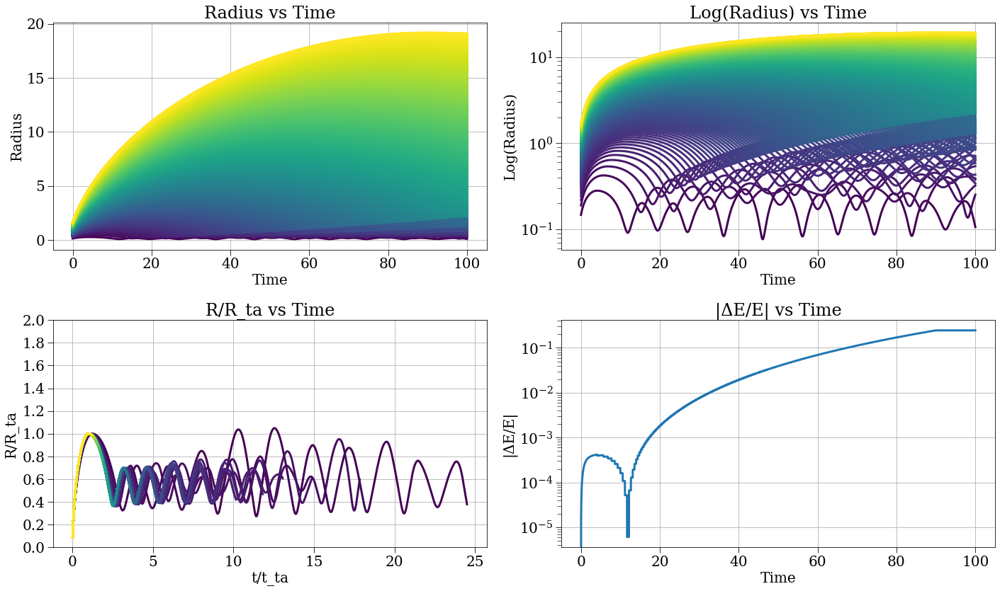

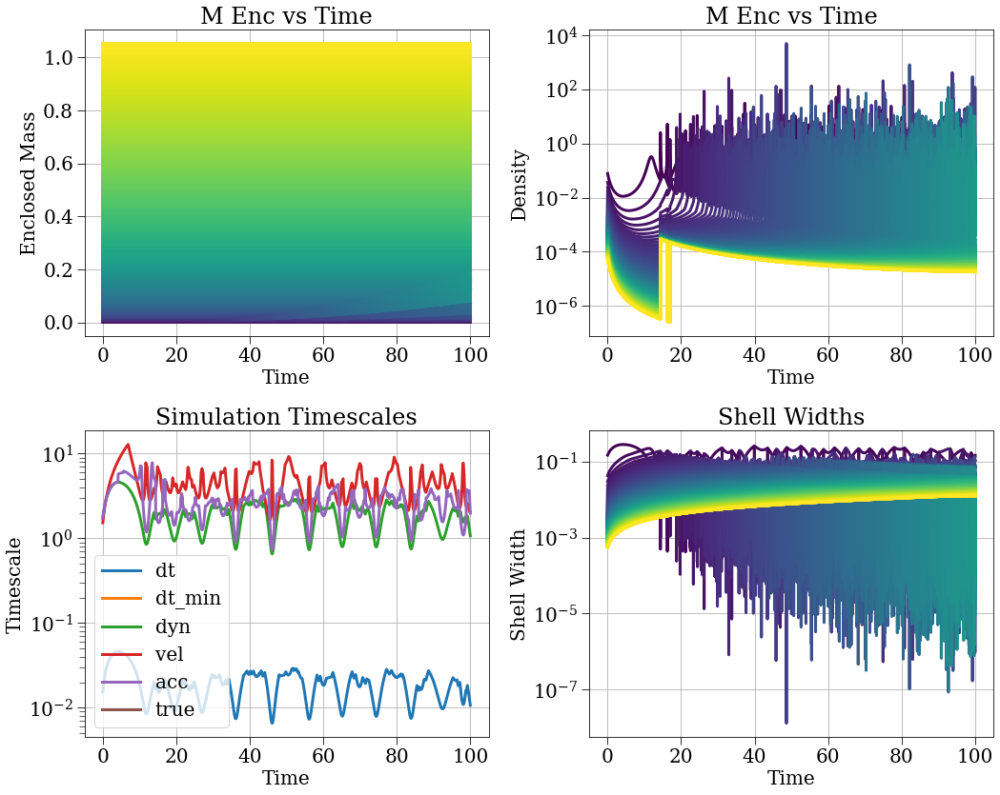

In [12]:
config = make_config(N=N, r_min=r_min, r_max=r_max, t_max=t_max, j_coef=j_coef, save_dt=save_dt, density_strategy=density_strategy, delta=delta, safety_factor=safety_factor, stepper_strategy='leapfrog_hut',  timescale_strategy=tss, H=H0, initial_radius_strategy=irs, gamma=gamma, initial_v_strategy=ivs, accel_strategy=accel_strategy, ang_mom_strategy=ang_mom_strategy, save_filename='8-21-1.h5', r_small=1, softlen=softlen, problematic_shell_strategy=problematic_shell_strategy, thickness_coef=thickness_coef, m_enc_strategy=mes, save_strategy=save_strategy, hbar2_over_m2=hbar2_over_m2)
sc, results, plotter = run_sc(config, profile=False, plot=True)

(1000,)


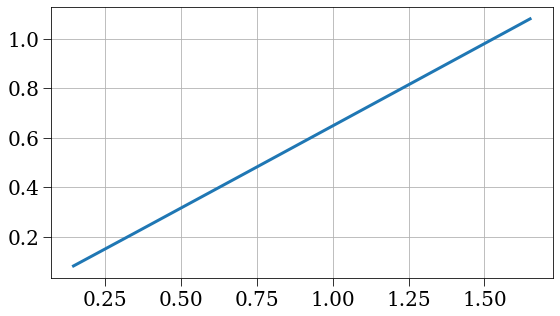

In [17]:
vvals = results['v'][0,:]
rvals = results['r'][0,:]

print(rvals.shape)
plt.plot(rvals, vvals)


In [24]:
def avg_delta_func(r, m_enc, rho_bar=rho_H):
    m_background = rho_bar * 4/3 * np.pi * r**3
    integral = (m_enc - m_background) / (4*np.pi * rho_bar)
    return 3 / r**3 * integral 

rvals = results['r'][0,:]
mencvals = results['m_enc'][0,:]

avg_delta_vals = avg_delta_func(rvals, mencvals)
print(avg_delta_vals)

[0.04593331]


In [25]:
results['v'][0,:]

array([1.31291853])

In [9]:
config = make_config(N=N, r_min=r_min, r_max=r_max, t_max=t_max, j_coef=j_coef, save_dt=save_dt, density_strategy=density_strategy, delta=delta, safety_factor=safety_factor, stepper_strategy='leapfrog_hut',  timescale_strategy=tss, H=H0, initial_radius_strategy=irs, gamma=gamma, initial_v_strategy=ivs, accel_strategy=accel_strategy, ang_mom_strategy=ang_mom_strategy, save_filename='8-8-3.h5', r_small=1, softlen=softlen, problematic_shell_strategy=problematic_shell_strategy, thickness_coef=thickness_coef, m_enc_strategy=mes, save_strategy=save_strategy, hbar2_over_m2=hbar2_over_m2)
sc, results, plotter = run_sc(config, profile=False, plot=False)

{'G': 1,
 'H': 0.6666666666666666,
 'N': 10000,
 'accel_strategy': 'grant_gmr_j_at_r_ta_soft',
 'ang_mom_strategy': 'zero',
 'delta': 0.01,
 'density_strategy': 'background_plus_power_law',
 'deque_size': 0,
 'drhodr_strategy': 'finite_diff',
 'dt': 1e-05,
 'dt_min': 0,
 'energy_strategy': 'kin_grav_rot_absorbed',
 'gamma': -0.9,
 'hbar2_over_m2': 0,
 'initial_mass_strategy': 'integrated_mass',
 'initial_radius_strategy': 'equal_mass',
 'initial_v_strategy': 'peculiar',
 'j_coef': 0.1,
 'm_enc_strategy': 'inclusive',
 'm_pert': 1,
 'next_save_time': 0,
 'num_crossing': 0,
 'point_mass': 0,
 'point_mass_strategy': 'rmin_rho_r',
 'polytropic_coef': 0,
 'polytropic_index': -1,
 'pressure_strategy': 'zero',
 'problematic_shell_strategy': 'nothing',
 'r0_min': 0.0007,
 'r_max': 7,
 'r_min': 0,
 'r_min_strategy': 'nothing',
 'r_small': 1,
 'r_ta_strategy': 'r_ta_cycloid',
 'relaxation_time': 0,
 'rho_bar': 0.05305164769729845,
 'safety_factor': 0.01,
 'save_dt': 1,
 'save_filename': '8-8-3.h

2025-08-08 17:19:56,839 - collapse - INFO - Simulation setup complete


2025-08-08 17:41:33,607 - DEBUG - Saved dataset t with shape (9978,)
2025-08-08 17:41:33,610 - DEBUG - Saved dataset dt with shape (9978,)


2025-08-08 17:41:34,592 - DEBUG - Saved dataset r with shape (9978, 10000)
2025-08-08 17:41:35,609 - DEBUG - Saved dataset v with shape (9978, 10000)
2025-08-08 17:41:36,588 - DEBUG - Saved dataset a with shape (9978, 10000)
2025-08-08 17:41:37,573 - DEBUG - Saved dataset m_enc with shape (9978, 10000)
2025-08-08 17:41:39,096 - DEBUG - Saved dataset rho_r with shape (9978, 10000)
2025-08-08 17:41:39,097 - WARNING - Skipping pressure because all values are None
2025-08-08 17:41:39,098 - WARNING - Skipping dpressure_drho because all values are None
2025-08-08 17:41:39,099 - WARNING - Skipping rho_prime because all values are None
2025-08-08 17:41:41,027 - DEBUG - Saved dataset e_tot with shape (9978, 10000)
2025-08-08 17:41:43,038 - DEBUG - Saved dataset e_g with shape (9978, 10000)
2025-08-08 17:41:45,490 - DEBUG - Saved dataset e_k with shape (9978, 10000)
2025-08-08 17:41:51,379 - DEBUG - Saved dataset e_r with shape (9978, 10000)
2025-08-08 17:41:51,380 - WARNING - Skipping e_p becau

{'G': 1,
 'H': 0.6666666666666666,
 'N': 10000,
 'accel_strategy': 'grant_gmr_j_at_r_ta_soft',
 'ang_mom_strategy': 'zero',
 'delta': 0.01,
 'density_strategy': 'background_plus_power_law',
 'deque_size': 0,
 'drhodr_strategy': 'finite_diff',
 'dt': 1e-05,
 'dt_min': 0,
 'energy_strategy': 'kin_grav_rot_absorbed',
 'gamma': -0.9,
 'hbar2_over_m2': 0,
 'initial_mass_strategy': 'integrated_mass',
 'initial_radius_strategy': 'equal_mass',
 'initial_v_strategy': 'peculiar',
 'j_coef': 0.3,
 'm_enc_strategy': 'inclusive',
 'm_pert': 1,
 'next_save_time': 0,
 'num_crossing': 0,
 'point_mass': 0,
 'point_mass_strategy': 'rmin_rho_r',
 'polytropic_coef': 0,
 'polytropic_index': -1,
 'pressure_strategy': 'zero',
 'problematic_shell_strategy': 'nothing',
 'r0_min': 0.0007,
 'r_max': 7,
 'r_min': 0,
 'r_min_strategy': 'nothing',
 'r_small': 1,
 'r_ta_strategy': 'r_ta_cycloid',
 'relaxation_time': 0,
 'rho_bar': 0.05305164769729845,
 'safety_factor': 0.01,
 'save_dt': 1,
 'save_filename': '8-8-2.h

2025-08-08 16:33:13,366 - collapse - INFO - Simulation setup complete


2025-08-08 16:39:20,729 - DEBUG - Saved dataset t with shape (9978,)
2025-08-08 16:39:20,731 - DEBUG - Saved dataset dt with shape (9978,)
2025-08-08 16:39:21,742 - DEBUG - Saved dataset r with shape (9978, 10000)
2025-08-08 16:39:24,157 - DEBUG - Saved dataset v with shape (9978, 10000)
2025-08-08 16:39:26,297 - DEBUG - Saved dataset a with shape (9978, 10000)
2025-08-08 16:39:28,467 - DEBUG - Saved dataset m_enc with shape (9978, 10000)
2025-08-08 16:39:30,608 - DEBUG - Saved dataset rho_r with shape (9978, 10000)
2025-08-08 16:39:30,610 - WARNING - Skipping pressure because all values are None
2025-08-08 16:39:30,611 - WARNING - Skipping dpressure_drho because all values are None
2025-08-08 16:39:30,613 - WARNING - Skipping rho_prime because all values are None
2025-08-08 16:39:32,758 - DEBUG - Saved dataset e_tot with shape (9978, 10000)
2025-08-08 16:39:33,832 - DEBUG - Saved dataset e_g with shape (9978, 10000)
2025-08-08 16:39:34,844 - DEBUG - Saved dataset e_k with shape (9978,

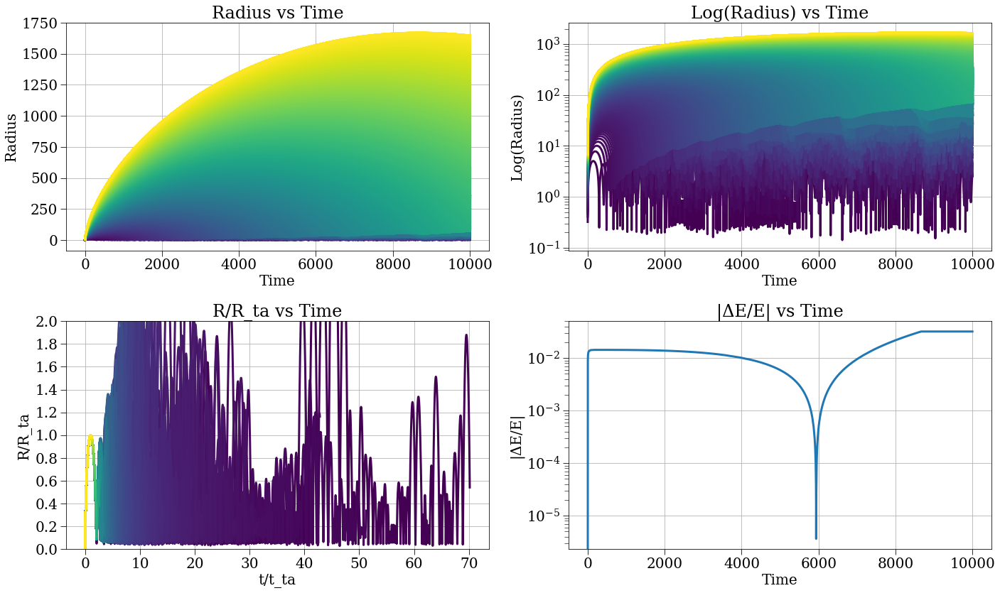

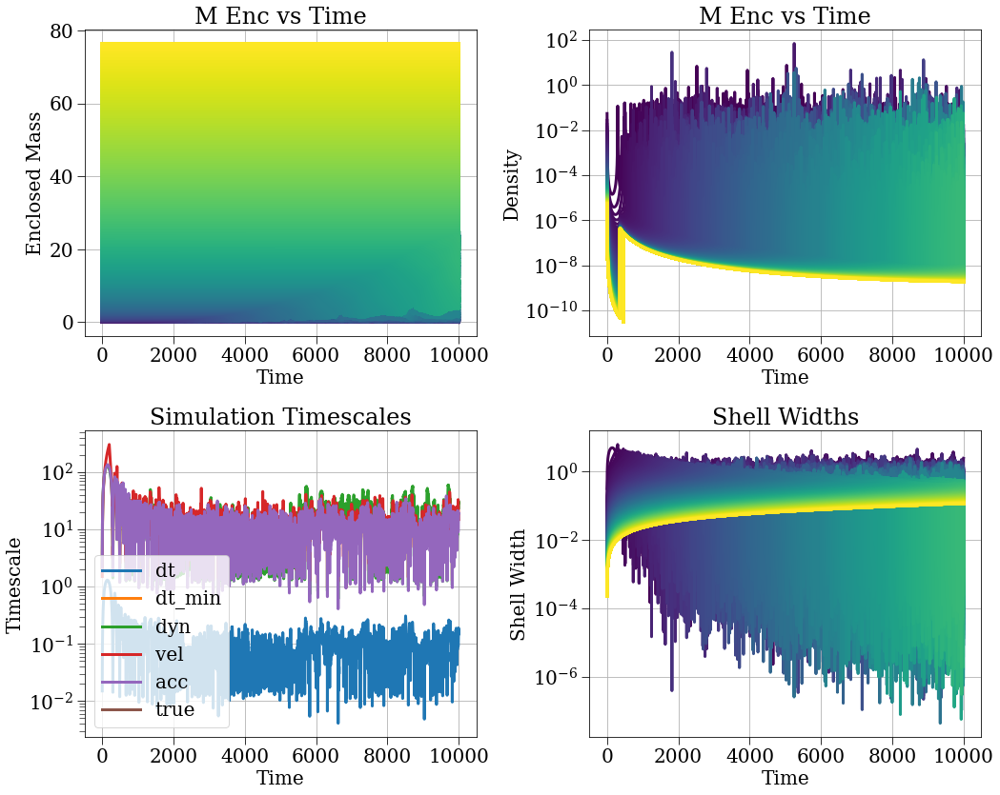

: 

In [ ]:
config = make_config(N=N, r_min=r_min, r_max=r_max, t_max=t_max, j_coef=j_coef, save_dt=save_dt, density_strategy=density_strategy, delta=delta, safety_factor=safety_factor, stepper_strategy='leapfrog_hut',  timescale_strategy=tss, H=H0, initial_radius_strategy=irs, gamma=gamma, initial_v_strategy=ivs, accel_strategy=accel_strategy, ang_mom_strategy=ang_mom_strategy, save_filename='8-8-2.h5', r_small=1, softlen=softlen, problematic_shell_strategy=problematic_shell_strategy, thickness_coef=thickness_coef, m_enc_strategy=mes, save_strategy=save_strategy, hbar2_over_m2=hbar2_over_m2)
sc, results, plotter = run_sc(config, profile=False, plot=True)

{'G': 1,
 'H': 0.6666666666666666,
 'N': 1000,
 'accel_strategy': 'grant_gmr_j_at_r_ta_soft',
 'ang_mom_strategy': 'zero',
 'delta': 0.01,
 'density_strategy': 'background_plus_power_law',
 'deque_size': 0,
 'drhodr_strategy': 'finite_diff',
 'dt': 1e-05,
 'dt_min': 0,
 'energy_strategy': 'kin_grav_rot_absorbed',
 'gamma': -0.9,
 'hbar2_over_m2': 0,
 'initial_mass_strategy': 'integrated_mass',
 'initial_radius_strategy': 'equal_mass',
 'initial_v_strategy': 'peculiar',
 'j_coef': 0.9,
 'm_enc_strategy': 'inclusive',
 'm_pert': 1,
 'next_save_time': 0,
 'num_crossing': 0,
 'point_mass': 0,
 'point_mass_strategy': 'rmin_rho_r',
 'polytropic_coef': 0,
 'polytropic_index': -1,
 'pressure_strategy': 'zero',
 'problematic_shell_strategy': 'nothing',
 'r0_min': 0.007,
 'r_max': 7,
 'r_min': 0,
 'r_min_strategy': 'nothing',
 'r_small': 1,
 'r_ta_strategy': 'r_ta_cycloid',
 'relaxation_time': 0,
 'rho_bar': 0.05305164769729845,
 'safety_factor': 0.01,
 'save_dt': 1,
 'save_filename': '8-8-1.h5'

2025-08-08 16:04:39,909 - collapse - INFO - Simulation setup complete


2025-08-08 16:04:41,775 - DEBUG - Saved dataset t with shape (3735,)
2025-08-08 16:04:41,777 - DEBUG - Saved dataset dt with shape (3735,)


2025-08-08 16:04:41,823 - DEBUG - Saved dataset r with shape (3735, 1000)
2025-08-08 16:04:41,864 - DEBUG - Saved dataset v with shape (3735, 1000)
2025-08-08 16:04:41,902 - DEBUG - Saved dataset a with shape (3735, 1000)
2025-08-08 16:04:41,932 - DEBUG - Saved dataset m_enc with shape (3735, 1000)
2025-08-08 16:04:41,970 - DEBUG - Saved dataset rho_r with shape (3735, 1000)
2025-08-08 16:04:41,972 - WARNING - Skipping pressure because all values are None
2025-08-08 16:04:41,973 - WARNING - Skipping dpressure_drho because all values are None
2025-08-08 16:04:41,974 - WARNING - Skipping rho_prime because all values are None
2025-08-08 16:04:42,012 - DEBUG - Saved dataset e_tot with shape (3735, 1000)
2025-08-08 16:04:42,039 - DEBUG - Saved dataset e_g with shape (3735, 1000)
2025-08-08 16:04:42,064 - DEBUG - Saved dataset e_k with shape (3735, 1000)
2025-08-08 16:04:42,089 - DEBUG - Saved dataset e_r with shape (3735, 1000)
2025-08-08 16:04:42,090 - WARNING - Skipping e_p because all va

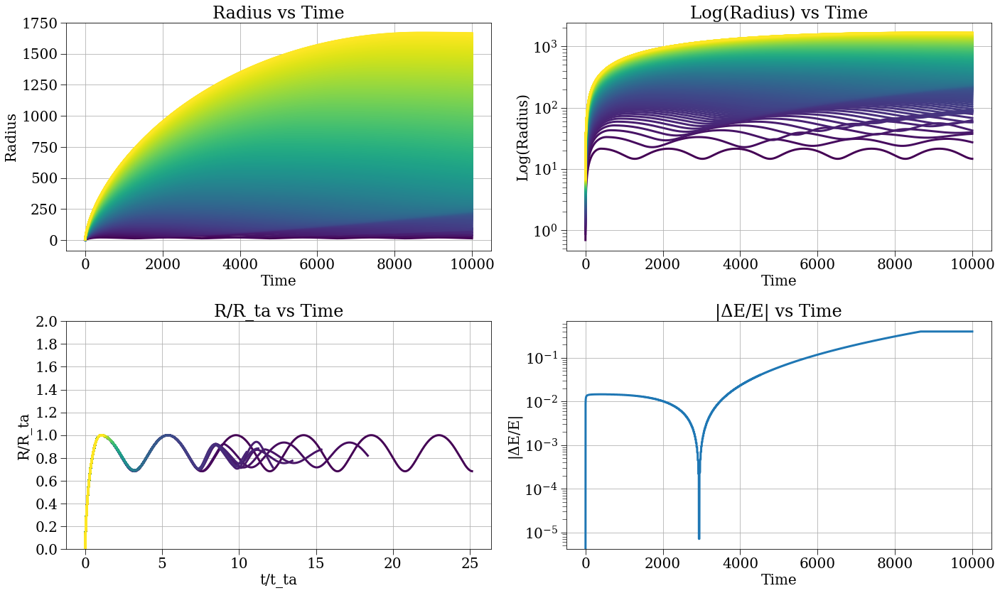

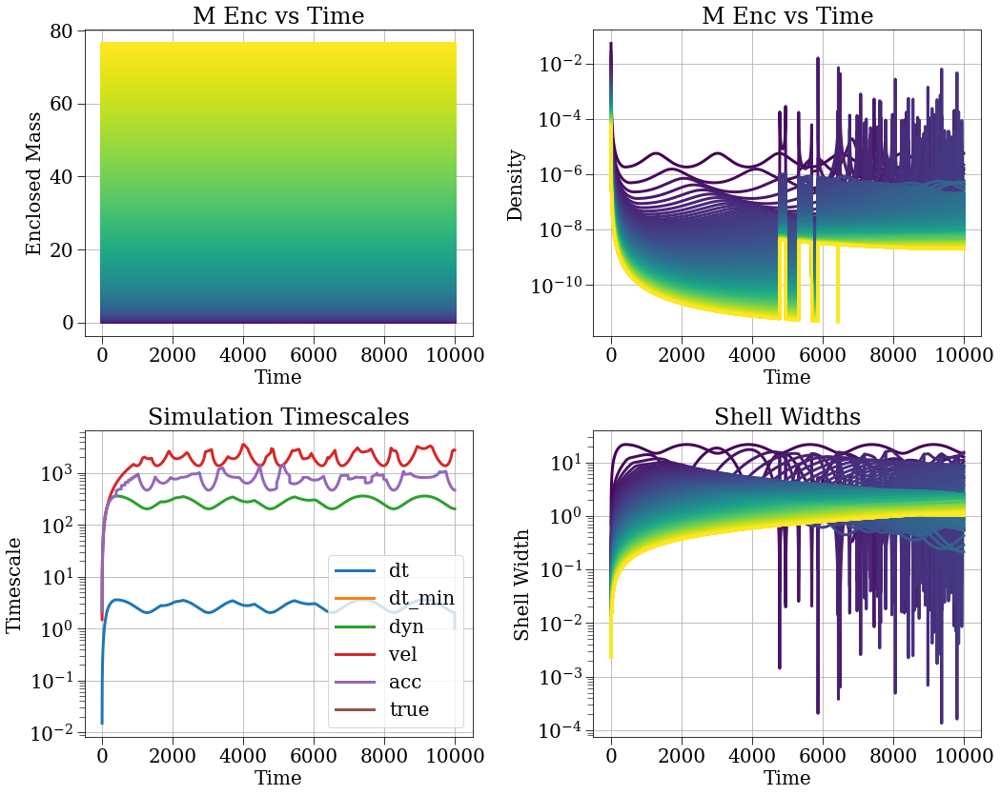

In [9]:
config = make_config(N=N, r_min=r_min, r_max=r_max, t_max=t_max, j_coef=j_coef, save_dt=save_dt, density_strategy=density_strategy, delta=delta, safety_factor=safety_factor, stepper_strategy='leapfrog_hut',  timescale_strategy=tss, H=H0, initial_radius_strategy=irs, gamma=gamma, initial_v_strategy=ivs, accel_strategy=accel_strategy, ang_mom_strategy=ang_mom_strategy, save_filename='8-8-1.h5', r_small=1, softlen=softlen, problematic_shell_strategy=problematic_shell_strategy, thickness_coef=thickness_coef, m_enc_strategy=mes, save_strategy=save_strategy, hbar2_over_m2=hbar2_over_m2)
sc, results, plotter = run_sc(config, profile=False, plot=True)

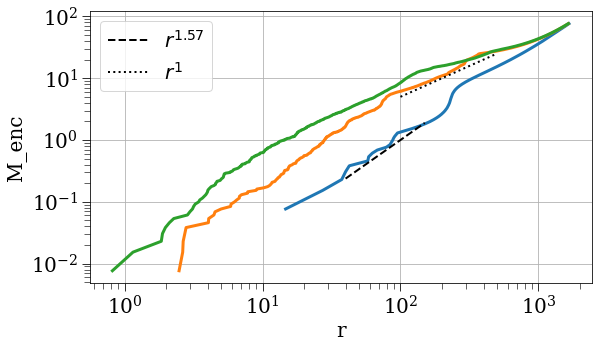

In [10]:
# for i in range(1, 4):   
#     params, snapshots = load_simulation_data(f'8-6-{i}.h5')
#     idx = -1
#     rvals = snapshots['r'][idx,:]
#     sorted_indices = np.argsort(rvals)
#     rvals = rvals[sorted_indices]
#     mencvals = snapshots['m_enc'][idx,sorted_indices]
#     tval = snapshots['t'][idx]
#     plt.loglog(rvals, mencvals, label=f'j={params["j_coef"]}')

params, snapshots = load_simulation_data(f'8-8-1.h5')
idx = -1
rvals = snapshots['r'][idx,:]
sorted_indices = np.argsort(rvals)
rvals = rvals[sorted_indices]
mencvals = snapshots['m_enc'][idx,sorted_indices]
tval = snapshots['t'][idx]
plt.loglog(rvals, mencvals, color='C0', ls='-')

params, snapshots = load_simulation_data(f'8-8-2.h5')
idx = -1
rvals = snapshots['r'][idx,:]
sorted_indices = np.argsort(rvals)
rvals = rvals[sorted_indices]
mencvals = snapshots['m_enc'][idx,sorted_indices]
tval = snapshots['t'][idx]
plt.loglog(rvals, mencvals, color='C1', ls='-')

params, snapshots = load_simulation_data(f'8-8-3.h5')
idx = -1
rvals = snapshots['r'][idx,:]
sorted_indices = np.argsort(rvals)
rvals = rvals[sorted_indices]
mencvals = snapshots['m_enc'][idx,sorted_indices]
tval = snapshots['t'][idx]
plt.loglog(rvals, mencvals, color='C2', ls='-')

rvals = np.logspace(np.log10(40),np.log10(150), 100)    
plt.loglog(rvals, (rvals/1e2)**1.57, ls='--', color='black', label=r'$r^{1.57}$', lw=2, alpha=1)
rvals = np.logspace(np.log10(100),np.log10(500), 100)    
plt.loglog(rvals, 5*(rvals/1e2)**1, ls=':', color='black', label=r'$r^{1}$', lw=2, alpha=1)
plt.xlabel('r')
plt.ylabel('M_enc')
plt.legend()

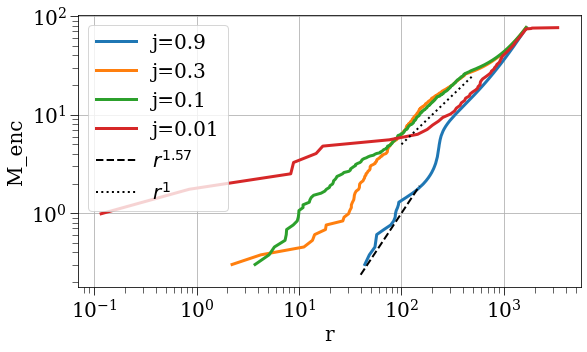

In [27]:
for i in range(1, 4):   
    params, snapshots = load_simulation_data(f'8-6-{i}.h5')
    idx = -1
    rvals = snapshots['r'][idx,:]
    sorted_indices = np.argsort(rvals)
    rvals = rvals[sorted_indices]
    mencvals = snapshots['m_enc'][idx,sorted_indices]
    tval = snapshots['t'][idx]
    plt.loglog(rvals, mencvals, label=f'j={params["j_coef"]}')

rvals = np.logspace(np.log10(40),np.log10(150), 100)    
plt.loglog(rvals, (rvals/1e2)**1.57, ls='--', color='black', label=r'$r^{1.57}$', lw=2, alpha=1)
rvals = np.logspace(np.log10(100),np.log10(500), 100)    
plt.loglog(rvals, 5*(rvals/1e2)**1, ls=':', color='black', label=r'$r^{1}$', lw=2, alpha=1)
plt.xlabel('r')
plt.ylabel('M_enc')
plt.legend()

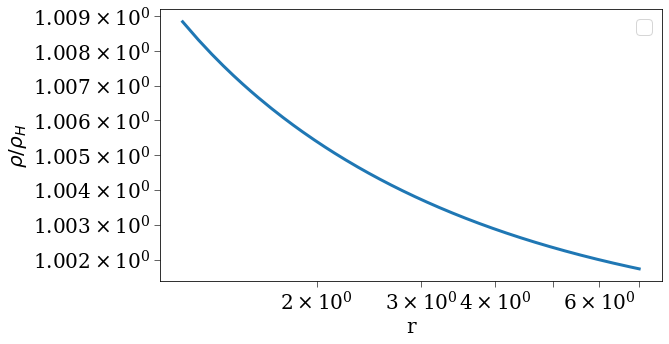

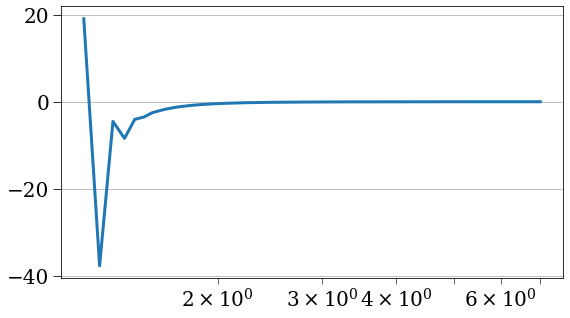

In [17]:
params, results = load_simulation_data(f'8-6-1.h5')
tvals = results['t']
rvals = results['r']
mvals = results['m'][0,:]
mencvals = results['m_enc']
#volvals = 4/3 * np.pi * np.array([np.diff(np.array([0, *rvals[i,:]]))**3 for i in range(len(rvals))])
rhovals = results['rho_r']

idx = 0
rho = results['rho_r'][idx,:]
rval = rvals[idx,:]
menc = mencvals[idx,:]


sorted_indices = np.argsort(rval)
rval = rval[sorted_indices]
rho = rho[sorted_indices]
menc = menc[sorted_indices]
mvals = mvals[sorted_indices]
upper_bounds = rval
lower_bounds = np.array([0, *rval[:-1]])
vol = 4/3 * np.pi * (upper_bounds**3 - lower_bounds**3)

plt.figure()

plt.plot(rval[1:], mvals[1:]/(rho_H * vol[1:]))
plt.xlabel('r')
plt.ylabel(r'$\rho/\rho_H$')
plt.yscale('log')
plt.xscale('log')
plt.legend()
plt.figure()
sorted_indices = np.argsort(rval)
r_halfs = np.zeros_like(rval)
r_halfs[0] = rval[sorted_indices[0]]/2
r_halfs[1:] = (rval[sorted_indices[1:]] + rval[sorted_indices[:-1]])/2

fs = splrep(r_halfs, np.log(rho[sorted_indices]), k=3)
d1 = splev(rval[sorted_indices], fs, der=1)
d2 = splev(rval[sorted_indices], fs, der=2)
d3 = splev(rval[sorted_indices], fs, der=3)
d1 = d1[np.argsort(sorted_indices)]
d2 = d2[np.argsort(sorted_indices)]
d3 = d3[np.argsort(sorted_indices)]

qf = 1/4 * d3 + 1/4 * d1*d2 - 1/2 * 1/rval**2 * d1 + 1/2 * 1/rval * d2
plt.plot(rval[1:], qf[1:]) 
plt.xscale('log')

(2292,) (1000,)


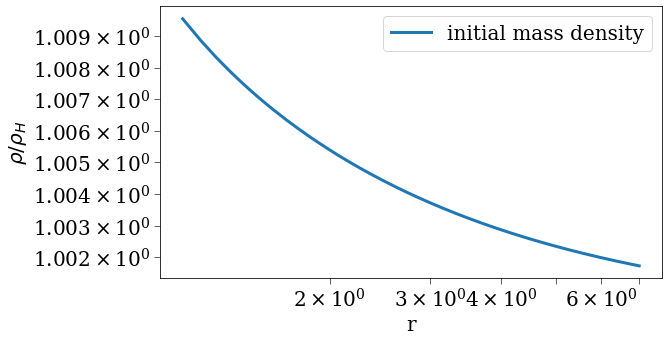

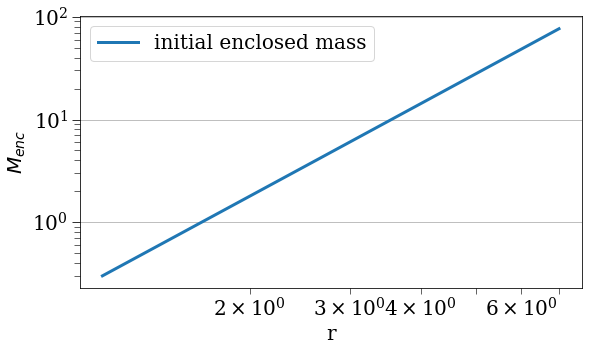

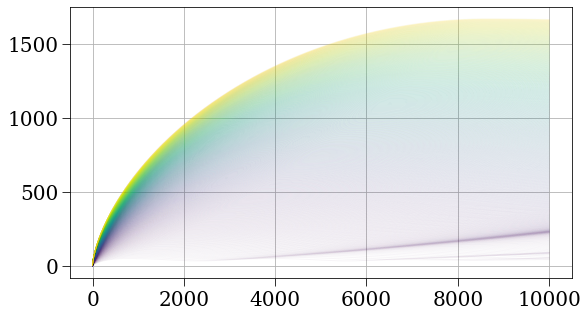

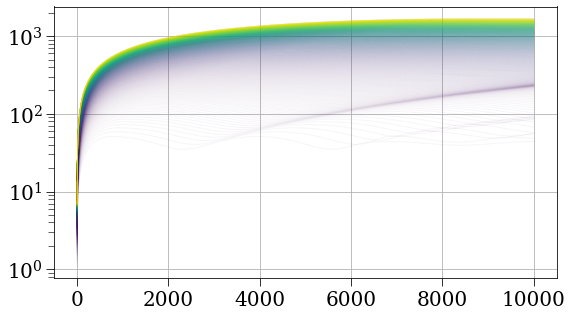

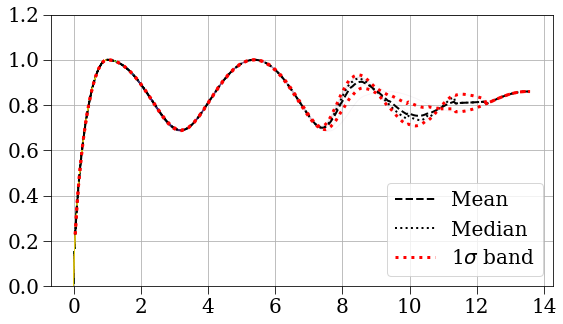

...

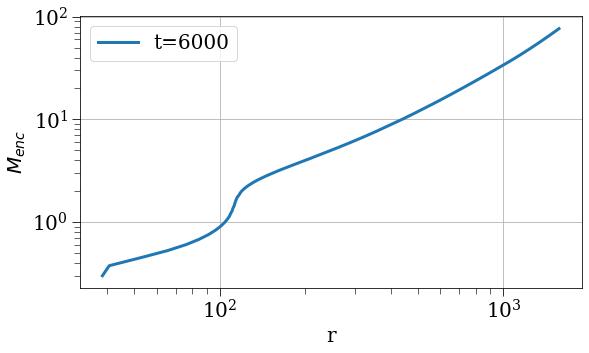

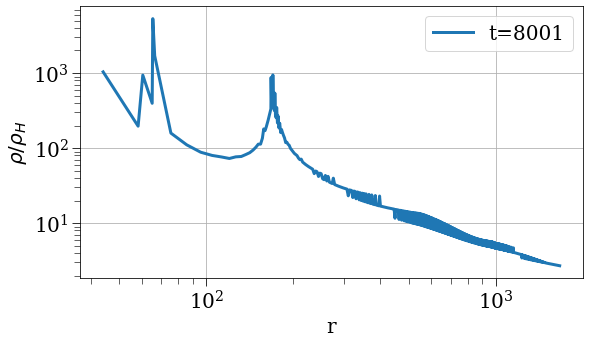

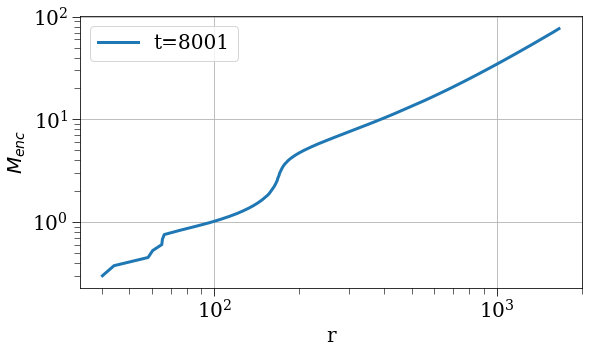

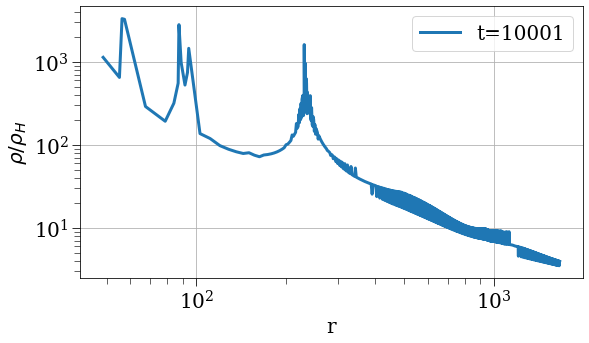

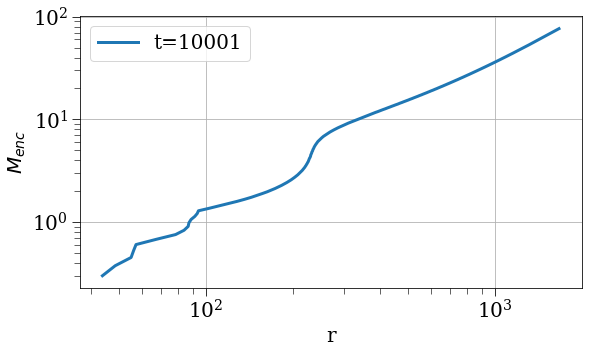

In [6]:
params, snapshots = load_simulation_data(f'8-6-1.h5')
plot_results(snapshots, sc=None, params=params)

(31932,) (1000,)


/home/jsipple/.conda/envs/jsipple/lib/python3.7/site-packages/IPython/core/events.py:88: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  func(*args, **kwargs)


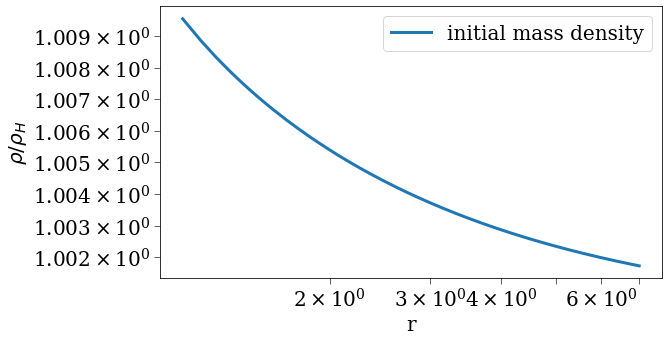

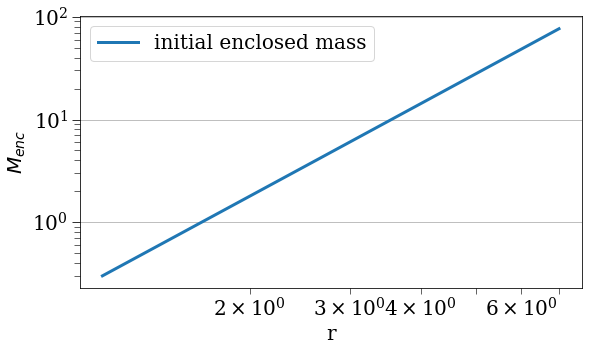

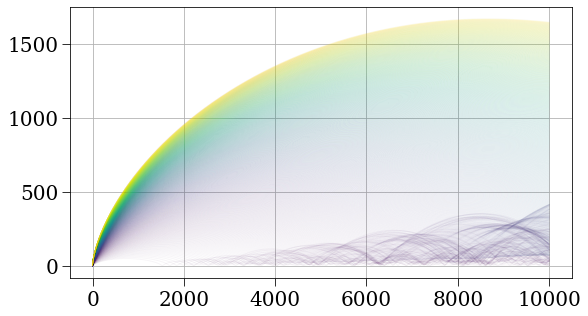

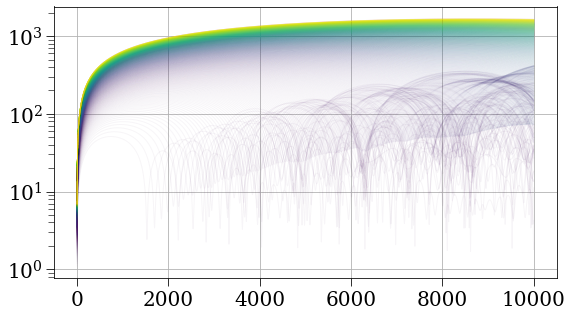

/home/jsipple/.conda/envs/jsipple/lib/python3.7/site-packages/IPython/core/pylabtools.py:128: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


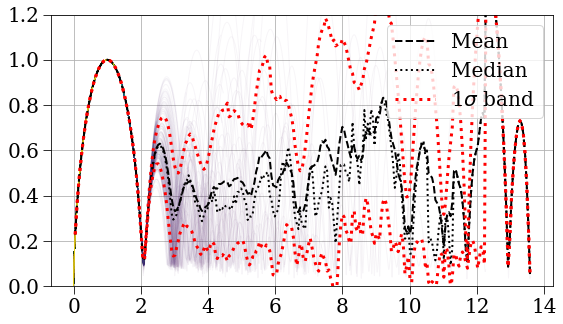

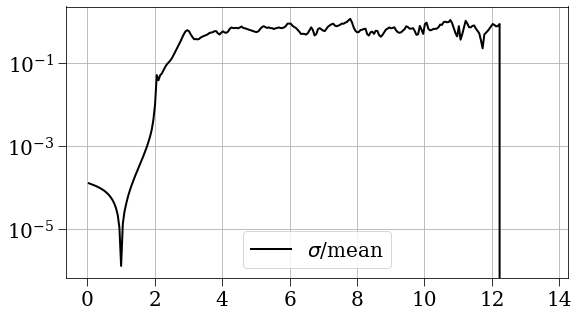

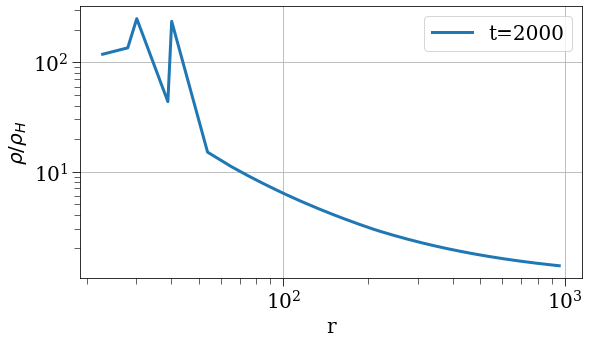

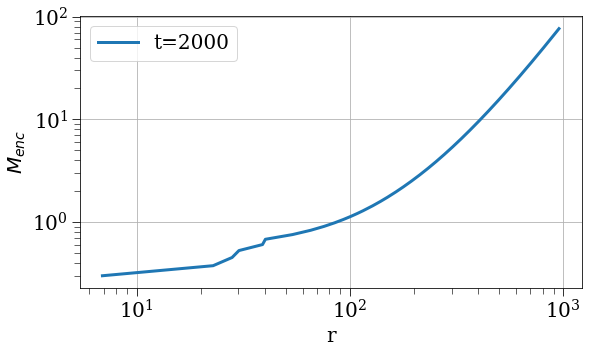

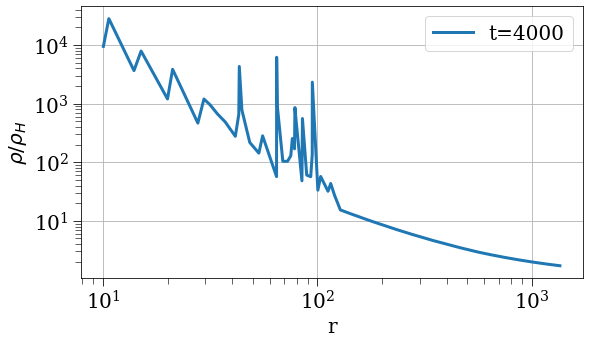

...

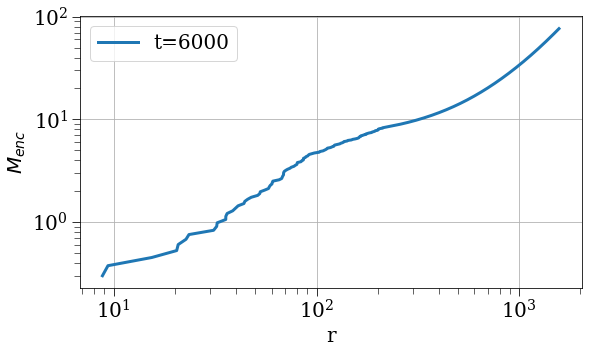

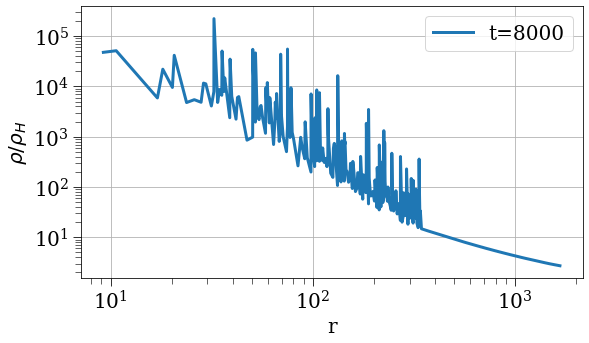

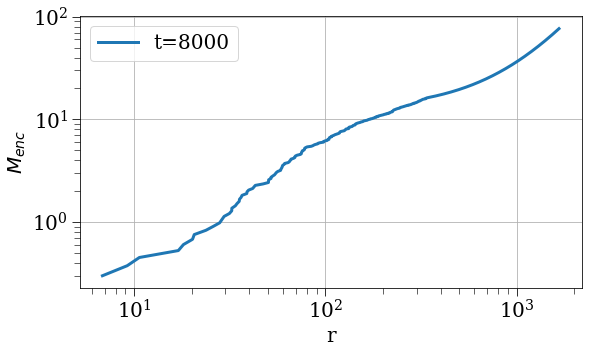

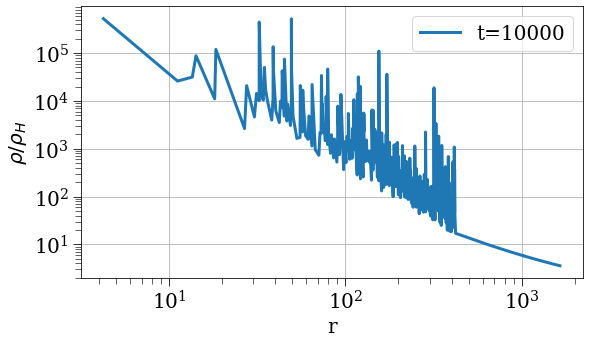

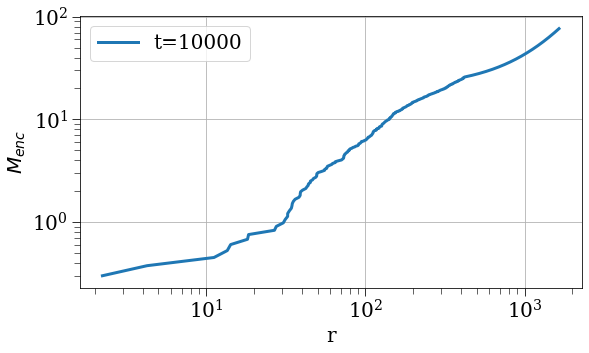

In [8]:
params, snapshots = load_simulation_data(f'8-6-2.h5')
plot_results(snapshots, sc=None, params=params)

(8990,) (1000,)


/home/jsipple/.conda/envs/jsipple/lib/python3.7/site-packages/IPython/core/events.py:88: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  func(*args, **kwargs)


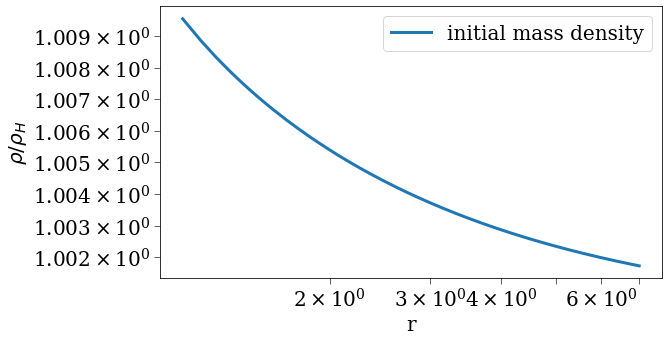

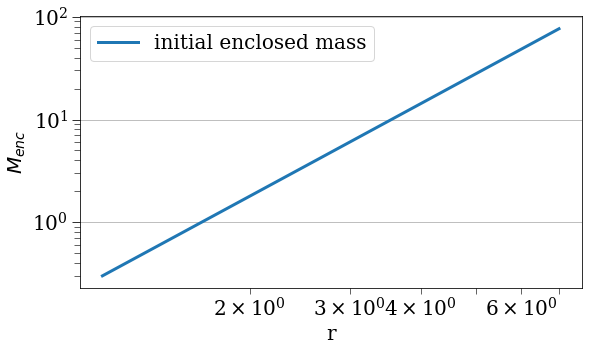

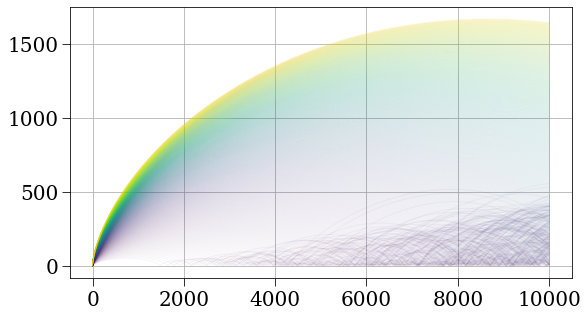

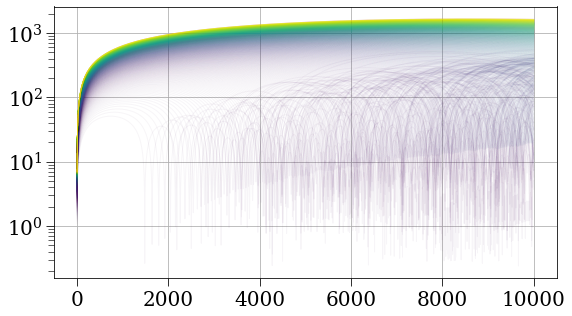

/home/jsipple/.conda/envs/jsipple/lib/python3.7/site-packages/IPython/core/pylabtools.py:128: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


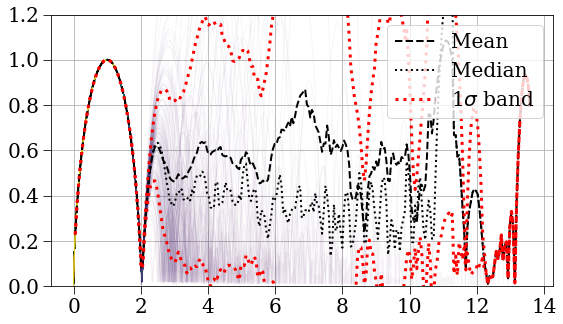

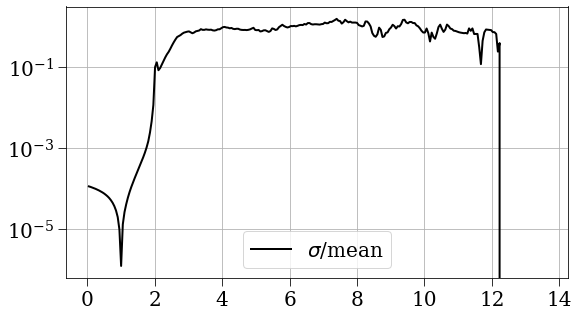

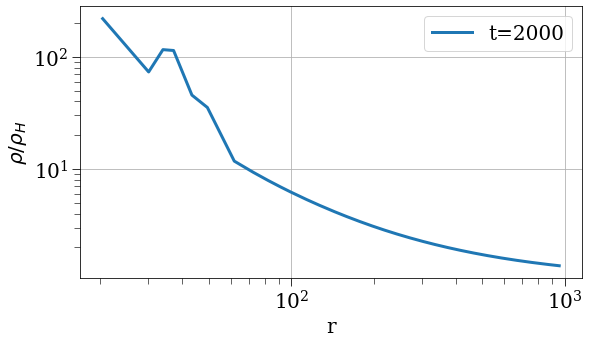

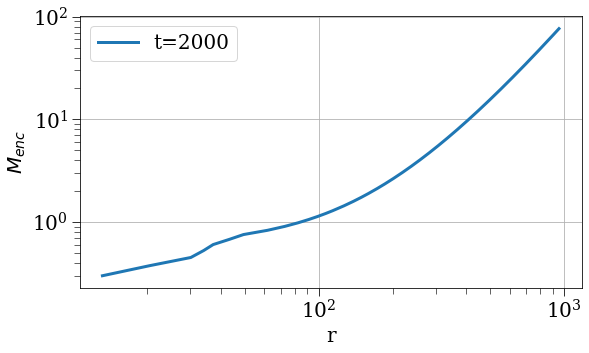

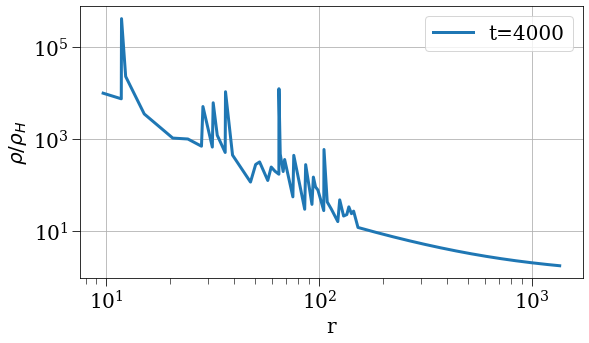

...

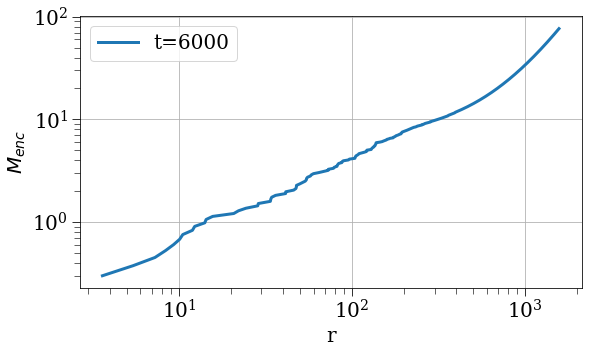

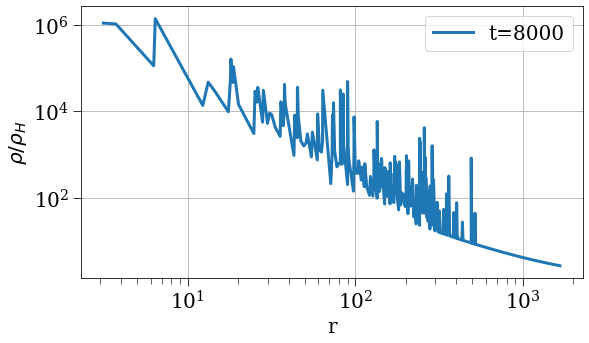

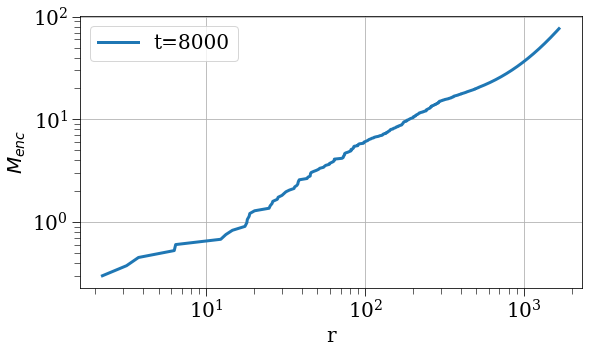

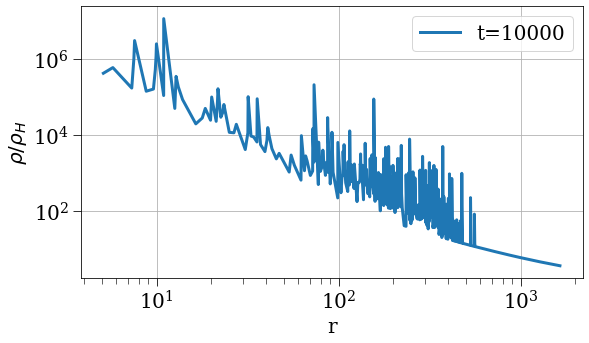

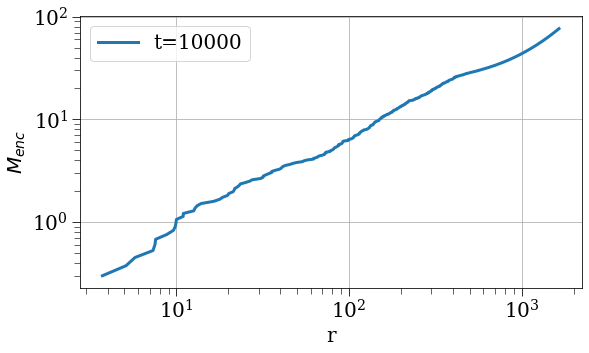

In [9]:
params, snapshots = load_simulation_data(f'8-6-3.h5')
plot_results(snapshots, sc=None, params=params)

(7099,) (100,)


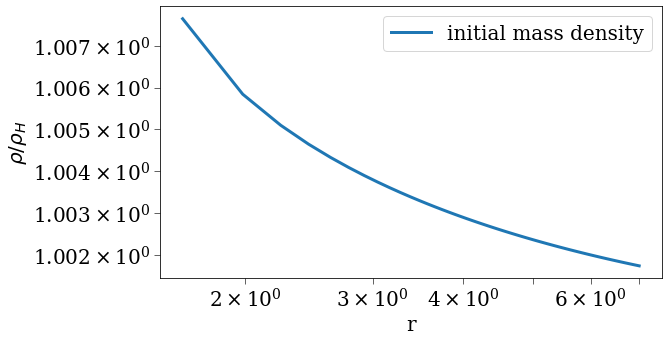

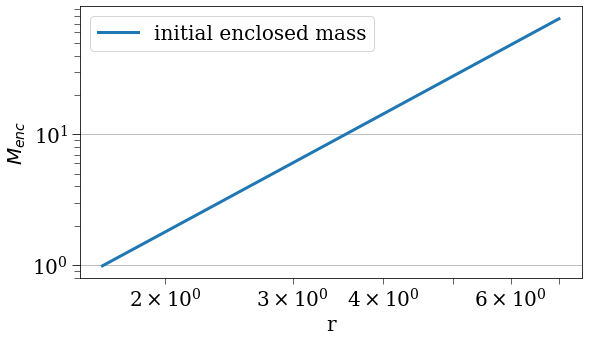

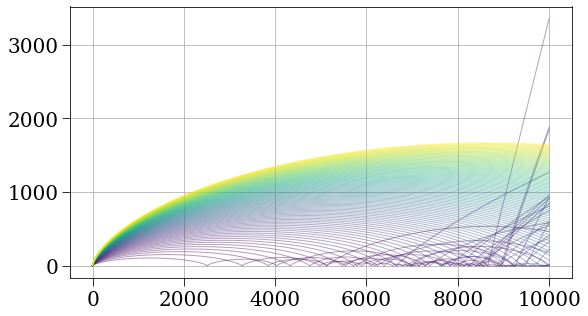

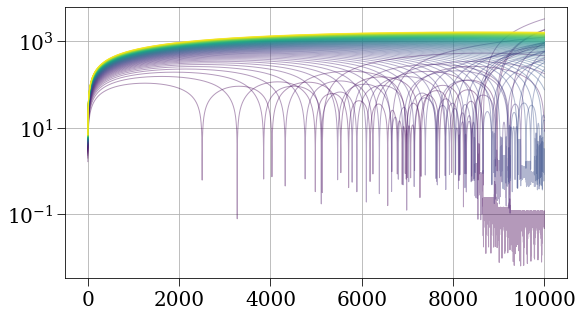

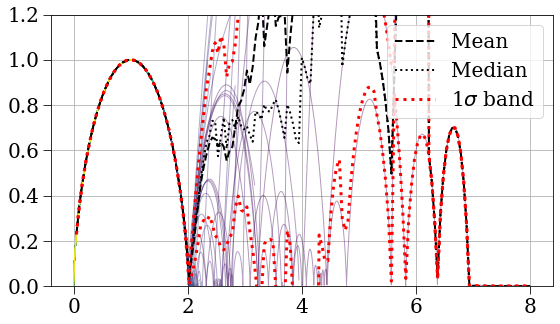

...

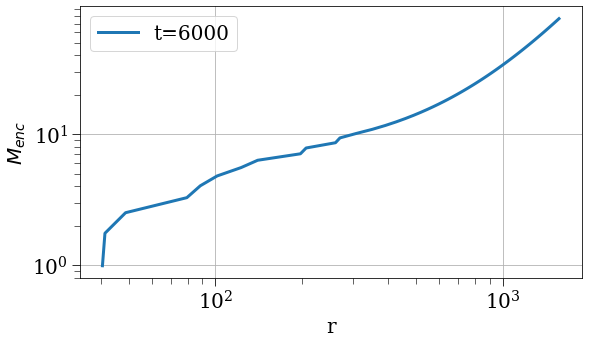

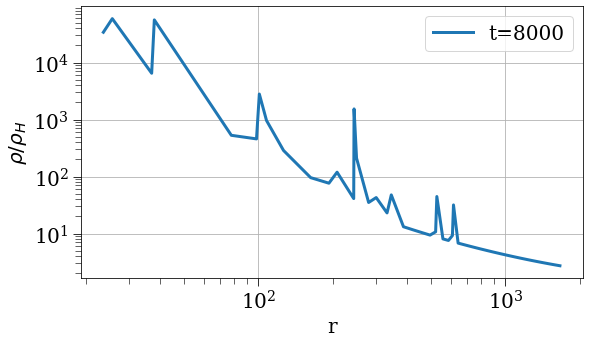

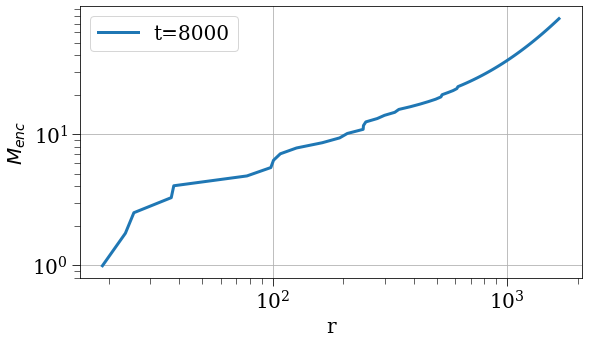

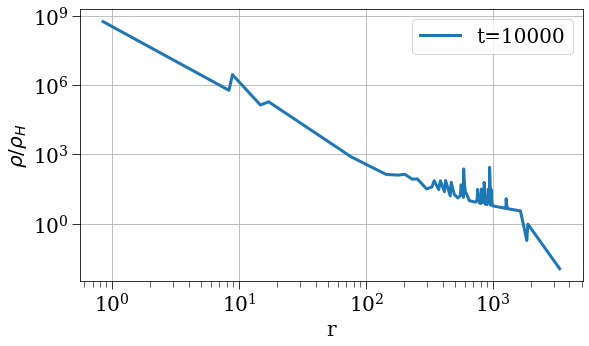

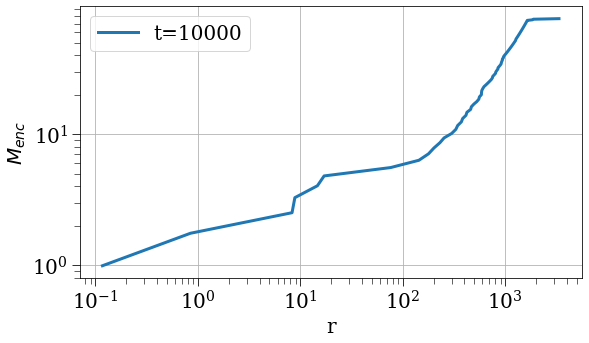

In [10]:
params, snapshots = load_simulation_data(f'8-6-4.h5')
plot_results(snapshots, sc=None, params=params)

In [ ]:
config = make_config(N=N, r_min=r_min, r_max=r_max, t_max=t_max, j_coef=j_coef, save_dt=save_dt, density_strategy=density_strategy, delta=delta, safety_factor=safety_factor, stepper_strategy='leapfrog_hut',  timescale_strategy=tss, H=H0, initial_radius_strategy=irs, gamma=gamma, initial_v_strategy=ivs, accel_strategy=accel_strategy, ang_mom_strategy=ang_mom_strategy, save_filename='8-6-5.h5', r_small=1, softlen=softlen, problematic_shell_strategy=problematic_shell_strategy, thickness_coef=thickness_coef, m_enc_strategy=mes, save_strategy=save_strategy, hbar2_over_m2=hbar2_over_m2)
sc, results, plotter = run_sc(config, profile=False, plot=True)

{'G': 1,
 'H': 0.6666666666666666,
 'N': 1000,
 'accel_strategy': 'grant_gmr_j_at_r_ta_soft',
 'ang_mom_strategy': 'zero',
 'delta': 0.01,
 'density_strategy': 'background_plus_power_law',
 'deque_size': 0,
 'drhodr_strategy': 'finite_diff',
 'dt': 1e-05,
 'dt_min': 0,
 'energy_strategy': 'kin_grav_rot_absorbed',
 'gamma': -0.9,
 'hbar2_over_m2': 0,
 'initial_mass_strategy': 'integrated_mass',
 'initial_radius_strategy': 'equal_mass',
 'initial_v_strategy': 'peculiar',
 'j_coef': 0.01,
 'm_enc_strategy': 'inclusive',
 'm_pert': 1,
 'next_save_time': 0,
 'num_crossing': 0,
 'point_mass': 0,
 'point_mass_strategy': 'rmin_rho_r',
 'polytropic_coef': 0,
 'polytropic_index': -1,
 'pressure_strategy': 'zero',
 'problematic_shell_strategy': 'nothing',
 'r0_min': 1.006,
 'r_max': 7,
 'r_min': 1,
 'r_min_strategy': 'nothing',
 'r_small': 1,
 'r_ta_strategy': 'r_ta_cycloid',
 'relaxation_time': 0,
 'rho_bar': 0.05305164769729845,
 'safety_factor': 0.01,
 'save_dt': 1,
 'save_filename': '8-6-5.h5

2025-08-07 03:58:34,698 - collapse - INFO - Simulation setup complete


{'G': 1,
 'H': 0.6666666666666666,
 'N': 100,
 'accel_strategy': 'grant_gmr_j_at_r_ta_soft',
 'ang_mom_strategy': 'zero',
 'delta': 0.01,
 'density_strategy': 'background_plus_power_law',
 'deque_size': 0,
 'drhodr_strategy': 'finite_diff',
 'dt': 1e-05,
 'dt_min': 0,
 'energy_strategy': 'kin_grav_rot_absorbed',
 'gamma': -0.9,
 'hbar2_over_m2': 0,
 'initial_mass_strategy': 'integrated_mass',
 'initial_radius_strategy': 'equal_mass',
 'initial_v_strategy': 'peculiar',
 'j_coef': 0.01,
 'm_enc_strategy': 'inclusive',
 'm_pert': 1,
 'next_save_time': 0,
 'num_crossing': 0,
 'point_mass': 0,
 'point_mass_strategy': 'rmin_rho_r',
 'polytropic_coef': 0,
 'polytropic_index': -1,
 'pressure_strategy': 'zero',
 'problematic_shell_strategy': 'nothing',
 'r0_min': 1.06,
 'r_max': 7,
 'r_min': 1,
 'r_min_strategy': 'nothing',
 'r_small': 1,
 'r_ta_strategy': 'r_ta_cycloid',
 'relaxation_time': 0,
 'rho_bar': 0.05305164769729845,
 'safety_factor': 0.01,
 'save_dt': 1,
 'save_filename': '8-6-4.h5',

2025-08-07 02:42:33,491 - collapse - INFO - Simulation setup complete


2025-08-07 03:07:25,134 - DEBUG - Saved dataset t with shape (7099,)
2025-08-07 03:07:25,136 - DEBUG - Saved dataset dt with shape (7099,)
2025-08-07 03:07:25,153 - DEBUG - Saved dataset r with shape (7099, 100)
2025-08-07 03:07:25,165 - DEBUG - Saved dataset v with shape (7099, 100)
2025-08-07 03:07:25,179 - DEBUG - Saved dataset a with shape (7099, 100)
2025-08-07 03:07:25,192 - DEBUG - Saved dataset m_enc with shape (7099, 100)
2025-08-07 03:07:25,205 - DEBUG - Saved dataset rho_r with shape (7099, 100)
2025-08-07 03:07:25,207 - WARNING - Skipping pressure because all values are None
2025-08-07 03:07:25,208 - WARNING - Skipping dpressure_drho because all values are None
2025-08-07 03:07:25,209 - WARNING - Skipping rho_prime because all values are None
2025-08-07 03:07:25,220 - DEBUG - Saved dataset e_tot with shape (7099, 100)
2025-08-07 03:07:25,231 - DEBUG - Saved dataset e_g with shape (7099, 100)


2025-08-07 03:07:25,242 - DEBUG - Saved dataset e_k with shape (7099, 100)
2025-08-07 03:07:25,252 - DEBUG - Saved dataset e_r with shape (7099, 100)
2025-08-07 03:07:25,253 - WARNING - Skipping e_p because all values are None
2025-08-07 03:07:25,254 - WARNING - Skipping e_q because all values are None
2025-08-07 03:07:25,256 - DEBUG - Saved dataset t_dyn with shape (7099,)
2025-08-07 03:07:25,257 - DEBUG - Saved dataset t_vel with shape (7099,)
2025-08-07 03:07:25,258 - DEBUG - Saved dataset t_acc with shape (7099,)
2025-08-07 03:07:25,259 - WARNING - Skipping t_cross because all values are None
2025-08-07 03:07:25,260 - WARNING - Skipping t_crossa because all values are None
2025-08-07 03:07:25,261 - WARNING - Skipping t_cross2 because all values are None
2025-08-07 03:07:25,262 - WARNING - Skipping t_zero because all values are None
2025-08-07 03:07:25,263 - WARNING - Skipping t_rmin because all values are None
2025-08-07 03:07:25,263 - WARNING - Skipping t_rmina because all values 

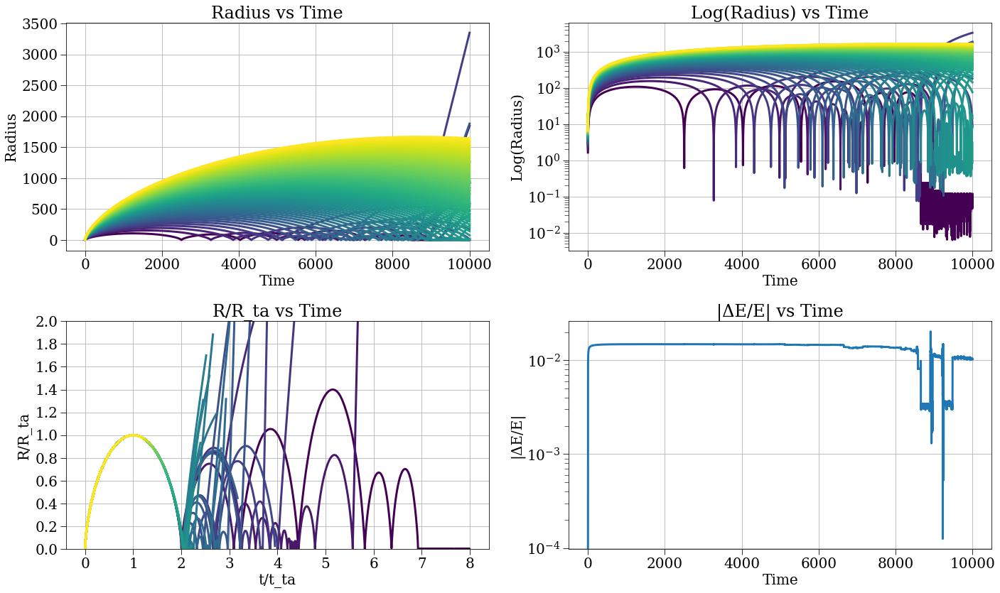

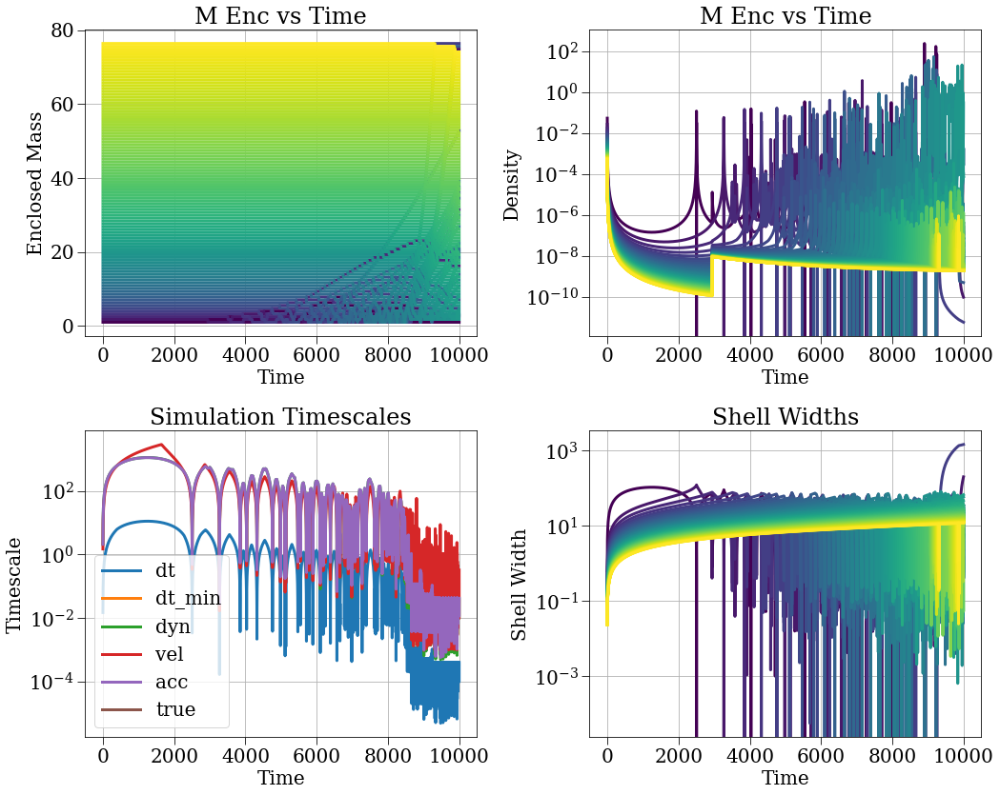

In [18]:
config = make_config(N=N, r_min=r_min, r_max=r_max, t_max=t_max, j_coef=j_coef, save_dt=save_dt, density_strategy=density_strategy, delta=delta, safety_factor=safety_factor, stepper_strategy='leapfrog_hut',  timescale_strategy=tss, H=H0, initial_radius_strategy=irs, gamma=gamma, initial_v_strategy=ivs, accel_strategy=accel_strategy, ang_mom_strategy=ang_mom_strategy, save_filename='8-6-4.h5', r_small=1, softlen=softlen, problematic_shell_strategy=problematic_shell_strategy, thickness_coef=thickness_coef, m_enc_strategy=mes, save_strategy=save_strategy, hbar2_over_m2=hbar2_over_m2)
sc, results, plotter = run_sc(config, profile=False, plot=True)

{'G': 1,
 'H': 0.6666666666666666,
 'N': 1000,
 'accel_strategy': 'grant_gmr_j_at_r_ta_soft',
 'ang_mom_strategy': 'zero',
 'delta': 0.01,
 'density_strategy': 'background_plus_power_law',
 'deque_size': 0,
 'drhodr_strategy': 'finite_diff',
 'dt': 1e-05,
 'dt_min': 0,
 'energy_strategy': 'kin_grav_rot_absorbed',
 'gamma': -0.9,
 'hbar2_over_m2': 0,
 'initial_mass_strategy': 'integrated_mass',
 'initial_radius_strategy': 'equal_mass',
 'initial_v_strategy': 'peculiar',
 'j_coef': 0.1,
 'm_enc_strategy': 'inclusive',
 'm_pert': 1,
 'next_save_time': 0,
 'num_crossing': 0,
 'point_mass': 0,
 'point_mass_strategy': 'rmin_rho_r',
 'polytropic_coef': 0,
 'polytropic_index': -1,
 'pressure_strategy': 'zero',
 'problematic_shell_strategy': 'nothing',
 'r0_min': 1.006,
 'r_max': 7,
 'r_min': 1,
 'r_min_strategy': 'nothing',
 'r_small': 1,
 'r_ta_strategy': 'r_ta_cycloid',
 'relaxation_time': 0,
 'rho_bar': 0.05305164769729845,
 'safety_factor': 0.01,
 'save_dt': 1,
 'save_filename': '8-6-3.h5'

2025-08-07 02:34:56,982 - collapse - INFO - Simulation setup complete


2025-08-07 02:35:57,527 - DEBUG - Saved dataset t with shape (8990,)
2025-08-07 02:35:57,528 - DEBUG - Saved dataset dt with shape (8990,)
2025-08-07 02:35:57,628 - DEBUG - Saved dataset r with shape (8990, 1000)
2025-08-07 02:35:57,729 - DEBUG - Saved dataset v with shape (8990, 1000)
2025-08-07 02:35:57,826 - DEBUG - Saved dataset a with shape (8990, 1000)
2025-08-07 02:35:57,921 - DEBUG - Saved dataset m_enc with shape (8990, 1000)
2025-08-07 02:35:58,016 - DEBUG - Saved dataset rho_r with shape (8990, 1000)
2025-08-07 02:35:58,017 - WARNING - Skipping pressure because all values are None
2025-08-07 02:35:58,018 - WARNING - Skipping dpressure_drho because all values are None
2025-08-07 02:35:58,019 - WARNING - Skipping rho_prime because all values are None
2025-08-07 02:35:58,124 - DEBUG - Saved dataset e_tot with shape (8990, 1000)
2025-08-07 02:35:58,217 - DEBUG - Saved dataset e_g with shape (8990, 1000)
2025-08-07 02:35:58,311 - DEBUG - Saved dataset e_k with shape (8990, 1000)


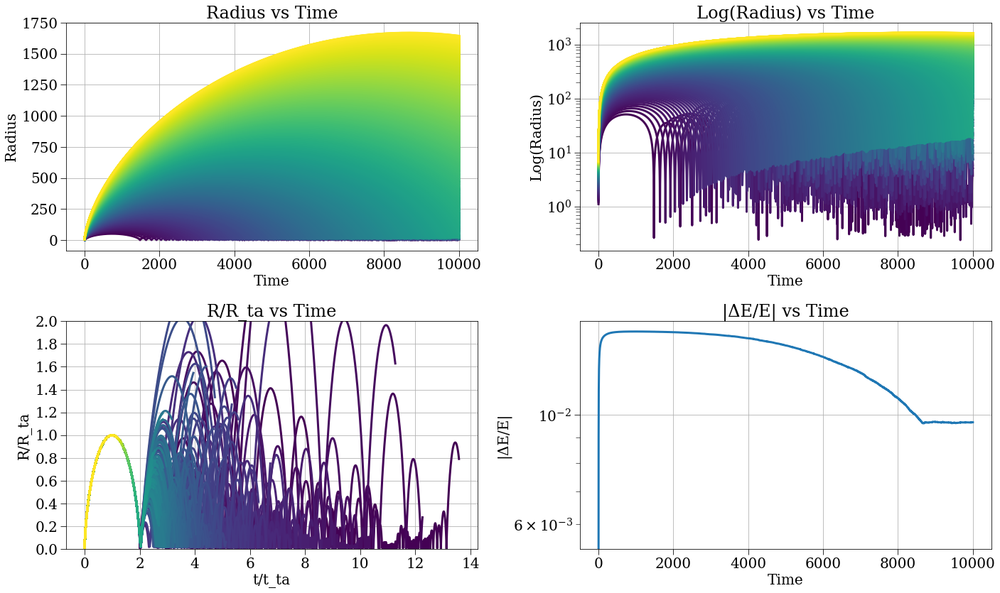

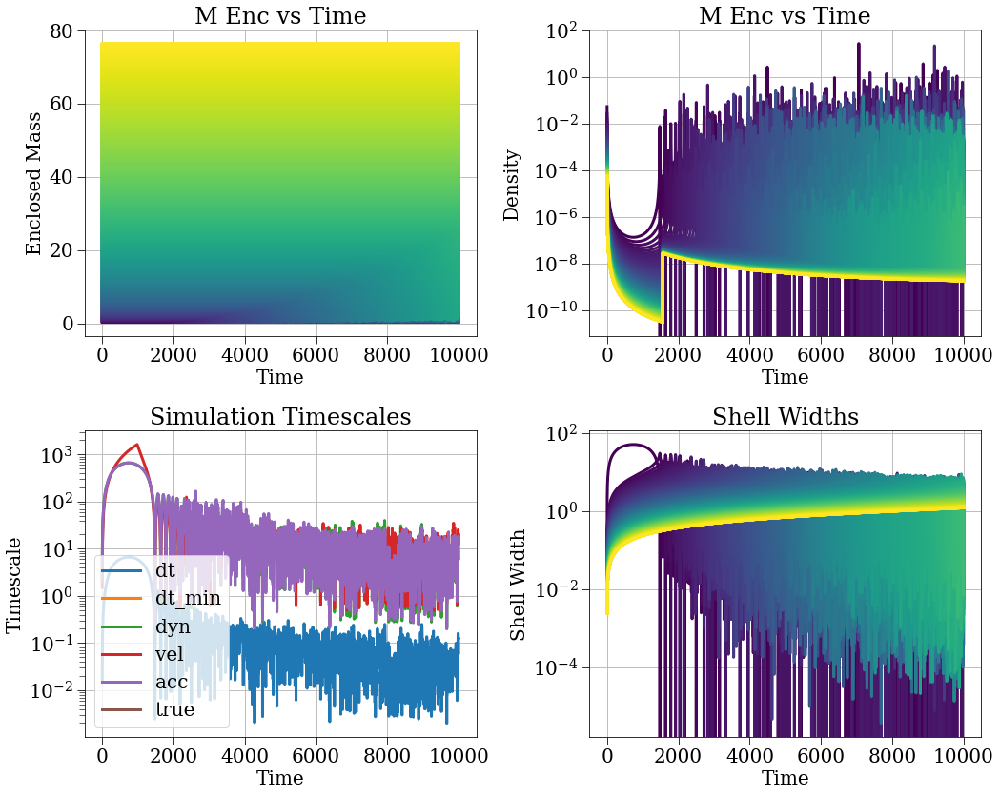

In [7]:
config = make_config(N=N, r_min=r_min, r_max=r_max, t_max=t_max, j_coef=j_coef, save_dt=save_dt, density_strategy=density_strategy, delta=delta, safety_factor=safety_factor, stepper_strategy='leapfrog_hut',  timescale_strategy=tss, H=H0, initial_radius_strategy=irs, gamma=gamma, initial_v_strategy=ivs, accel_strategy=accel_strategy, ang_mom_strategy=ang_mom_strategy, save_filename='8-6-3.h5', r_small=1, softlen=softlen, problematic_shell_strategy=problematic_shell_strategy, thickness_coef=thickness_coef, m_enc_strategy=mes, save_strategy=save_strategy, hbar2_over_m2=hbar2_over_m2)
sc, results, plotter = run_sc(config, profile=False, plot=True)

{'G': 1,
 'H': 0.6666666666666666,
 'N': 1000,
 'accel_strategy': 'grant_gmr_j_at_r_ta_soft',
 'ang_mom_strategy': 'zero',
 'delta': 0.01,
 'density_strategy': 'background_plus_power_law',
 'deque_size': 0,
 'drhodr_strategy': 'finite_diff',
 'dt': 1e-05,
 'dt_min': 0,
 'energy_strategy': 'kin_grav_rot_absorbed',
 'gamma': -0.9,
 'hbar2_over_m2': 0,
 'initial_mass_strategy': 'integrated_mass',
 'initial_radius_strategy': 'equal_mass',
 'initial_v_strategy': 'peculiar',
 'j_coef': 0.3,
 'm_enc_strategy': 'inclusive',
 'm_pert': 1,
 'next_save_time': 0,
 'num_crossing': 0,
 'point_mass': 0,
 'point_mass_strategy': 'rmin_rho_r',
 'polytropic_coef': 0,
 'polytropic_index': -1,
 'pressure_strategy': 'zero',
 'problematic_shell_strategy': 'nothing',
 'r0_min': 1.006,
 'r_max': 7,
 'r_min': 1,
 'r_min_strategy': 'nothing',
 'r_small': 1,
 'r_ta_strategy': 'r_ta_cycloid',
 'relaxation_time': 0,
 'rho_bar': 0.05305164769729845,
 'safety_factor': 0.01,
 'save_dt': 0.1,
 'save_filename': '8-6-2.h

2025-08-07 02:26:04,986 - collapse - INFO - Simulation setup complete


2025-08-07 02:26:32,625 - DEBUG - Saved dataset t with shape (31932,)
2025-08-07 02:26:32,629 - DEBUG - Saved dataset dt with shape (31932,)
2025-08-07 02:26:32,924 - DEBUG - Saved dataset r with shape (31932, 1000)
2025-08-07 02:26:33,151 - DEBUG - Saved dataset v with shape (31932, 1000)
2025-08-07 02:26:33,373 - DEBUG - Saved dataset a with shape (31932, 1000)
2025-08-07 02:26:33,580 - DEBUG - Saved dataset m_enc with shape (31932, 1000)
2025-08-07 02:26:33,787 - DEBUG - Saved dataset rho_r with shape (31932, 1000)
2025-08-07 02:26:33,789 - WARNING - Skipping pressure because all values are None
2025-08-07 02:26:33,792 - WARNING - Skipping dpressure_drho because all values are None
2025-08-07 02:26:33,794 - WARNING - Skipping rho_prime because all values are None
2025-08-07 02:26:34,105 - DEBUG - Saved dataset e_tot with shape (31932, 1000)
2025-08-07 02:26:34,310 - DEBUG - Saved dataset e_g with shape (31932, 1000)
2025-08-07 02:26:34,526 - DEBUG - Saved dataset e_k with shape (319

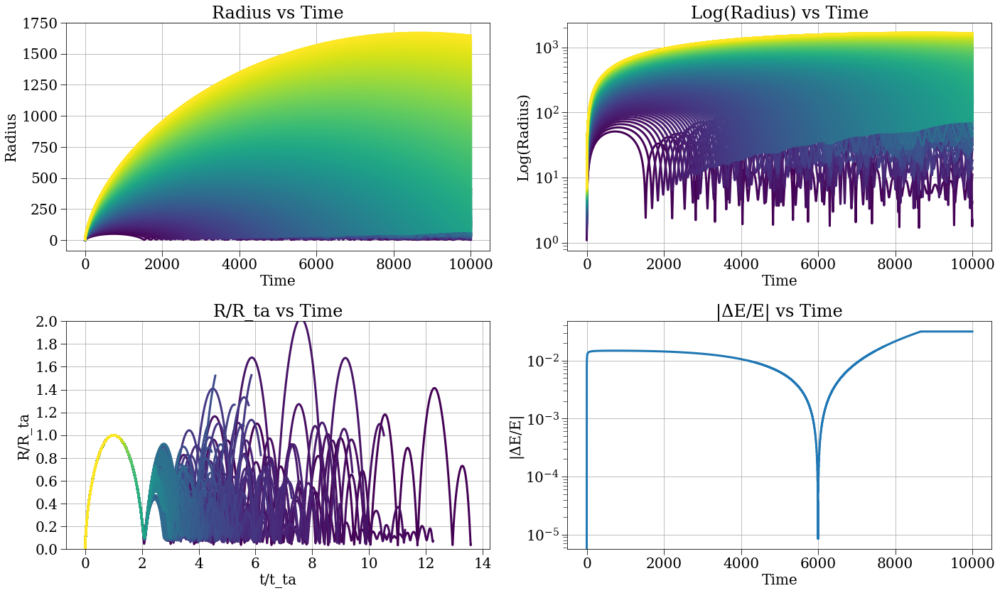

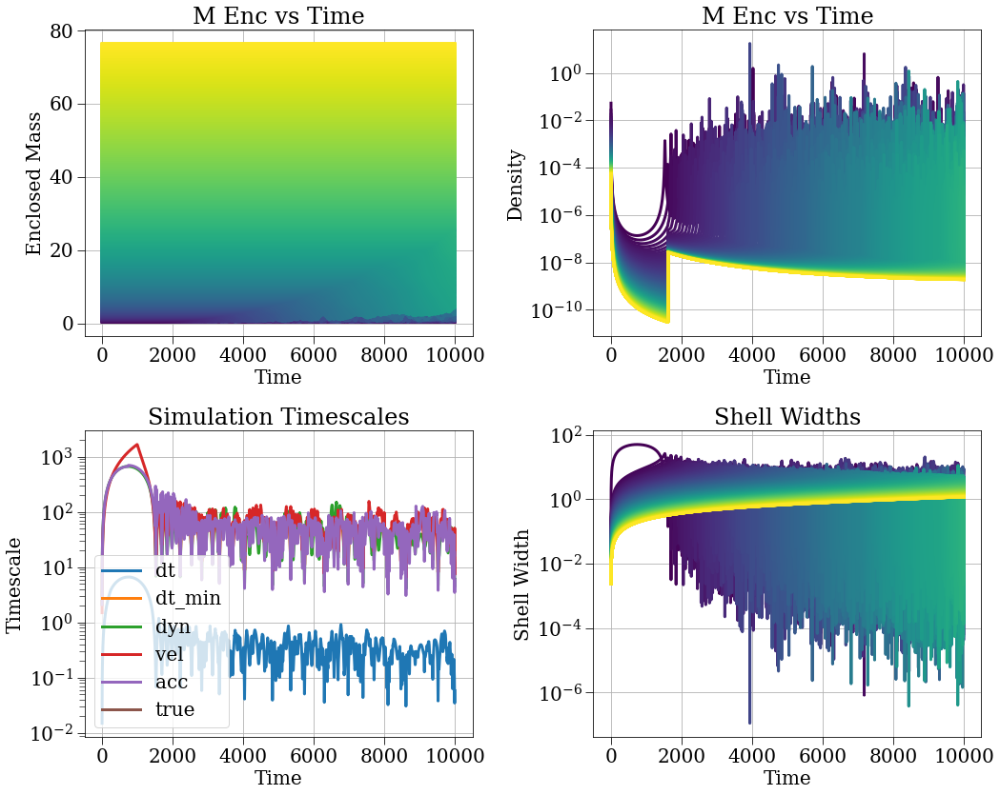

In [51]:
config = make_config(N=N, r_min=r_min, r_max=r_max, t_max=t_max, j_coef=j_coef, save_dt=save_dt, density_strategy=density_strategy, delta=delta, safety_factor=safety_factor, stepper_strategy='leapfrog_hut',  timescale_strategy=tss, H=H0, initial_radius_strategy=irs, gamma=gamma, initial_v_strategy=ivs, accel_strategy=accel_strategy, ang_mom_strategy=ang_mom_strategy, save_filename='8-6-2.h5', r_small=1, softlen=softlen, problematic_shell_strategy=problematic_shell_strategy, thickness_coef=thickness_coef, m_enc_strategy=mes, save_strategy=save_strategy, hbar2_over_m2=hbar2_over_m2)
sc, results, plotter = run_sc(config, profile=False, plot=True)

{'G': 1,
 'H': 0.6666666666666666,
 'N': 1000,
 'accel_strategy': 'grant_gmr_j_at_r_ta_soft',
 'ang_mom_strategy': 'zero',
 'delta': 0.01,
 'density_strategy': 'background_plus_power_law',
 'deque_size': 0,
 'drhodr_strategy': 'finite_diff',
 'dt': 1e-05,
 'dt_min': 0,
 'energy_strategy': 'kin_grav_rot_absorbed',
 'gamma': -0.9,
 'hbar2_over_m2': 0,
 'initial_mass_strategy': 'integrated_mass',
 'initial_radius_strategy': 'equal_mass',
 'initial_v_strategy': 'peculiar',
 'j_coef': 0.9,
 'm_enc_strategy': 'inclusive',
 'm_pert': 1,
 'next_save_time': 0,
 'num_crossing': 0,
 'point_mass': 0,
 'point_mass_strategy': 'rmin_rho_r',
 'polytropic_coef': 0,
 'polytropic_index': -1,
 'pressure_strategy': 'zero',
 'problematic_shell_strategy': 'nothing',
 'r0_min': 1.006,
 'r_max': 7,
 'r_min': 1,
 'r_min_strategy': 'nothing',
 'r_small': 1,
 'r_ta_strategy': 'r_ta_cycloid',
 'relaxation_time': 0,
 'rho_bar': 0.05305164769729845,
 'safety_factor': 0.01,
 'save_dt': 0.1,
 'save_filename': '8-6-1.h

2025-08-07 02:24:42,768 - collapse - INFO - Simulation setup complete


2025-08-07 02:24:44,851 - DEBUG - Saved dataset t with shape (2292,)
2025-08-07 02:24:44,852 - DEBUG - Saved dataset dt with shape (2292,)
2025-08-07 02:24:44,879 - DEBUG - Saved dataset r with shape (2292, 1000)
2025-08-07 02:24:44,901 - DEBUG - Saved dataset v with shape (2292, 1000)
2025-08-07 02:24:44,925 - DEBUG - Saved dataset a with shape (2292, 1000)
2025-08-07 02:24:44,947 - DEBUG - Saved dataset m_enc with shape (2292, 1000)
2025-08-07 02:24:44,971 - DEBUG - Saved dataset rho_r with shape (2292, 1000)
2025-08-07 02:24:44,972 - WARNING - Skipping pressure because all values are None
2025-08-07 02:24:44,973 - WARNING - Skipping dpressure_drho because all values are None
2025-08-07 02:24:44,973 - WARNING - Skipping rho_prime because all values are None
2025-08-07 02:24:44,997 - DEBUG - Saved dataset e_tot with shape (2292, 1000)


2025-08-07 02:24:45,019 - DEBUG - Saved dataset e_g with shape (2292, 1000)
2025-08-07 02:24:45,041 - DEBUG - Saved dataset e_k with shape (2292, 1000)
2025-08-07 02:24:45,064 - DEBUG - Saved dataset e_r with shape (2292, 1000)
2025-08-07 02:24:45,065 - WARNING - Skipping e_p because all values are None
2025-08-07 02:24:45,066 - WARNING - Skipping e_q because all values are None
2025-08-07 02:24:45,067 - DEBUG - Saved dataset t_dyn with shape (2292,)
2025-08-07 02:24:45,069 - DEBUG - Saved dataset t_vel with shape (2292,)
2025-08-07 02:24:45,070 - DEBUG - Saved dataset t_acc with shape (2292,)
2025-08-07 02:24:45,071 - WARNING - Skipping t_cross because all values are None
2025-08-07 02:24:45,072 - WARNING - Skipping t_crossa because all values are None
2025-08-07 02:24:45,073 - WARNING - Skipping t_cross2 because all values are None
2025-08-07 02:24:45,074 - WARNING - Skipping t_zero because all values are None
2025-08-07 02:24:45,074 - WARNING - Skipping t_rmin because all values are

2025-08-07 02:24:45,110 - DEBUG - Saved dataset t_true with shape (2292,)
2025-08-07 02:24:45,676 - INFO - Saved simulation data and parameters to 8-6-1.h5


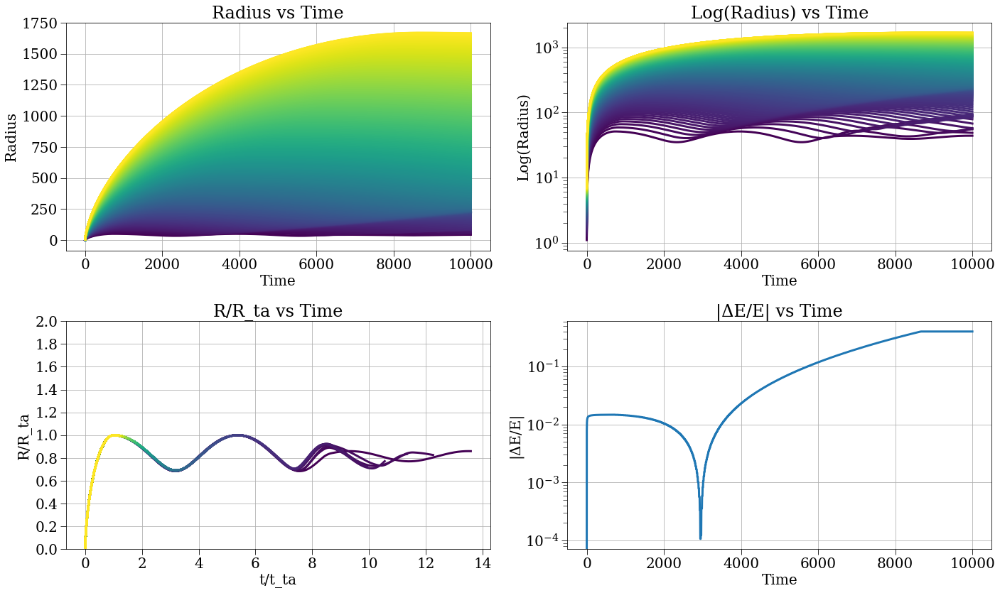

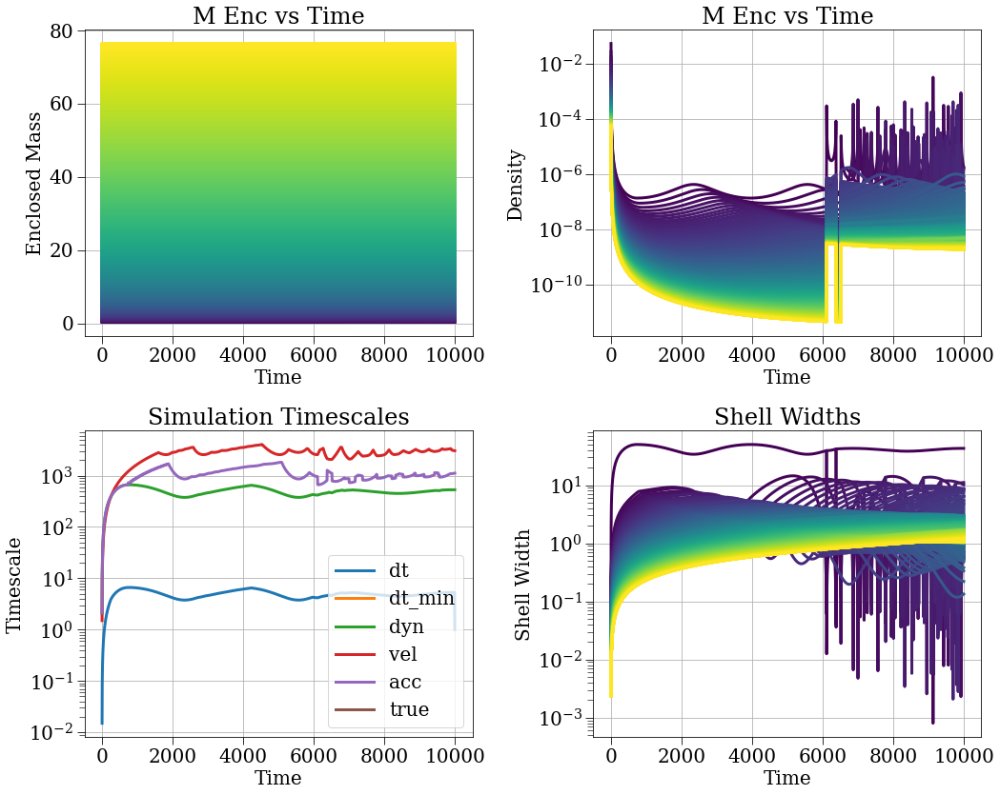

In [49]:
config = make_config(N=N, r_min=r_min, r_max=r_max, t_max=t_max, j_coef=j_coef, save_dt=save_dt, density_strategy=density_strategy, delta=delta, safety_factor=safety_factor, stepper_strategy='leapfrog_hut',  timescale_strategy=tss, H=H0, initial_radius_strategy=irs, gamma=gamma, initial_v_strategy=ivs, accel_strategy=accel_strategy, ang_mom_strategy=ang_mom_strategy, save_filename='8-6-1.h5', r_small=1, softlen=softlen, problematic_shell_strategy=problematic_shell_strategy, thickness_coef=thickness_coef, m_enc_strategy=mes, save_strategy=save_strategy, hbar2_over_m2=hbar2_over_m2)
sc, results, plotter = run_sc(config, profile=False, plot=True)

(40449,) (100,)


/home/jsipple/.conda/envs/jsipple/lib/python3.7/site-packages/IPython/core/events.py:88: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  func(*args, **kwargs)


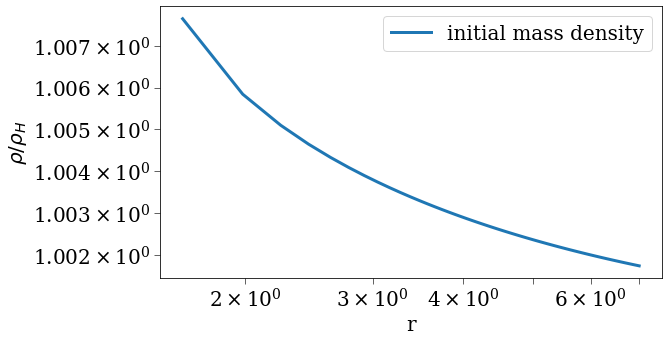

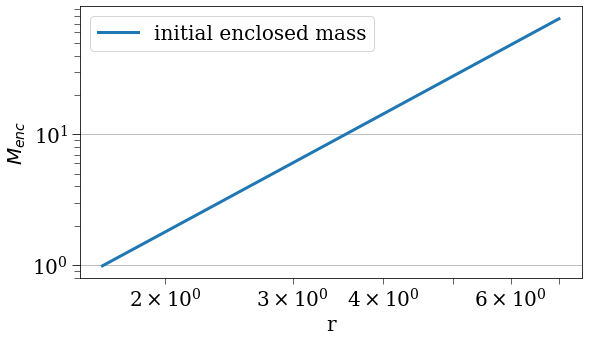

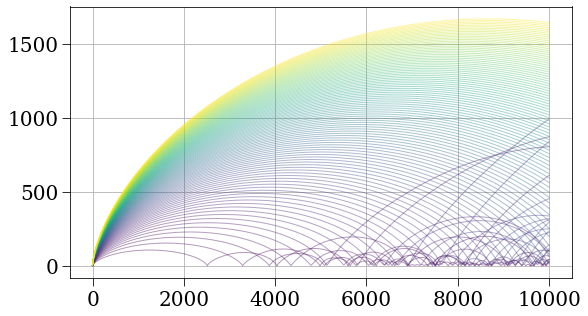

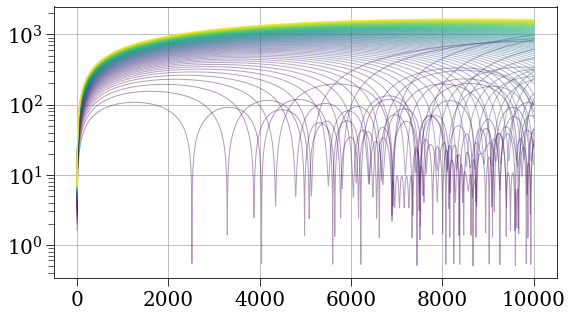

/home/jsipple/.conda/envs/jsipple/lib/python3.7/site-packages/IPython/core/pylabtools.py:128: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


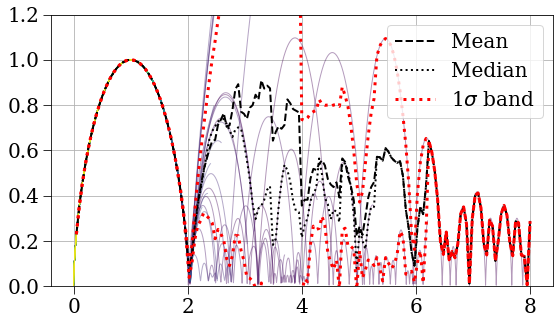

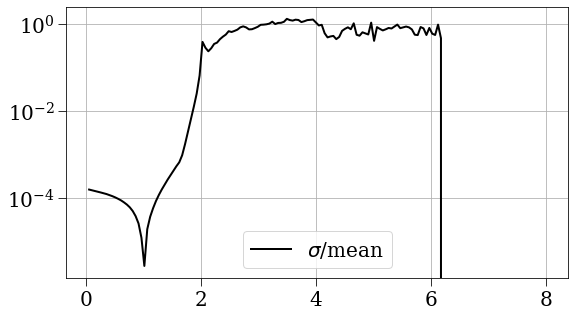

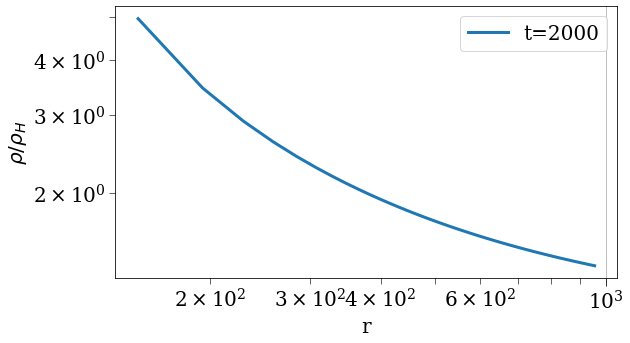

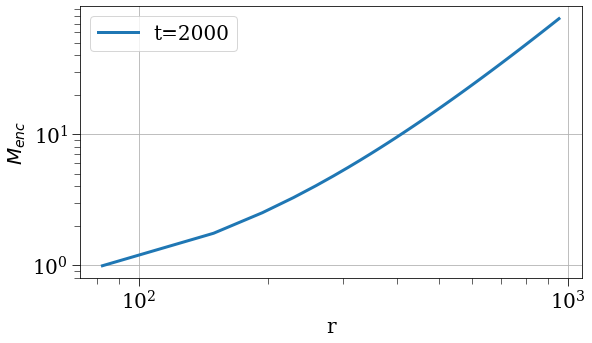

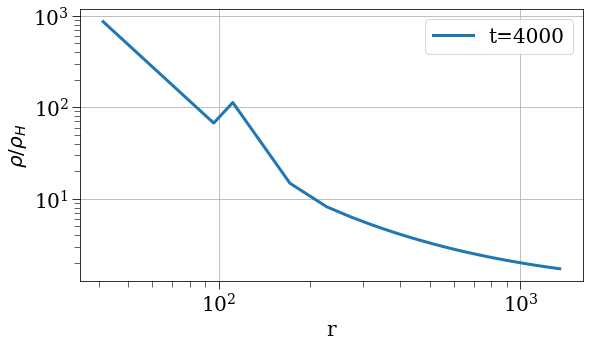

...

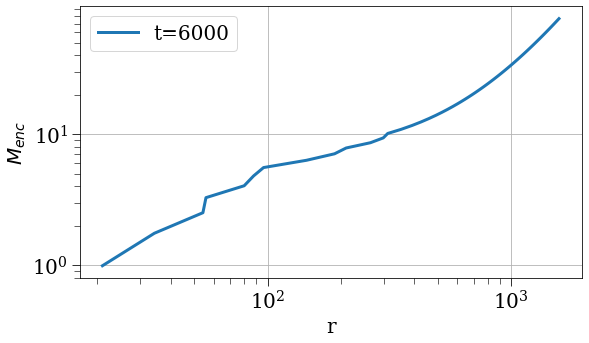

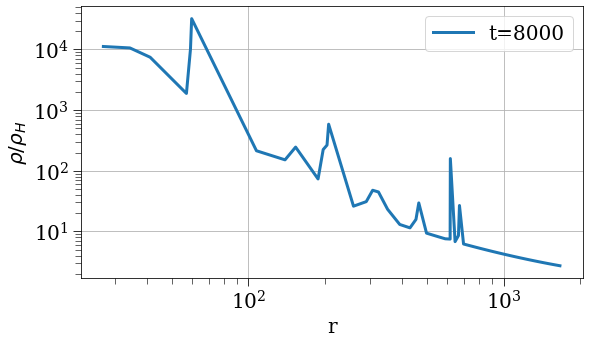

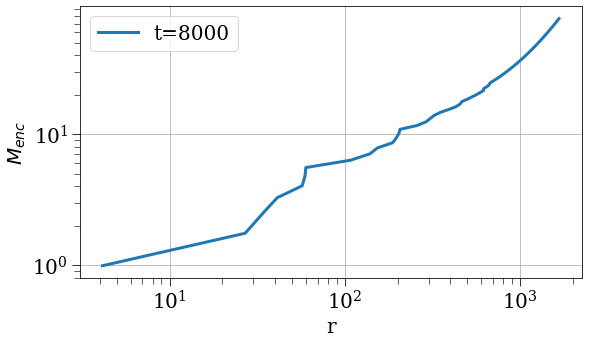

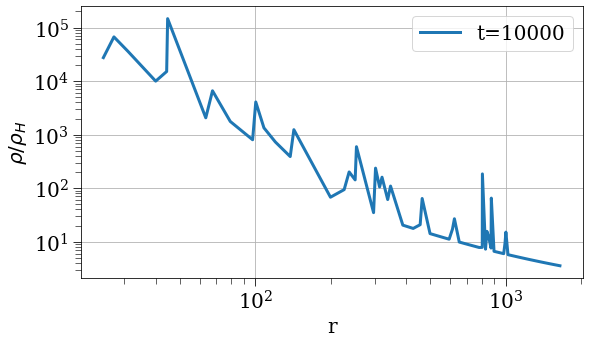

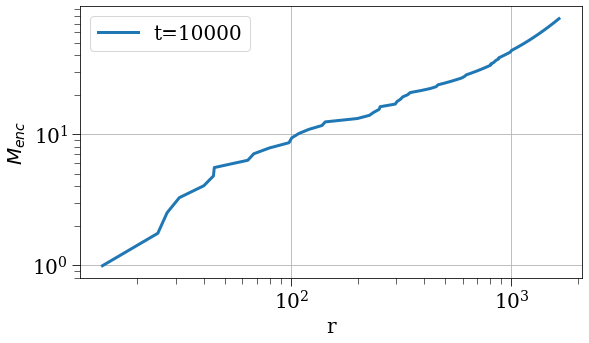

In [27]:
plot_results(results, sc)

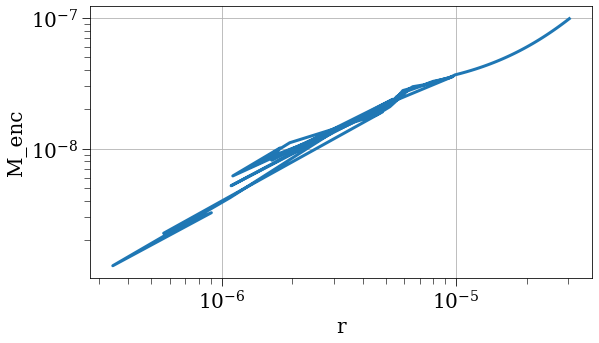

In [23]:
menc = results['m_enc'][-1,:]
rvals = results['r'][-1,:]
t = results['t'][-1]
M0 = menc[-1]
r_on_rt = rvals/t**((2/3)*(2+0.9))
m_on_mt = menc/t**(2/0.9)
plt.figure()
plt.loglog(r_on_rt, m_on_mt)
plt.xlabel('r')
plt.ylabel('M_enc')
plt.show()

{'G': 1,
 'H': 0.6666666666666666,
 'N': 1000,
 'accel_strategy': 'grant_gmr_j_at_r_ta_soft',
 'ang_mom_strategy': 'zero',
 'delta': 0.01,
 'density_strategy': 'background_plus_power_law',
 'deque_size': 0,
 'drhodr_strategy': 'finite_diff',
 'dt': 1e-05,
 'dt_min': 0,
 'energy_strategy': 'kin_grav_rot_absorbed',
 'gamma': -2.5,
 'hbar2_over_m2': 0,
 'initial_mass_strategy': 'integrated_mass',
 'initial_radius_strategy': 'equal_mass',
 'initial_v_strategy': 'peculiar',
 'j_coef': 0.7,
 'm_enc_strategy': 'inclusive',
 'm_pert': 1,
 'next_save_time': 0,
 'num_crossing': 0,
 'point_mass': 0,
 'point_mass_strategy': 'rmin_rho_r',
 'polytropic_coef': 0,
 'polytropic_index': -1,
 'pressure_strategy': 'zero',
 'problematic_shell_strategy': 'nothing',
 'r0_min': 1.001,
 'r_max': 2,
 'r_min': 1,
 'r_min_strategy': 'nothing',
 'r_small': 1,
 'r_ta_strategy': 'r_ta_cycloid',
 'relaxation_time': 0,
 'rho_bar': 0.05305164769729845,
 'safety_factor': 0.01,
 'save_dt': 0.01,
 'save_filename': '8-5-4.

2025-08-06 04:08:07,885 - collapse - INFO - Simulation setup complete


2025-08-06 04:08:15,188 - DEBUG - Saved dataset t with shape (11171,)
2025-08-06 04:08:15,190 - DEBUG - Saved dataset dt with shape (11171,)
2025-08-06 04:08:15,298 - DEBUG - Saved dataset r with shape (11171, 1000)


2025-08-06 04:08:15,393 - DEBUG - Saved dataset v with shape (11171, 1000)
2025-08-06 04:08:15,489 - DEBUG - Saved dataset a with shape (11171, 1000)
2025-08-06 04:08:15,580 - DEBUG - Saved dataset m_enc with shape (11171, 1000)
2025-08-06 04:08:15,665 - DEBUG - Saved dataset rho_r with shape (11171, 1000)
2025-08-06 04:08:15,666 - WARNING - Skipping pressure because all values are None
2025-08-06 04:08:15,667 - WARNING - Skipping dpressure_drho because all values are None
2025-08-06 04:08:15,669 - WARNING - Skipping rho_prime because all values are None
2025-08-06 04:08:15,771 - DEBUG - Saved dataset e_tot with shape (11171, 1000)
2025-08-06 04:08:15,859 - DEBUG - Saved dataset e_g with shape (11171, 1000)
2025-08-06 04:08:16,020 - DEBUG - Saved dataset e_k with shape (11171, 1000)
2025-08-06 04:08:16,116 - DEBUG - Saved dataset e_r with shape (11171, 1000)
2025-08-06 04:08:16,118 - WARNING - Skipping e_p because all values are None
2025-08-06 04:08:16,119 - WARNING - Skipping e_q bec

2025-08-06 04:08:18,062 - INFO - Saved simulation data and parameters to 8-5-4.h5


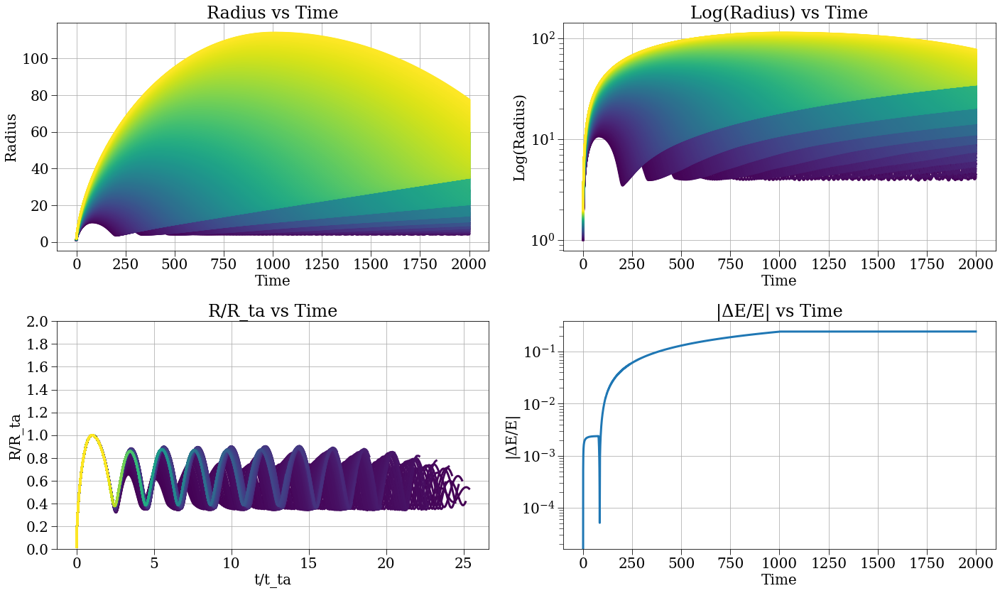

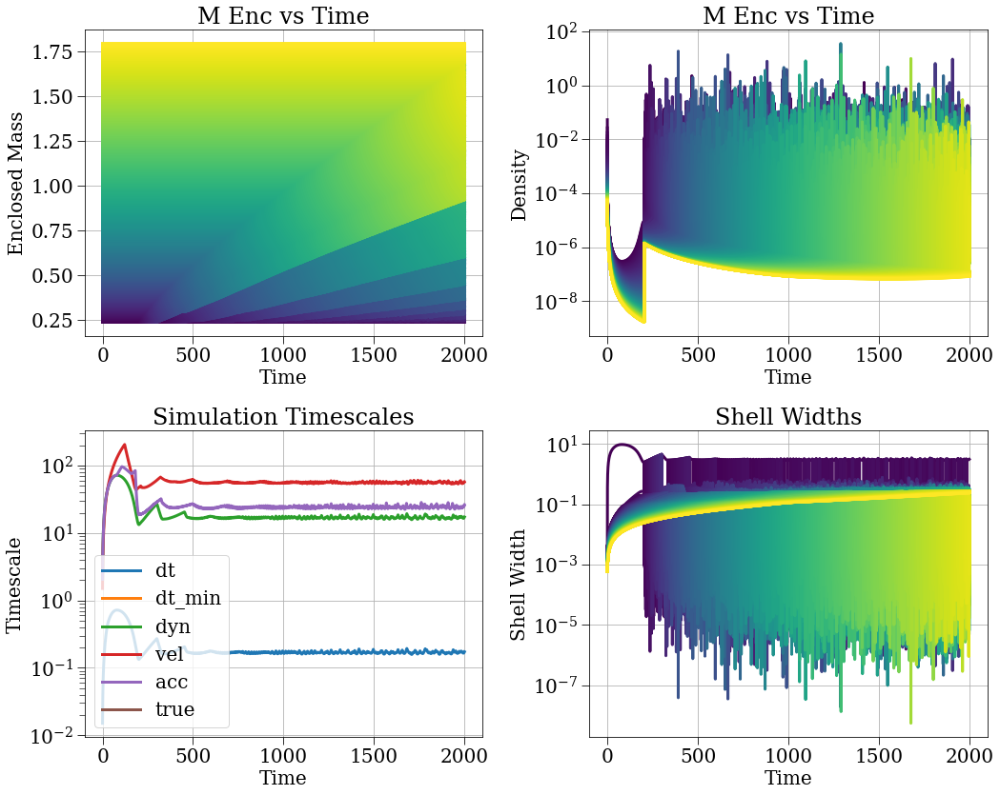

In [31]:
config = make_config(N=N, r_min=r_min, r_max=r_max, t_max=t_max, j_coef=j_coef, save_dt=save_dt, density_strategy=density_strategy, delta=delta, safety_factor=safety_factor, stepper_strategy='leapfrog_hut',  timescale_strategy=tss, H=H0, initial_radius_strategy=irs, gamma=gamma, initial_v_strategy=ivs, accel_strategy=accel_strategy, ang_mom_strategy=ang_mom_strategy, save_filename='8-5-4.h5', r_small=1, softlen=softlen, problematic_shell_strategy=problematic_shell_strategy, thickness_coef=thickness_coef, m_enc_strategy=mes, save_strategy=save_strategy, hbar2_over_m2=hbar2_over_m2)
sc, results, plotter = run_sc(config, profile=False, plot=True)

{'G': 1,
 'H': 0.6666666666666666,
 'N': 1000,
 'accel_strategy': 'grant_gmr_j_at_r_ta_soft',
 'ang_mom_strategy': 'zero',
 'delta': 0.01,
 'density_strategy': 'background_plus_power_law',
 'deque_size': 0,
 'drhodr_strategy': 'finite_diff',
 'dt': 1e-05,
 'dt_min': 0,
 'energy_strategy': 'kin_grav_rot_absorbed',
 'gamma': -2.5,
 'hbar2_over_m2': 0,
 'initial_mass_strategy': 'integrated_mass',
 'initial_radius_strategy': 'equal_mass',
 'initial_v_strategy': 'hubble',
 'j_coef': 0.7,
 'm_enc_strategy': 'inclusive',
 'm_pert': 1,
 'next_save_time': 0,
 'num_crossing': 0,
 'point_mass': 0,
 'point_mass_strategy': 'rmin_rho_r',
 'polytropic_coef': 0,
 'polytropic_index': -1,
 'pressure_strategy': 'zero',
 'problematic_shell_strategy': 'nothing',
 'r0_min': 1.001,
 'r_max': 2,
 'r_min': 1,
 'r_min_strategy': 'nothing',
 'r_small': 1,
 'r_ta_strategy': 'r_ta_cycloid',
 'relaxation_time': 0,
 'rho_bar': 0.05305164769729845,
 'safety_factor': 0.01,
 'save_dt': 0.01,
 'save_filename': '8-5-4.h5

2025-08-06 03:52:53,574 - collapse - INFO - Simulation setup complete


2025-08-06 03:52:59,951 - DEBUG - Saved dataset t with shape (10450,)
2025-08-06 03:52:59,953 - DEBUG - Saved dataset dt with shape (10450,)


2025-08-06 03:53:00,082 - DEBUG - Saved dataset r with shape (10450, 1000)
2025-08-06 03:53:00,193 - DEBUG - Saved dataset v with shape (10450, 1000)
2025-08-06 03:53:00,293 - DEBUG - Saved dataset a with shape (10450, 1000)
2025-08-06 03:53:00,397 - DEBUG - Saved dataset m_enc with shape (10450, 1000)
2025-08-06 03:53:00,500 - DEBUG - Saved dataset rho_r with shape (10450, 1000)
2025-08-06 03:53:00,502 - WARNING - Skipping pressure because all values are None
2025-08-06 03:53:00,503 - WARNING - Skipping dpressure_drho because all values are None
2025-08-06 03:53:00,505 - WARNING - Skipping rho_prime because all values are None
2025-08-06 03:53:00,674 - DEBUG - Saved dataset e_tot with shape (10450, 1000)
2025-08-06 03:53:00,804 - DEBUG - Saved dataset e_g with shape (10450, 1000)
2025-08-06 03:53:01,011 - DEBUG - Saved dataset e_k with shape (10450, 1000)
2025-08-06 03:53:01,146 - DEBUG - Saved dataset e_r with shape (10450, 1000)
2025-08-06 03:53:01,147 - WARNING - Skipping e_p becau

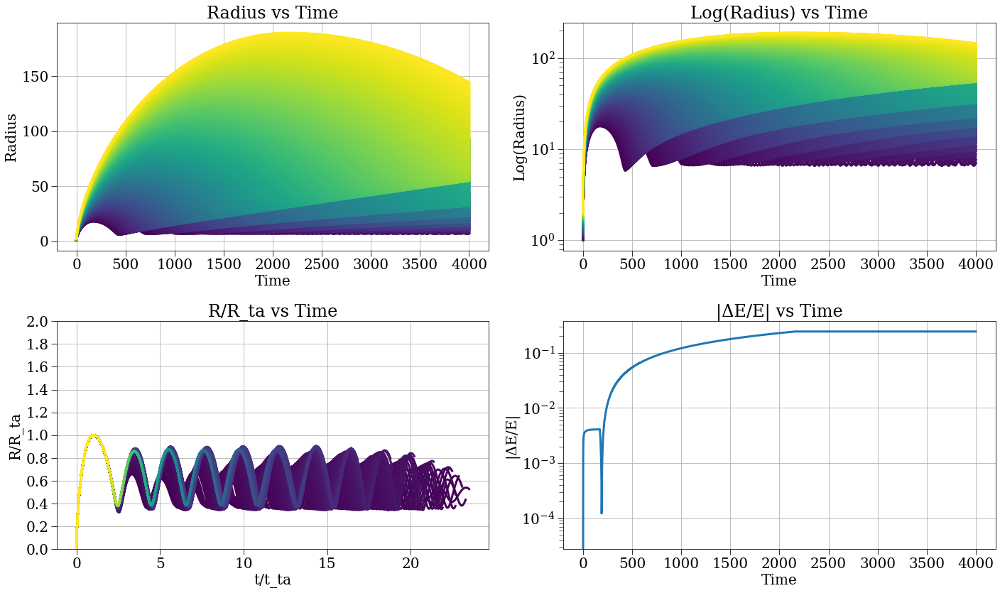

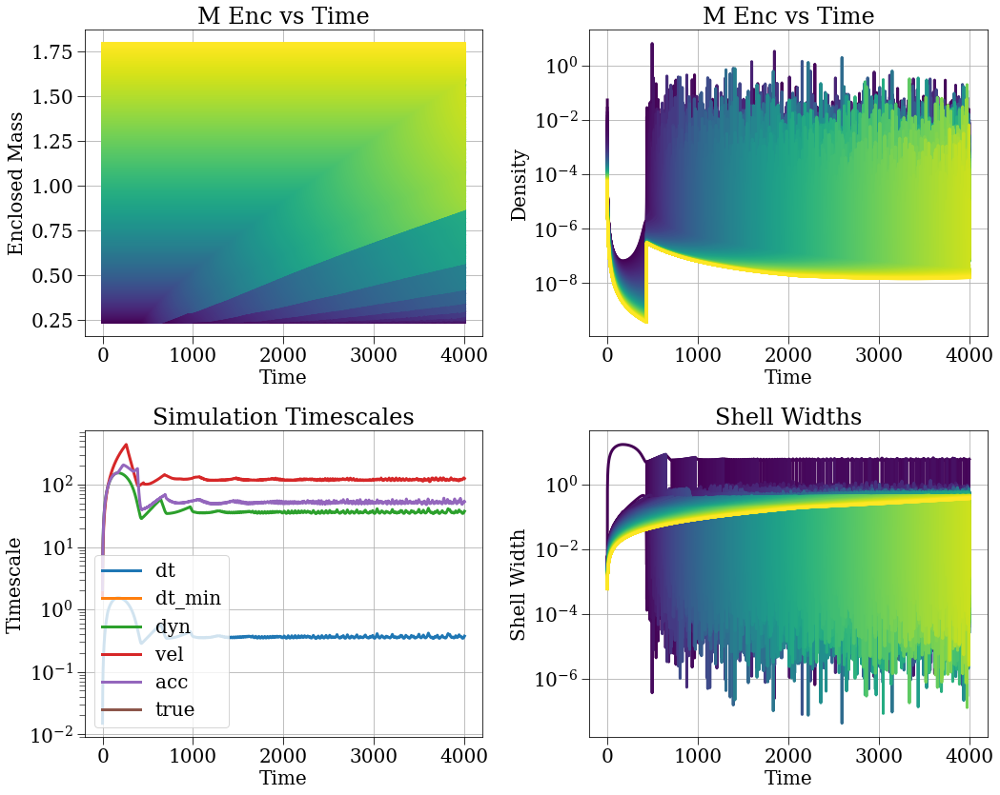

In [25]:
config = make_config(N=N, r_min=r_min, r_max=r_max, t_max=t_max, j_coef=j_coef, save_dt=save_dt, density_strategy=density_strategy, delta=delta, safety_factor=safety_factor, stepper_strategy='leapfrog_hut',  timescale_strategy=tss, H=H0, initial_radius_strategy=irs, gamma=gamma, initial_v_strategy=ivs, accel_strategy=accel_strategy, ang_mom_strategy=ang_mom_strategy, save_filename='8-5-4.h5', r_small=1, softlen=softlen, problematic_shell_strategy=problematic_shell_strategy, thickness_coef=thickness_coef, m_enc_strategy=mes, save_strategy=save_strategy, hbar2_over_m2=hbar2_over_m2)
sc, results, plotter = run_sc(config, profile=False, plot=True)

{'G': 1,
 'H': 0.6666666666666666,
 'N': 1000,
 'accel_strategy': 'soft_all',
 'ang_mom_strategy': 'const',
 'delta': 0.01,
 'density_strategy': 'background_plus_power_law',
 'deque_size': 0,
 'drhodr_strategy': 'finite_diff',
 'dt': 1e-05,
 'dt_min': 0,
 'energy_strategy': 'kin_grav_rot_absorbed',
 'gamma': -2.5,
 'hbar2_over_m2': 0,
 'initial_mass_strategy': 'integrated_mass',
 'initial_radius_strategy': 'equal_mass',
 'initial_v_strategy': 'hubble',
 'j_coef': 0.01,
 'm_enc_strategy': 'inclusive',
 'm_pert': 1,
 'next_save_time': 0,
 'num_crossing': 0,
 'point_mass': 0,
 'point_mass_strategy': 'rmin_rho_r',
 'polytropic_coef': 0,
 'polytropic_index': -1,
 'pressure_strategy': 'zero',
 'problematic_shell_strategy': 'nothing',
 'r0_min': 1.0005,
 'r_max': 1.5,
 'r_min': 1,
 'r_min_strategy': 'nothing',
 'r_small': 1,
 'r_ta_strategy': 'r_ta_cycloid',
 'relaxation_time': 0,
 'rho_bar': 0.05305164769729845,
 'safety_factor': 0.01,
 'save_dt': 0.01,
 'save_filename': '8-5-3.h5',
 'save_s

2025-08-06 03:10:43,717 - collapse - INFO - Simulation setup complete


2025-08-06 03:18:51,343 - DEBUG - Saved dataset t with shape (66678,)
2025-08-06 03:18:51,349 - DEBUG - Saved dataset dt with shape (66678,)
2025-08-06 03:18:52,017 - DEBUG - Saved dataset r with shape (66678, 1000)
2025-08-06 03:18:52,561 - DEBUG - Saved dataset v with shape (66678, 1000)
2025-08-06 03:18:53,405 - DEBUG - Saved dataset a with shape (66678, 1000)
2025-08-06 03:18:54,441 - DEBUG - Saved dataset m_enc with shape (66678, 1000)
2025-08-06 03:18:56,008 - DEBUG - Saved dataset rho_r with shape (66678, 1000)
2025-08-06 03:18:56,012 - WARNING - Skipping pressure because all values are None
2025-08-06 03:18:56,015 - WARNING - Skipping dpressure_drho because all values are None
2025-08-06 03:18:56,019 - WARNING - Skipping rho_prime because all values are None
2025-08-06 03:18:57,584 - DEBUG - Saved dataset e_tot with shape (66678, 1000)
2025-08-06 03:18:58,326 - DEBUG - Saved dataset e_g with shape (66678, 1000)
2025-08-06 03:18:59,213 - DEBUG - Saved dataset e_k with shape (666

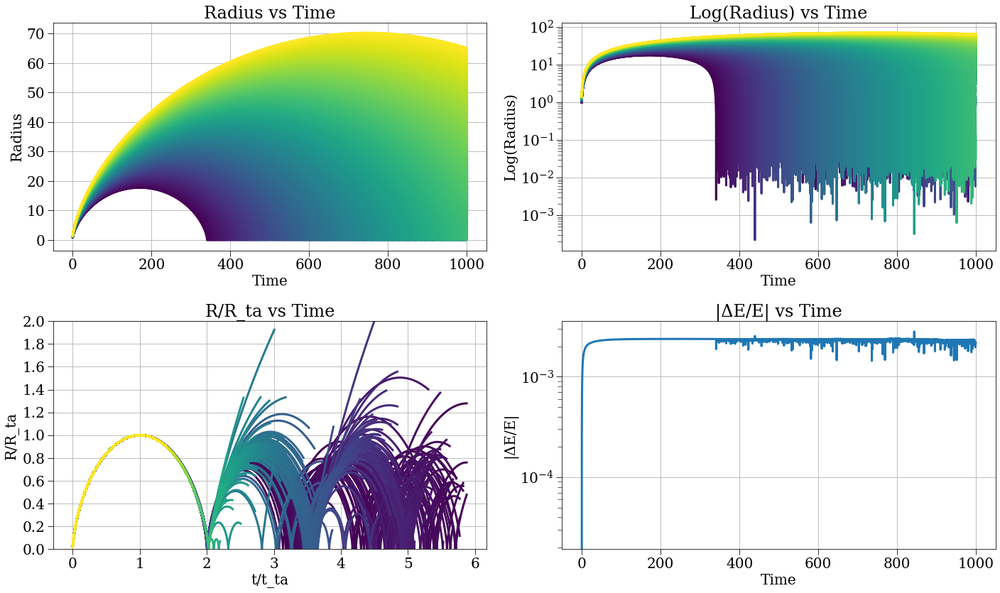

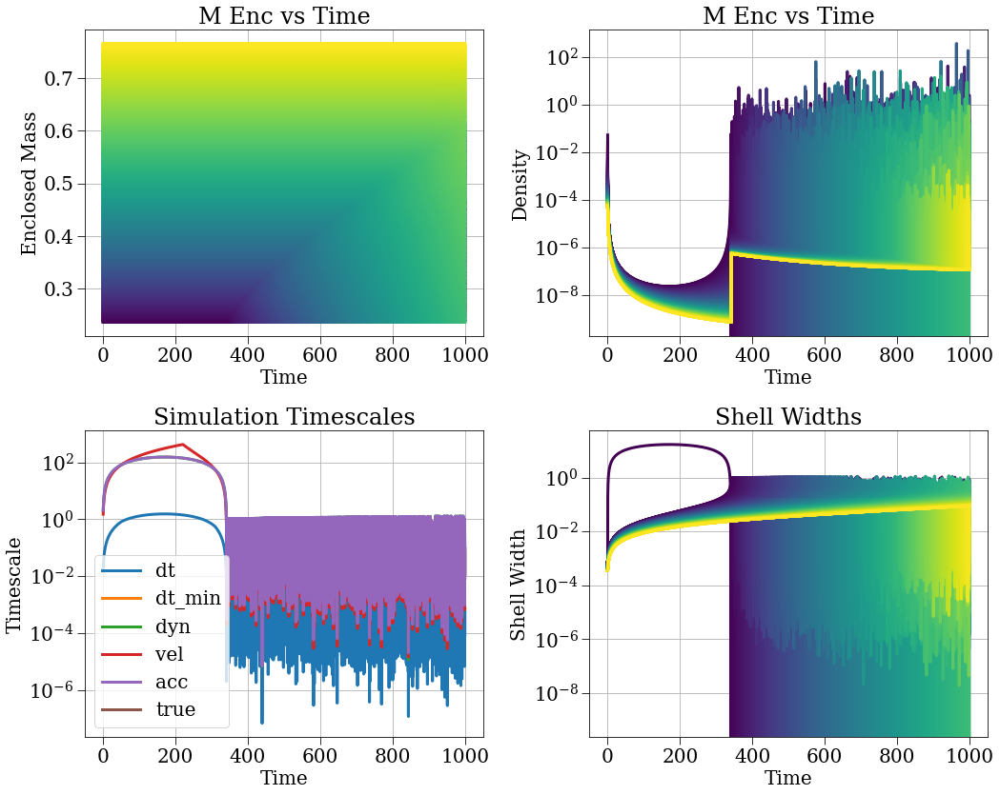

In [23]:
config = make_config(N=N, r_min=r_min, r_max=r_max, t_max=t_max, j_coef=j_coef, save_dt=save_dt, density_strategy=density_strategy, delta=delta, safety_factor=safety_factor, stepper_strategy='leapfrog_hut',  timescale_strategy=tss, H=H0, initial_radius_strategy=irs, gamma=gamma, initial_v_strategy=ivs, accel_strategy=accel_strategy, ang_mom_strategy=ang_mom_strategy, save_filename='8-5-3.h5', r_small=1, softlen=softlen, problematic_shell_strategy=problematic_shell_strategy, thickness_coef=thickness_coef, m_enc_strategy=mes, save_strategy=save_strategy, hbar2_over_m2=hbar2_over_m2)
sc, results, plotter = run_sc(config, profile=False, plot=True)

{'G': 1,
 'H': 0.6666666666666666,
 'N': 1000,
 'accel_strategy': 'soft_all',
 'ang_mom_strategy': 'const',
 'delta': 0.01,
 'density_strategy': 'background_plus_power_law',
 'deque_size': 0,
 'drhodr_strategy': 'finite_diff',
 'dt': 1e-05,
 'dt_min': 0,
 'energy_strategy': 'kin_grav_rot_absorbed',
 'gamma': -2.5,
 'hbar2_over_m2': 0,
 'initial_mass_strategy': 'integrated_mass',
 'initial_radius_strategy': 'equal_mass',
 'initial_v_strategy': 'peculiar',
 'j_coef': 0.01,
 'm_enc_strategy': 'inclusive',
 'm_pert': 1,
 'next_save_time': 0,
 'num_crossing': 0,
 'point_mass': 0,
 'point_mass_strategy': 'rmin_rho_r',
 'polytropic_coef': 0,
 'polytropic_index': -1,
 'pressure_strategy': 'zero',
 'problematic_shell_strategy': 'nothing',
 'r0_min': 1.0005,
 'r_max': 1.5,
 'r_min': 1,
 'r_min_strategy': 'nothing',
 'r_small': 1,
 'r_ta_strategy': 'r_ta_cycloid',
 'relaxation_time': 0,
 'rho_bar': 0.05305164769729845,
 'safety_factor': 0.01,
 'save_dt': 0.01,
 'save_filename': '8-5-2.h5',
 'save

2025-08-06 02:51:23,517 - collapse - INFO - Simulation setup complete


2025-08-06 03:06:53,986 - DEBUG - Saved dataset t with shape (44816,)
2025-08-06 03:06:53,990 - DEBUG - Saved dataset dt with shape (44816,)
2025-08-06 03:06:54,600 - DEBUG - Saved dataset r with shape (44816, 1000)
2025-08-06 03:06:55,210 - DEBUG - Saved dataset v with shape (44816, 1000)
2025-08-06 03:06:55,727 - DEBUG - Saved dataset a with shape (44816, 1000)
2025-08-06 03:06:56,173 - DEBUG - Saved dataset m_enc with shape (44816, 1000)
2025-08-06 03:06:56,771 - DEBUG - Saved dataset rho_r with shape (44816, 1000)
2025-08-06 03:06:56,775 - WARNING - Skipping pressure because all values are None
2025-08-06 03:06:56,778 - WARNING - Skipping dpressure_drho because all values are None
2025-08-06 03:06:56,781 - WARNING - Skipping rho_prime because all values are None
2025-08-06 03:06:57,504 - DEBUG - Saved dataset e_tot with shape (44816, 1000)
2025-08-06 03:06:58,484 - DEBUG - Saved dataset e_g with shape (44816, 1000)
2025-08-06 03:06:59,767 - DEBUG - Saved dataset e_k with shape (448

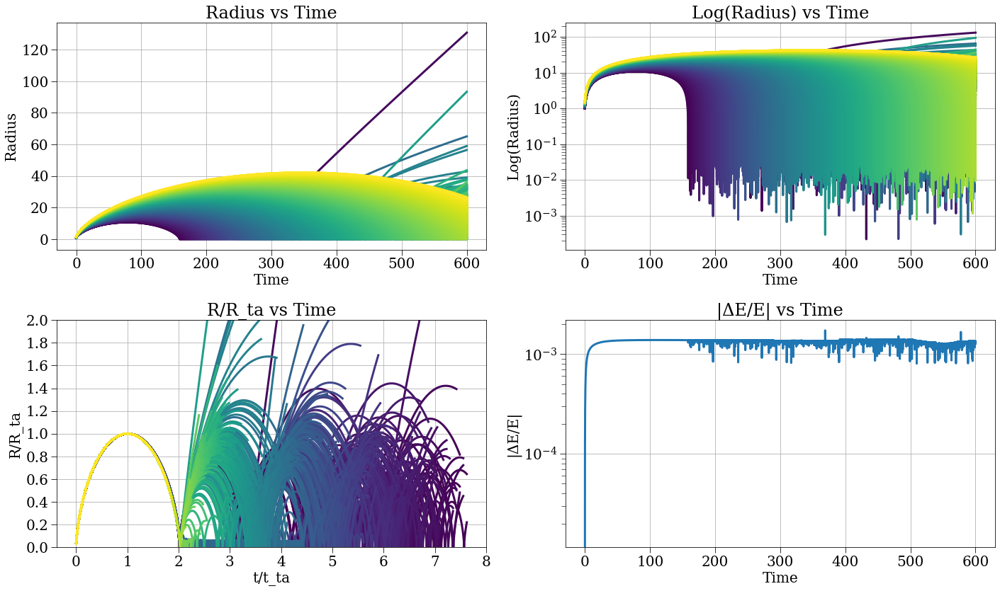

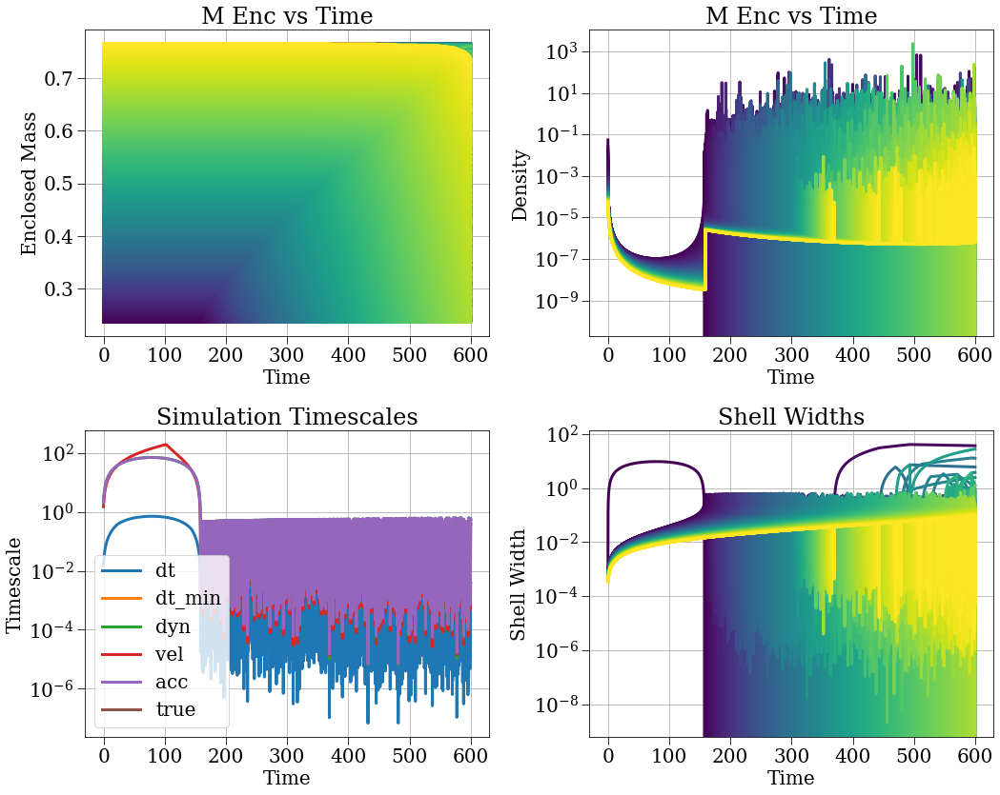

In [21]:
config = make_config(N=N, r_min=r_min, r_max=r_max, t_max=t_max, j_coef=j_coef, save_dt=save_dt, density_strategy=density_strategy, delta=delta, safety_factor=safety_factor, stepper_strategy='leapfrog_hut',  timescale_strategy=tss, H=H0, initial_radius_strategy=irs, gamma=gamma, initial_v_strategy=ivs, accel_strategy=accel_strategy, ang_mom_strategy=ang_mom_strategy, save_filename='8-5-2.h5', r_small=1, softlen=softlen, problematic_shell_strategy=problematic_shell_strategy, thickness_coef=thickness_coef, m_enc_strategy=mes, save_strategy=save_strategy, hbar2_over_m2=hbar2_over_m2)
sc, results, plotter = run_sc(config, profile=False, plot=True)

{'G': 1,
 'H': 0.6666666666666666,
 'N': 1000,
 'accel_strategy': 'grant_gmr_j_at_r_ta_soft',
 'ang_mom_strategy': 'zero',
 'delta': 0.01,
 'density_strategy': 'background_plus_power_law',
 'deque_size': 0,
 'drhodr_strategy': 'finite_diff',
 'dt': 1e-05,
 'dt_min': 0,
 'energy_strategy': 'kin_grav_rot_absorbed',
 'gamma': -2.5,
 'hbar2_over_m2': 0,
 'initial_mass_strategy': 'integrated_mass',
 'initial_radius_strategy': 'equal_mass',
 'initial_v_strategy': 'peculiar',
 'j_coef': 0.7,
 'm_enc_strategy': 'inclusive',
 'm_pert': 1,
 'next_save_time': 0,
 'num_crossing': 0,
 'point_mass': 0,
 'point_mass_strategy': 'rmin_rho_r',
 'polytropic_coef': 0,
 'polytropic_index': -1,
 'pressure_strategy': 'zero',
 'problematic_shell_strategy': 'nothing',
 'r0_min': 1.001,
 'r_max': 2,
 'r_min': 1,
 'r_min_strategy': 'nothing',
 'r_small': 1,
 'r_ta_strategy': 'r_ta_cycloid',
 'relaxation_time': 0,
 'rho_bar': 0.05305164769729845,
 'safety_factor': 0.0001,
 'save_dt': 1,
 'save_filename': '8-5-1.h

2025-08-05 12:03:27,237 - collapse - INFO - Simulation setup complete


2025-08-05 12:07:31,490 - DEBUG - Saved dataset t with shape (1001,)
2025-08-05 12:07:31,492 - DEBUG - Saved dataset dt with shape (1001,)
2025-08-05 12:07:31,504 - DEBUG - Saved dataset r with shape (1001, 1000)
2025-08-05 12:07:31,515 - DEBUG - Saved dataset v with shape (1001, 1000)
2025-08-05 12:07:31,525 - DEBUG - Saved dataset a with shape (1001, 1000)
2025-08-05 12:07:31,535 - DEBUG - Saved dataset m_enc with shape (1001, 1000)
2025-08-05 12:07:31,546 - DEBUG - Saved dataset rho_r with shape (1001, 1000)
2025-08-05 12:07:31,547 - WARNING - Skipping pressure because all values are None
2025-08-05 12:07:31,548 - WARNING - Skipping dpressure_drho because all values are None
2025-08-05 12:07:31,549 - WARNING - Skipping rho_prime because all values are None
2025-08-05 12:07:31,561 - DEBUG - Saved dataset e_tot with shape (1001, 1000)
2025-08-05 12:07:31,571 - DEBUG - Saved dataset e_g with shape (1001, 1000)
2025-08-05 12:07:31,580 - DEBUG - Saved dataset e_k with shape (1001, 1000)


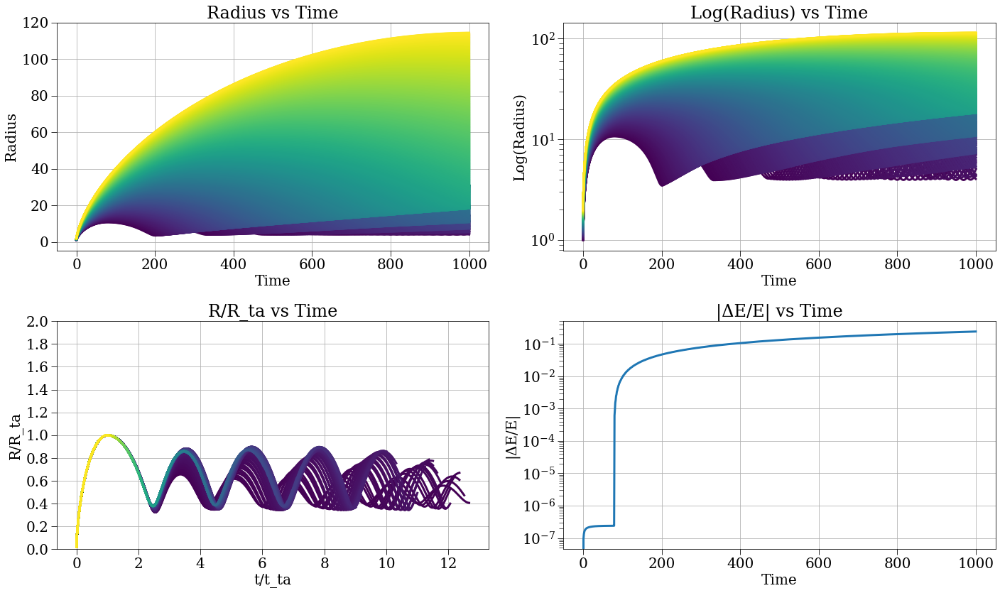

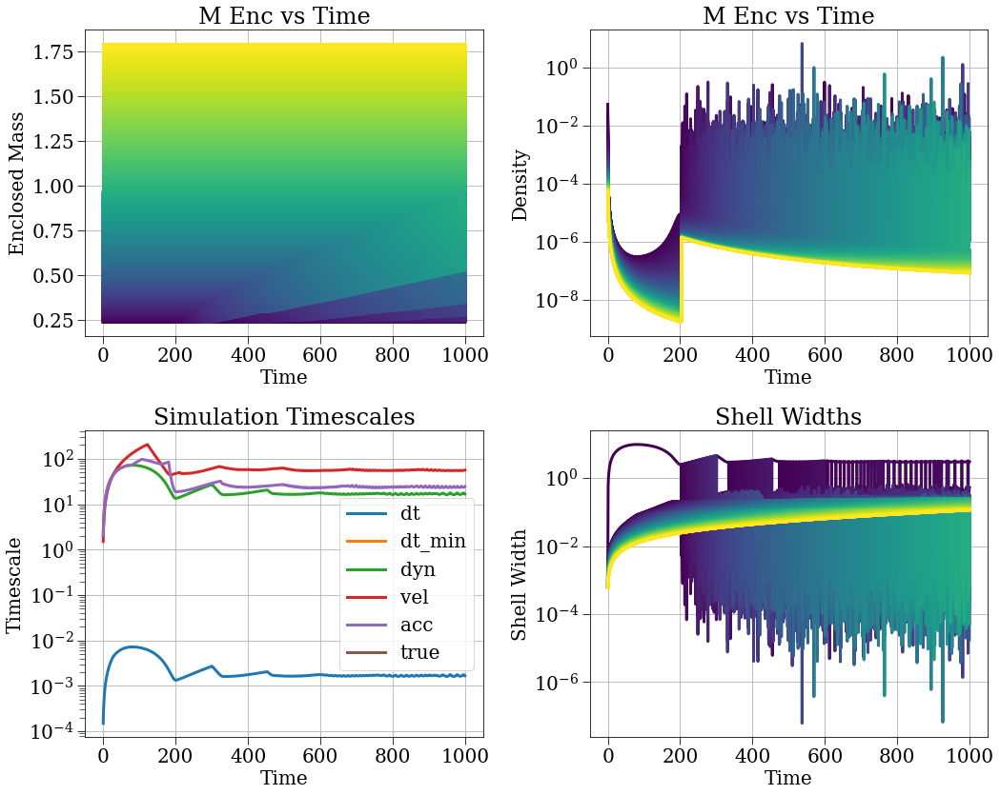

In [31]:
config = make_config(N=N, r_min=r_min, r_max=r_max, t_max=t_max, j_coef=j_coef, save_dt=save_dt, density_strategy=density_strategy, delta=delta, safety_factor=safety_factor, stepper_strategy='leapfrog_hut',  timescale_strategy=tss, H=H0, initial_radius_strategy=irs, gamma=gamma, initial_v_strategy=ivs, accel_strategy=accel_strategy, ang_mom_strategy=ang_mom_strategy, save_filename='8-5-1.h5', r_small=1, softlen=softlen, problematic_shell_strategy=problematic_shell_strategy, thickness_coef=thickness_coef, m_enc_strategy=mes, save_strategy=save_strategy, hbar2_over_m2=hbar2_over_m2)
sc, results, plotter = run_sc(config, profile=False, plot=True)

In [29]:
v0vals = results['v'][0,:]
r0vals = results['r'][0,:]
print(np.max(np.abs(H0 * (1-delta/3) * r0vals - v0vals)))

2.673409911224667e-07


{'G': 1,
 'H': 0.6666666666666666,
 'N': 100,
 'accel_strategy': 'grant_fdm_at_r_ta',
 'ang_mom_strategy': 'zero',
 'delta': 0.01,
 'density_strategy': 'background_plus_power_law',
 'deque_size': 0,
 'drhodr_strategy': 'finite_diff',
 'dt': 1e-05,
 'dt_min': 0,
 'energy_strategy': 'kin_grav_rot_absorbed',
 'gamma': -2.5,
 'hbar2_over_m2': 0,
 'initial_mass_strategy': 'integrated_mass',
 'initial_radius_strategy': 'equal_mass',
 'initial_v_strategy': 'peculiar',
 'j_coef': 0.7,
 'm_enc_strategy': 'inclusive',
 'm_pert': 1,
 'next_save_time': 0,
 'num_crossing': 0,
 'point_mass': 0,
 'point_mass_strategy': 'rmin_rho_r',
 'polytropic_coef': 0,
 'polytropic_index': -1,
 'pressure_strategy': 'zero',
 'problematic_shell_strategy': 'nothing',
 'r0_min': 1.01,
 'r_max': 2,
 'r_min': 1,
 'r_min_strategy': 'nothing',
 'r_small': 1,
 'r_ta_strategy': 'r_ta_cycloid',
 'relaxation_time': 0,
 'rho_bar': 0.05305164769729845,
 'safety_factor': 0.0001,
 'save_dt': 1,
 'save_filename': '8-4-2.h5',
 'sav

2025-08-04 19:22:53,503 - collapse - INFO - Simulation setup complete


2025-08-04 19:23:26,412 - DEBUG - Saved dataset t with shape (236,)
2025-08-04 19:23:26,414 - DEBUG - Saved dataset dt with shape (236,)
2025-08-04 19:23:26,417 - DEBUG - Saved dataset r with shape (236, 100)
2025-08-04 19:23:26,420 - DEBUG - Saved dataset v with shape (236, 100)
2025-08-04 19:23:26,422 - DEBUG - Saved dataset a with shape (236, 100)
2025-08-04 19:23:26,424 - DEBUG - Saved dataset m_enc with shape (236, 100)
2025-08-04 19:23:26,426 - DEBUG - Saved dataset rho_r with shape (236, 100)
2025-08-04 19:23:26,427 - WARNING - Skipping pressure because all values are None
2025-08-04 19:23:26,428 - WARNING - Skipping dpressure_drho because all values are None
2025-08-04 19:23:26,429 - WARNING - Skipping rho_prime because all values are None
2025-08-04 19:23:26,432 - DEBUG - Saved dataset e_tot with shape (236, 100)
2025-08-04 19:23:26,434 - DEBUG - Saved dataset e_g with shape (236, 100)
2025-08-04 19:23:26,436 - DEBUG - Saved dataset e_k with shape (236, 100)
2025-08-04 19:23:2

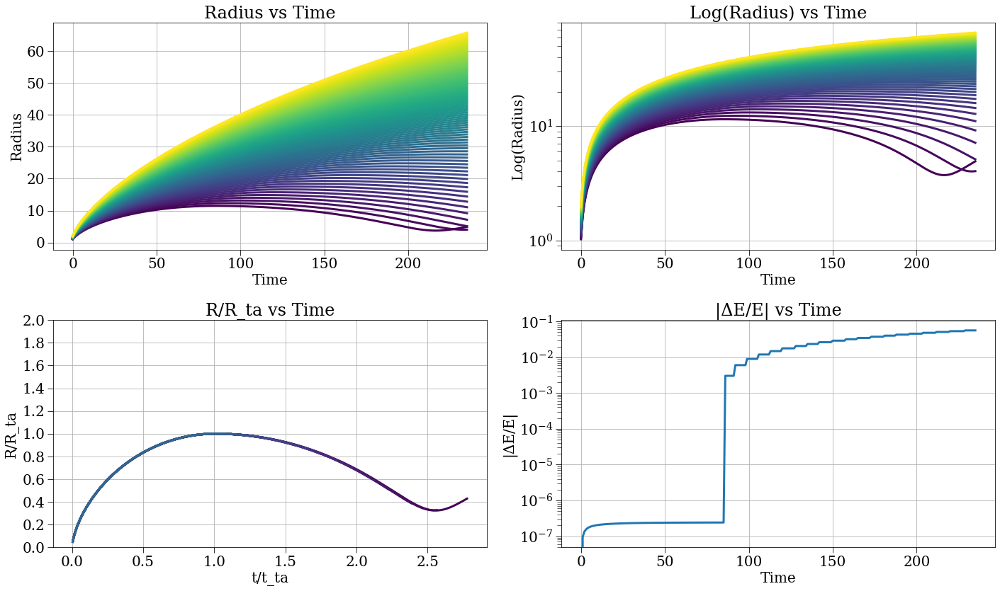

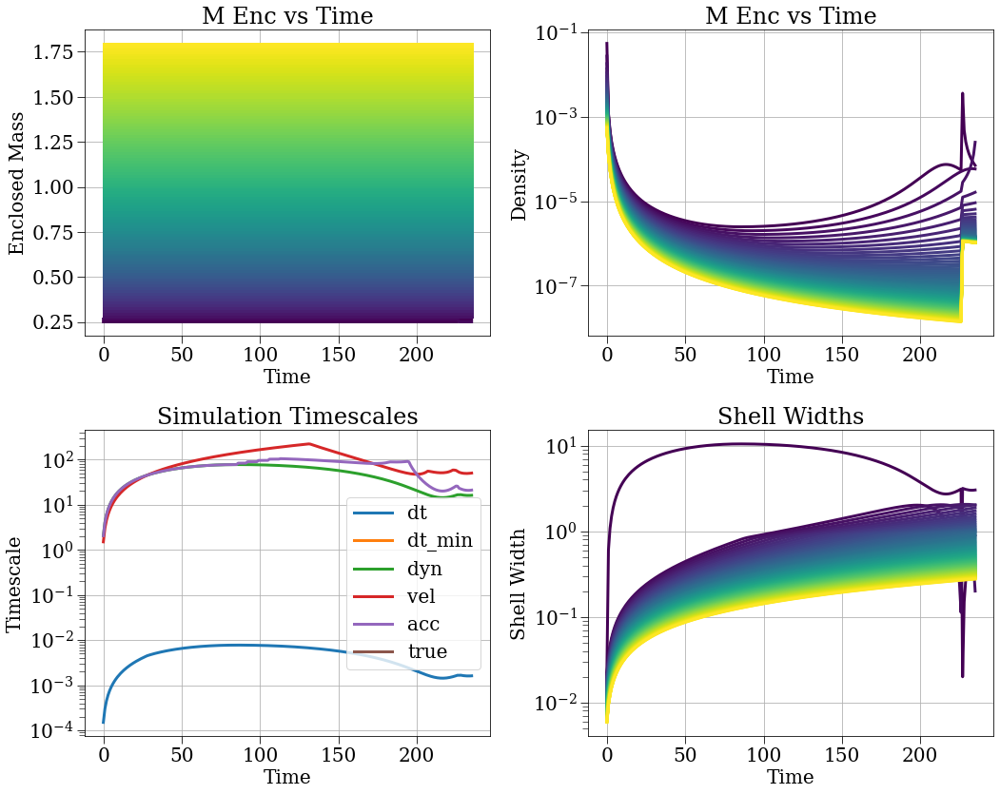

In [6]:
config = make_config(N=N, r_min=r_min, r_max=r_max, t_max=t_max, j_coef=j_coef, save_dt=save_dt, density_strategy=density_strategy, delta=delta, safety_factor=safety_factor, stepper_strategy='leapfrog_hut',  timescale_strategy=tss, H=H0, initial_radius_strategy=irs, gamma=gamma, initial_v_strategy=ivs, accel_strategy=accel_strategy, ang_mom_strategy=ang_mom_strategy, save_filename='8-4-2.h5', r_small=1, softlen=softlen, problematic_shell_strategy=problematic_shell_strategy, thickness_coef=thickness_coef, m_enc_strategy=mes, save_strategy=save_strategy, hbar2_over_m2=hbar2_over_m2)
sc, results, plotter = run_sc(config, profile=False, plot=True)

{'G': 1,
 'H': 0.6666666666666666,
 'N': 12000,
 'accel_strategy': 'grant_gmr_j_at_r_ta_soft',
 'ang_mom_strategy': 'zero',
 'delta': 0.01,
 'density_strategy': 'background_plus_power_law',
 'deque_size': 0,
 'drhodr_strategy': 'finite_diff',
 'dt': 1e-05,
 'dt_min': 0,
 'energy_strategy': 'kin_grav_rot_absorbed',
 'gamma': -2.5,
 'hbar2_over_m2': 0,
 'initial_mass_strategy': 'integrated_mass',
 'initial_radius_strategy': 'equal_mass',
 'initial_v_strategy': 'peculiar',
 'j_coef': 0.9,
 'm_enc_strategy': 'inclusive',
 'm_pert': 1,
 'next_save_time': 0,
 'num_crossing': 0,
 'point_mass': 0,
 'point_mass_strategy': 'rmin_rho_r',
 'polytropic_coef': 0,
 'polytropic_index': -1,
 'pressure_strategy': 'zero',
 'problematic_shell_strategy': 'nothing',
 'r0_min': 1.0000833333333334,
 'r_max': 2,
 'r_min': 1,
 'r_min_strategy': 'nothing',
 'r_small': 1,
 'r_ta_strategy': 'r_ta_cycloid',
 'relaxation_time': 0,
 'rho_bar': 0.05305164769729845,
 'safety_factor': 0.01,
 'save_dt': 1,
 'save_filenam

2025-08-04 17:28:59,224 - collapse - INFO - Simulation setup complete


2025-08-04 17:29:15,037 - DEBUG - Saved dataset t with shape (1001,)
2025-08-04 17:29:15,038 - DEBUG - Saved dataset dt with shape (1001,)
2025-08-04 17:29:15,181 - DEBUG - Saved dataset r with shape (1001, 12000)
2025-08-04 17:29:15,298 - DEBUG - Saved dataset v with shape (1001, 12000)
2025-08-04 17:29:15,419 - DEBUG - Saved dataset a with shape (1001, 12000)
2025-08-04 17:29:15,541 - DEBUG - Saved dataset m_enc with shape (1001, 12000)
2025-08-04 17:29:15,665 - DEBUG - Saved dataset rho_r with shape (1001, 12000)
2025-08-04 17:29:15,666 - WARNING - Skipping pressure because all values are None
2025-08-04 17:29:15,667 - WARNING - Skipping dpressure_drho because all values are None
2025-08-04 17:29:15,667 - WARNING - Skipping rho_prime because all values are None
2025-08-04 17:29:15,783 - DEBUG - Saved dataset e_tot with shape (1001, 12000)
2025-08-04 17:29:15,897 - DEBUG - Saved dataset e_g with shape (1001, 12000)
2025-08-04 17:29:16,011 - DEBUG - Saved dataset e_k with shape (1001,

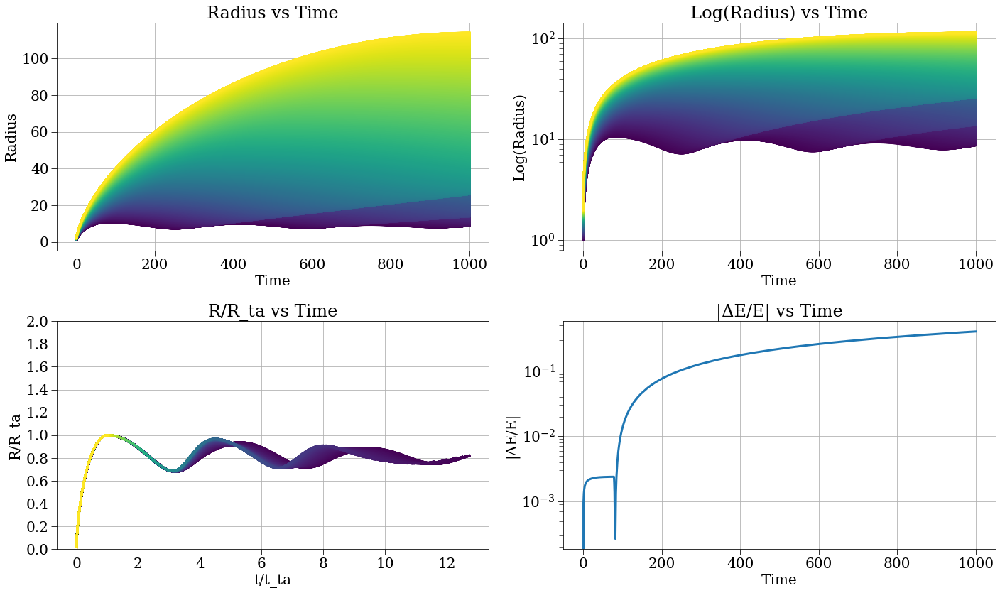

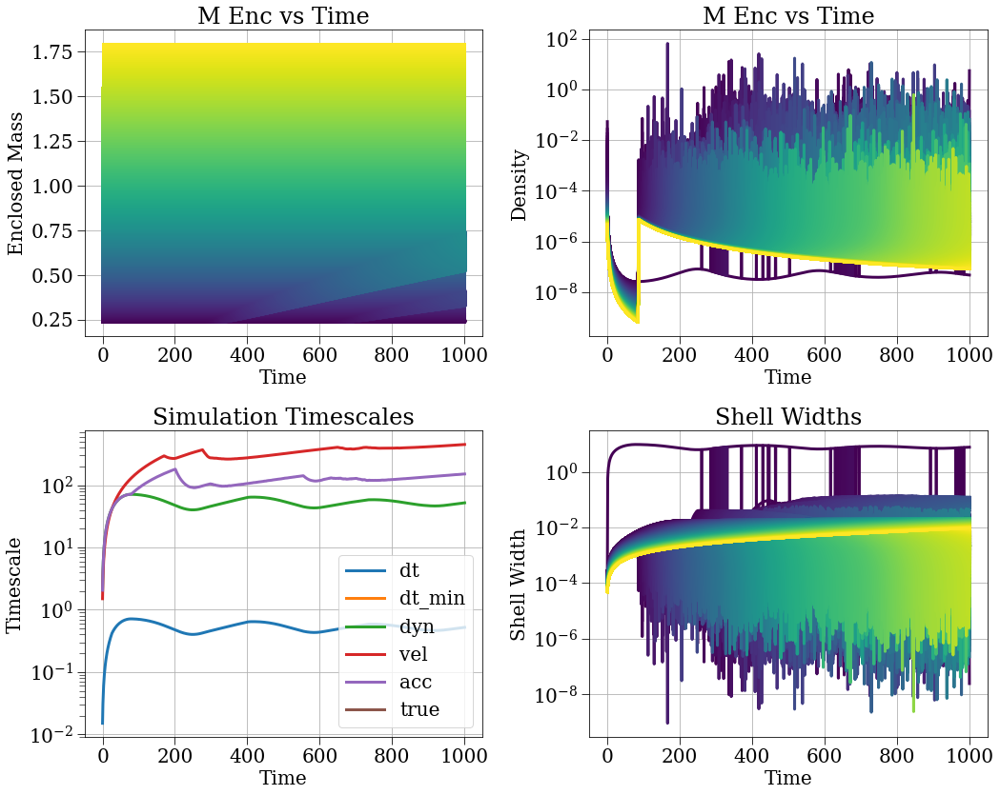

In [6]:
config = make_config(N=N, r_min=r_min, r_max=r_max, t_max=t_max, j_coef=j_coef, save_dt=save_dt, density_strategy=density_strategy, delta=delta, safety_factor=safety_factor, stepper_strategy='leapfrog_hut',  timescale_strategy=tss, H=H0, initial_radius_strategy=irs, gamma=gamma, initial_v_strategy=ivs, accel_strategy=accel_strategy, ang_mom_strategy=ang_mom_strategy, save_filename='8-4-1.h5', r_small=1, softlen=softlen, problematic_shell_strategy=problematic_shell_strategy, thickness_coef=thickness_coef, m_enc_strategy=mes, save_strategy=save_strategy, hbar2_over_m2=hbar2_over_m2)
sc, results, plotter = run_sc(config, profile=False, plot=True)

(1001,) (12000,)


/home/jsipple/.conda/envs/jsipple/lib/python3.7/site-packages/ipykernel_launcher.py:90: RuntimeWarning: divide by zero encountered in true_divide
/home/jsipple/.conda/envs/jsipple/lib/python3.7/site-packages/ipykernel_launcher.py:90: RuntimeWarning: divide by zero encountered in true_divide
/home/jsipple/.conda/envs/jsipple/lib/python3.7/site-packages/ipykernel_launcher.py:90: RuntimeWarning: divide by zero encountered in true_divide
/home/jsipple/.conda/envs/jsipple/lib/python3.7/site-packages/ipykernel_launcher.py:90: RuntimeWarning: divide by zero encountered in true_divide
/home/jsipple/.conda/envs/jsipple/lib/python3.7/site-packages/ipykernel_launcher.py:90: RuntimeWarning: divide by zero encountered in true_divide
/home/jsipple/.conda/envs/jsipple/lib/python3.7/site-packages/ipykernel_launcher.py:90: RuntimeWarning: divide by zero encountered in true_divide
/home/jsipple/.conda/envs/jsipple/lib/python3.7/site-packages/ipykernel_launcher.py:90: RuntimeWarning: divide by zero encou

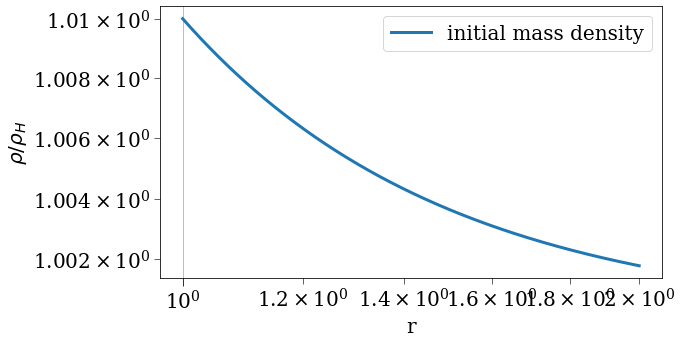

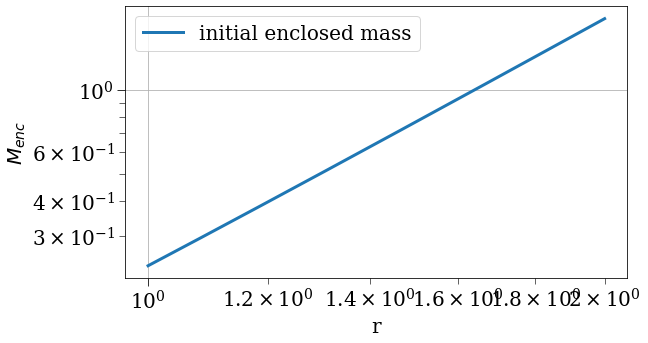

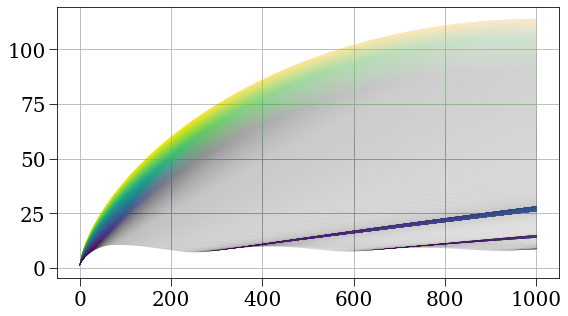

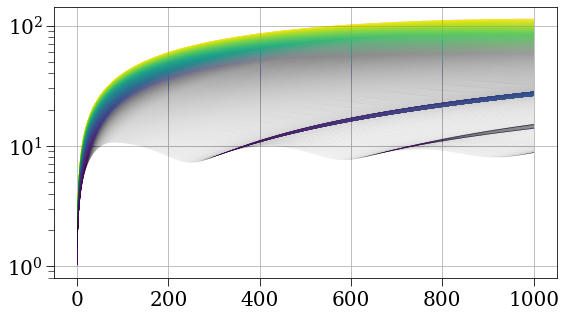

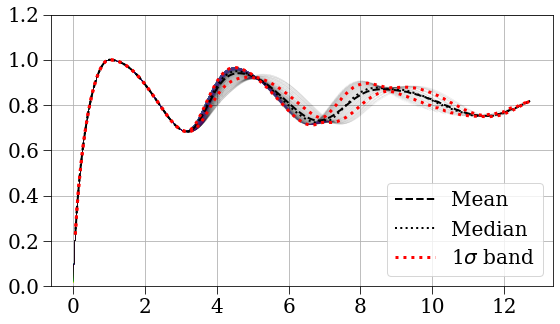

...

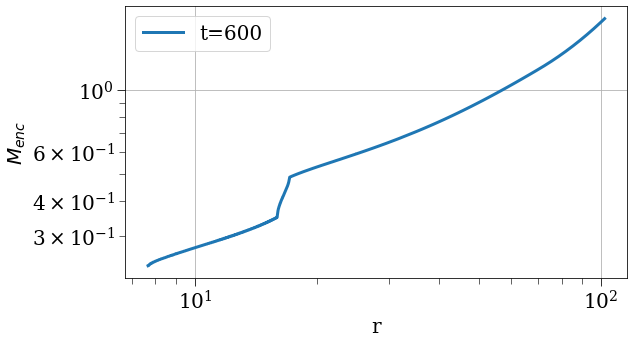

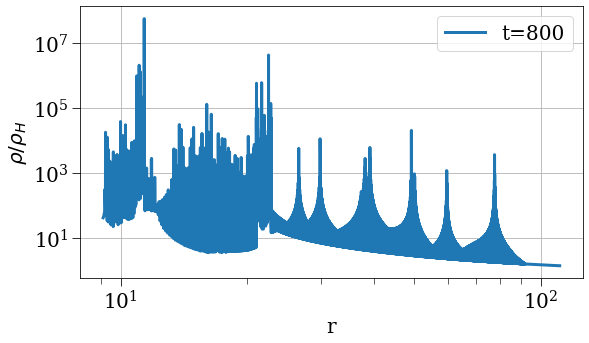

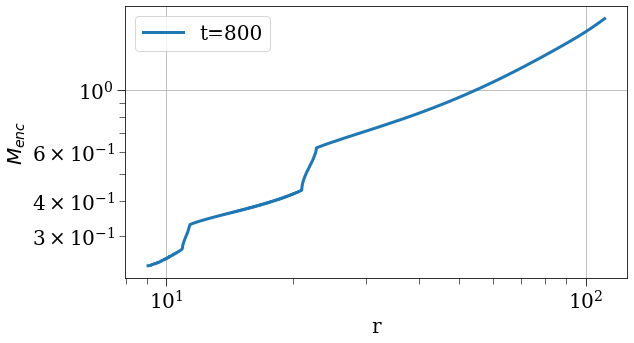

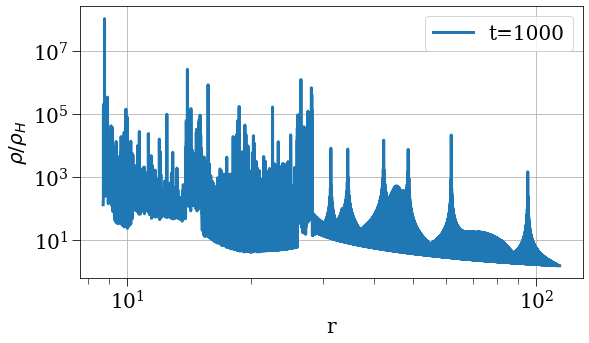

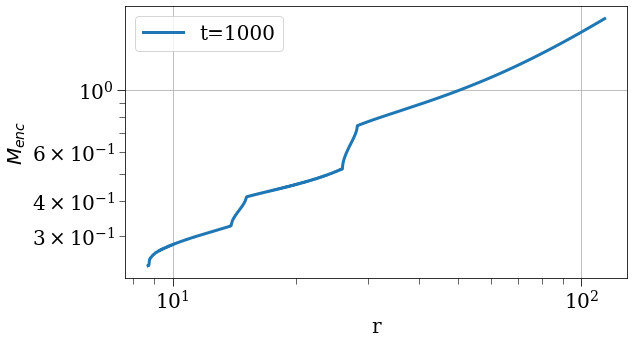

In [7]:
plot_results(results, sc)

In [16]:
config = make_config(N=N, r_min=r_min, r_max=r_max, t_max=t_max, j_coef=j_coef, save_dt=save_dt, density_strategy=density_strategy, delta=delta, safety_factor=safety_factor, stepper_strategy='leapfrog_hut',  timescale_strategy=tss, H=H0, initial_radius_strategy=irs, gamma=gamma, initial_v_strategy=ivs, accel_strategy=accel_strategy, ang_mom_strategy=ang_mom_strategy, save_filename='8-1-1.h5', r_small=1, softlen=softlen, problematic_shell_strategy=problematic_shell_strategy, thickness_coef=thickness_coef, m_enc_strategy=mes, save_strategy=save_strategy, hbar2_over_m2=hbar2_over_m2)
sc, results, plotter = run_sc(config, profile=False, plot=True)

2025-08-01 16:21:16,271 - collapse - INFO - Simulation setup complete


{'G': 1,
 'H': 0.6666666666666666,
 'N': 10,
 'accel_strategy': 'grant_gmr_j_at_r_ta_fdm',
 'ang_mom_strategy': 'zero',
 'delta': 0.01,
 'density_strategy': 'background_plus_power_law',
 'deque_size': 0,
 'drhodr_strategy': 'finite_diff',
 'dt': 1e-05,
 'dt_min': 0,
 'energy_strategy': 'kin_grav_rot_absorbed',
 'gamma': -2.5,
 'hbar2_over_m2': 0.01,
 'initial_mass_strategy': 'integrated_mass',
 'initial_radius_strategy': 'equal_mass',
 'initial_v_strategy': 'hubble',
 'j_coef': 0.7,
 'm_enc_strategy': 'inclusive',
 'm_pert': 1,
 'next_save_time': 0,
 'num_crossing': 0,
 'point_mass': 0,
 'point_mass_strategy': 'rmin_rho_r',
 'polytropic_coef': 0,
 'polytropic_index': -1,
 'pressure_strategy': 'zero',
 'problematic_shell_strategy': 'nothing',
 'r0_min': 1.1,
 'r_max': 2,
 'r_min': 1,
 'r_min_strategy': 'nothing',
 'r_small': 1,
 'r_ta_strategy': 'r_ta_cycloid',
 'relaxation_time': 0,
 'rho_bar': 0.05305164769729845,
 'safety_factor': 0.0001,
 'save_dt': 0.1,
 'save_filename': '8-1-1.h5'

ValueError: Error on input data

{'G': 1,
 'H': 0.6666666666666666,
 'N': 1000,
 'accel_strategy': 'soft_new',
 'ang_mom_strategy': 'const',
 'delta': 0.01,
 'density_strategy': 'background_plus_power_law',
 'deque_size': 0,
 'drhodr_strategy': 'finite_diff',
 'dt': 1e-05,
 'dt_min': 0,
 'energy_strategy': 'kin_grav_rot_absorbed',
 'gamma': -2.5,
 'hbar2_over_m2': 0,
 'initial_mass_strategy': 'integrated_mass',
 'initial_radius_strategy': 'equal_mass',
 'initial_v_strategy': 'hubble',
 'j_coef': 0.01,
 'm_enc_strategy': 'inclusive',
 'm_pert': 1,
 'next_save_time': 0,
 'num_crossing': 0,
 'point_mass': 0,
 'point_mass_strategy': 'rmin_rho_r',
 'polytropic_coef': 0,
 'polytropic_index': -1,
 'pressure_strategy': 'zero',
 'problematic_shell_strategy': 'nothing',
 'r0_min': 1.001,
 'r_max': 2,
 'r_min': 1,
 'r_min_strategy': 'nothing',
 'r_small': 1,
 'r_ta_strategy': 'r_ta_cycloid',
 'relaxation_time': 0,
 'rho_bar': 0.05305164769729845,
 'safety_factor': 0.01,
 'save_dt': 1,
 'save_filename': '7-31-11.h5',
 'save_strat

2025-08-01 04:02:45,724 - collapse - INFO - Simulation setup complete


2025-08-01 04:17:46,565 - DEBUG - Saved dataset t with shape (3947,)
2025-08-01 04:17:46,567 - DEBUG - Saved dataset dt with shape (3947,)
2025-08-01 04:17:46,609 - DEBUG - Saved dataset r with shape (3947, 1000)
2025-08-01 04:17:46,644 - DEBUG - Saved dataset v with shape (3947, 1000)
2025-08-01 04:17:46,679 - DEBUG - Saved dataset a with shape (3947, 1000)


2025-08-01 04:17:46,889 - DEBUG - Saved dataset m_enc with shape (3947, 1000)
2025-08-01 04:17:46,938 - DEBUG - Saved dataset rho_r with shape (3947, 1000)
2025-08-01 04:17:46,939 - WARNING - Skipping pressure because all values are None
2025-08-01 04:17:46,941 - WARNING - Skipping dpressure_drho because all values are None
2025-08-01 04:17:46,942 - WARNING - Skipping rho_prime because all values are None
2025-08-01 04:17:47,000 - DEBUG - Saved dataset e_tot with shape (3947, 1000)
2025-08-01 04:17:47,246 - DEBUG - Saved dataset e_g with shape (3947, 1000)
2025-08-01 04:17:47,333 - DEBUG - Saved dataset e_k with shape (3947, 1000)
2025-08-01 04:17:47,426 - DEBUG - Saved dataset e_r with shape (3947, 1000)
2025-08-01 04:17:47,428 - WARNING - Skipping e_p because all values are None
2025-08-01 04:17:47,429 - WARNING - Skipping e_q because all values are None
2025-08-01 04:17:47,431 - DEBUG - Saved dataset t_dyn with shape (3947,)
2025-08-01 04:17:47,495 - DEBUG - Saved dataset t_vel with

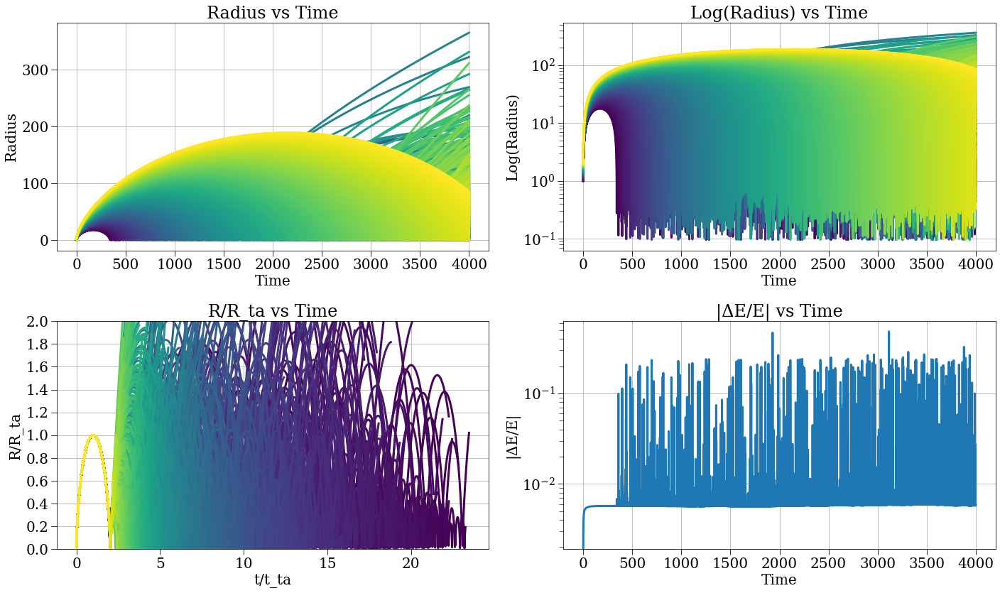

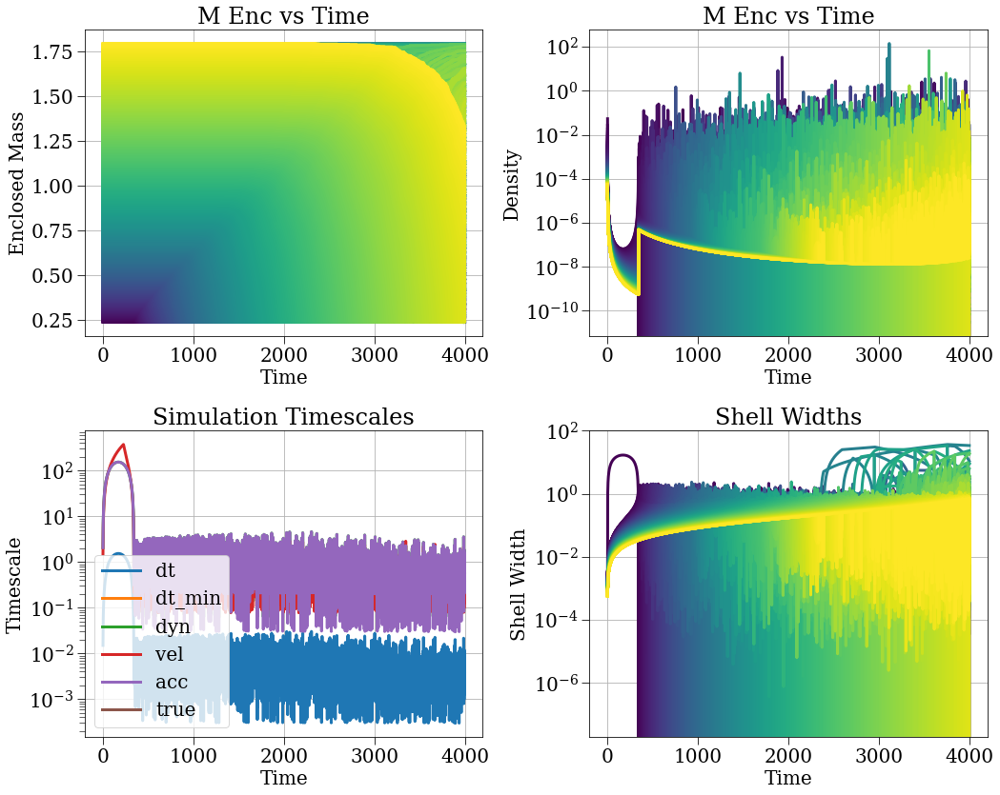

In [26]:
config = make_config(N=N, r_min=r_min, r_max=r_max, t_max=t_max, j_coef=j_coef, save_dt=save_dt, density_strategy=density_strategy, delta=delta, safety_factor=safety_factor, stepper_strategy='leapfrog_hut',  timescale_strategy=tss, H=H0, initial_radius_strategy=irs, gamma=gamma, initial_v_strategy=ivs, accel_strategy=accel_strategy, ang_mom_strategy=ang_mom_strategy, save_filename='7-31-11.h5', r_small=1, softlen=softlen, problematic_shell_strategy=problematic_shell_strategy, thickness_coef=thickness_coef, m_enc_strategy=mes, save_strategy=save_strategy)
sc, results, plotter = run_sc(config, profile=False, plot=True)

{'G': 1,
 'H': 0.6666666666666666,
 'N': 1000,
 'accel_strategy': 'soft_new',
 'ang_mom_strategy': 'const',
 'delta': 0.01,
 'density_strategy': 'background_plus_power_law',
 'deque_size': 0,
 'drhodr_strategy': 'finite_diff',
 'dt': 1e-05,
 'dt_min': 0,
 'energy_strategy': 'kin_grav_rot_absorbed',
 'gamma': -2.5,
 'hbar2_over_m2': 0,
 'initial_mass_strategy': 'integrated_mass',
 'initial_radius_strategy': 'equal_mass',
 'initial_v_strategy': 'hubble',
 'j_coef': 0.01,
 'm_enc_strategy': 'neighbor',
 'm_pert': 1,
 'next_save_time': 0,
 'num_crossing': 0,
 'point_mass': 0,
 'point_mass_strategy': 'rmin_rho_r',
 'polytropic_coef': 0,
 'polytropic_index': -1,
 'pressure_strategy': 'zero',
 'problematic_shell_strategy': 'nothing',
 'r0_min': 1.001,
 'r_max': 2,
 'r_min': 1,
 'r_min_strategy': 'nothing',
 'r_small': 1,
 'r_ta_strategy': 'r_ta_cycloid',
 'relaxation_time': 0,
 'rho_bar': 0.05305164769729845,
 'safety_factor': 0.01,
 'save_dt': 1,
 'save_filename': '7-31-10.h5',
 'save_strate

2025-08-01 03:47:35,343 - collapse - INFO - Simulation setup complete


2025-08-01 04:01:27,726 - DEBUG - Saved dataset t with shape (3947,)
2025-08-01 04:01:27,728 - DEBUG - Saved dataset dt with shape (3947,)
2025-08-01 04:01:27,785 - DEBUG - Saved dataset r with shape (3947, 1000)
2025-08-01 04:01:27,829 - DEBUG - Saved dataset v with shape (3947, 1000)
2025-08-01 04:01:27,861 - DEBUG - Saved dataset a with shape (3947, 1000)


2025-08-01 04:01:27,892 - DEBUG - Saved dataset m_enc with shape (3947, 1000)
2025-08-01 04:01:27,923 - DEBUG - Saved dataset rho_r with shape (3947, 1000)
2025-08-01 04:01:27,924 - WARNING - Skipping pressure because all values are None
2025-08-01 04:01:27,925 - WARNING - Skipping dpressure_drho because all values are None
2025-08-01 04:01:27,926 - WARNING - Skipping rho_prime because all values are None
2025-08-01 04:01:27,957 - DEBUG - Saved dataset e_tot with shape (3947, 1000)
2025-08-01 04:01:27,985 - DEBUG - Saved dataset e_g with shape (3947, 1000)
2025-08-01 04:01:28,014 - DEBUG - Saved dataset e_k with shape (3947, 1000)
2025-08-01 04:01:28,042 - DEBUG - Saved dataset e_r with shape (3947, 1000)
2025-08-01 04:01:28,043 - WARNING - Skipping e_p because all values are None
2025-08-01 04:01:28,044 - WARNING - Skipping e_q because all values are None
2025-08-01 04:01:28,045 - DEBUG - Saved dataset t_dyn with shape (3947,)
2025-08-01 04:01:28,047 - DEBUG - Saved dataset t_vel with

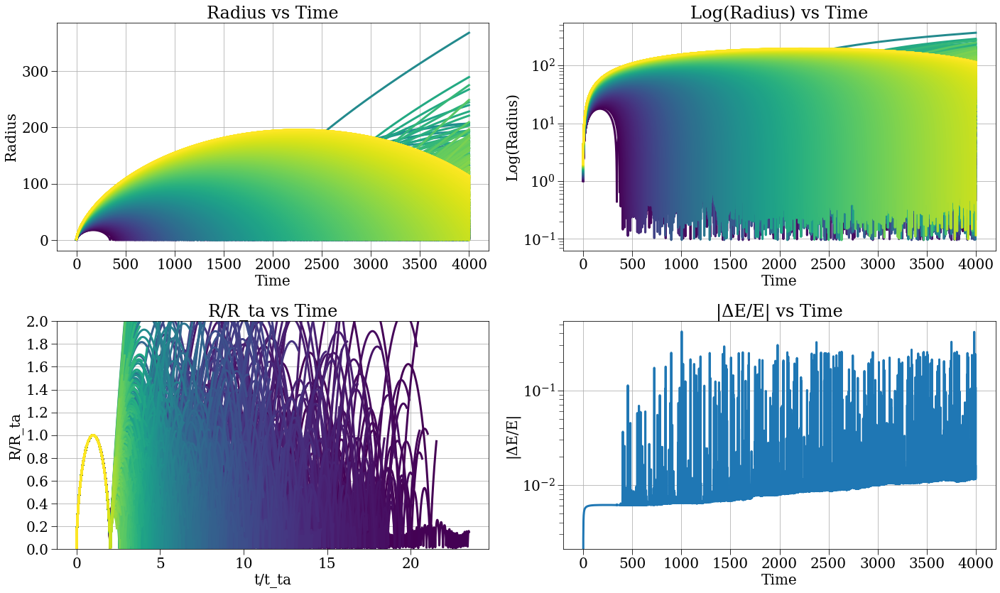

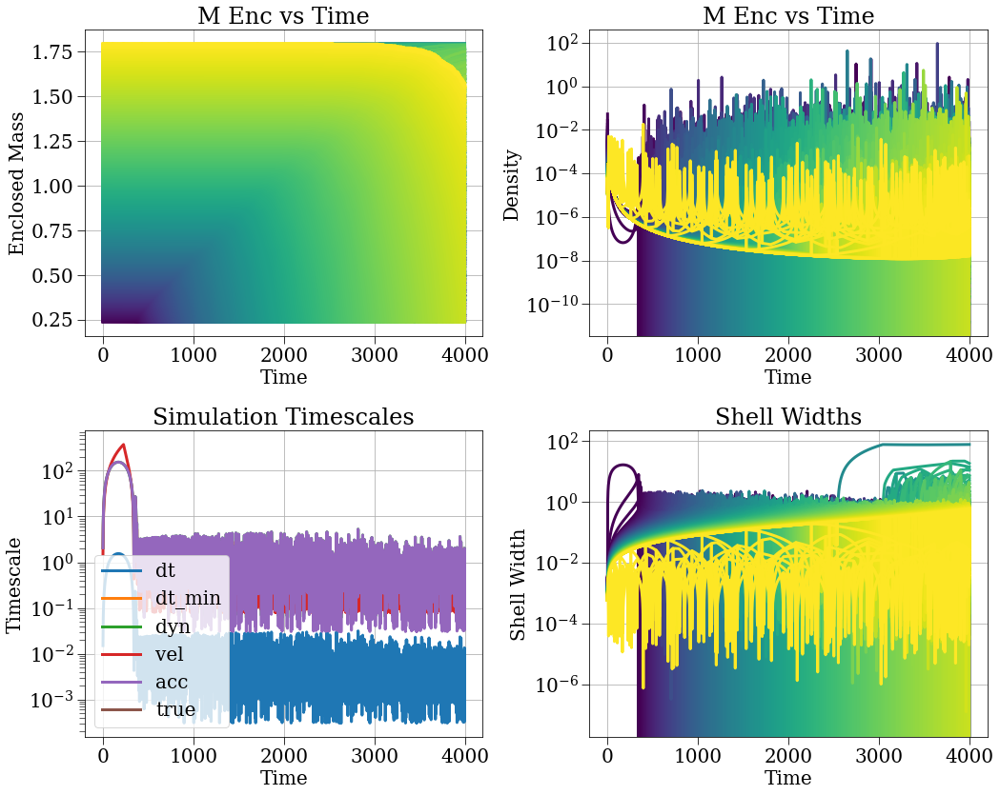

In [24]:
config = make_config(N=N, r_min=r_min, r_max=r_max, t_max=t_max, j_coef=j_coef, save_dt=save_dt, density_strategy=density_strategy, delta=delta, safety_factor=safety_factor, stepper_strategy='leapfrog_hut',  timescale_strategy=tss, H=H0, initial_radius_strategy=irs, gamma=gamma, initial_v_strategy=ivs, accel_strategy=accel_strategy, ang_mom_strategy=ang_mom_strategy, save_filename='7-31-10.h5', r_small=1, softlen=softlen, problematic_shell_strategy=problematic_shell_strategy, thickness_coef=thickness_coef, m_enc_strategy=mes, save_strategy=save_strategy)
sc, results, plotter = run_sc(config, profile=False, plot=True)

{'G': 1,
 'H': 0.6666666666666666,
 'N': 1000,
 'accel_strategy': 'grant_gmr_j_at_r_ta_soft',
 'ang_mom_strategy': 'zero',
 'delta': 0.01,
 'density_strategy': 'background_plus_power_law',
 'deque_size': 0,
 'drhodr_strategy': 'finite_diff',
 'dt': 1e-05,
 'dt_min': 0,
 'energy_strategy': 'kin_grav_rot_absorbed',
 'gamma': -2.5,
 'hbar2_over_m2': 0,
 'initial_mass_strategy': 'integrated_mass',
 'initial_radius_strategy': 'equal_mass',
 'initial_v_strategy': 'hubble',
 'j_coef': 0.7,
 'm_enc_strategy': 'neighbor',
 'm_pert': 1,
 'next_save_time': 0,
 'num_crossing': 0,
 'point_mass': 0,
 'point_mass_strategy': 'rmin_rho_r',
 'polytropic_coef': 0,
 'polytropic_index': -1,
 'pressure_strategy': 'zero',
 'problematic_shell_strategy': 'nothing',
 'r0_min': 1.001,
 'r_max': 2,
 'r_min': 1,
 'r_min_strategy': 'nothing',
 'r_small': 1,
 'r_ta_strategy': 'r_ta_cycloid',
 'relaxation_time': 0,
 'rho_bar': 0.05305164769729845,
 'safety_factor': 0.01,
 'save_dt': 0.01,
 'save_filename': '7-31-9.h5

2025-08-01 03:32:20,599 - collapse - INFO - Simulation setup complete


2025-08-01 03:32:25,455 - DEBUG - Saved dataset t with shape (6897,)
2025-08-01 03:32:25,457 - DEBUG - Saved dataset dt with shape (6897,)


2025-08-01 03:32:25,555 - DEBUG - Saved dataset r with shape (6897, 1000)
2025-08-01 03:32:25,651 - DEBUG - Saved dataset v with shape (6897, 1000)
2025-08-01 03:32:25,734 - DEBUG - Saved dataset a with shape (6897, 1000)
2025-08-01 03:32:25,818 - DEBUG - Saved dataset m_enc with shape (6897, 1000)
2025-08-01 03:32:25,903 - DEBUG - Saved dataset rho_r with shape (6897, 1000)
2025-08-01 03:32:25,905 - WARNING - Skipping pressure because all values are None
2025-08-01 03:32:25,906 - WARNING - Skipping dpressure_drho because all values are None
2025-08-01 03:32:25,907 - WARNING - Skipping rho_prime because all values are None
2025-08-01 03:32:25,992 - DEBUG - Saved dataset e_tot with shape (6897, 1000)
2025-08-01 03:32:26,075 - DEBUG - Saved dataset e_g with shape (6897, 1000)
2025-08-01 03:32:26,156 - DEBUG - Saved dataset e_k with shape (6897, 1000)
2025-08-01 03:32:26,231 - DEBUG - Saved dataset e_r with shape (6897, 1000)
2025-08-01 03:32:26,232 - WARNING - Skipping e_p because all va

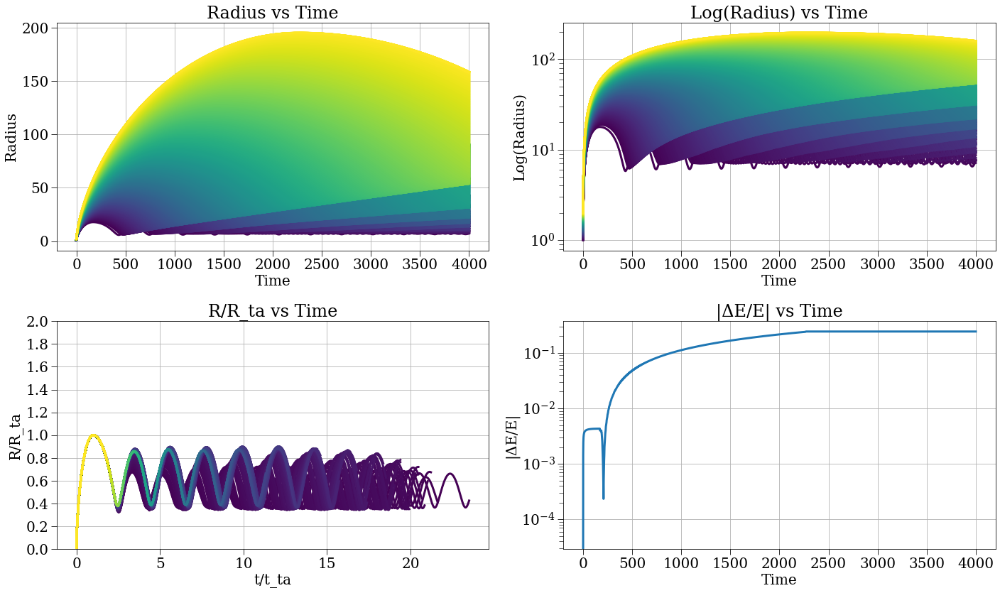

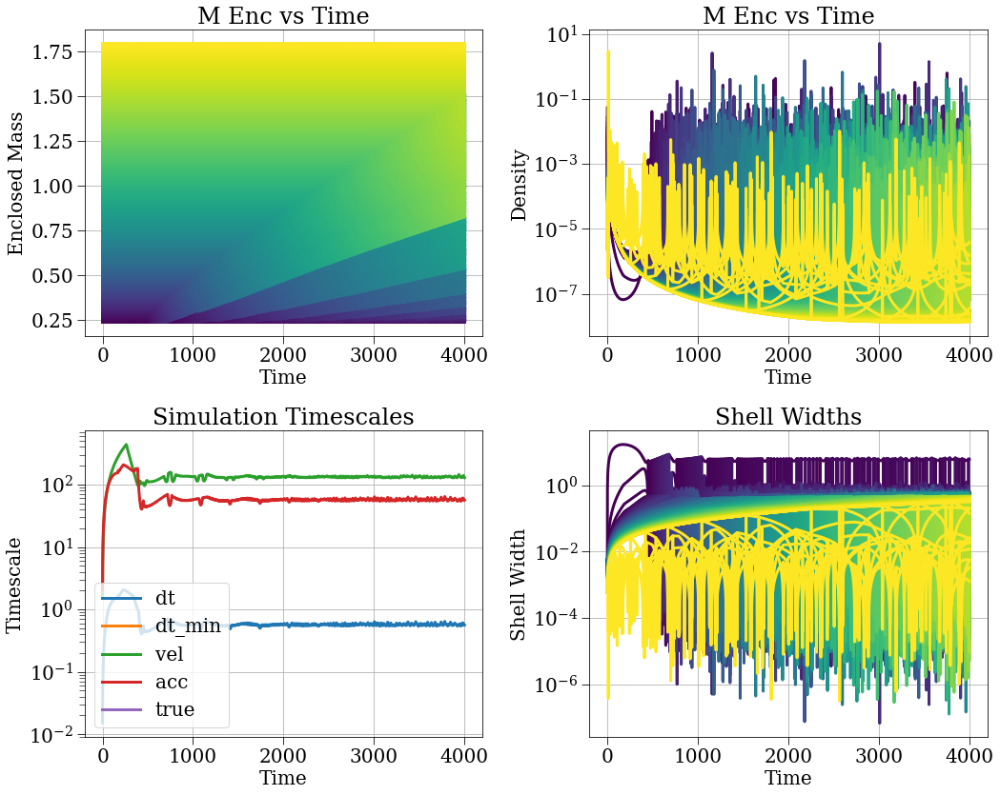

In [10]:
config = make_config(N=N, r_min=r_min, r_max=r_max, t_max=t_max, j_coef=j_coef, save_dt=save_dt, density_strategy=density_strategy, delta=delta, safety_factor=safety_factor, stepper_strategy='leapfrog_hut',  timescale_strategy=tss, H=H0, initial_radius_strategy=irs, gamma=gamma, initial_v_strategy=ivs, accel_strategy=accel_strategy, ang_mom_strategy=ang_mom_strategy, save_filename='7-31-9.h5', r_small=1, softlen=softlen, problematic_shell_strategy=problematic_shell_strategy, thickness_coef=thickness_coef, m_enc_strategy=mes, save_strategy=save_strategy)
sc, results, plotter = run_sc(config, profile=False, plot=True)

In [71]:
config = make_config(N=N, r_min=r_min, r_max=r_max, t_max=t_max, j_coef=j_coef, save_dt=save_dt, density_strategy=density_strategy, delta=delta, safety_factor=safety_factor, stepper_strategy='leapfrog_hut',  timescale_strategy=tss, H=H0, initial_radius_strategy=irs, gamma=gamma, initial_v_strategy=ivs, accel_strategy=accel_strategy, ang_mom_strategy=ang_mom_strategy, save_filename='7-31-8.h5', r_small=1, softlen=softlen, problematic_shell_strategy=problematic_shell_strategy, thickness_coef=thickness_coef, m_enc_strategy=mes, save_strategy=save_strategy)
sc, results, plotter = run_sc(config, profile=False, plot=True)

{'G': 1,
 'H': 0.6666666666666666,
 'N': 10000,
 'accel_strategy': 'grant_gmr_j_at_r_ta_soft',
 'ang_mom_strategy': 'zero',
 'delta': 0.01,
 'density_strategy': 'background_plus_power_law',
 'deque_size': 0,
 'drhodr_strategy': 'finite_diff',
 'dt': 1e-05,
 'dt_min': 0,
 'energy_strategy': 'kin_grav_rot_absorbed',
 'gamma': -1,
 'hbar2_over_m2': 0,
 'initial_mass_strategy': 'integrated_mass',
 'initial_radius_strategy': 'equal_mass',
 'initial_v_strategy': 'hubble',
 'j_coef': 0.7,
 'm_enc_strategy': 'inclusive',
 'm_pert': 1,
 'next_save_time': 0,
 'num_crossing': 0,
 'point_mass': 0,
 'point_mass_strategy': 'rmin_rho_r',
 'polytropic_coef': 0,
 'polytropic_index': -1,
 'pressure_strategy': 'zero',
 'problematic_shell_strategy': 'nothing',
 'r0_min': 5e-05,
 'r_max': 0.5,
 'r_min': 0,
 'r_min_strategy': 'nothing',
 'r_small': 1,
 'r_ta_strategy': 'r_ta_cycloid',
 'relaxation_time': 0,
 'rho_bar': 0.05305164769729845,
 'safety_factor': 0.01,
 'save_dt': 0.01,
 'save_filename': '7-31-8.

2025-07-31 23:51:53,951 - collapse - INFO - Simulation setup complete


2025-07-31 23:54:25,264 - DEBUG - Saved dataset t with shape (36761,)
2025-07-31 23:54:25,267 - DEBUG - Saved dataset dt with shape (36761,)


2025-07-31 23:54:33,852 - DEBUG - Saved dataset r with shape (36761, 10000)
2025-07-31 23:54:45,520 - DEBUG - Saved dataset v with shape (36761, 10000)
2025-07-31 23:54:56,320 - DEBUG - Saved dataset a with shape (36761, 10000)
2025-07-31 23:55:08,228 - DEBUG - Saved dataset m_enc with shape (36761, 10000)
2025-07-31 23:55:20,329 - DEBUG - Saved dataset rho_r with shape (36761, 10000)
2025-07-31 23:55:20,332 - WARNING - Skipping pressure because all values are None
2025-07-31 23:55:20,335 - WARNING - Skipping dpressure_drho because all values are None
2025-07-31 23:55:20,338 - WARNING - Skipping rho_prime because all values are None
2025-07-31 23:55:33,434 - DEBUG - Saved dataset e_tot with shape (36761, 10000)
2025-07-31 23:55:43,783 - DEBUG - Saved dataset e_g with shape (36761, 10000)
2025-07-31 23:55:53,052 - DEBUG - Saved dataset e_k with shape (36761, 10000)
2025-07-31 23:56:04,616 - DEBUG - Saved dataset e_r with shape (36761, 10000)
2025-07-31 23:56:04,618 - WARNING - Skipping 

MemoryError: Unable to allocate 2.74 GiB for an array with shape (36761, 10000) and data type float64

{'G': 1,
 'H': 0.6666666666666666,
 'N': 1000,
 'accel_strategy': 'grant_gmr_j_at_r_ta_soft',
 'ang_mom_strategy': 'zero',
 'delta': 0.01,
 'density_strategy': 'background_plus_power_law',
 'deque_size': 0,
 'drhodr_strategy': 'finite_diff',
 'dt': 1e-05,
 'dt_min': 0,
 'energy_strategy': 'kin_grav_rot_absorbed',
 'gamma': -1,
 'hbar2_over_m2': 0,
 'initial_mass_strategy': 'integrated_mass',
 'initial_radius_strategy': 'equal_mass',
 'initial_v_strategy': 'hubble',
 'j_coef': 0.7,
 'm_enc_strategy': 'inclusive',
 'm_pert': 1,
 'next_save_time': 0,
 'num_crossing': 0,
 'point_mass': 0,
 'point_mass_strategy': 'rmin_rho_r',
 'polytropic_coef': 0,
 'polytropic_index': -1,
 'pressure_strategy': 'zero',
 'problematic_shell_strategy': 'nothing',
 'r0_min': 0.0005,
 'r_max': 0.5,
 'r_min': 0,
 'r_min_strategy': 'nothing',
 'r_small': 1,
 'r_ta_strategy': 'r_ta_cycloid',
 'relaxation_time': 0,
 'rho_bar': 0.05305164769729845,
 'safety_factor': 0.01,
 'save_dt': 0.01,
 'save_filename': '7-31-8.

2025-07-31 23:40:17,268 - collapse - INFO - Simulation setup complete


2025-07-31 23:40:24,481 - DEBUG - Saved dataset t with shape (13579,)
2025-07-31 23:40:24,483 - DEBUG - Saved dataset dt with shape (13579,)
2025-07-31 23:40:24,572 - DEBUG - Saved dataset r with shape (13579, 1000)


2025-07-31 23:40:24,650 - DEBUG - Saved dataset v with shape (13579, 1000)
2025-07-31 23:40:24,734 - DEBUG - Saved dataset a with shape (13579, 1000)
2025-07-31 23:40:24,809 - DEBUG - Saved dataset m_enc with shape (13579, 1000)
2025-07-31 23:40:24,891 - DEBUG - Saved dataset rho_r with shape (13579, 1000)
2025-07-31 23:40:24,892 - WARNING - Skipping pressure because all values are None
2025-07-31 23:40:24,894 - WARNING - Skipping dpressure_drho because all values are None
2025-07-31 23:40:24,895 - WARNING - Skipping rho_prime because all values are None
2025-07-31 23:40:25,007 - DEBUG - Saved dataset e_tot with shape (13579, 1000)
2025-07-31 23:40:25,115 - DEBUG - Saved dataset e_g with shape (13579, 1000)
2025-07-31 23:40:25,203 - DEBUG - Saved dataset e_k with shape (13579, 1000)
2025-07-31 23:40:25,279 - DEBUG - Saved dataset e_r with shape (13579, 1000)
2025-07-31 23:40:25,280 - WARNING - Skipping e_p because all values are None
2025-07-31 23:40:25,282 - WARNING - Skipping e_q bec

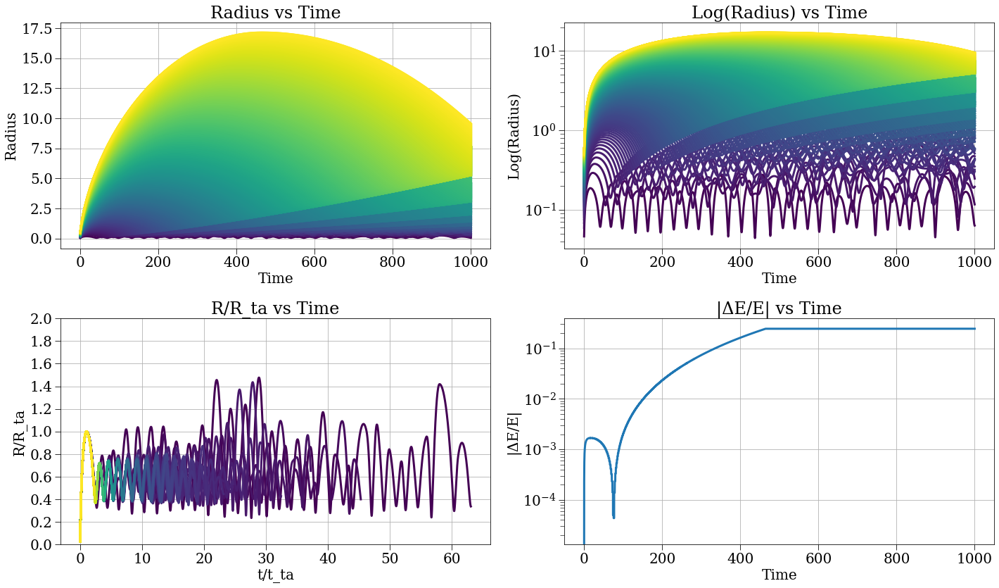

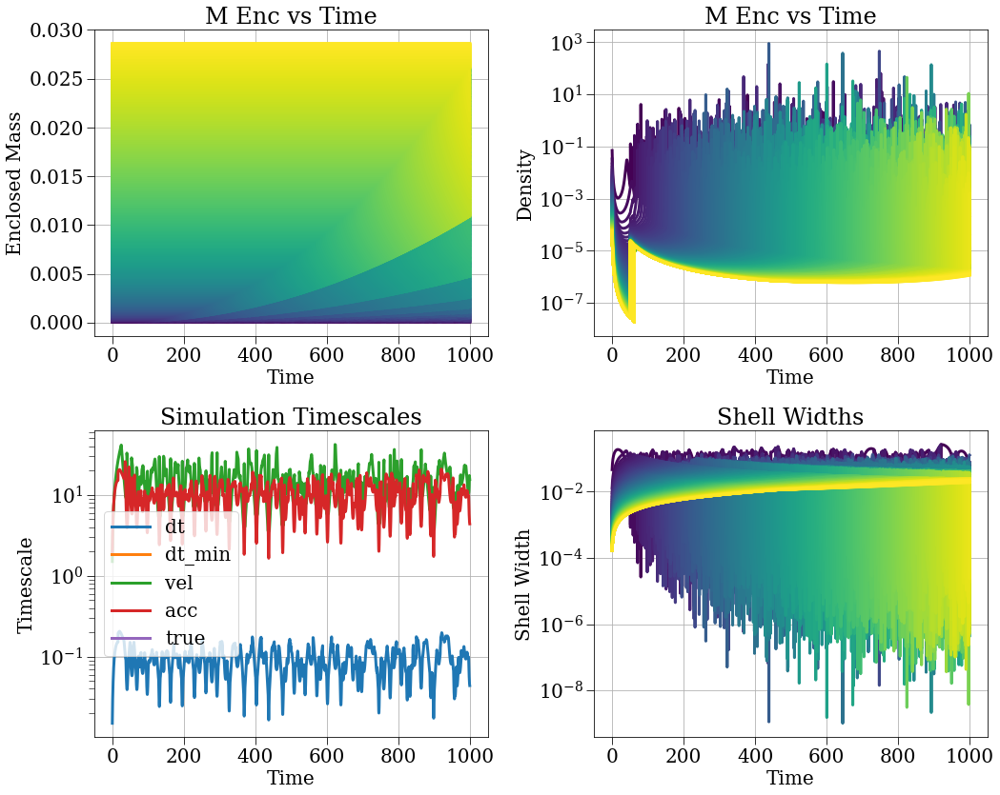

In [68]:
config = make_config(N=N, r_min=r_min, r_max=r_max, t_max=t_max, j_coef=j_coef, save_dt=save_dt, density_strategy=density_strategy, delta=delta, safety_factor=safety_factor, stepper_strategy='leapfrog_hut',  timescale_strategy=tss, H=H0, initial_radius_strategy=irs, gamma=gamma, initial_v_strategy=ivs, accel_strategy=accel_strategy, ang_mom_strategy=ang_mom_strategy, save_filename='7-31-8.h5', r_small=1, softlen=softlen, problematic_shell_strategy=problematic_shell_strategy, thickness_coef=thickness_coef, m_enc_strategy=mes, save_strategy=save_strategy)
sc, results, plotter = run_sc(config, profile=False, plot=True)

{'G': 1,
 'H': 0.6666666666666666,
 'N': 1000,
 'accel_strategy': 'grant_gmr_j_at_r_ta_soft',
 'ang_mom_strategy': 'zero',
 'delta': 0.01,
 'density_strategy': 'background_plus_power_law',
 'deque_size': 0,
 'drhodr_strategy': 'finite_diff',
 'dt': 1e-05,
 'dt_min': 0,
 'energy_strategy': 'kin_grav_rot_absorbed',
 'gamma': -1,
 'hbar2_over_m2': 0,
 'initial_mass_strategy': 'integrated_mass',
 'initial_radius_strategy': 'equal_mass',
 'initial_v_strategy': 'hubble',
 'j_coef': 0.5,
 'm_enc_strategy': 'inclusive',
 'm_pert': 1,
 'next_save_time': 0,
 'num_crossing': 0,
 'point_mass': 0,
 'point_mass_strategy': 'rmin_rho_r',
 'polytropic_coef': 0,
 'polytropic_index': -1,
 'pressure_strategy': 'zero',
 'problematic_shell_strategy': 'nothing',
 'r0_min': 1.005,
 'r_max': 6,
 'r_min': 1,
 'r_min_strategy': 'nothing',
 'r_small': 1,
 'r_ta_strategy': 'r_ta_cycloid',
 'relaxation_time': 0,
 'rho_bar': 0.05305164769729845,
 'safety_factor': 0.01,
 'save_dt': 1,
 'save_filename': '7-31-7.h5',
 

2025-07-31 23:10:08,956 - collapse - INFO - Simulation setup complete


2025-07-31 23:10:23,109 - DEBUG - Saved dataset t with shape (23168,)
2025-07-31 23:10:23,112 - DEBUG - Saved dataset dt with shape (23168,)


2025-07-31 23:10:23,398 - DEBUG - Saved dataset r with shape (23168, 1000)
2025-07-31 23:10:23,873 - DEBUG - Saved dataset v with shape (23168, 1000)
2025-07-31 23:10:24,346 - DEBUG - Saved dataset a with shape (23168, 1000)
2025-07-31 23:10:24,922 - DEBUG - Saved dataset m_enc with shape (23168, 1000)
2025-07-31 23:10:25,380 - DEBUG - Saved dataset rho_r with shape (23168, 1000)
2025-07-31 23:10:25,383 - WARNING - Skipping pressure because all values are None
2025-07-31 23:10:25,385 - WARNING - Skipping dpressure_drho because all values are None
2025-07-31 23:10:25,387 - WARNING - Skipping rho_prime because all values are None
2025-07-31 23:10:25,881 - DEBUG - Saved dataset e_tot with shape (23168, 1000)
2025-07-31 23:10:26,390 - DEBUG - Saved dataset e_g with shape (23168, 1000)
2025-07-31 23:10:26,906 - DEBUG - Saved dataset e_k with shape (23168, 1000)
2025-07-31 23:10:27,449 - DEBUG - Saved dataset e_r with shape (23168, 1000)
2025-07-31 23:10:27,451 - WARNING - Skipping e_p becau

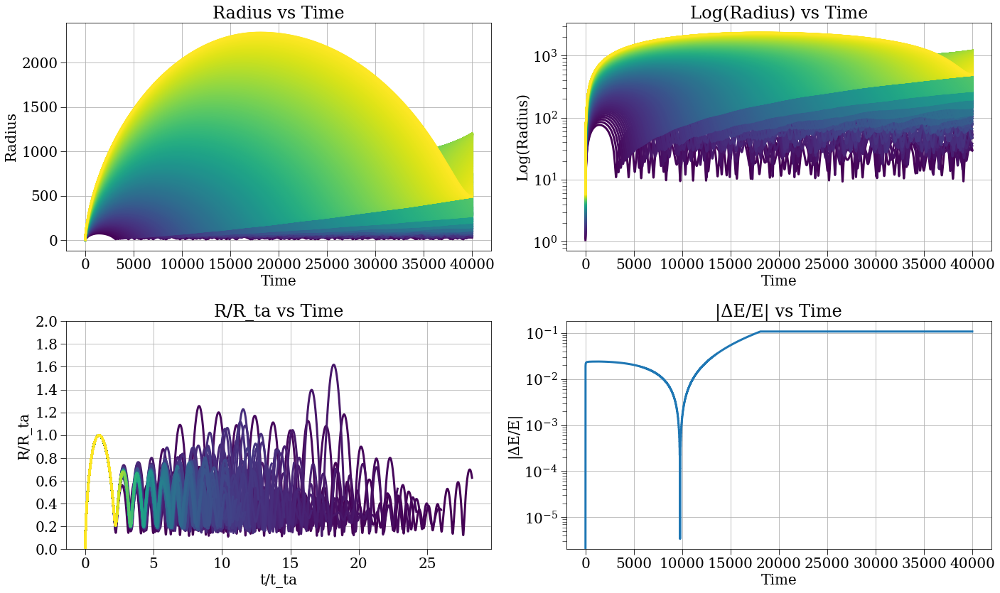

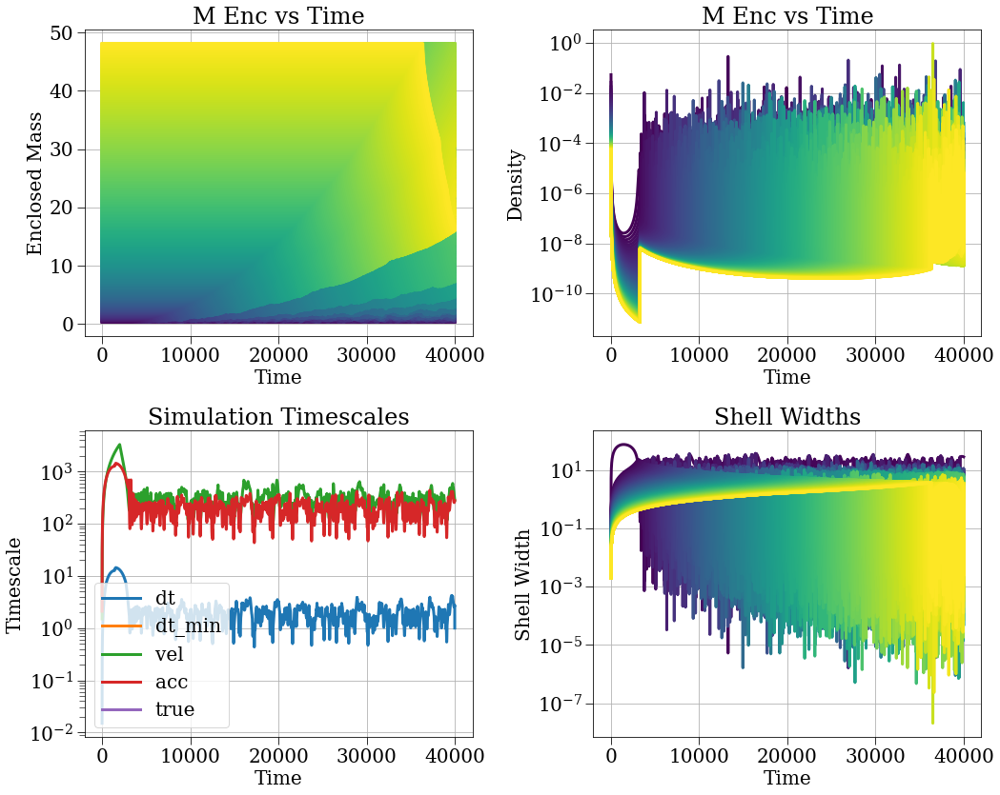

In [56]:
config = make_config(N=N, r_min=r_min, r_max=r_max, t_max=t_max, j_coef=j_coef, save_dt=save_dt, density_strategy=density_strategy, delta=delta, safety_factor=safety_factor, stepper_strategy='leapfrog_hut',  timescale_strategy=tss, H=H0, initial_radius_strategy=irs, gamma=gamma, initial_v_strategy=ivs, accel_strategy=accel_strategy, ang_mom_strategy=ang_mom_strategy, save_filename='7-31-7.h5', r_small=1, softlen=softlen, problematic_shell_strategy=problematic_shell_strategy, thickness_coef=thickness_coef, m_enc_strategy=mes, save_strategy=save_strategy)
sc, results, plotter = run_sc(config, profile=False, plot=True)

{'G': 1,
 'H': 0.6666666666666666,
 'N': 1000,
 'accel_strategy': 'grant_gmr_j_at_r_ta_soft',
 'ang_mom_strategy': 'zero',
 'delta': 0.01,
 'density_strategy': 'background_plus_power_law',
 'deque_size': 0,
 'drhodr_strategy': 'finite_diff',
 'dt': 1e-05,
 'dt_min': 0,
 'energy_strategy': 'kin_grav_rot_absorbed',
 'gamma': -1,
 'hbar2_over_m2': 0,
 'initial_mass_strategy': 'integrated_mass',
 'initial_radius_strategy': 'equal_mass',
 'initial_v_strategy': 'hubble',
 'j_coef': 0.7,
 'm_enc_strategy': 'inclusive',
 'm_pert': 1,
 'next_save_time': 0,
 'num_crossing': 0,
 'point_mass': 0,
 'point_mass_strategy': 'rmin_rho_r',
 'polytropic_coef': 0,
 'polytropic_index': -1,
 'pressure_strategy': 'zero',
 'problematic_shell_strategy': 'nothing',
 'r0_min': 1.005,
 'r_max': 6,
 'r_min': 1,
 'r_min_strategy': 'nothing',
 'r_small': 1,
 'r_ta_strategy': 'r_ta_cycloid',
 'relaxation_time': 0,
 'rho_bar': 0.05305164769729845,
 'safety_factor': 0.01,
 'save_dt': 1,
 'save_filename': '7-31-6.h5',
 

2025-07-31 23:08:16,622 - collapse - INFO - Simulation setup complete


2025-07-31 23:08:20,989 - DEBUG - Saved dataset t with shape (7259,)
2025-07-31 23:08:20,991 - DEBUG - Saved dataset dt with shape (7259,)
2025-07-31 23:08:21,045 - DEBUG - Saved dataset r with shape (7259, 1000)
2025-07-31 23:08:21,085 - DEBUG - Saved dataset v with shape (7259, 1000)
2025-07-31 23:08:21,126 - DEBUG - Saved dataset a with shape (7259, 1000)


2025-07-31 23:08:21,170 - DEBUG - Saved dataset m_enc with shape (7259, 1000)
2025-07-31 23:08:21,211 - DEBUG - Saved dataset rho_r with shape (7259, 1000)
2025-07-31 23:08:21,213 - WARNING - Skipping pressure because all values are None
2025-07-31 23:08:21,214 - WARNING - Skipping dpressure_drho because all values are None
2025-07-31 23:08:21,215 - WARNING - Skipping rho_prime because all values are None
2025-07-31 23:08:21,259 - DEBUG - Saved dataset e_tot with shape (7259, 1000)
2025-07-31 23:08:21,300 - DEBUG - Saved dataset e_g with shape (7259, 1000)
2025-07-31 23:08:21,341 - DEBUG - Saved dataset e_k with shape (7259, 1000)
2025-07-31 23:08:21,382 - DEBUG - Saved dataset e_r with shape (7259, 1000)
2025-07-31 23:08:21,384 - WARNING - Skipping e_p because all values are None
2025-07-31 23:08:21,385 - WARNING - Skipping e_q because all values are None
2025-07-31 23:08:21,386 - WARNING - Skipping t_dyn because all values are None
2025-07-31 23:08:21,387 - DEBUG - Saved dataset t_ve

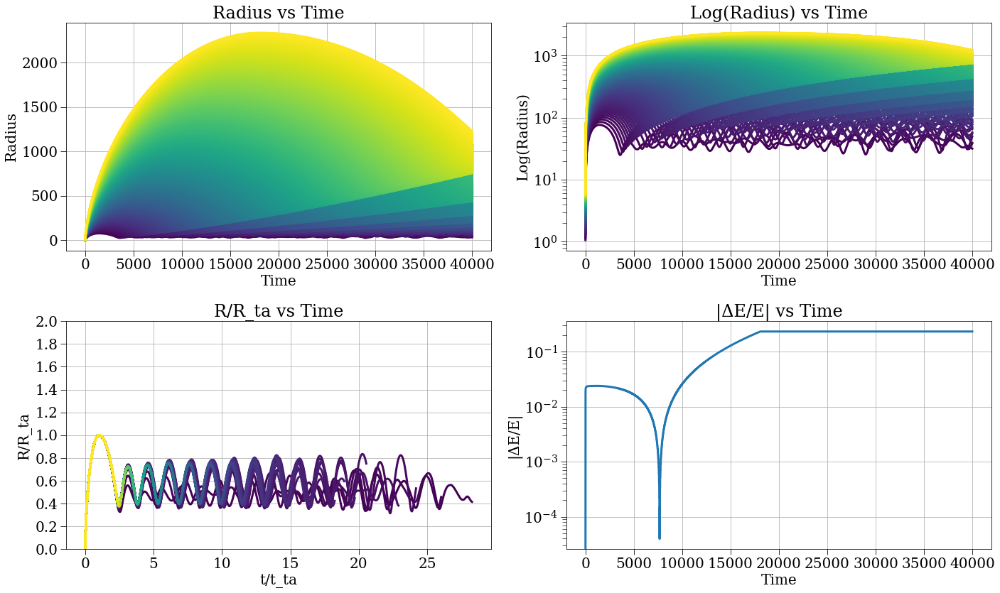

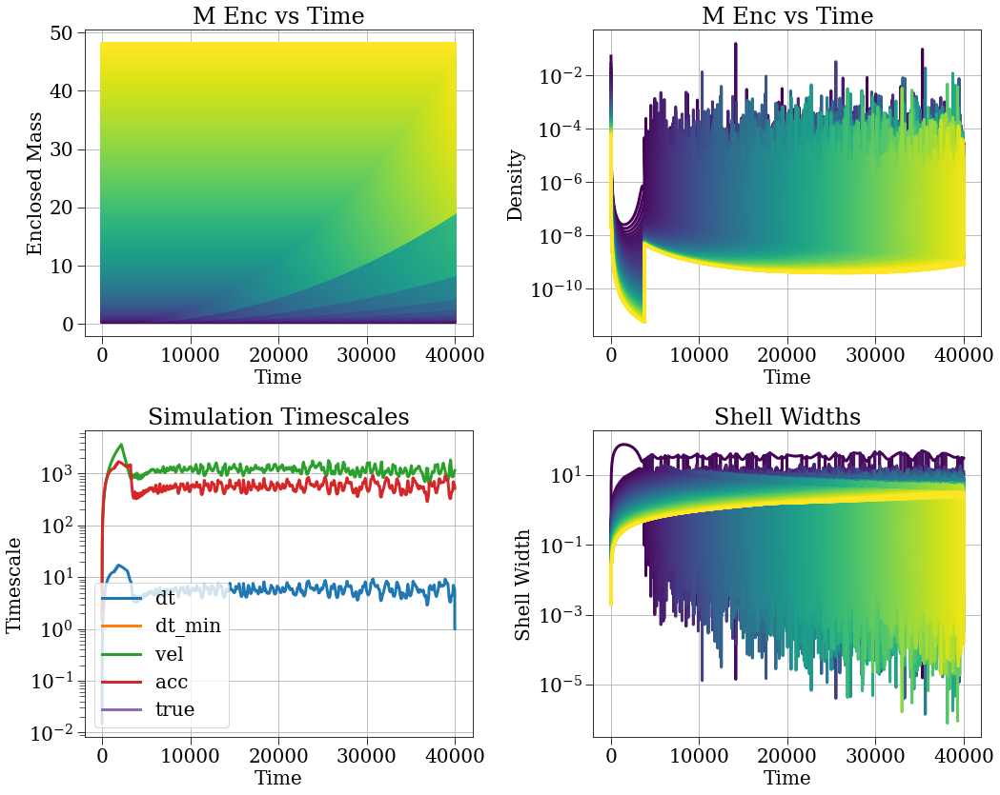

In [53]:
config = make_config(N=N, r_min=r_min, r_max=r_max, t_max=t_max, j_coef=j_coef, save_dt=save_dt, density_strategy=density_strategy, delta=delta, safety_factor=safety_factor, stepper_strategy='leapfrog_hut',  timescale_strategy=tss, H=H0, initial_radius_strategy=irs, gamma=gamma, initial_v_strategy=ivs, accel_strategy=accel_strategy, ang_mom_strategy=ang_mom_strategy, save_filename='7-31-6.h5', r_small=1, softlen=softlen, problematic_shell_strategy=problematic_shell_strategy, thickness_coef=thickness_coef, m_enc_strategy=mes, save_strategy=save_strategy)
sc, results, plotter = run_sc(config, profile=False, plot=True)

{'G': 1,
 'H': 0.6666666666666666,
 'N': 1000,
 'accel_strategy': 'grant_gmr_j_at_r_ta_soft',
 'ang_mom_strategy': 'zero',
 'delta': 0.01,
 'density_strategy': 'background_plus_power_law',
 'deque_size': 0,
 'drhodr_strategy': 'finite_diff',
 'dt': 1e-05,
 'dt_min': 0,
 'energy_strategy': 'kin_grav_rot_absorbed',
 'gamma': -2.5,
 'hbar2_over_m2': 0,
 'initial_mass_strategy': 'integrated_mass',
 'initial_radius_strategy': 'equal_mass',
 'initial_v_strategy': 'hubble',
 'j_coef': 0.7,
 'm_enc_strategy': 'inclusive',
 'm_pert': 1,
 'next_save_time': 0,
 'num_crossing': 0,
 'point_mass': 0,
 'point_mass_strategy': 'rmin_rho_r',
 'polytropic_coef': 0,
 'polytropic_index': -1,
 'pressure_strategy': 'zero',
 'problematic_shell_strategy': 'nothing',
 'r0_min': 1.001,
 'r_max': 2,
 'r_min': 1,
 'r_min_strategy': 'nothing',
 'r_small': 1,
 'r_ta_strategy': 'r_ta_cycloid',
 'relaxation_time': 0,
 'rho_bar': 0.05305164769729845,
 'safety_factor': 0.01,
 'save_dt': 1,
 'save_filename': '7-31-5.h5',

2025-07-31 23:04:36,245 - collapse - INFO - Simulation setup complete


2025-07-31 23:04:40,388 - DEBUG - Saved dataset t with shape (3888,)
2025-07-31 23:04:40,390 - DEBUG - Saved dataset dt with shape (3888,)
2025-07-31 23:04:40,420 - DEBUG - Saved dataset r with shape (3888, 1000)


2025-07-31 23:04:40,447 - DEBUG - Saved dataset v with shape (3888, 1000)
2025-07-31 23:04:40,472 - DEBUG - Saved dataset a with shape (3888, 1000)
2025-07-31 23:04:40,495 - DEBUG - Saved dataset m_enc with shape (3888, 1000)
2025-07-31 23:04:40,519 - DEBUG - Saved dataset rho_r with shape (3888, 1000)
2025-07-31 23:04:40,520 - WARNING - Skipping pressure because all values are None
2025-07-31 23:04:40,521 - WARNING - Skipping dpressure_drho because all values are None
2025-07-31 23:04:40,521 - WARNING - Skipping rho_prime because all values are None
2025-07-31 23:04:40,545 - DEBUG - Saved dataset e_tot with shape (3888, 1000)
2025-07-31 23:04:40,568 - DEBUG - Saved dataset e_g with shape (3888, 1000)
2025-07-31 23:04:40,593 - DEBUG - Saved dataset e_k with shape (3888, 1000)
2025-07-31 23:04:40,616 - DEBUG - Saved dataset e_r with shape (3888, 1000)
2025-07-31 23:04:40,617 - WARNING - Skipping e_p because all values are None
2025-07-31 23:04:40,618 - WARNING - Skipping e_q because all

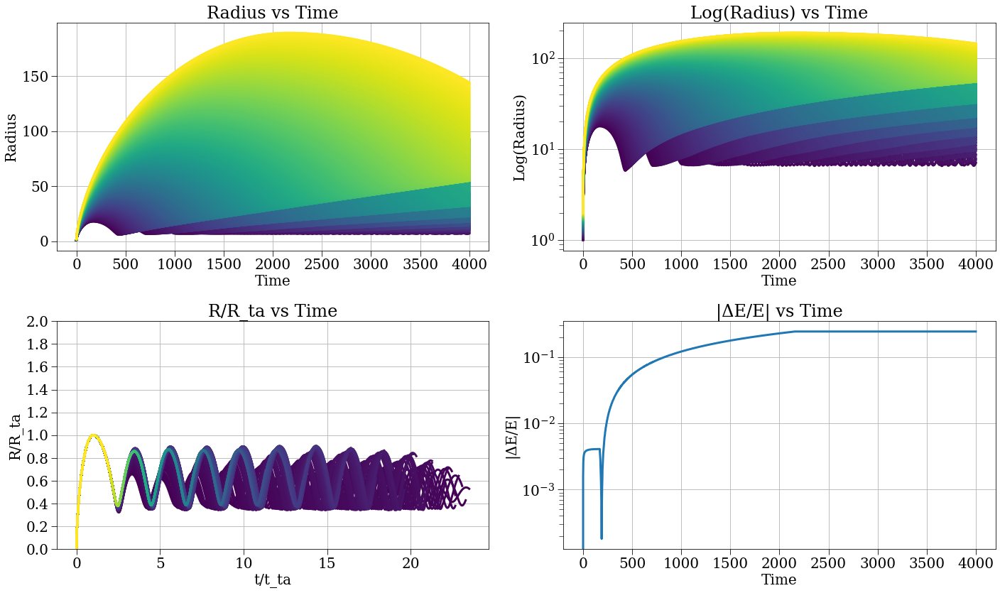

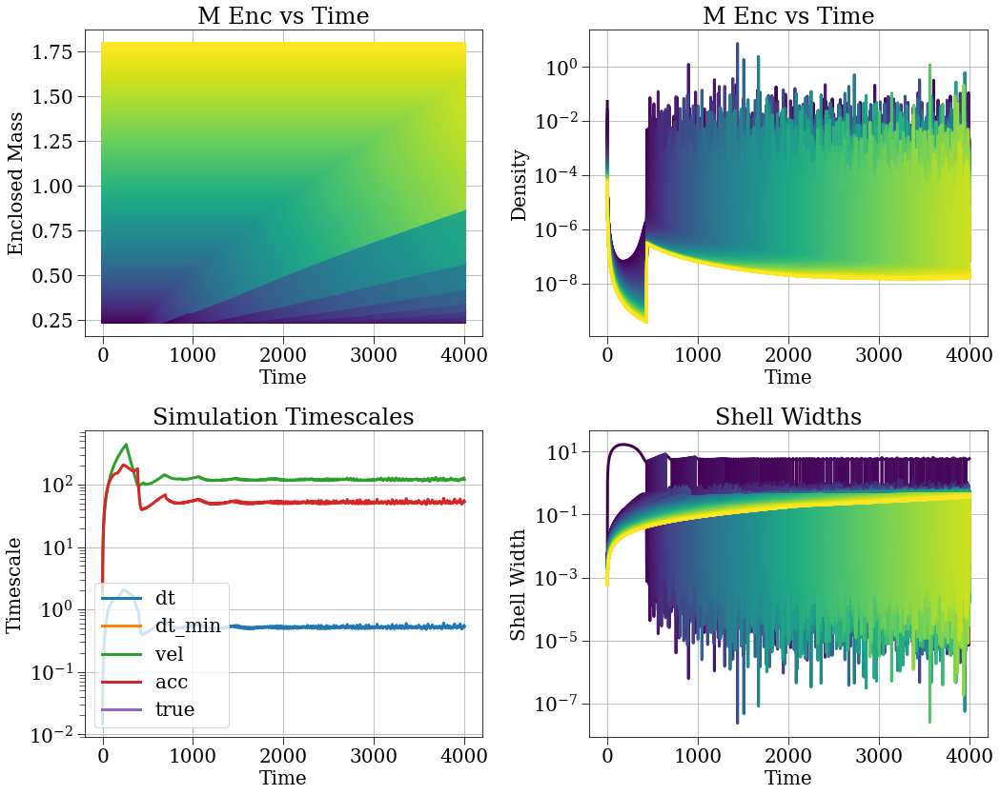

In [30]:
config = make_config(N=N, r_min=r_min, r_max=r_max, t_max=t_max, j_coef=j_coef, save_dt=save_dt, density_strategy=density_strategy, delta=delta, safety_factor=safety_factor, stepper_strategy='leapfrog_hut',  timescale_strategy=tss, H=H0, initial_radius_strategy=irs, gamma=gamma, initial_v_strategy=ivs, accel_strategy=accel_strategy, ang_mom_strategy=ang_mom_strategy, save_filename='7-31-5.h5', r_small=1, softlen=softlen, problematic_shell_strategy=problematic_shell_strategy, thickness_coef=thickness_coef, m_enc_strategy=mes, save_strategy=save_strategy)
sc, results, plotter = run_sc(config, profile=False, plot=True)

{'G': 1,
 'H': 0.6666666666666666,
 'N': 1000,
 'accel_strategy': 'grant_gmr_j_at_r_ta_soft',
 'ang_mom_strategy': 'zero',
 'delta': 0.01,
 'density_strategy': 'background_plus_power_law',
 'deque_size': 0,
 'drhodr_strategy': 'finite_diff',
 'dt': 1e-05,
 'dt_min': 0,
 'energy_strategy': 'kin_grav_rot_absorbed',
 'gamma': -2.5,
 'hbar2_over_m2': 0,
 'initial_mass_strategy': 'integrated_mass',
 'initial_radius_strategy': 'equal_mass',
 'initial_v_strategy': 'hubble',
 'j_coef': 0.3,
 'm_enc_strategy': 'inclusive',
 'm_pert': 1,
 'next_save_time': 0,
 'num_crossing': 0,
 'point_mass': 0,
 'point_mass_strategy': 'rmin_rho_r',
 'polytropic_coef': 0,
 'polytropic_index': -1,
 'pressure_strategy': 'zero',
 'problematic_shell_strategy': 'nothing',
 'r0_min': 1.0005,
 'r_max': 1.5,
 'r_min': 1,
 'r_min_strategy': 'nothing',
 'r_small': 1,
 'r_ta_strategy': 'r_ta_cycloid',
 'relaxation_time': 0,
 'rho_bar': 0.05305164769729845,
 'safety_factor': 0.01,
 'save_dt': 1,
 'save_filename': '7-31-4.h

2025-07-31 22:53:30,151 - collapse - INFO - Simulation setup complete


2025-07-31 22:54:55,660 - DEBUG - Saved dataset t with shape (16088,)
2025-07-31 22:54:55,662 - DEBUG - Saved dataset dt with shape (16088,)


2025-07-31 22:54:55,848 - DEBUG - Saved dataset r with shape (16088, 1000)
2025-07-31 22:54:56,030 - DEBUG - Saved dataset v with shape (16088, 1000)
2025-07-31 22:54:56,219 - DEBUG - Saved dataset a with shape (16088, 1000)
2025-07-31 22:54:56,401 - DEBUG - Saved dataset m_enc with shape (16088, 1000)
2025-07-31 22:54:56,566 - DEBUG - Saved dataset rho_r with shape (16088, 1000)
2025-07-31 22:54:56,568 - WARNING - Skipping pressure because all values are None
2025-07-31 22:54:56,570 - WARNING - Skipping dpressure_drho because all values are None
2025-07-31 22:54:56,571 - WARNING - Skipping rho_prime because all values are None
2025-07-31 22:54:56,746 - DEBUG - Saved dataset e_tot with shape (16088, 1000)
2025-07-31 22:54:56,924 - DEBUG - Saved dataset e_g with shape (16088, 1000)
2025-07-31 22:54:57,089 - DEBUG - Saved dataset e_k with shape (16088, 1000)
2025-07-31 22:54:57,246 - DEBUG - Saved dataset e_r with shape (16088, 1000)
2025-07-31 22:54:57,248 - WARNING - Skipping e_p becau

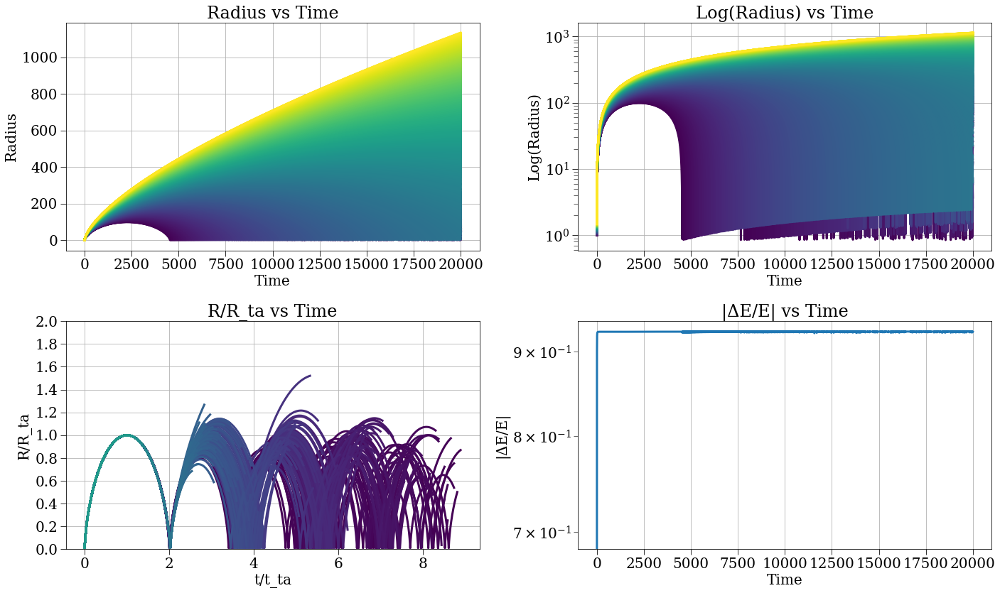

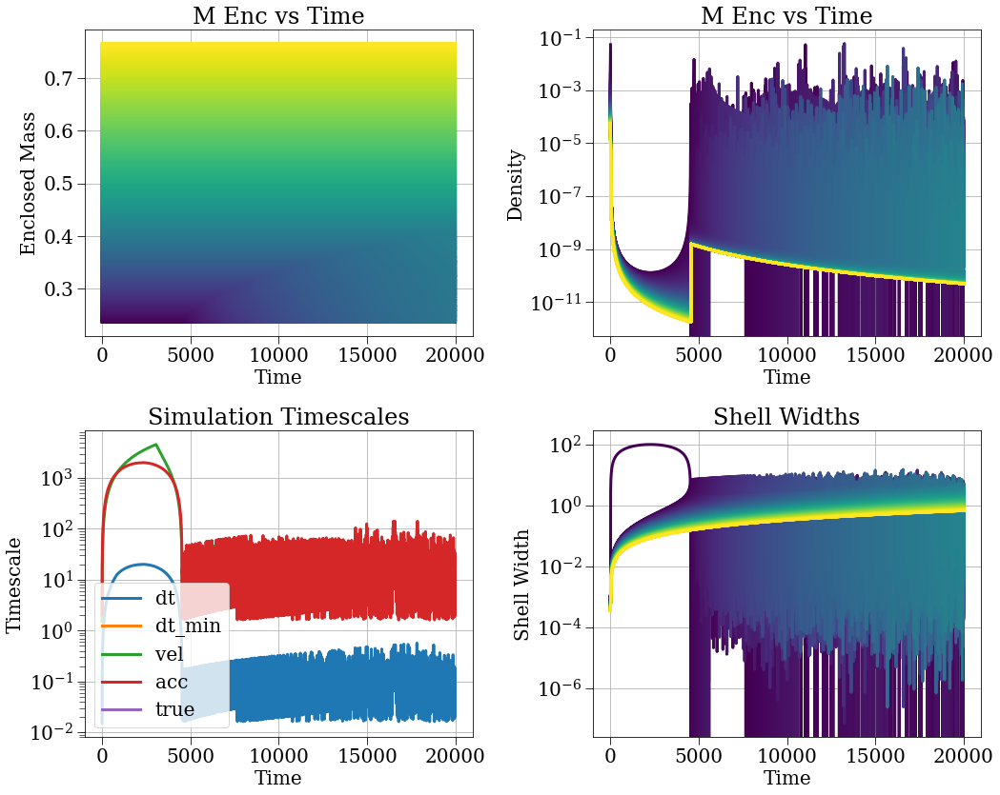

In [21]:
config = make_config(N=N, r_min=r_min, r_max=r_max, t_max=t_max, j_coef=j_coef, save_dt=save_dt, density_strategy=density_strategy, delta=delta, safety_factor=safety_factor, stepper_strategy='leapfrog_hut',  timescale_strategy=tss, H=H0, initial_radius_strategy=irs, gamma=gamma, initial_v_strategy=ivs, accel_strategy=accel_strategy, ang_mom_strategy=ang_mom_strategy, save_filename='7-31-4.h5', r_small=1, softlen=softlen, problematic_shell_strategy=problematic_shell_strategy, thickness_coef=thickness_coef, m_enc_strategy=mes, save_strategy=save_strategy)
sc, results, plotter = run_sc(config, profile=False, plot=True)

{'G': 1,
 'H': 0.6666666666666666,
 'N': 1000,
 'accel_strategy': 'grant_gmr_j_at_r_ta_soft',
 'ang_mom_strategy': 'zero',
 'delta': 0.01,
 'density_strategy': 'background_plus_power_law',
 'deque_size': 0,
 'drhodr_strategy': 'finite_diff',
 'dt': 1e-05,
 'dt_min': 0,
 'energy_strategy': 'kin_grav_rot_absorbed',
 'gamma': -2.5,
 'hbar2_over_m2': 0,
 'initial_mass_strategy': 'integrated_mass',
 'initial_radius_strategy': 'equal_mass',
 'initial_v_strategy': 'hubble',
 'j_coef': 0.3,
 'm_enc_strategy': 'inclusive',
 'm_pert': 1,
 'next_save_time': 0,
 'num_crossing': 0,
 'point_mass': 0,
 'point_mass_strategy': 'rmin_rho_r',
 'polytropic_coef': 0,
 'polytropic_index': -1,
 'pressure_strategy': 'zero',
 'problematic_shell_strategy': 'nothing',
 'r0_min': 1.001,
 'r_max': 2,
 'r_min': 1,
 'r_min_strategy': 'nothing',
 'r_small': 1,
 'r_ta_strategy': 'r_ta_cycloid',
 'relaxation_time': 0,
 'rho_bar': 0.05305164769729845,
 'safety_factor': 0.01,
 'save_dt': 1,
 'save_filename': '7-31-3.h5',

2025-07-31 22:36:46,139 - collapse - INFO - Simulation setup complete


2025-07-31 22:37:35,167 - DEBUG - Saved dataset t with shape (3909,)
2025-07-31 22:37:35,169 - DEBUG - Saved dataset dt with shape (3909,)
2025-07-31 22:37:35,203 - DEBUG - Saved dataset r with shape (3909, 1000)
2025-07-31 22:37:35,231 - DEBUG - Saved dataset v with shape (3909, 1000)
2025-07-31 22:37:35,260 - DEBUG - Saved dataset a with shape (3909, 1000)
2025-07-31 22:37:35,289 - DEBUG - Saved dataset m_enc with shape (3909, 1000)


2025-07-31 22:37:36,077 - DEBUG - Saved dataset rho_r with shape (3909, 1000)
2025-07-31 22:37:36,078 - WARNING - Skipping pressure because all values are None
2025-07-31 22:37:36,080 - WARNING - Skipping dpressure_drho because all values are None
2025-07-31 22:37:36,081 - WARNING - Skipping rho_prime because all values are None
2025-07-31 22:37:36,186 - DEBUG - Saved dataset e_tot with shape (3909, 1000)
2025-07-31 22:37:36,286 - DEBUG - Saved dataset e_g with shape (3909, 1000)
2025-07-31 22:37:36,368 - DEBUG - Saved dataset e_k with shape (3909, 1000)
2025-07-31 22:37:36,449 - DEBUG - Saved dataset e_r with shape (3909, 1000)
2025-07-31 22:37:36,451 - WARNING - Skipping e_p because all values are None
2025-07-31 22:37:36,452 - WARNING - Skipping e_q because all values are None
2025-07-31 22:37:36,453 - WARNING - Skipping t_dyn because all values are None
2025-07-31 22:37:36,456 - DEBUG - Saved dataset t_vel with shape (3909,)
2025-07-31 22:37:36,512 - DEBUG - Saved dataset t_acc wit

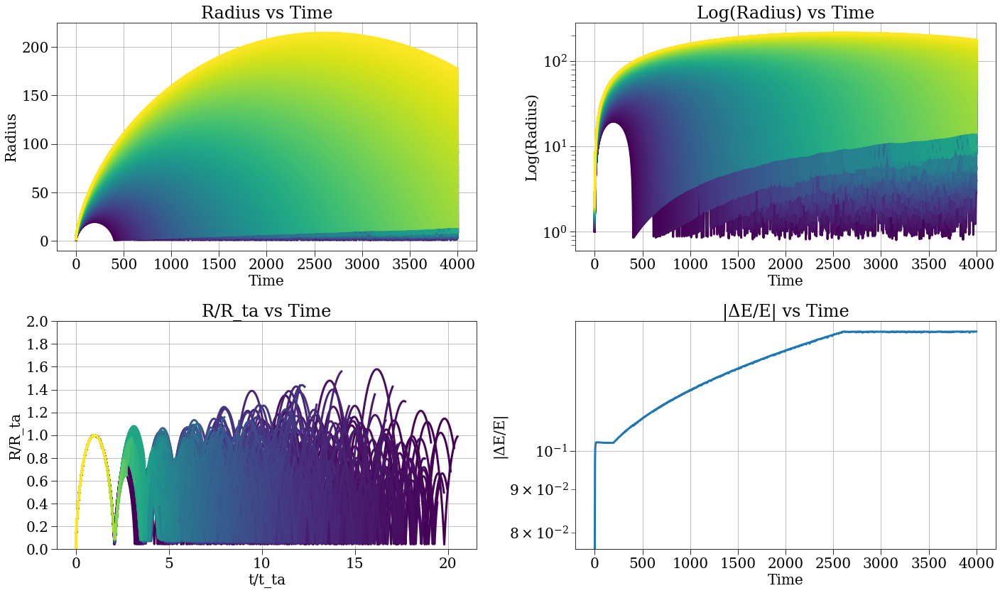

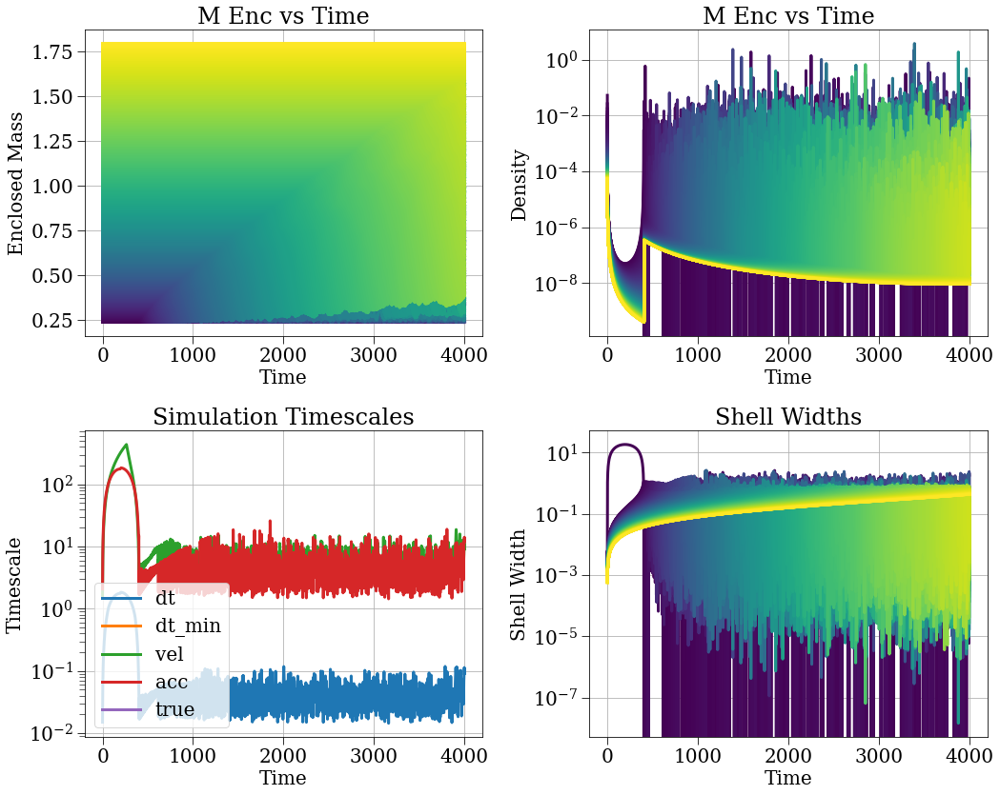

In [14]:
config = make_config(N=N, r_min=r_min, r_max=r_max, t_max=t_max, j_coef=j_coef, save_dt=save_dt, density_strategy=density_strategy, delta=delta, safety_factor=safety_factor, stepper_strategy='leapfrog_hut',  timescale_strategy=tss, H=H0, initial_radius_strategy=irs, gamma=gamma, initial_v_strategy=ivs, accel_strategy=accel_strategy, ang_mom_strategy=ang_mom_strategy, save_filename='7-31-3.h5', r_small=1, softlen=softlen, problematic_shell_strategy=problematic_shell_strategy, thickness_coef=thickness_coef, m_enc_strategy=mes, save_strategy=save_strategy)
sc, results, plotter = run_sc(config, profile=False, plot=True)

{'G': 1,
 'H': 0.6666666666666666,
 'N': 1000,
 'accel_strategy': 'grant_gmr_j_at_r_ta_soft',
 'ang_mom_strategy': 'zero',
 'delta': 0.01,
 'density_strategy': 'background_plus_power_law',
 'deque_size': 0,
 'drhodr_strategy': 'finite_diff',
 'dt': 1e-05,
 'dt_min': 0,
 'energy_strategy': 'kin_grav_rot_absorbed',
 'gamma': -2.5,
 'hbar2_over_m2': 0,
 'initial_mass_strategy': 'integrated_mass',
 'initial_radius_strategy': 'equal_mass',
 'initial_v_strategy': 'hubble',
 'j_coef': 0.3,
 'm_enc_strategy': 'inclusive',
 'm_pert': 1,
 'next_save_time': 0,
 'num_crossing': 0,
 'point_mass': 0,
 'point_mass_strategy': 'rmin_rho_r',
 'polytropic_coef': 0,
 'polytropic_index': -1,
 'pressure_strategy': 'zero',
 'problematic_shell_strategy': 'nothing',
 'r0_min': 1.001,
 'r_max': 2,
 'r_min': 1,
 'r_min_strategy': 'nothing',
 'r_small': 1,
 'r_ta_strategy': 'r_ta_cycloid',
 'relaxation_time': 0,
 'rho_bar': 0.05305164769729845,
 'safety_factor': 0.01,
 'save_dt': 1,
 'save_filename': '7-31-2.h5',

2025-07-31 22:06:32,317 - collapse - INFO - Simulation setup complete


2025-07-31 22:07:25,227 - DEBUG - Saved dataset t with shape (3939,)
2025-07-31 22:07:25,228 - DEBUG - Saved dataset dt with shape (3939,)
2025-07-31 22:07:25,261 - DEBUG - Saved dataset r with shape (3939, 1000)
2025-07-31 22:07:25,288 - DEBUG - Saved dataset v with shape (3939, 1000)
2025-07-31 22:07:25,314 - DEBUG - Saved dataset a with shape (3939, 1000)
2025-07-31 22:07:25,341 - DEBUG - Saved dataset m_enc with shape (3939, 1000)
2025-07-31 22:07:25,366 - DEBUG - Saved dataset rho_r with shape (3939, 1000)
2025-07-31 22:07:25,368 - WARNING - Skipping pressure because all values are None
2025-07-31 22:07:25,369 - WARNING - Skipping dpressure_drho because all values are None
2025-07-31 22:07:25,370 - WARNING - Skipping rho_prime because all values are None


2025-07-31 22:07:26,056 - DEBUG - Saved dataset e_tot with shape (3939, 1000)
2025-07-31 22:07:26,190 - DEBUG - Saved dataset e_g with shape (3939, 1000)
2025-07-31 22:07:26,294 - DEBUG - Saved dataset e_k with shape (3939, 1000)
2025-07-31 22:07:26,377 - DEBUG - Saved dataset e_r with shape (3939, 1000)
2025-07-31 22:07:26,379 - WARNING - Skipping e_p because all values are None
2025-07-31 22:07:26,381 - WARNING - Skipping e_q because all values are None
2025-07-31 22:07:26,382 - WARNING - Skipping t_dyn because all values are None
2025-07-31 22:07:26,385 - DEBUG - Saved dataset t_vel with shape (3939,)
2025-07-31 22:07:26,441 - DEBUG - Saved dataset t_acc with shape (3939,)
2025-07-31 22:07:26,443 - WARNING - Skipping t_cross because all values are None
2025-07-31 22:07:26,444 - WARNING - Skipping t_crossa because all values are None
2025-07-31 22:07:26,446 - WARNING - Skipping t_cross2 because all values are None
2025-07-31 22:07:26,448 - WARNING - Skipping t_zero because all values

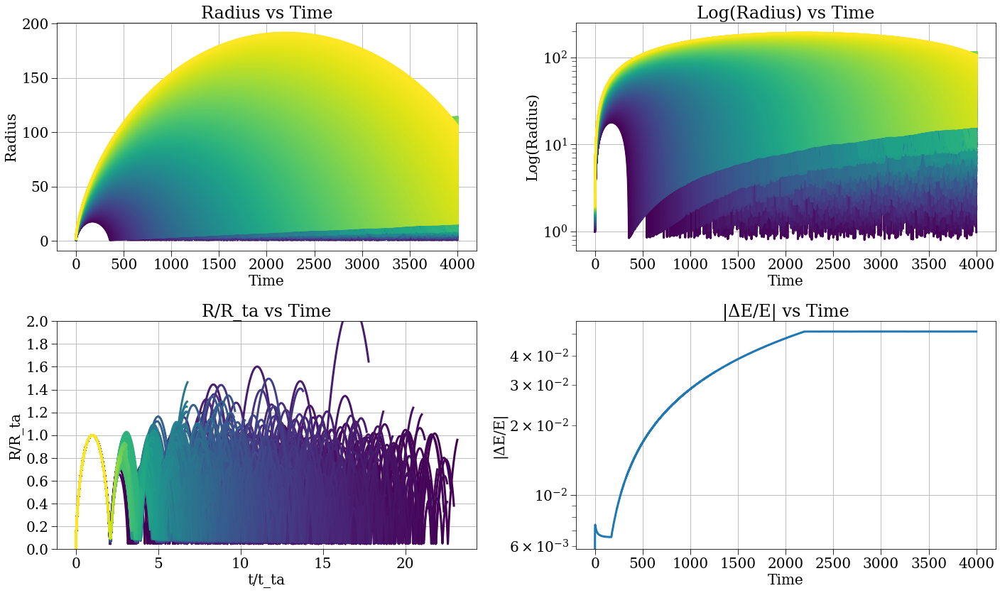

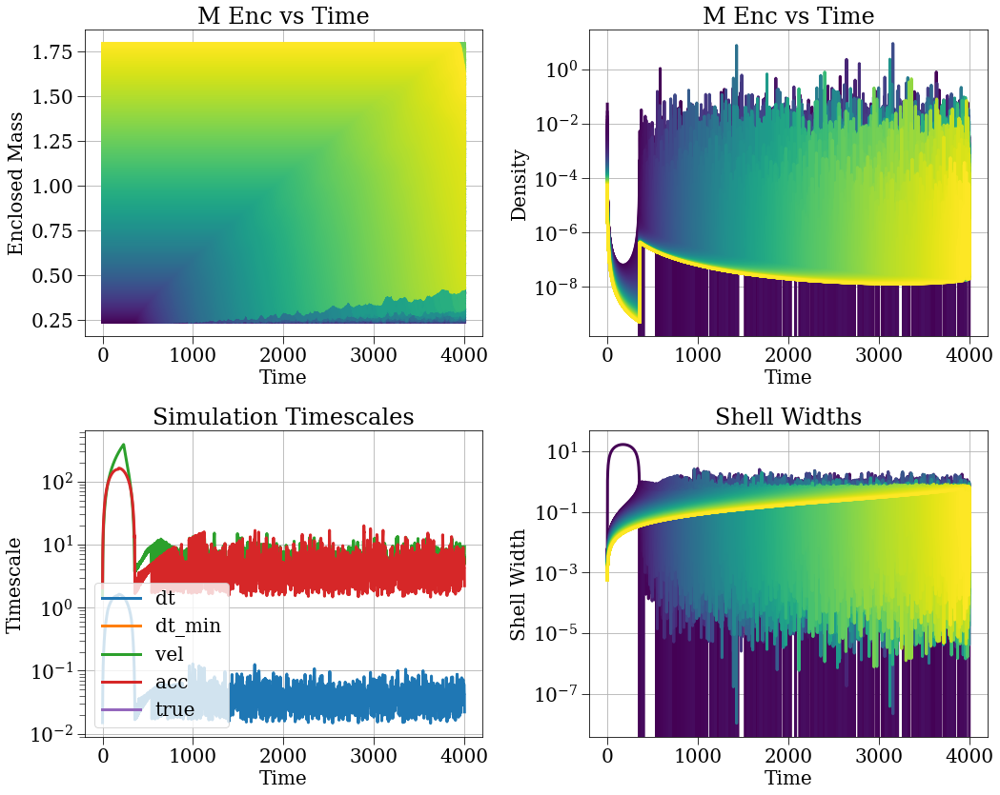

In [10]:
config = make_config(N=N, r_min=r_min, r_max=r_max, t_max=t_max, j_coef=j_coef, save_dt=save_dt, density_strategy=density_strategy, delta=delta, safety_factor=safety_factor, stepper_strategy='leapfrog_hut',  timescale_strategy=tss, H=H0, initial_radius_strategy=irs, gamma=gamma, initial_v_strategy=ivs, accel_strategy=accel_strategy, ang_mom_strategy=ang_mom_strategy, save_filename='7-31-2.h5', r_small=1, softlen=softlen, problematic_shell_strategy=problematic_shell_strategy, thickness_coef=thickness_coef, m_enc_strategy=mes, save_strategy=save_strategy)
sc, results, plotter = run_sc(config, profile=False, plot=True)

{'G': 1,
 'H': 0.6666666666666666,
 'N': 1000,
 'accel_strategy': 'grant_gmr_j_at_r_ta_soft',
 'ang_mom_strategy': 'zero',
 'delta': 0.01,
 'density_strategy': 'background_plus_power_law',
 'deque_size': 0,
 'drhodr_strategy': 'finite_diff',
 'dt': 1e-05,
 'dt_min': 0,
 'energy_strategy': 'kin_grav_rot_absorbed',
 'gamma': -2.5,
 'hbar2_over_m2': 0,
 'initial_mass_strategy': 'integrated_mass',
 'initial_radius_strategy': 'equal_mass',
 'initial_v_strategy': 'hubble',
 'j_coef': 0.3,
 'm_enc_strategy': 'inclusive',
 'm_pert': 1,
 'next_save_time': 0,
 'num_crossing': 0,
 'point_mass': 0,
 'point_mass_strategy': 'rmin_rho_r',
 'polytropic_coef': 0,
 'polytropic_index': -1,
 'pressure_strategy': 'zero',
 'problematic_shell_strategy': 'nothing',
 'r0_min': 1.001,
 'r_max': 2,
 'r_min': 1,
 'r_min_strategy': 'nothing',
 'r_small': 1,
 'r_ta_strategy': 'r_ta_cycloid',
 'relaxation_time': 0,
 'rho_bar': 0.05305164769729845,
 'safety_factor': 0.01,
 'save_dt': 1,
 'save_filename': '7-31-1.h5',

2025-07-31 22:01:57,294 - collapse - INFO - Simulation setup complete


2025-07-31 22:02:51,963 - DEBUG - Saved dataset t with shape (3942,)
2025-07-31 22:02:51,964 - DEBUG - Saved dataset dt with shape (3942,)
2025-07-31 22:02:52,013 - DEBUG - Saved dataset r with shape (3942, 1000)
2025-07-31 22:02:52,056 - DEBUG - Saved dataset v with shape (3942, 1000)
2025-07-31 22:02:52,089 - DEBUG - Saved dataset a with shape (3942, 1000)
2025-07-31 22:02:52,120 - DEBUG - Saved dataset m_enc with shape (3942, 1000)


2025-07-31 22:02:52,149 - DEBUG - Saved dataset rho_r with shape (3942, 1000)
2025-07-31 22:02:52,150 - WARNING - Skipping pressure because all values are None
2025-07-31 22:02:52,151 - WARNING - Skipping dpressure_drho because all values are None
2025-07-31 22:02:52,152 - WARNING - Skipping rho_prime because all values are None
2025-07-31 22:02:52,184 - DEBUG - Saved dataset e_tot with shape (3942, 1000)
2025-07-31 22:02:52,213 - DEBUG - Saved dataset e_g with shape (3942, 1000)
2025-07-31 22:02:52,240 - DEBUG - Saved dataset e_k with shape (3942, 1000)
2025-07-31 22:02:52,268 - DEBUG - Saved dataset e_r with shape (3942, 1000)
2025-07-31 22:02:52,269 - WARNING - Skipping e_p because all values are None
2025-07-31 22:02:52,270 - WARNING - Skipping e_q because all values are None
2025-07-31 22:02:52,271 - WARNING - Skipping t_dyn because all values are None
2025-07-31 22:02:52,272 - DEBUG - Saved dataset t_vel with shape (3942,)
2025-07-31 22:02:52,273 - DEBUG - Saved dataset t_acc wit

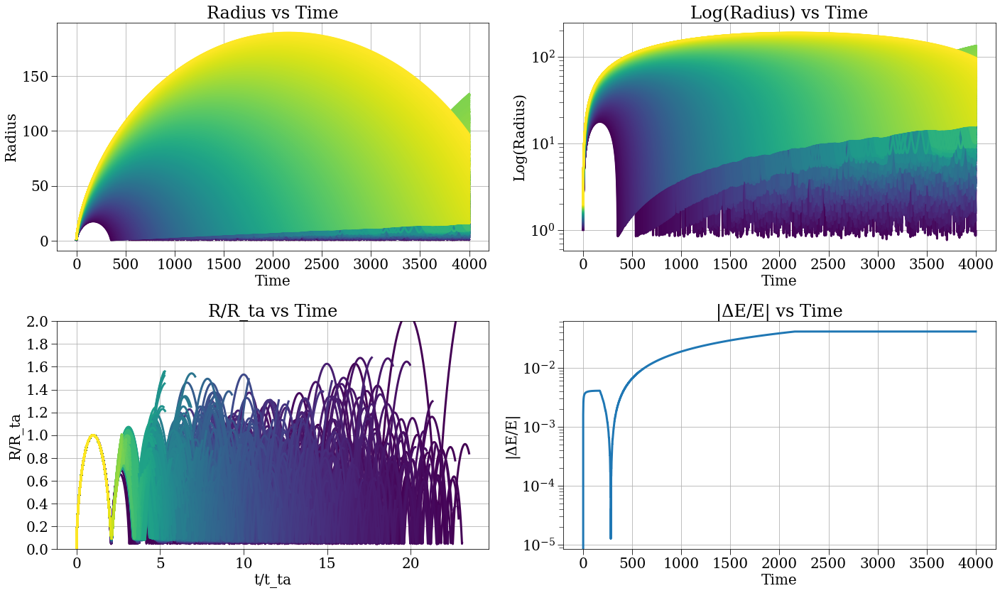

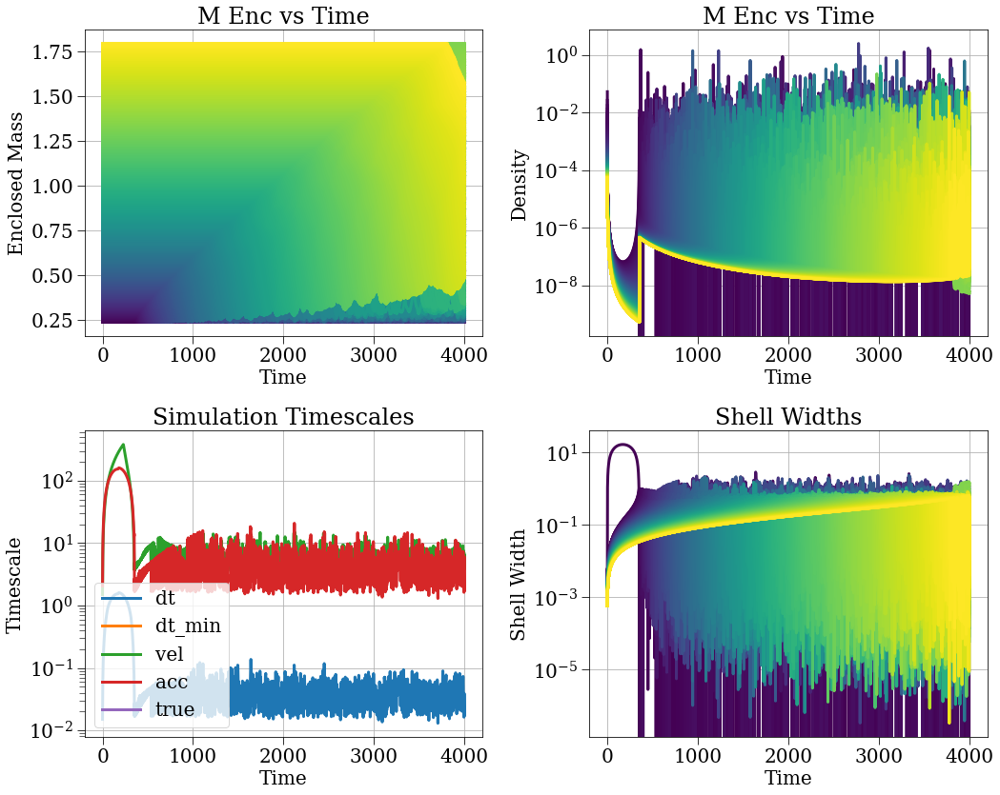

In [6]:
config = make_config(N=N, r_min=r_min, r_max=r_max, t_max=t_max, j_coef=j_coef, save_dt=save_dt, density_strategy=density_strategy, delta=delta, safety_factor=safety_factor, stepper_strategy='leapfrog_hut',  timescale_strategy=tss, H=H0, initial_radius_strategy=irs, gamma=gamma, initial_v_strategy=ivs, accel_strategy=accel_strategy, ang_mom_strategy=ang_mom_strategy, save_filename='7-31-1.h5', r_small=1, softlen=softlen, problematic_shell_strategy=problematic_shell_strategy, thickness_coef=thickness_coef, m_enc_strategy=mes, save_strategy=save_strategy)
sc, results, plotter = run_sc(config, profile=False, plot=True)

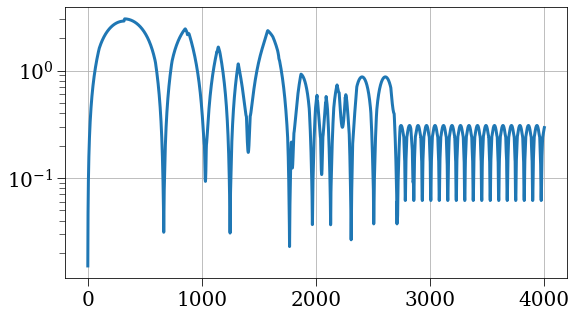

In [16]:
t = results['t']
saved_dt = np.diff(results['t'])
plt.plot(t[:-1], saved_dt)
plt.yscale('log')

(13579,) (1000,)


/home/jsipple/.conda/envs/jsipple/lib/python3.7/site-packages/IPython/core/events.py:88: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  func(*args, **kwargs)


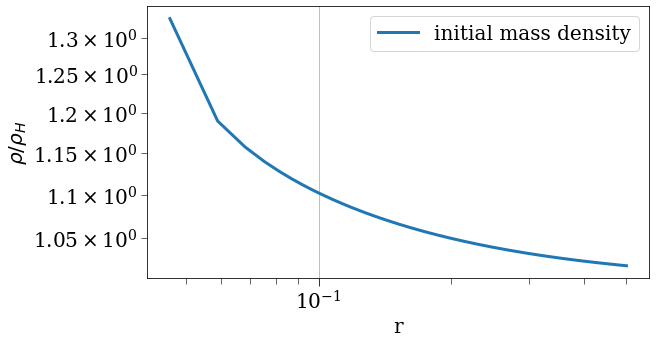

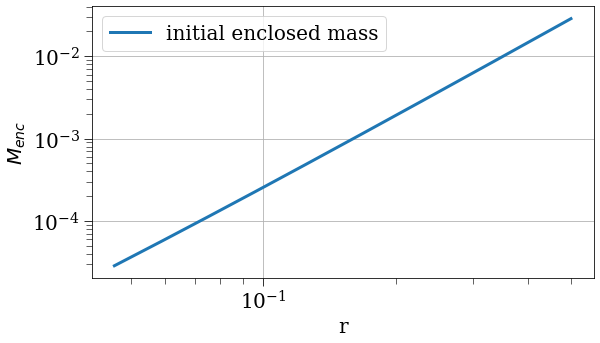

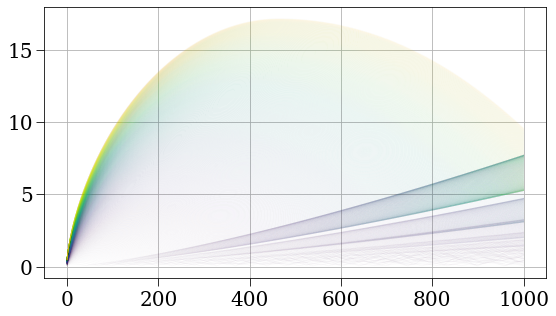

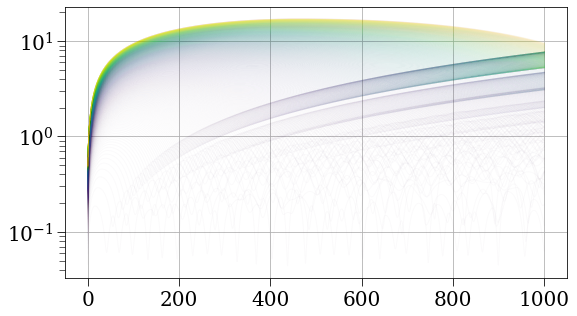

/home/jsipple/.conda/envs/jsipple/lib/python3.7/site-packages/IPython/core/pylabtools.py:128: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


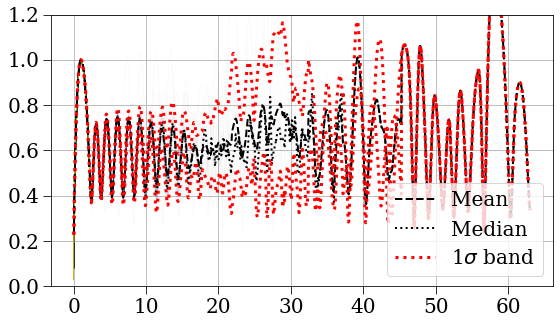

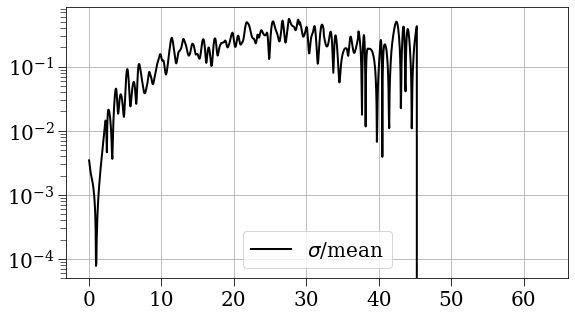

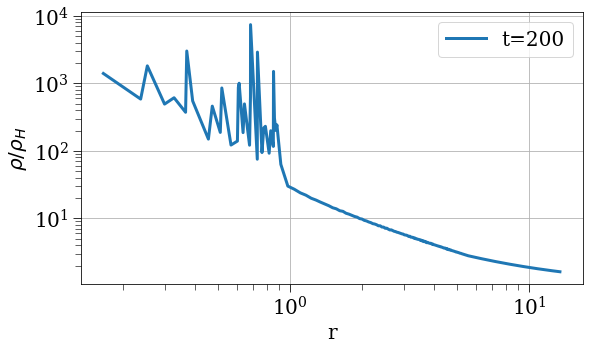

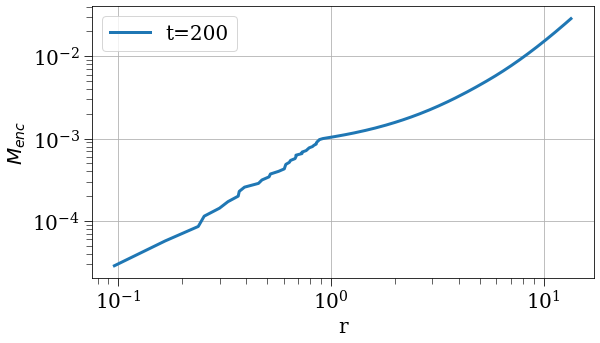

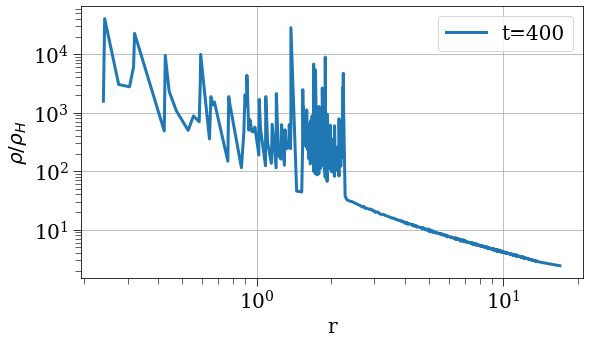

...

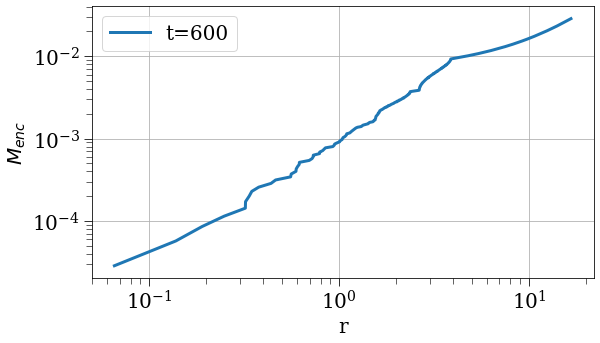

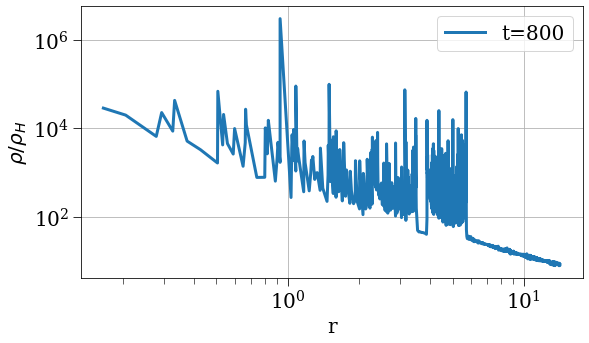

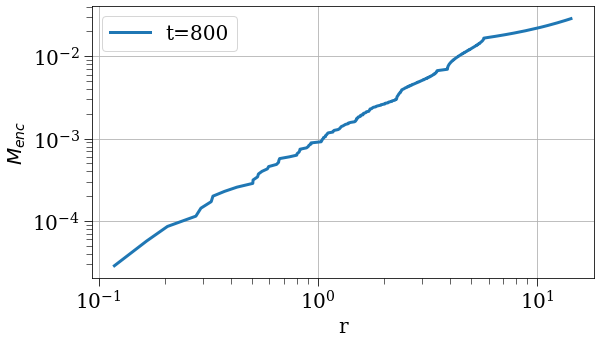

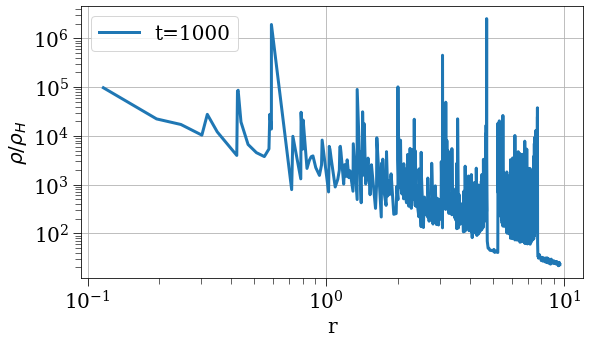

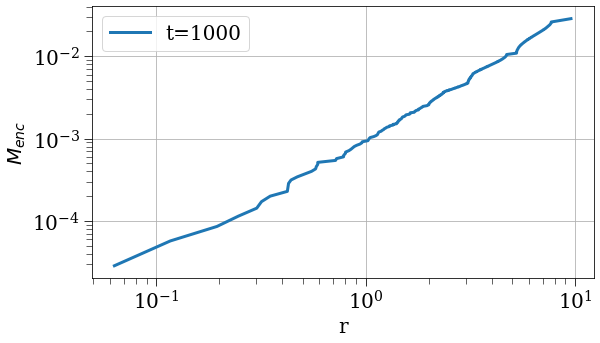

In [69]:
plot_results(results, sc)

{'G': 1,
 'H': 0.6666666666666666,
 'N': 1000,
 'accel_strategy': 'grant_gmr_j_at_r_ta_soft',
 'ang_mom_strategy': 'zero',
 'delta': 0.01,
 'density_strategy': 'background_plus_power_law',
 'deque_size': 0,
 'drhodr_strategy': 'finite_diff',
 'dt': 1e-05,
 'dt_min': 0,
 'energy_strategy': 'kin_grav_rot_absorbed',
 'gamma': -2.5,
 'hbar2_over_m2': 0,
 'initial_mass_strategy': 'integrated_mass',
 'initial_radius_strategy': 'equal_mass',
 'initial_v_strategy': 'hubble',
 'j_coef': 0.3,
 'm_enc_strategy': 'inclusive',
 'm_pert': 1,
 'next_save_time': 0,
 'num_crossing': 0,
 'point_mass': 0,
 'point_mass_strategy': 'rmin_rho_r',
 'polytropic_coef': 0,
 'polytropic_index': -1,
 'pressure_strategy': 'zero',
 'problematic_shell_strategy': 'nothing',
 'r0_min': 1.001,
 'r_max': 2,
 'r_min': 1,
 'r_min_strategy': 'nothing',
 'r_small': 1,
 'r_ta_strategy': 'r_ta_cycloid',
 'relaxation_time': 0,
 'rho_bar': 0.05305164769729845,
 'safety_factor': 0.01,
 'save_dt': 10,
 'save_strategy': 'vflip',
 '

2025-07-31 17:29:51,220 - collapse - INFO - Simulation setup complete


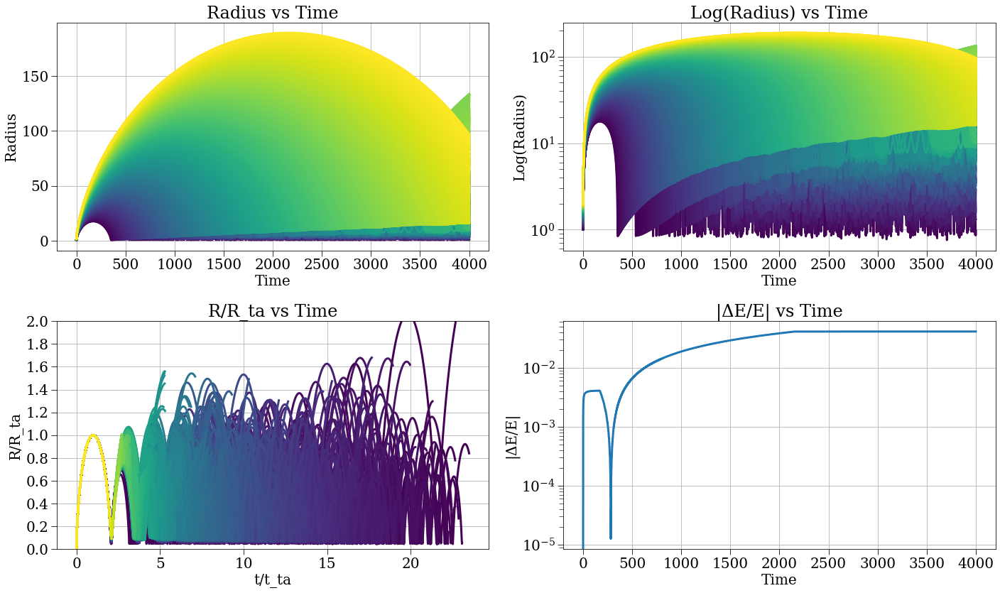

: 

: 

In [32]:
config = make_config(N=N, r_min=r_min, r_max=r_max, t_max=t_max, j_coef=j_coef, save_dt=save_dt, density_strategy=density_strategy, delta=delta, safety_factor=safety_factor, stepper_strategy='leapfrog_hut',  timescale_strategy=tss, H=H0, initial_radius_strategy=irs, gamma=gamma, initial_v_strategy=ivs, accel_strategy=accel_strategy, ang_mom_strategy=ang_mom_strategy, save_filename=None, r_small=1, softlen=softlen, problematic_shell_strategy=problematic_shell_strategy, thickness_coef=thickness_coef, m_enc_strategy=mes)
sc, results, plotter = run_sc(config, profile=False, plot=True)

(104235,) (1000,)


KeyboardInterrupt: 

Error in callback <function install_repl_displayhook.<locals>.post_execute at 0x2aaadb18c290> (for post_execute):


KeyboardInterrupt: 

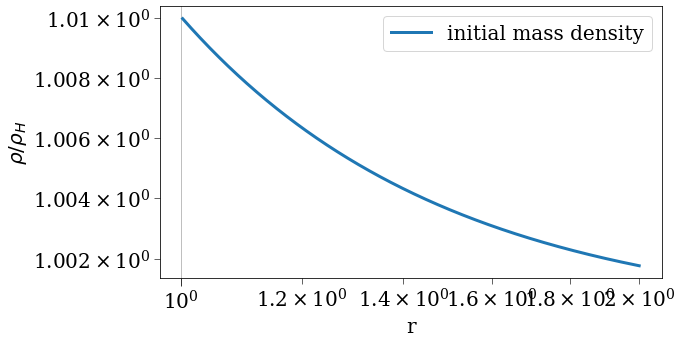

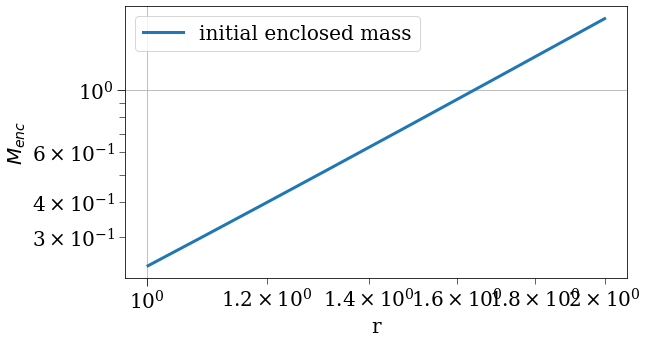

Error in callback <function flush_figures at 0x2aaab3a70d40> (for post_execute):


KeyboardInterrupt: 

In [6]:
params, results =load_simulation_data('/home/jsipple/one_d_spherical_collapse/one-d-spherical-collapse-of-fuzzy-dark-matter/runs/1k4k3e1.h5')
#pprint(params)
plot_results(results, params=params, sc=None)

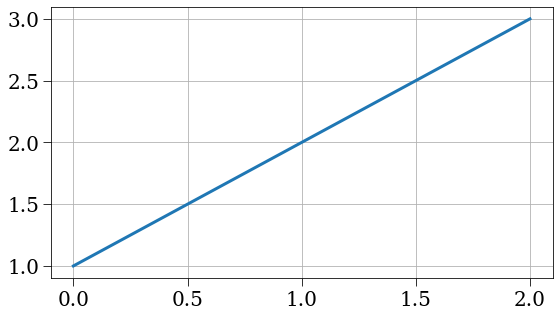

In [7]:
plt.plot([1,2,3])

{'G': 1,
 'H': 0.6666666666666666,
 'N': 100,
 'accel_strategy': 'grant_gmr_j_at_r_ta_soft',
 'ang_mom_strategy': 'zero',
 'delta': 0.01,
 'density_strategy': 'background_plus_power_law',
 'deque_size': 0,
 'drhodr_strategy': 'finite_diff',
 'dt': 1e-05,
 'dt_min': 0,
 'energy_strategy': 'kin_grav_rot_absorbed',
 'gamma': -2.5,
 'hbar2_over_m2': 0,
 'initial_mass_strategy': 'integrated_mass',
 'initial_radius_strategy': 'equal_mass',
 'initial_v_strategy': 'hubble',
 'j_coef': 0.3,
 'm_enc_strategy': 'inclusive',
 'm_pert': 1,
 'next_save_time': 0,
 'num_crossing': 0,
 'point_mass': 0,
 'point_mass_strategy': 'rmin_rho_r',
 'polytropic_coef': 0,
 'polytropic_index': -1,
 'pressure_strategy': 'zero',
 'problematic_shell_strategy': 'nothing',
 'r0_min': 1.01,
 'r_max': 2,
 'r_min': 1,
 'r_min_strategy': 'nothing',
 'r_small': 1,
 'r_ta_strategy': 'r_ta_cycloid',
 'relaxation_time': 0,
 'rho_bar': 0.05305164769729845,
 'safety_factor': 0.01,
 'save_dt': 1,
 'save_strategy': 'vflip',
 'she

2025-07-31 14:48:19,857 - collapse - INFO - Simulation setup complete


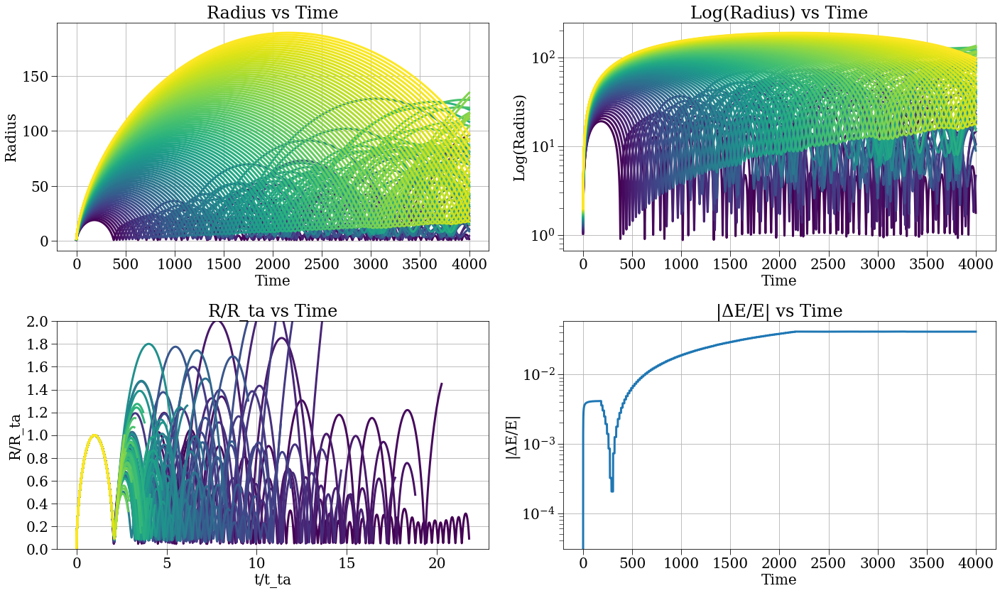

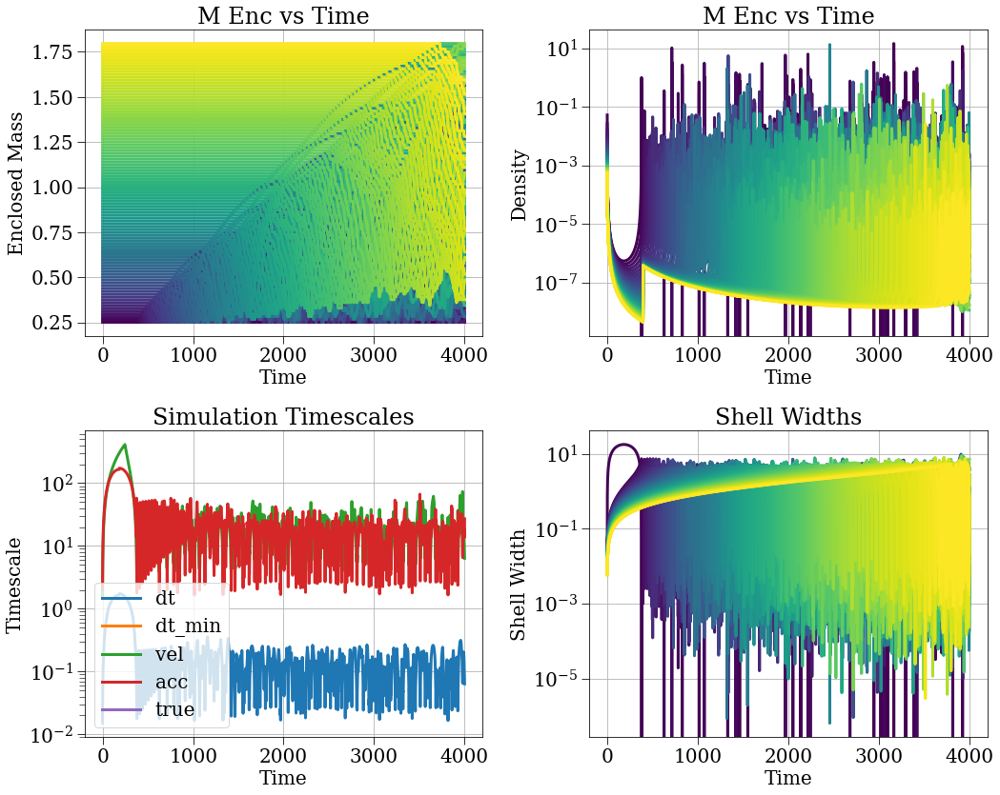

In [8]:
config = make_config(N=N, r_min=r_min, r_max=r_max, t_max=t_max, j_coef=j_coef, save_dt=save_dt, density_strategy=density_strategy, delta=delta, safety_factor=safety_factor, stepper_strategy='leapfrog_hut',  timescale_strategy=tss, H=H0, initial_radius_strategy=irs, gamma=gamma, initial_v_strategy=ivs, accel_strategy=accel_strategy, ang_mom_strategy=ang_mom_strategy, save_filename=None, r_small=1, softlen=softlen, problematic_shell_strategy=problematic_shell_strategy, thickness_coef=thickness_coef, m_enc_strategy=mes)
sc, results, plotter = run_sc(config, profile=False, plot=True)

{'G': 1,
 'H': 0.6666666666666666,
 'N': 1000,
 'accel_strategy': 'grant_gmr_j_at_r_ta_soft',
 'ang_mom_strategy': 'zero',
 'delta': 0.01,
 'density_strategy': 'background_plus_power_law',
 'deque_size': 0,
 'drhodr_strategy': 'finite_diff',
 'dt': 1e-05,
 'dt_min': 0,
 'energy_strategy': 'kin_grav_rot_absorbed',
 'gamma': -2.5,
 'hbar2_over_m2': 0,
 'initial_mass_strategy': 'integrated_mass',
 'initial_radius_strategy': 'equal_mass',
 'initial_v_strategy': 'hubble',
 'j_coef': 0.3,
 'm_enc_strategy': 'inclusive',
 'm_pert': 1,
 'next_save_time': 0,
 'num_crossing': 0,
 'point_mass': 0,
 'point_mass_strategy': 'rmin_rho_r',
 'polytropic_coef': 0,
 'polytropic_index': -1,
 'pressure_strategy': 'zero',
 'problematic_shell_strategy': 'nothing',
 'r0_min': 1.0005,
 'r_max': 1.5,
 'r_min': 1,
 'r_min_strategy': 'nothing',
 'r_small': 1,
 'r_ta_strategy': 'r_ta_cycloid',
 'relaxation_time': 0,
 'rho_bar': 0.05305164769729845,
 'safety_factor': 0.01,
 'save_dt': 1,
 'save_strategy': 'vflip',


2025-07-31 14:30:32,338 - collapse - INFO - Simulation setup complete


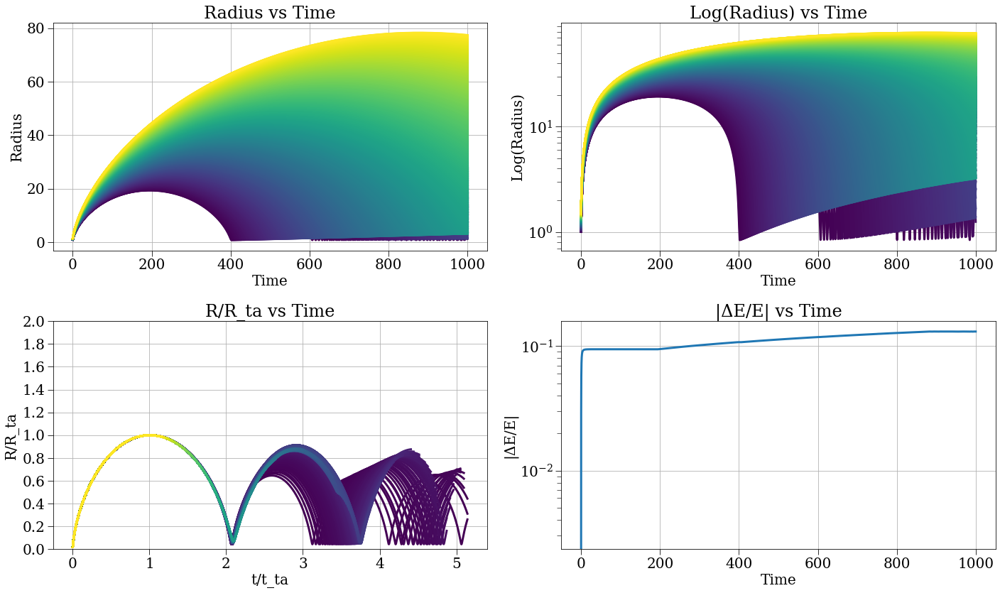

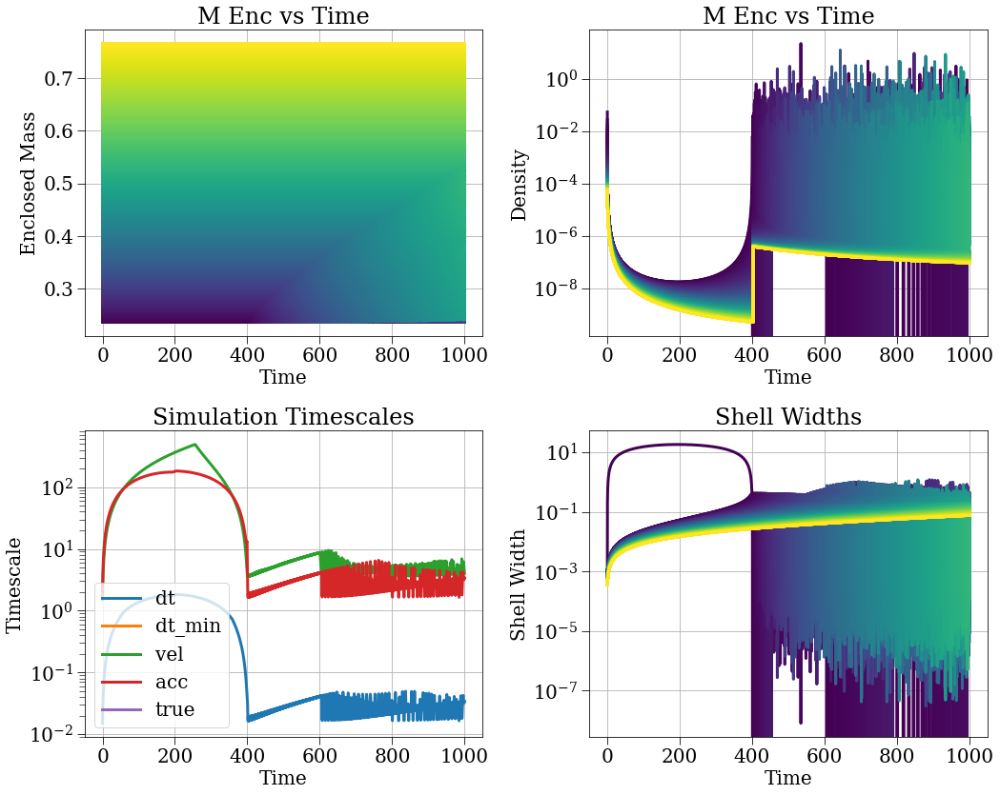

In [6]:
config = make_config(N=N, r_min=r_min, r_max=r_max, t_max=t_max, j_coef=j_coef, save_dt=save_dt, density_strategy=density_strategy, delta=delta, safety_factor=safety_factor, stepper_strategy='leapfrog_hut',  timescale_strategy=tss, H=H0, initial_radius_strategy=irs, gamma=gamma, initial_v_strategy=ivs, accel_strategy=accel_strategy, ang_mom_strategy=ang_mom_strategy, save_filename=None, r_small=1, softlen=softlen, problematic_shell_strategy=problematic_shell_strategy, thickness_coef=thickness_coef, m_enc_strategy=mes)
sc, results, plotter = run_sc(config, profile=False, plot=True)

(23673,) (1000,)


/home/jsipple/.conda/envs/jsipple/lib/python3.7/site-packages/IPython/core/events.py:88: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  func(*args, **kwargs)


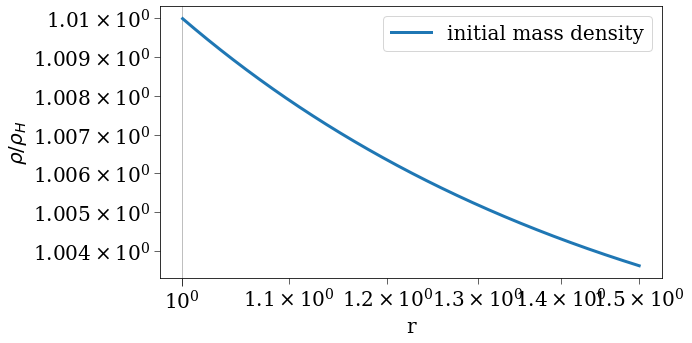

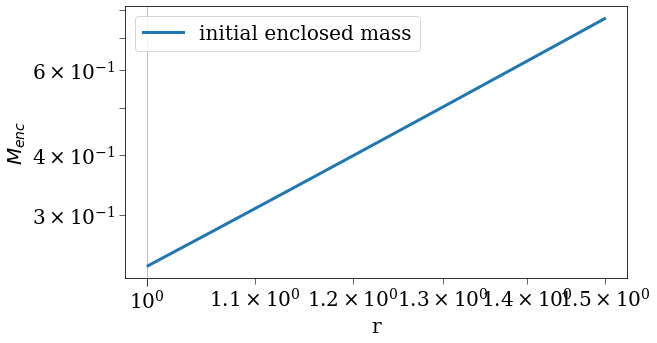

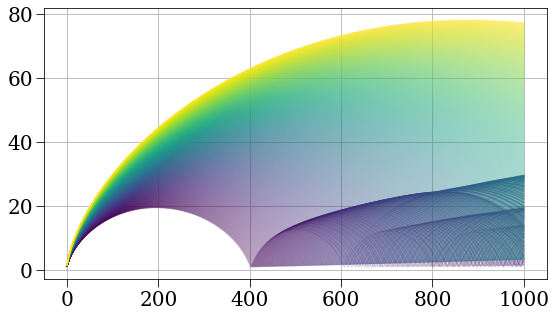

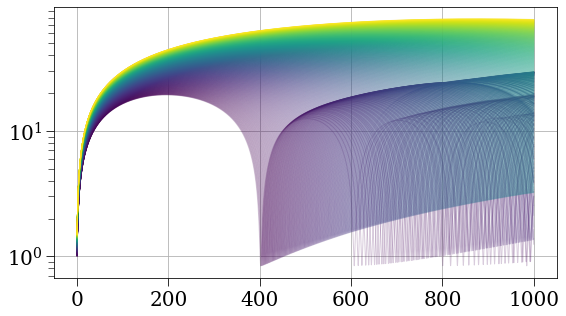

/home/jsipple/.conda/envs/jsipple/lib/python3.7/site-packages/IPython/core/pylabtools.py:128: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


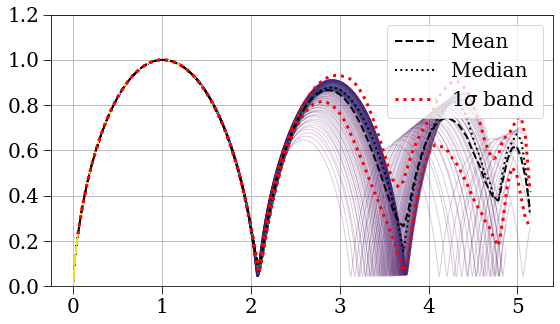

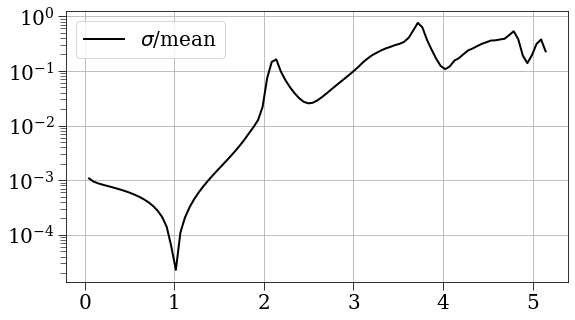

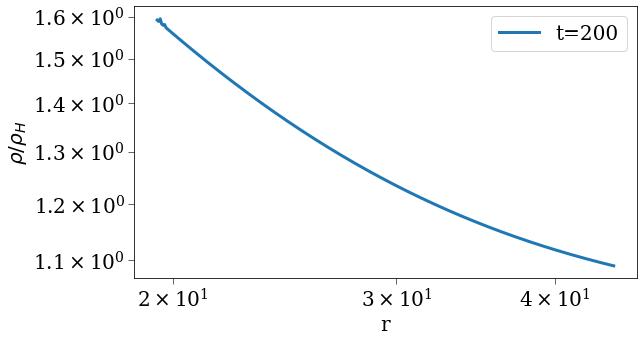

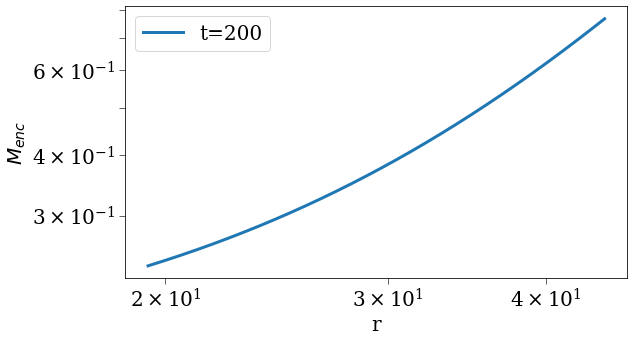

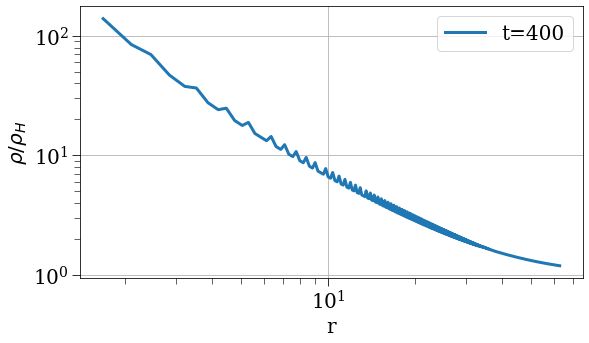

...

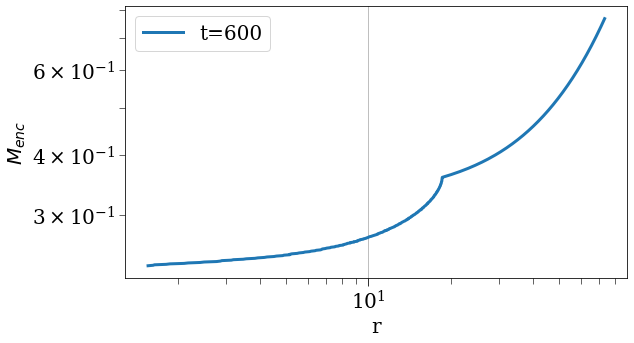

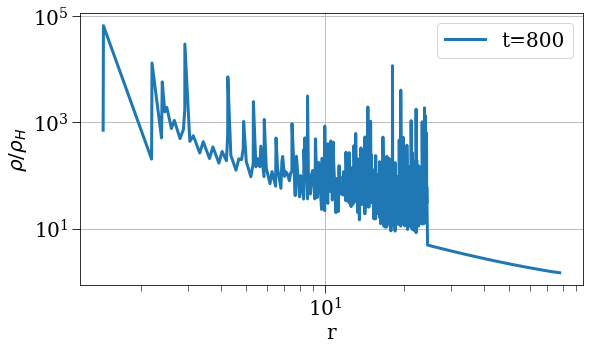

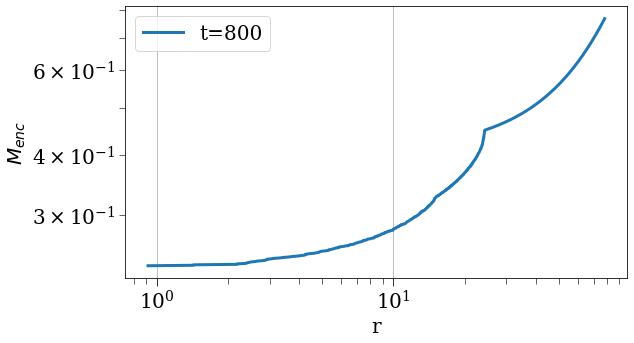

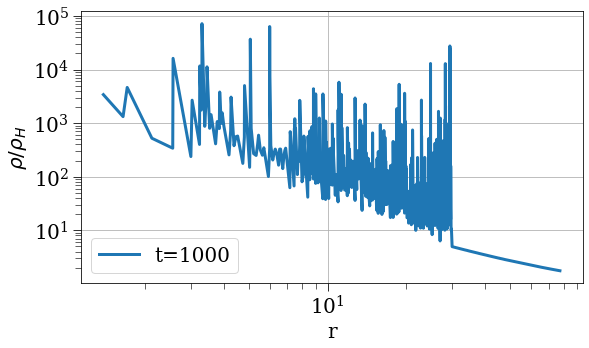

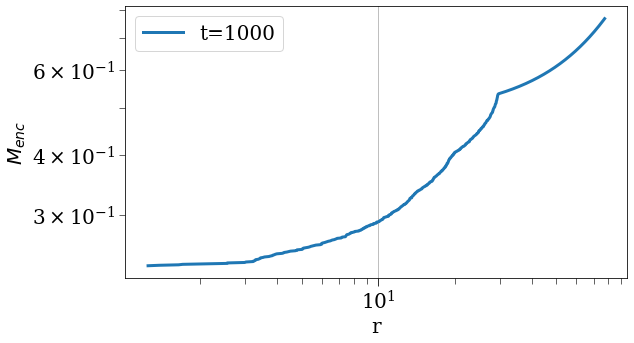

In [7]:
plot_results(results, sc)

(6897,) (1000,)


/home/jsipple/.conda/envs/jsipple/lib/python3.7/site-packages/IPython/core/events.py:88: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  func(*args, **kwargs)


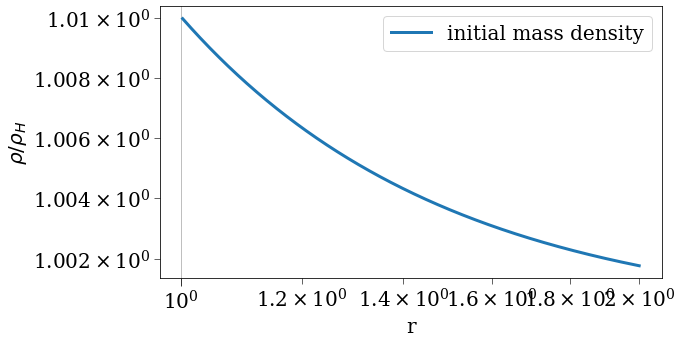

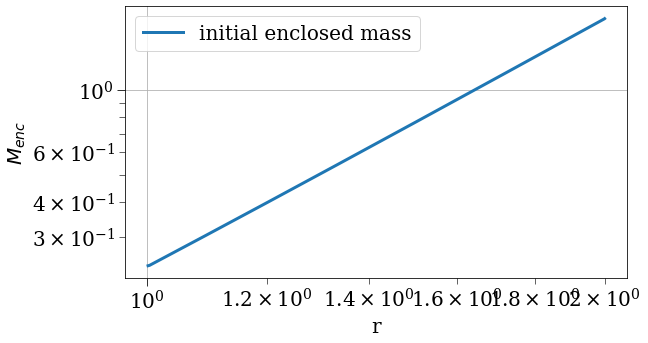

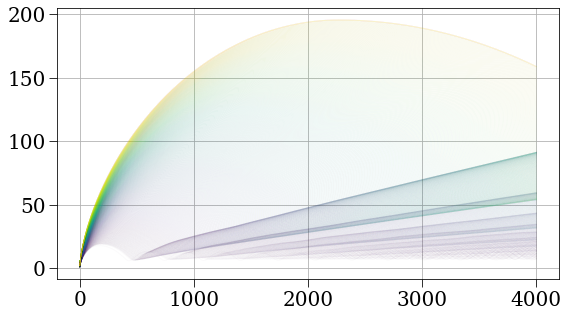

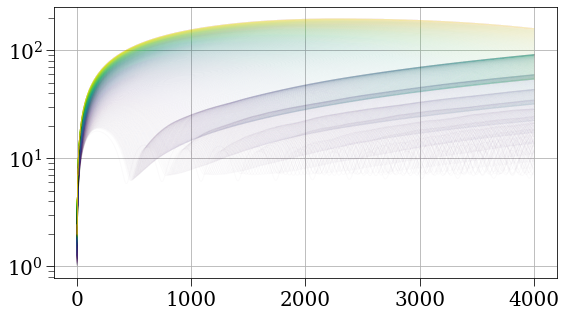

/home/jsipple/.conda/envs/jsipple/lib/python3.7/site-packages/IPython/core/pylabtools.py:128: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


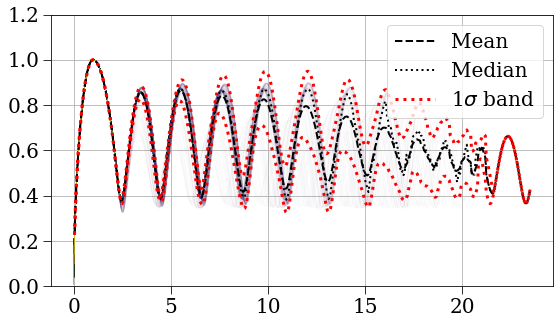

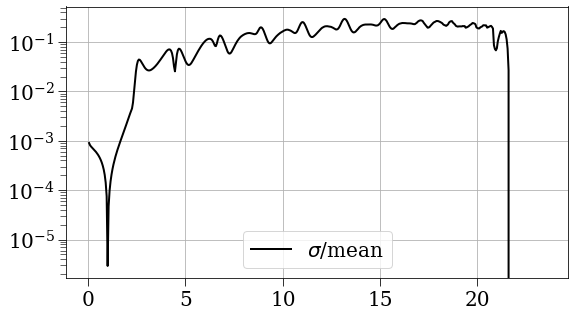

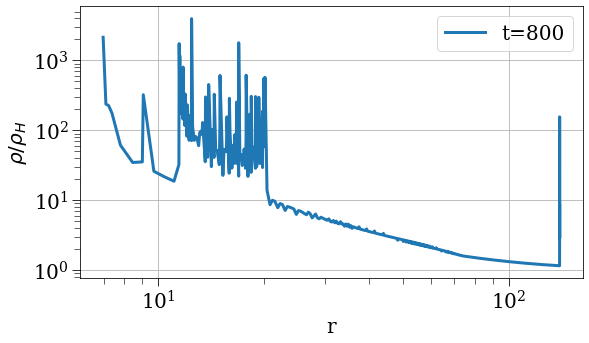

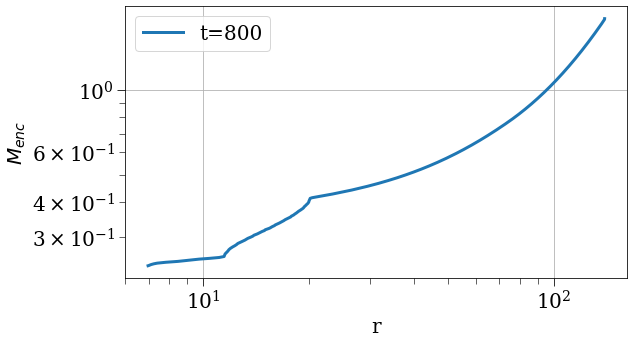

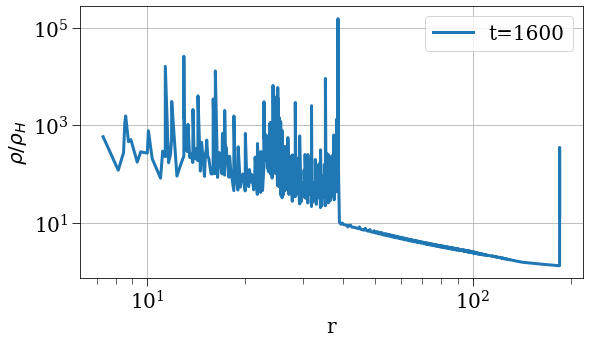

...

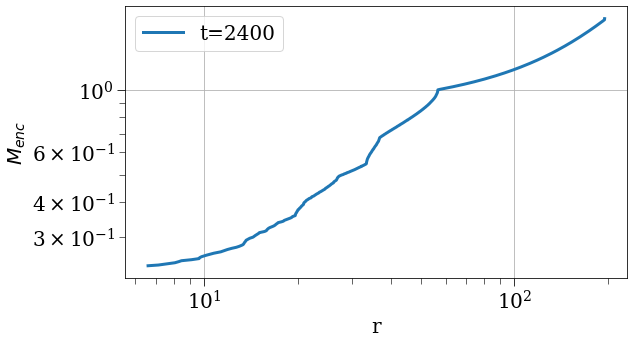

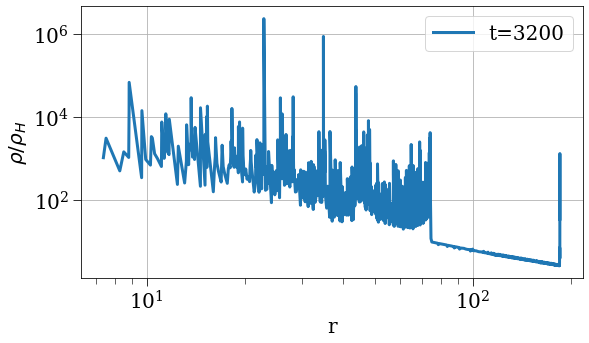

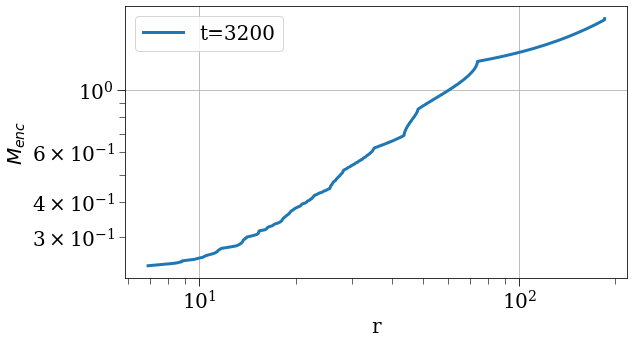

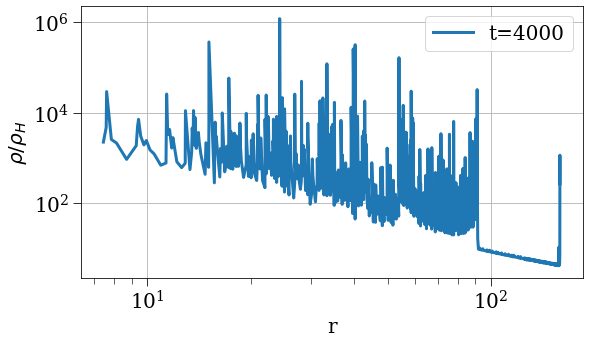

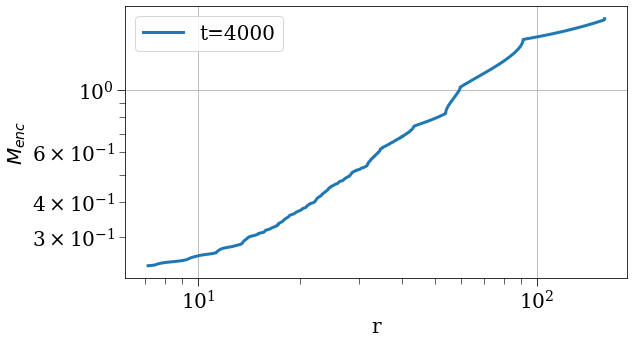

In [18]:
params, results =load_simulation_data('/home/jsipple/one_d_spherical_collapse/one-d-spherical-collapse-of-fuzzy-dark-matter/7-31-9.h5')
#pprint(params)
plot_results(results, params=params, sc=None)

(3888,) (1000,)


/home/jsipple/.conda/envs/jsipple/lib/python3.7/site-packages/IPython/core/events.py:88: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  func(*args, **kwargs)


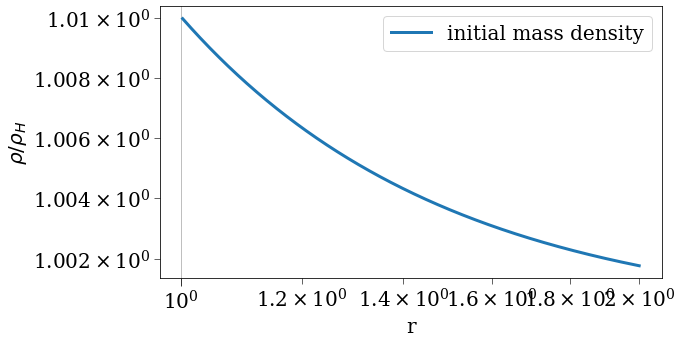

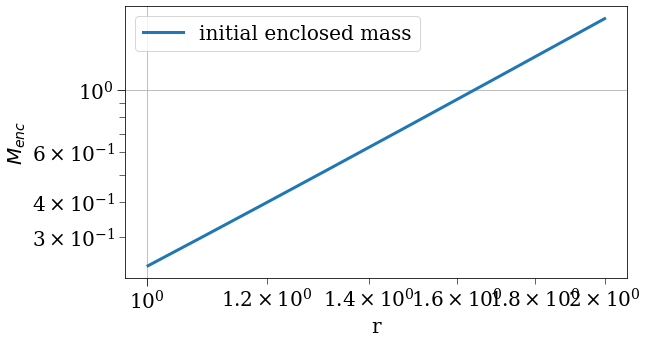

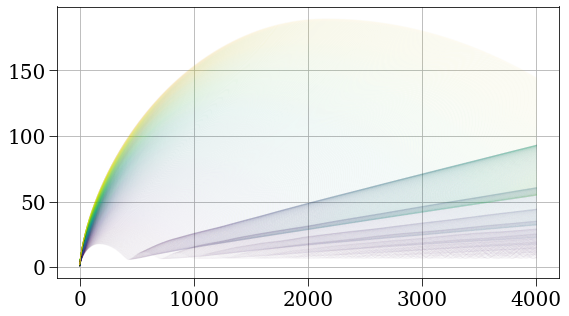

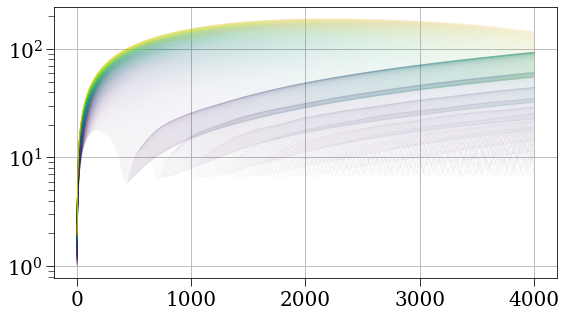

/home/jsipple/.conda/envs/jsipple/lib/python3.7/site-packages/IPython/core/pylabtools.py:128: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


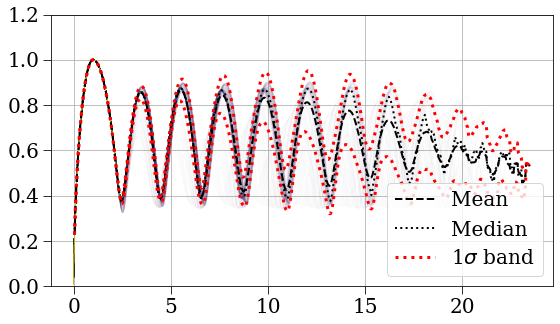

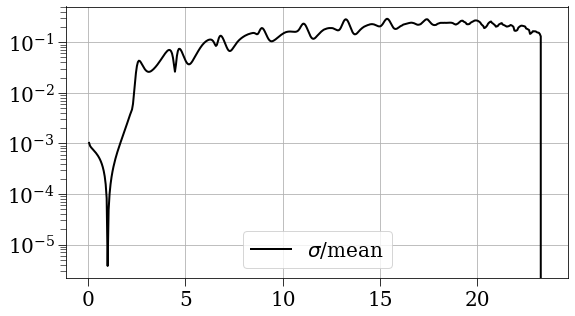

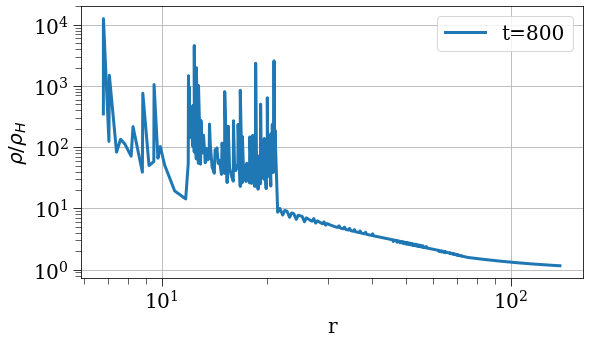

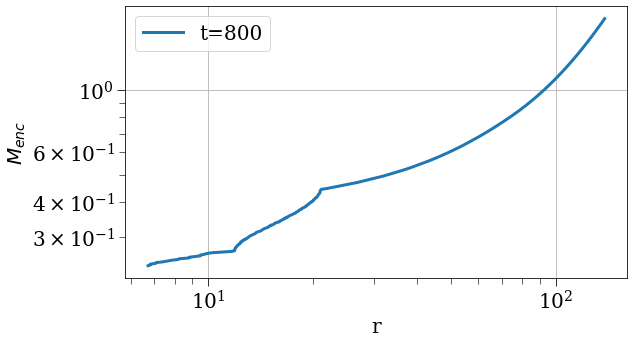

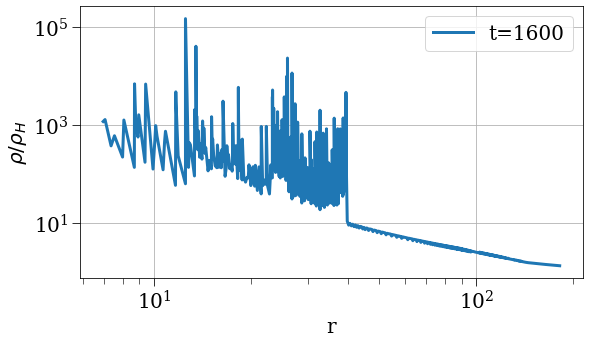

...

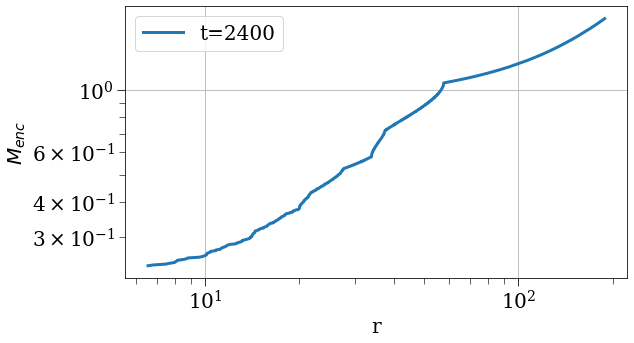

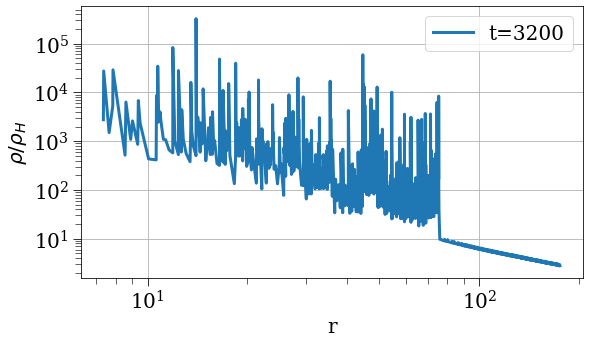

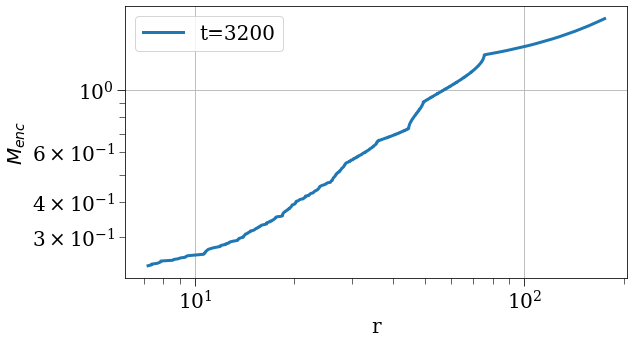

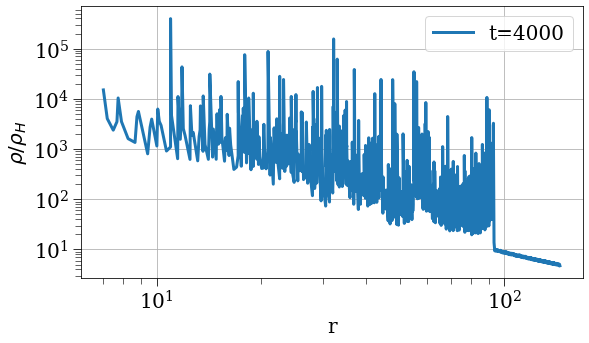

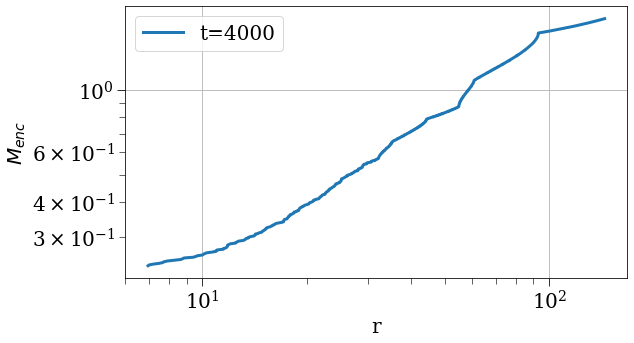

In [19]:
params, results =load_simulation_data('/home/jsipple/one_d_spherical_collapse/one-d-spherical-collapse-of-fuzzy-dark-matter/7-31-5.h5')
#pprint(params)
plot_results(results, params=params, sc=None)

### 7-31 runs

{'G': 1,
 'H': 0.6666666666666666,
 'N': 1000,
 'accel_strategy': 'grant_gmr_j_at_r_ta_soft',
 'ang_mom_strategy': 'zero',
 'delta': 0.01,
 'density_strategy': 'background_plus_power_law',
 'deque_size': 0,
 'drhodr_strategy': 'finite_diff',
 'dt': 1e-05,
 'dt_min': 0,
 'energy_strategy': 'kin_grav_rot_absorbed',
 'gamma': -2.5,
 'hbar2_over_m2': 0,
 'initial_mass_strategy': 'integrated_mass',
 'initial_radius_strategy': 'equal_mass',
 'initial_v_strategy': 'hubble',
 'j_coef': 0.3,
 'm_enc_strategy': 'inclusive',
 'm_pert': 1,
 'next_save_time': 0,
 'num_crossing': 0,
 'point_mass': 0,
 'point_mass_strategy': 'rmin_rho_r',
 'polytropic_coef': 0,
 'polytropic_index': -1,
 'pressure_strategy': 'zero',
 'problematic_shell_strategy': 'nothing',
 'r0_min': 1.001,
 'r_max': 2,
 'r_min': 1,
 'r_min_strategy': 'nothing',
 'r_small': 1,
 'r_ta_strategy': 'r_ta_cycloid',
 'relaxation_time': 0,
 'rho_bar': 0.05305164769729845,
 'safety_factor': 0.01,
 'save_dt': 1,
 'save_filename': '7-31-1.h5',

/home/jsipple/.conda/envs/jsipple/lib/python3.7/site-packages/IPython/core/events.py:88: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  func(*args, **kwargs)


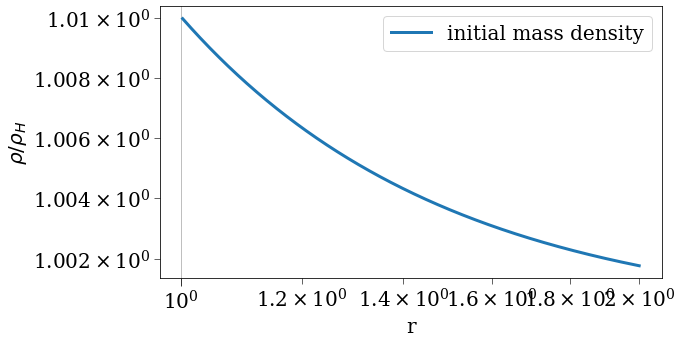

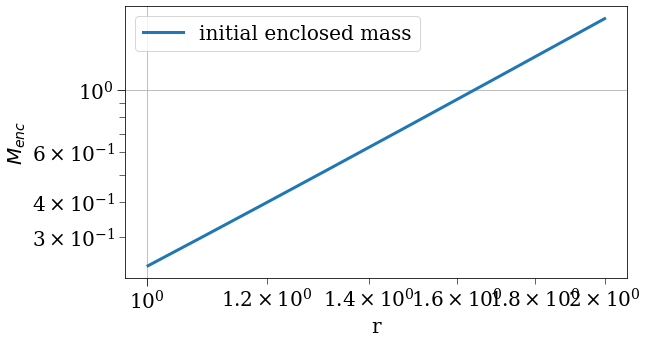

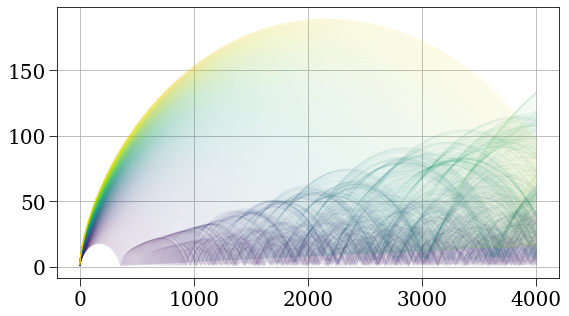

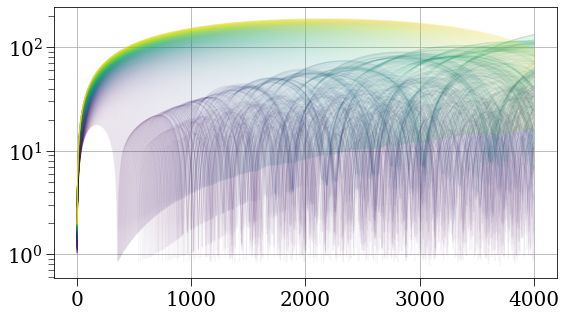

/home/jsipple/.conda/envs/jsipple/lib/python3.7/site-packages/IPython/core/pylabtools.py:128: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


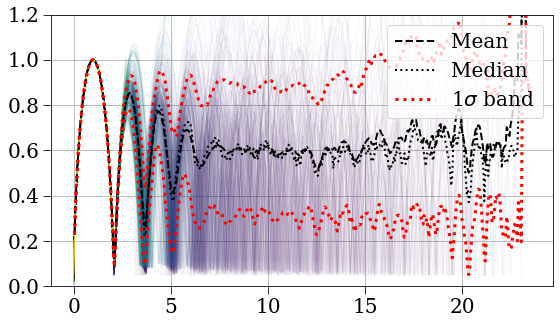

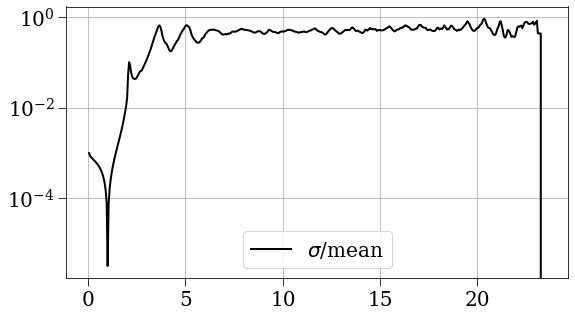

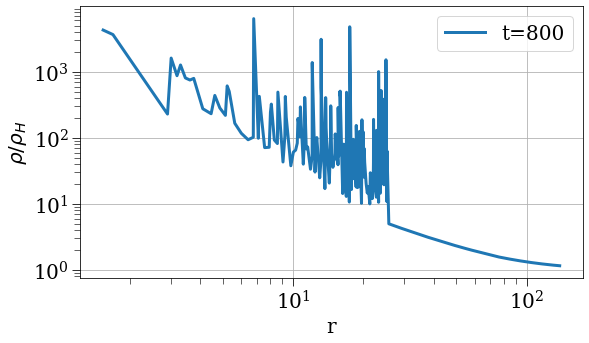

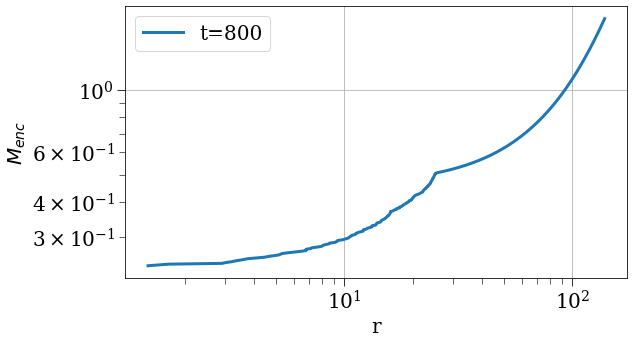

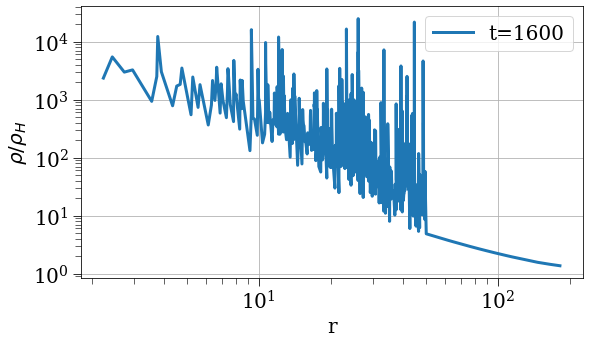

...

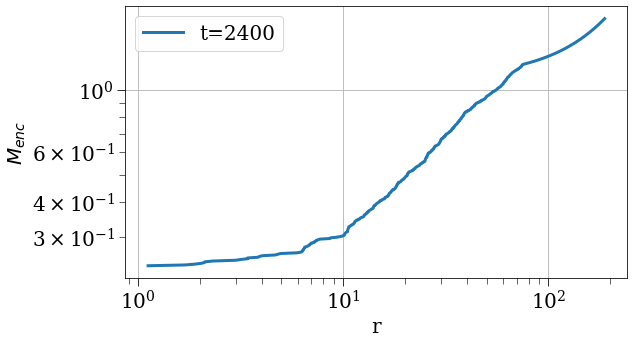

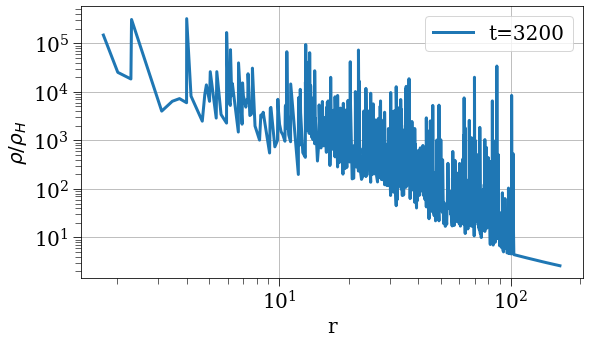

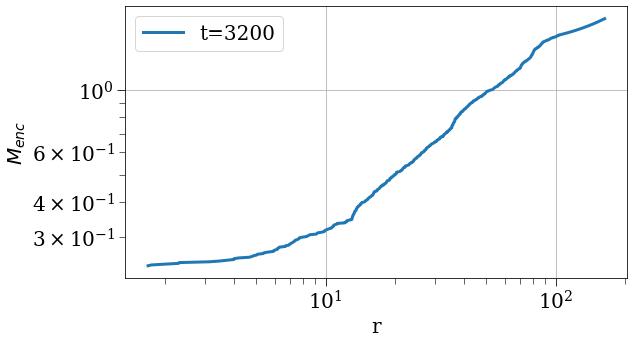

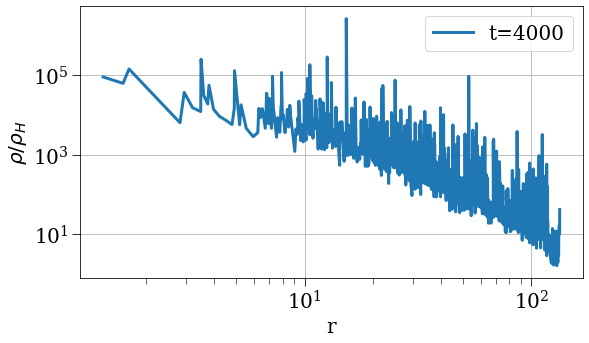

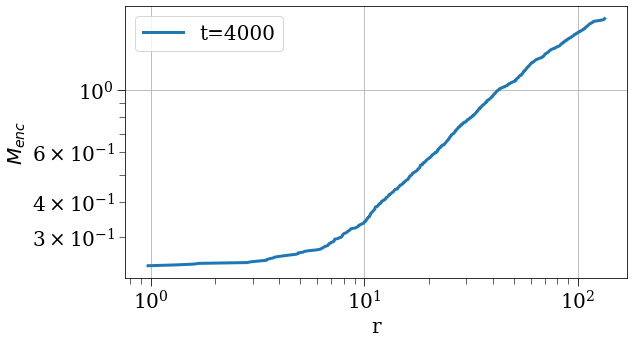

In [5]:
# j=3e-1
params, results =load_simulation_data('/home/jsipple/one_d_spherical_collapse/one-d-spherical-collapse-of-fuzzy-dark-matter/7-31-1.h5')
pprint(params)
plot_results(results, params=params, sc=None)

{'G': 1,
 'H': 0.6666666666666666,
 'N': 1000,
 'accel_strategy': 'grant_gmr_j_at_r_ta_soft',
 'ang_mom_strategy': 'zero',
 'delta': 0.01,
 'density_strategy': 'background_plus_power_law',
 'deque_size': 0,
 'drhodr_strategy': 'finite_diff',
 'dt': 1e-05,
 'dt_min': 0,
 'energy_strategy': 'kin_grav_rot_absorbed',
 'gamma': -2.5,
 'hbar2_over_m2': 0,
 'initial_mass_strategy': 'integrated_mass',
 'initial_radius_strategy': 'equal_mass',
 'initial_v_strategy': 'hubble',
 'j_coef': 0.3,
 'm_enc_strategy': 'inclusive',
 'm_pert': 1,
 'next_save_time': 0,
 'num_crossing': 0,
 'point_mass': 0,
 'point_mass_strategy': 'rmin_rho_r',
 'polytropic_coef': 0,
 'polytropic_index': -1,
 'pressure_strategy': 'zero',
 'problematic_shell_strategy': 'nothing',
 'r0_min': 1.001,
 'r_max': 2,
 'r_min': 1,
 'r_min_strategy': 'nothing',
 'r_small': 1,
 'r_ta_strategy': 'r_ta_cycloid',
 'relaxation_time': 0,
 'rho_bar': 0.05305164769729845,
 'safety_factor': 0.01,
 'save_dt': 1,
 'save_filename': '7-31-2.h5',

/home/jsipple/.conda/envs/jsipple/lib/python3.7/site-packages/IPython/core/events.py:88: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  func(*args, **kwargs)


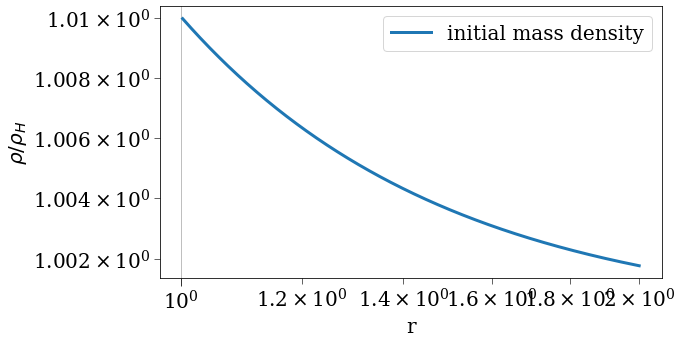

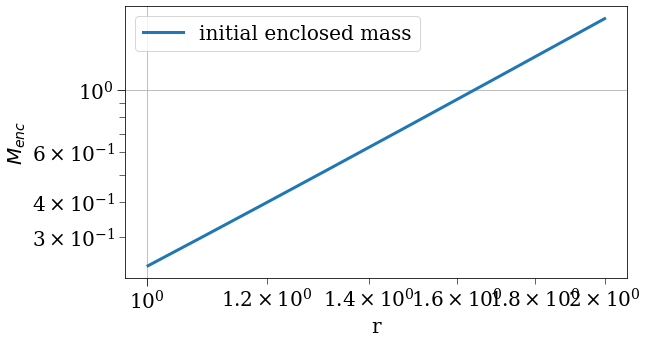

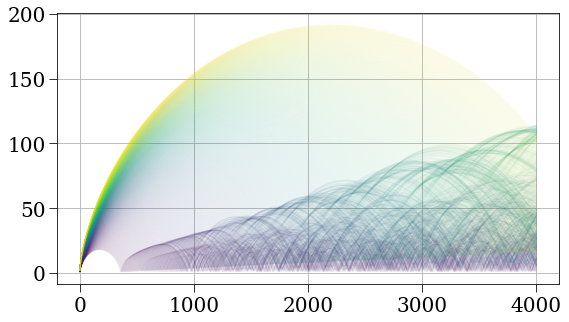

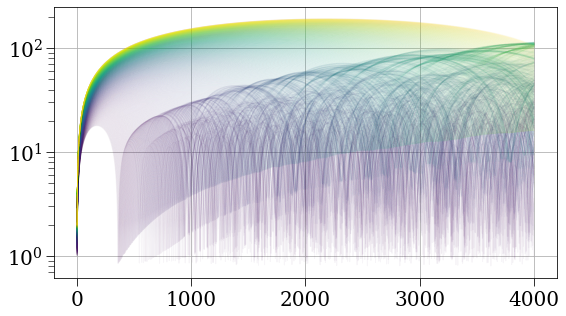

/home/jsipple/.conda/envs/jsipple/lib/python3.7/site-packages/IPython/core/pylabtools.py:128: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


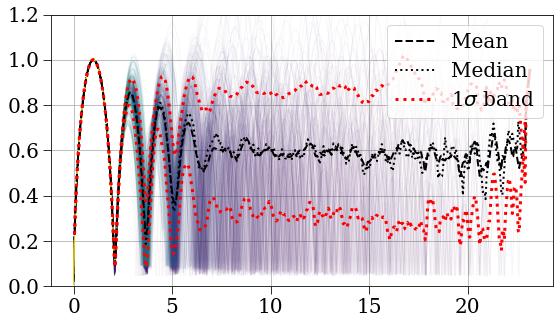

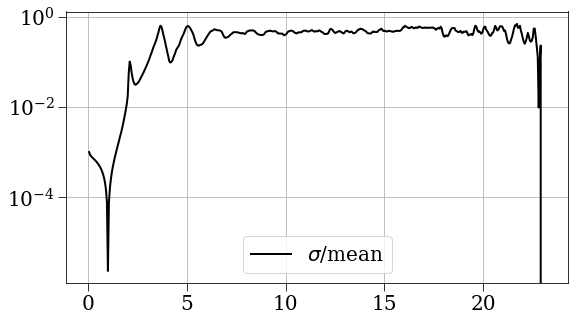

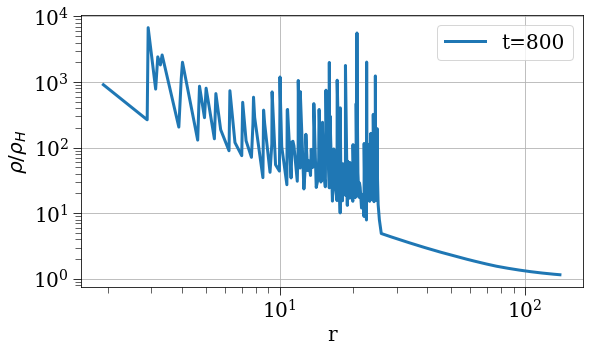

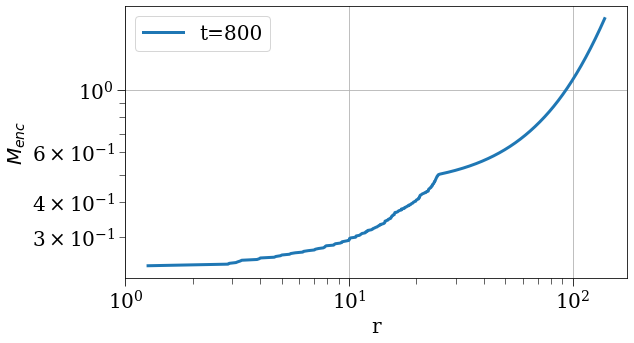

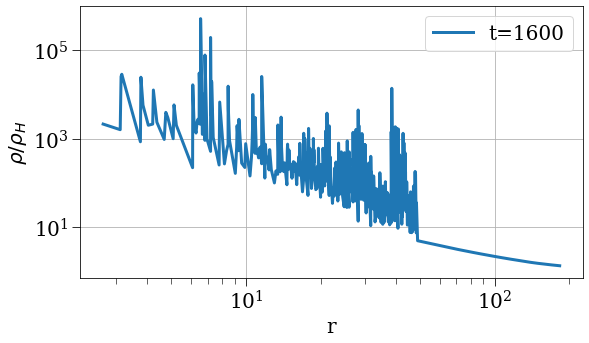

...

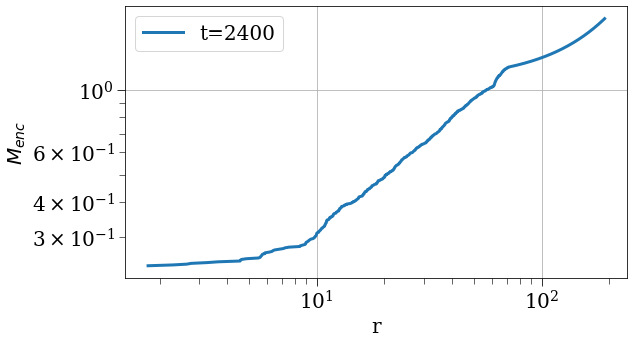

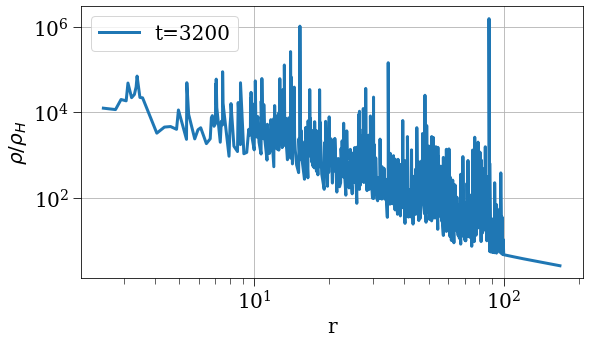

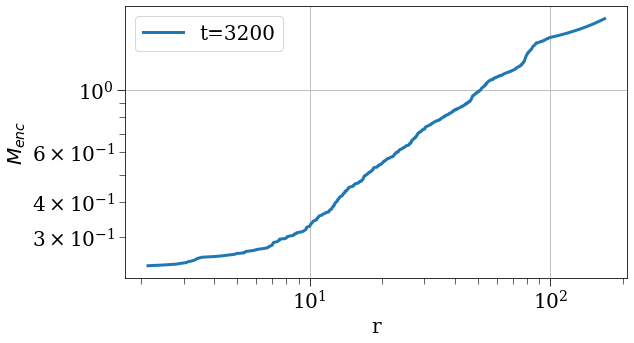

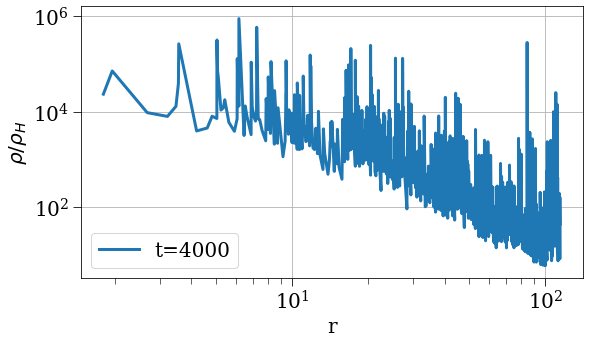

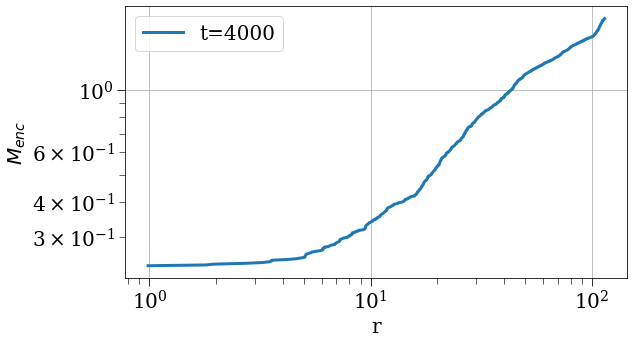

In [6]:
params, results =load_simulation_data('/home/jsipple/one_d_spherical_collapse/one-d-spherical-collapse-of-fuzzy-dark-matter/7-31-2.h5')
pprint(params)
plot_results(results, params=params, sc=None)

{'G': 1,
 'H': 0.6666666666666666,
 'N': 1000,
 'accel_strategy': 'grant_gmr_j_at_r_ta_soft',
 'ang_mom_strategy': 'zero',
 'delta': 0.01,
 'density_strategy': 'background_plus_power_law',
 'deque_size': 0,
 'drhodr_strategy': 'finite_diff',
 'dt': 1e-05,
 'dt_min': 0,
 'energy_strategy': 'kin_grav_rot_absorbed',
 'gamma': -2.5,
 'hbar2_over_m2': 0,
 'initial_mass_strategy': 'integrated_mass',
 'initial_radius_strategy': 'equal_mass',
 'initial_v_strategy': 'hubble',
 'j_coef': 0.3,
 'm_enc_strategy': 'inclusive',
 'm_pert': 1,
 'next_save_time': 0,
 'num_crossing': 0,
 'point_mass': 0,
 'point_mass_strategy': 'rmin_rho_r',
 'polytropic_coef': 0,
 'polytropic_index': -1,
 'pressure_strategy': 'zero',
 'problematic_shell_strategy': 'nothing',
 'r0_min': 1.001,
 'r_max': 2,
 'r_min': 1,
 'r_min_strategy': 'nothing',
 'r_small': 1,
 'r_ta_strategy': 'r_ta_cycloid',
 'relaxation_time': 0,
 'rho_bar': 0.05305164769729845,
 'safety_factor': 0.01,
 'save_dt': 1,
 'save_filename': '7-31-3.h5',

/home/jsipple/.conda/envs/jsipple/lib/python3.7/site-packages/IPython/core/events.py:88: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  func(*args, **kwargs)


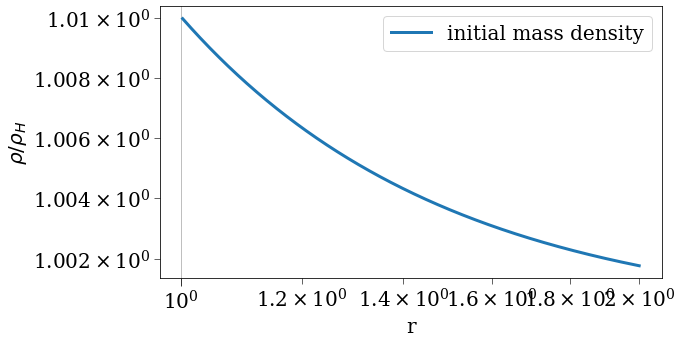

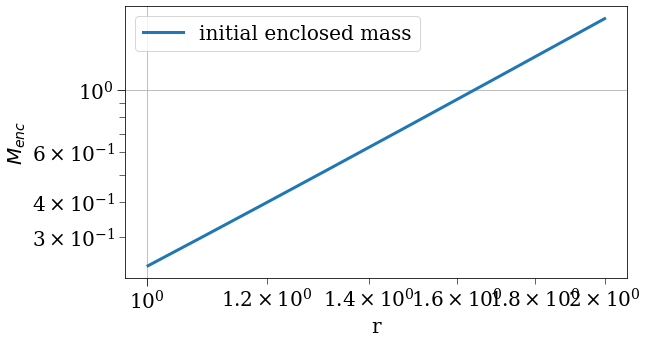

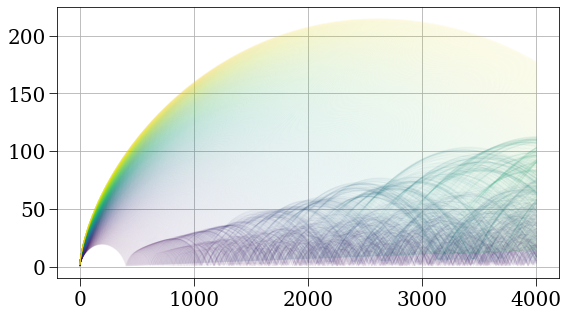

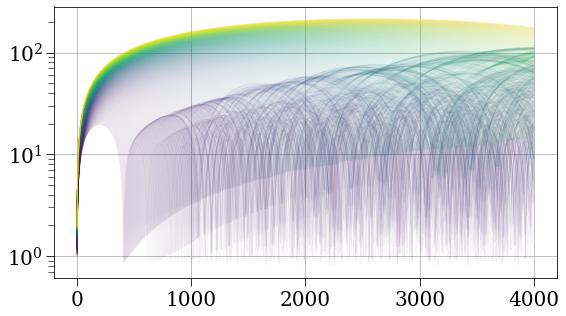

/home/jsipple/.conda/envs/jsipple/lib/python3.7/site-packages/IPython/core/pylabtools.py:128: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


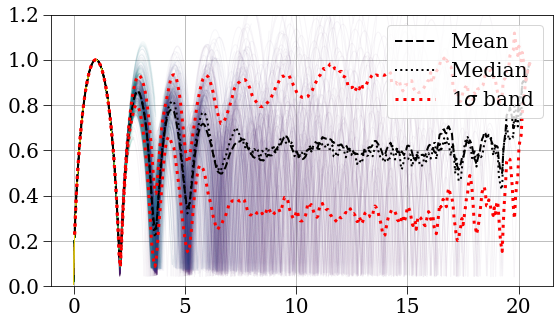

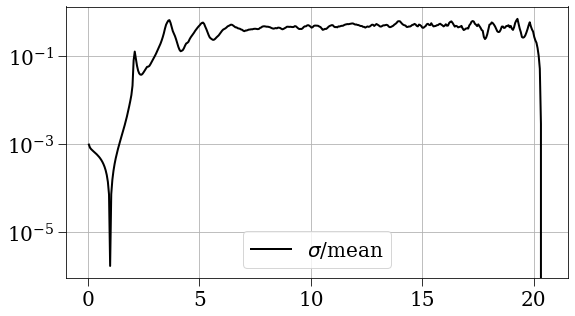

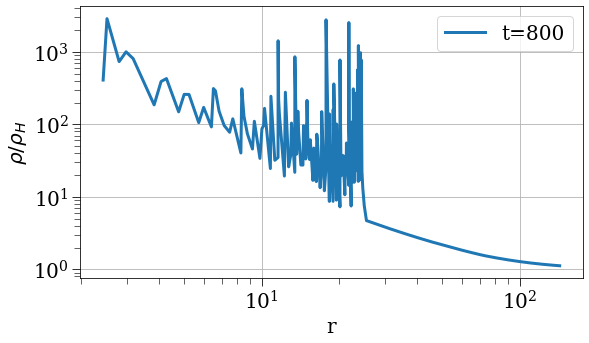

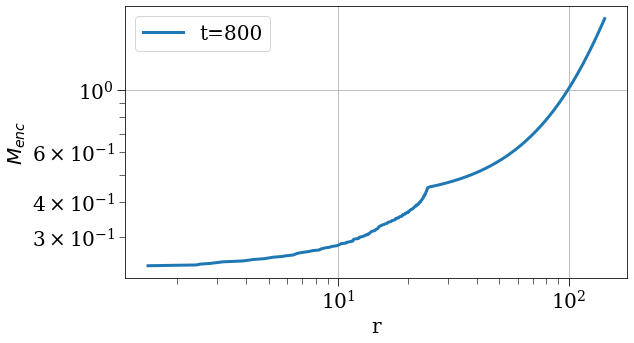

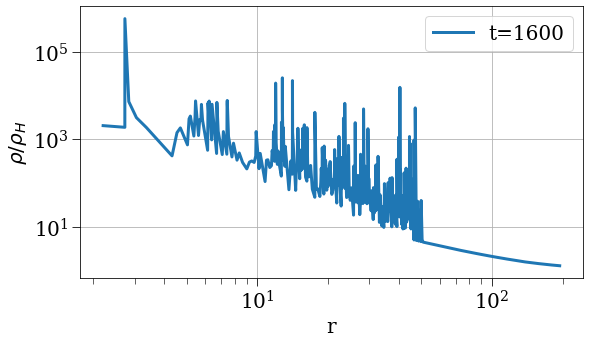

...

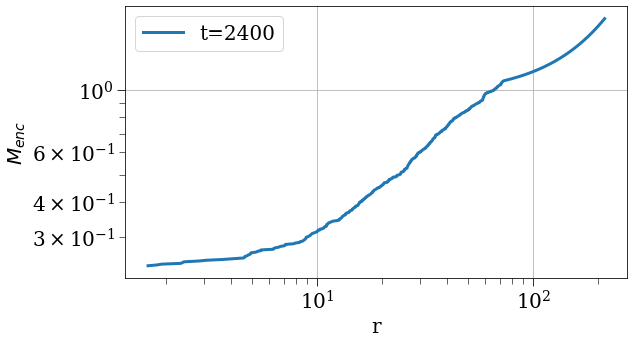

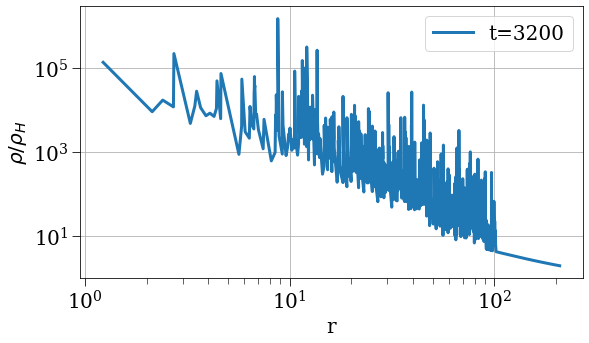

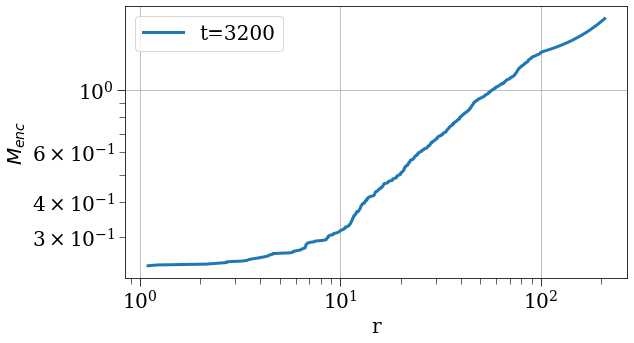

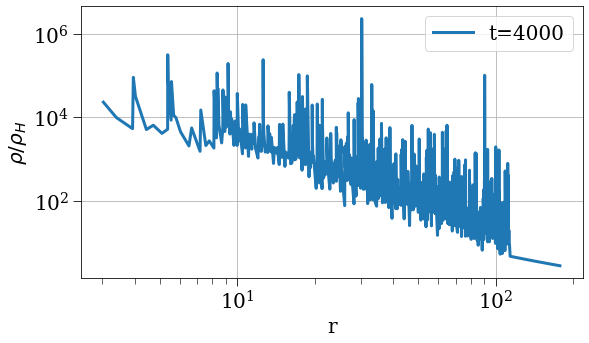

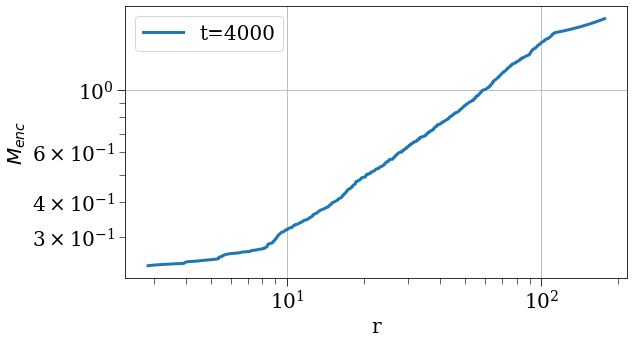

In [7]:
params, results =load_simulation_data('/home/jsipple/one_d_spherical_collapse/one-d-spherical-collapse-of-fuzzy-dark-matter/7-31-3.h5')
pprint(params)
plot_results(results, params=params, sc=None)

{'G': 1,
 'H': 0.6666666666666666,
 'N': 1000,
 'accel_strategy': 'grant_gmr_j_at_r_ta_soft',
 'ang_mom_strategy': 'zero',
 'delta': 0.01,
 'density_strategy': 'background_plus_power_law',
 'deque_size': 0,
 'drhodr_strategy': 'finite_diff',
 'dt': 1e-05,
 'dt_min': 0,
 'energy_strategy': 'kin_grav_rot_absorbed',
 'gamma': -2.5,
 'hbar2_over_m2': 0,
 'initial_mass_strategy': 'integrated_mass',
 'initial_radius_strategy': 'equal_mass',
 'initial_v_strategy': 'hubble',
 'j_coef': 0.3,
 'm_enc_strategy': 'inclusive',
 'm_pert': 1,
 'next_save_time': 0,
 'num_crossing': 0,
 'point_mass': 0,
 'point_mass_strategy': 'rmin_rho_r',
 'polytropic_coef': 0,
 'polytropic_index': -1,
 'pressure_strategy': 'zero',
 'problematic_shell_strategy': 'nothing',
 'r0_min': 1.0005,
 'r_max': 1.5,
 'r_min': 1,
 'r_min_strategy': 'nothing',
 'r_small': 1,
 'r_ta_strategy': 'r_ta_cycloid',
 'relaxation_time': 0,
 'rho_bar': 0.05305164769729845,
 'safety_factor': 0.01,
 'save_dt': 1,
 'save_filename': '7-31-4.h

/home/jsipple/.conda/envs/jsipple/lib/python3.7/site-packages/ipykernel_launcher.py:90: RuntimeWarning: divide by zero encountered in true_divide
/home/jsipple/.conda/envs/jsipple/lib/python3.7/site-packages/ipykernel_launcher.py:90: RuntimeWarning: divide by zero encountered in true_divide
/home/jsipple/.conda/envs/jsipple/lib/python3.7/site-packages/ipykernel_launcher.py:90: RuntimeWarning: divide by zero encountered in true_divide
/home/jsipple/.conda/envs/jsipple/lib/python3.7/site-packages/ipykernel_launcher.py:90: RuntimeWarning: divide by zero encountered in true_divide
/home/jsipple/.conda/envs/jsipple/lib/python3.7/site-packages/ipykernel_launcher.py:90: RuntimeWarning: divide by zero encountered in true_divide
/home/jsipple/.conda/envs/jsipple/lib/python3.7/site-packages/ipykernel_launcher.py:90: RuntimeWarning: divide by zero encountered in true_divide
/home/jsipple/.conda/envs/jsipple/lib/python3.7/site-packages/ipykernel_launcher.py:90: RuntimeWarning: divide by zero encou

/home/jsipple/.conda/envs/jsipple/lib/python3.7/site-packages/IPython/core/events.py:88: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  func(*args, **kwargs)


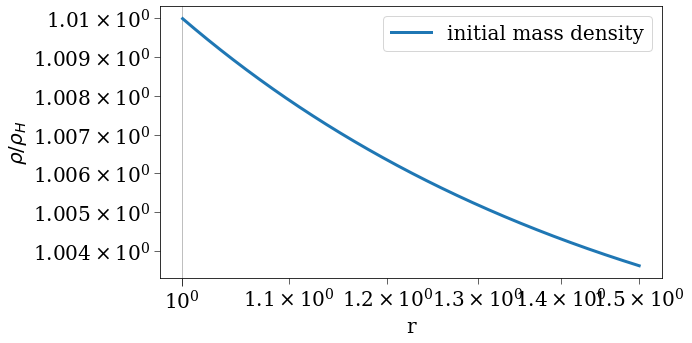

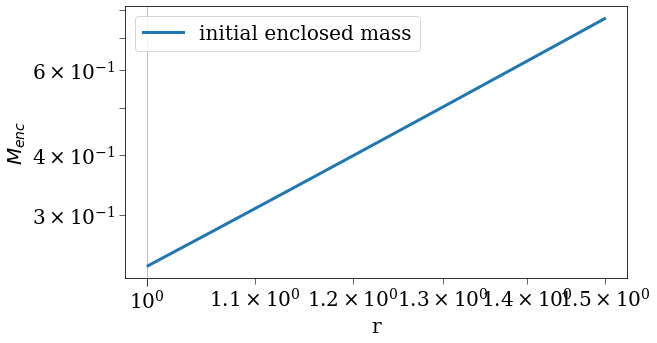

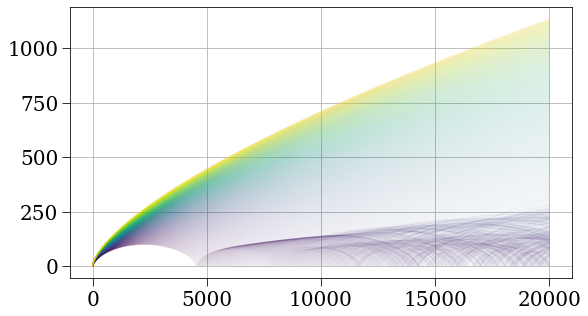

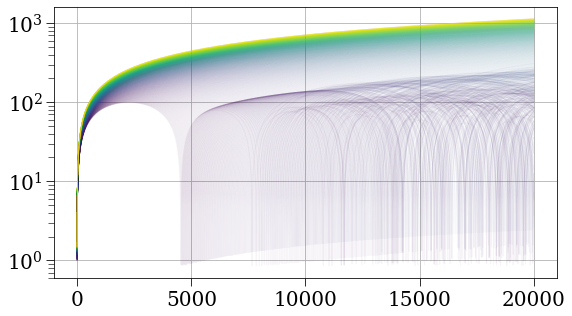

/home/jsipple/.conda/envs/jsipple/lib/python3.7/site-packages/IPython/core/pylabtools.py:128: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


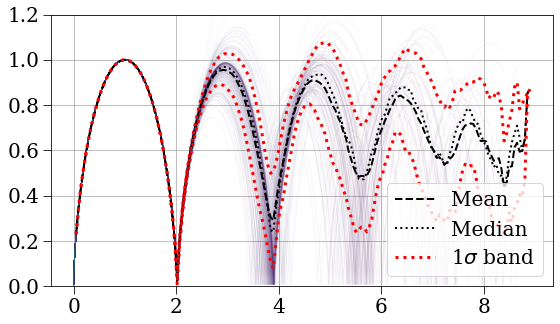

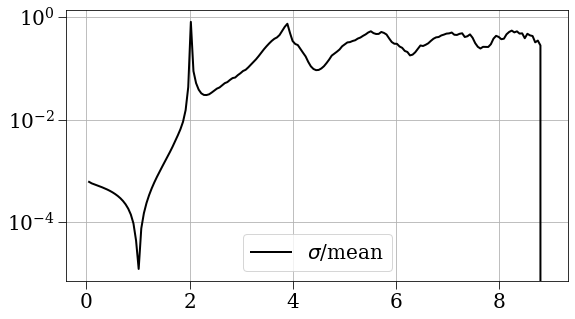

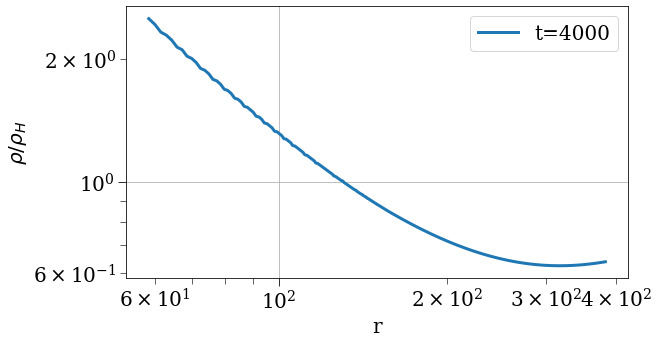

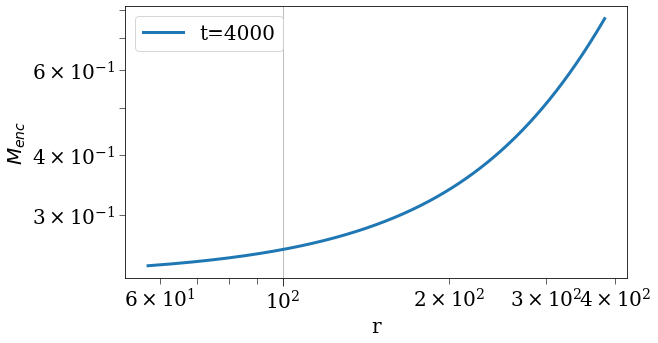

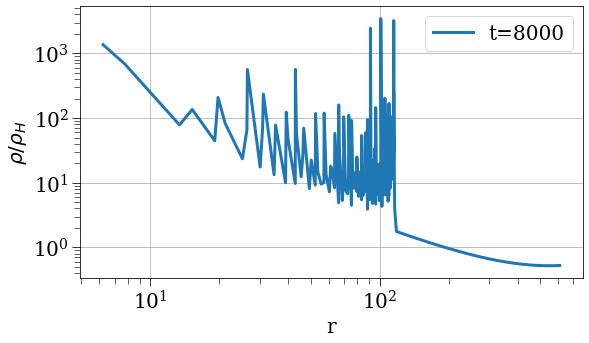

...

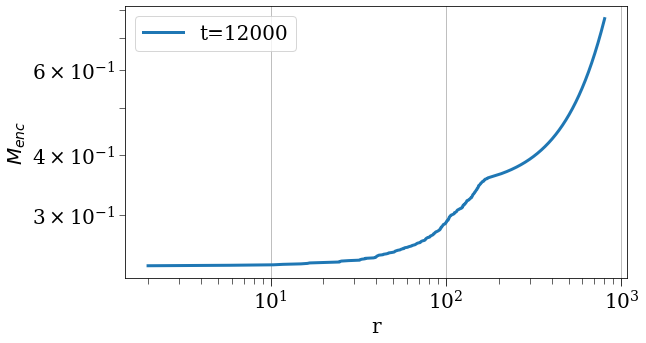

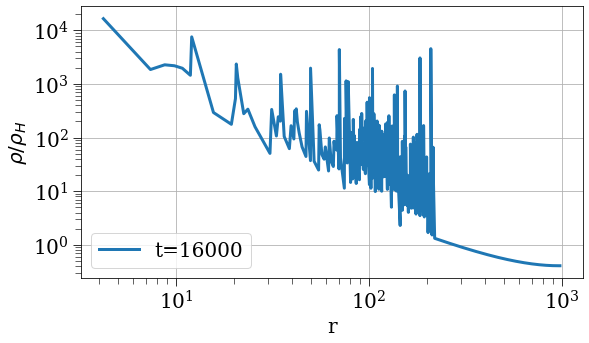

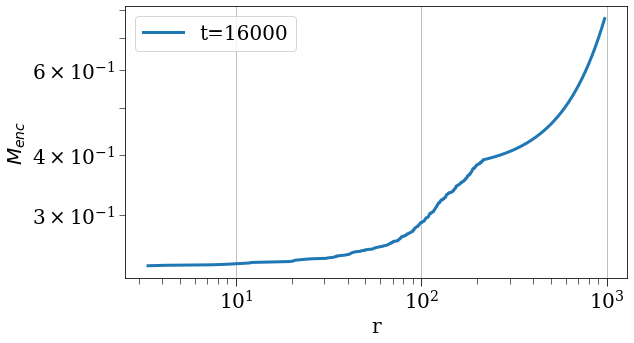

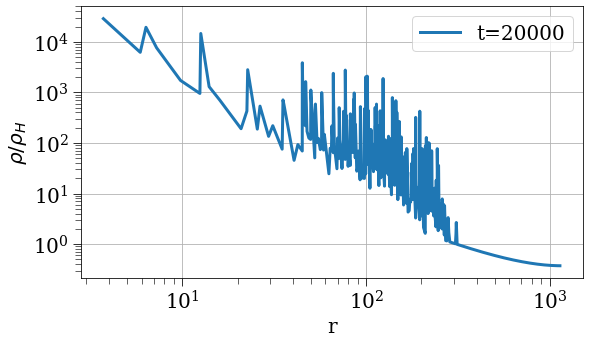

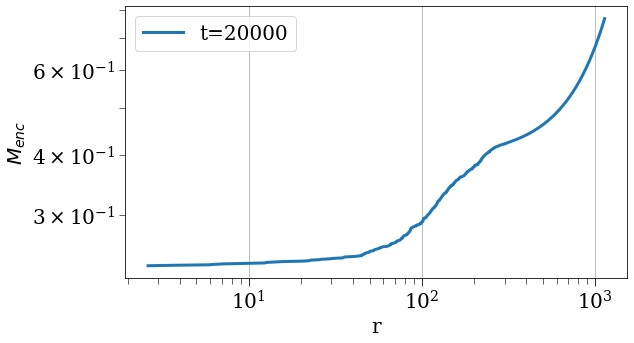

In [8]:
# j=3e-1 softening length = 0.1
params, results =load_simulation_data('/home/jsipple/one_d_spherical_collapse/one-d-spherical-collapse-of-fuzzy-dark-matter/7-31-4.h5')
pprint(params)
plot_results(results, params=params, sc=None)

{'G': 1,
 'H': 0.6666666666666666,
 'N': 1000,
 'accel_strategy': 'grant_gmr_j_at_r_ta_soft',
 'ang_mom_strategy': 'zero',
 'delta': 0.01,
 'density_strategy': 'background_plus_power_law',
 'deque_size': 0,
 'drhodr_strategy': 'finite_diff',
 'dt': 1e-05,
 'dt_min': 0,
 'energy_strategy': 'kin_grav_rot_absorbed',
 'gamma': -2.5,
 'hbar2_over_m2': 0,
 'initial_mass_strategy': 'integrated_mass',
 'initial_radius_strategy': 'equal_mass',
 'initial_v_strategy': 'hubble',
 'j_coef': 0.7,
 'm_enc_strategy': 'inclusive',
 'm_pert': 1,
 'next_save_time': 0,
 'num_crossing': 0,
 'point_mass': 0,
 'point_mass_strategy': 'rmin_rho_r',
 'polytropic_coef': 0,
 'polytropic_index': -1,
 'pressure_strategy': 'zero',
 'problematic_shell_strategy': 'nothing',
 'r0_min': 1.001,
 'r_max': 2,
 'r_min': 1,
 'r_min_strategy': 'nothing',
 'r_small': 1,
 'r_ta_strategy': 'r_ta_cycloid',
 'relaxation_time': 0,
 'rho_bar': 0.05305164769729845,
 'safety_factor': 0.01,
 'save_dt': 1,
 'save_filename': '7-31-5.h5',

/home/jsipple/.conda/envs/jsipple/lib/python3.7/site-packages/IPython/core/events.py:88: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  func(*args, **kwargs)


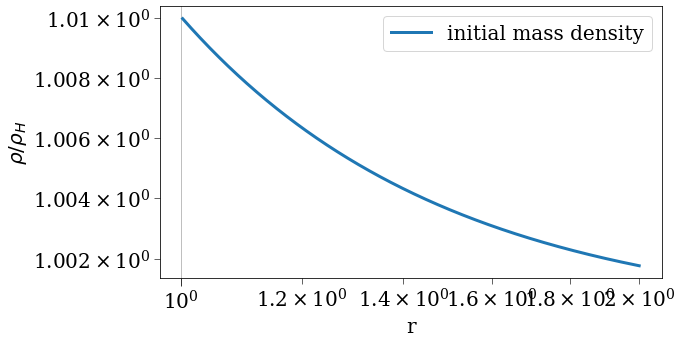

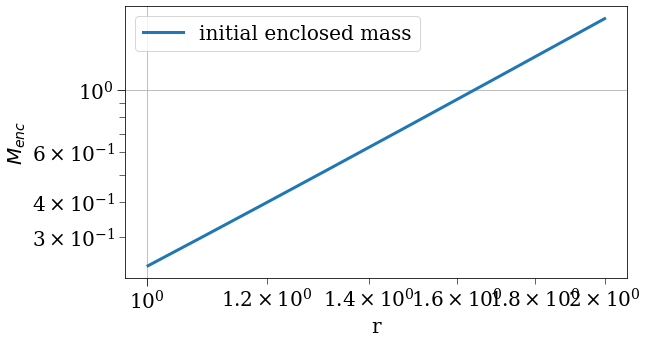

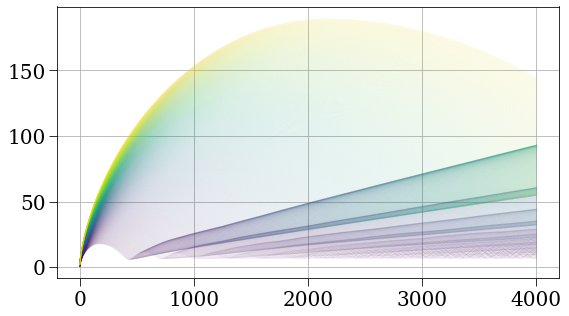

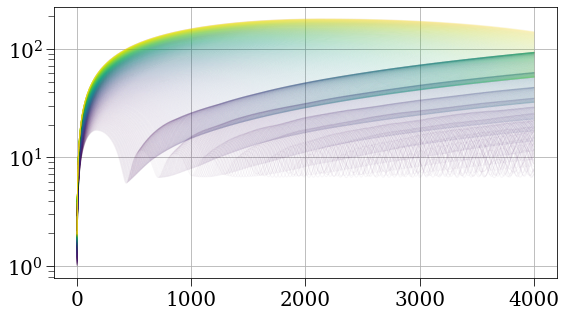

/home/jsipple/.conda/envs/jsipple/lib/python3.7/site-packages/IPython/core/pylabtools.py:128: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


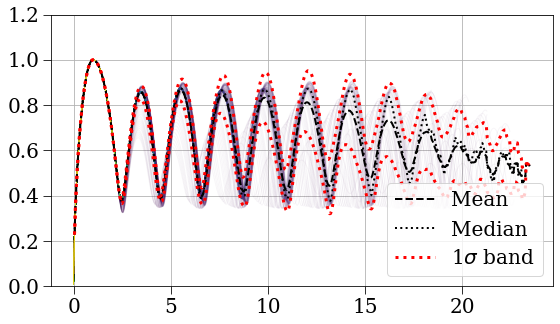

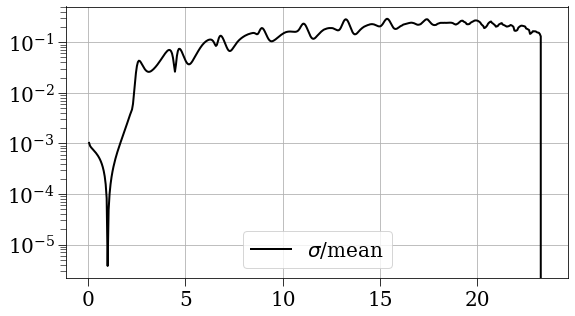

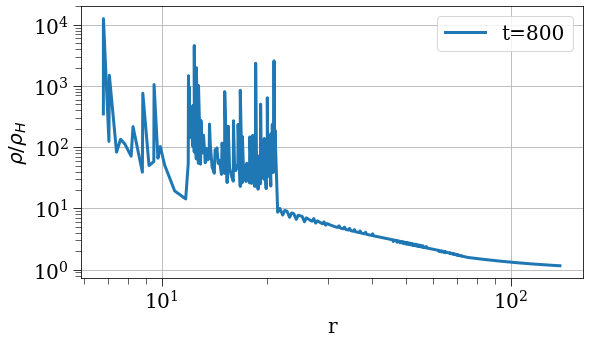

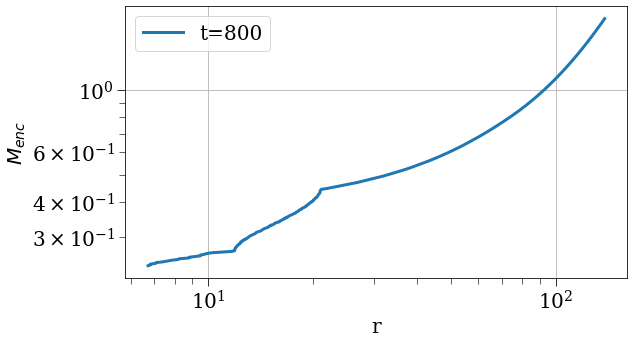

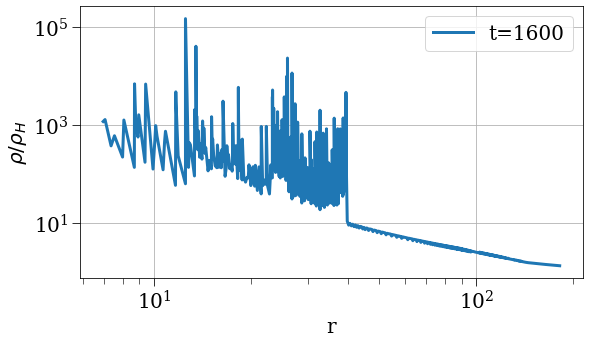

...

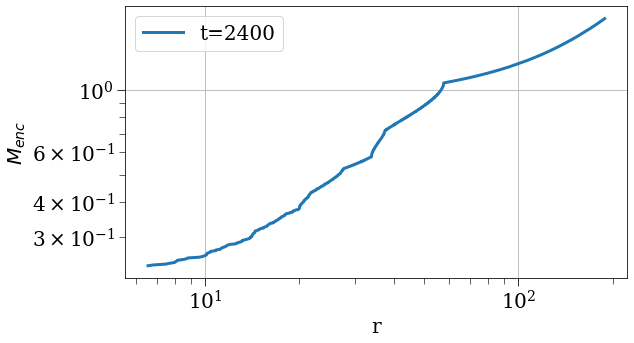

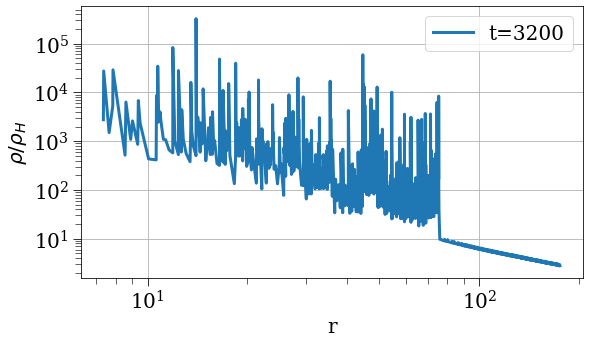

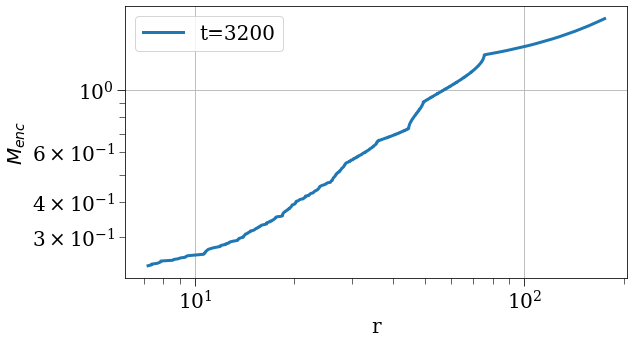

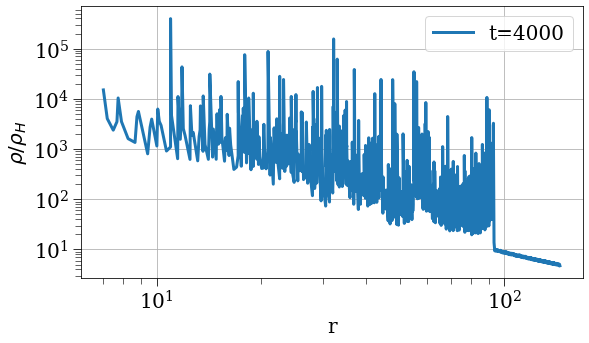

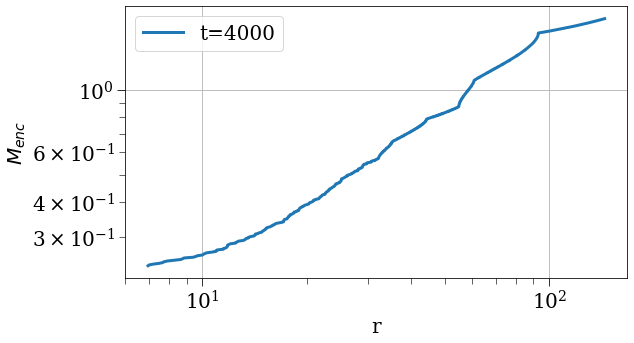

In [9]:
# j=7e-1
params, results =load_simulation_data('/home/jsipple/one_d_spherical_collapse/one-d-spherical-collapse-of-fuzzy-dark-matter/7-31-5.h5')
pprint(params)
plot_results(results, params=params, sc=None)

{'G': 1,
 'H': 0.6666666666666666,
 'N': 1000,
 'accel_strategy': 'grant_gmr_j_at_r_ta_soft',
 'ang_mom_strategy': 'zero',
 'delta': 0.01,
 'density_strategy': 'background_plus_power_law',
 'deque_size': 0,
 'drhodr_strategy': 'finite_diff',
 'dt': 1e-05,
 'dt_min': 0,
 'energy_strategy': 'kin_grav_rot_absorbed',
 'gamma': -1,
 'hbar2_over_m2': 0,
 'initial_mass_strategy': 'integrated_mass',
 'initial_radius_strategy': 'equal_mass',
 'initial_v_strategy': 'hubble',
 'j_coef': 0.7,
 'm_enc_strategy': 'inclusive',
 'm_pert': 1,
 'next_save_time': 0,
 'num_crossing': 0,
 'point_mass': 0,
 'point_mass_strategy': 'rmin_rho_r',
 'polytropic_coef': 0,
 'polytropic_index': -1,
 'pressure_strategy': 'zero',
 'problematic_shell_strategy': 'nothing',
 'r0_min': 1.005,
 'r_max': 6,
 'r_min': 1,
 'r_min_strategy': 'nothing',
 'r_small': 1,
 'r_ta_strategy': 'r_ta_cycloid',
 'relaxation_time': 0,
 'rho_bar': 0.05305164769729845,
 'safety_factor': 0.01,
 'save_dt': 1,
 'save_filename': '7-31-6.h5',
 

/home/jsipple/.conda/envs/jsipple/lib/python3.7/site-packages/IPython/core/events.py:88: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  func(*args, **kwargs)


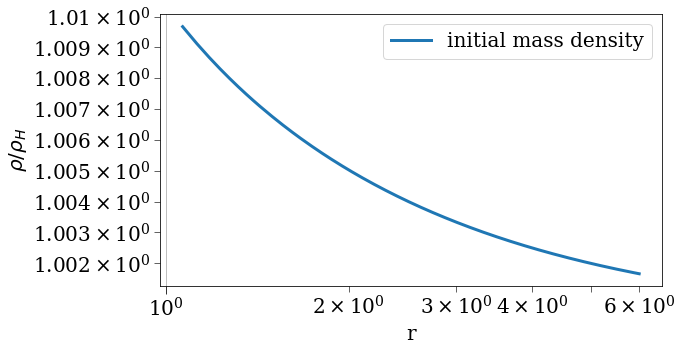

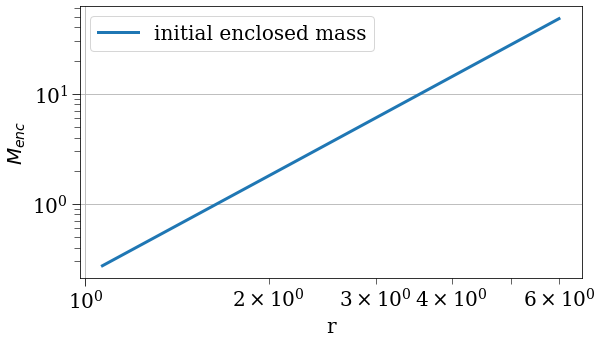

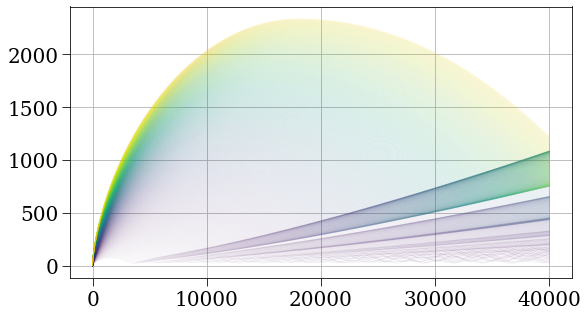

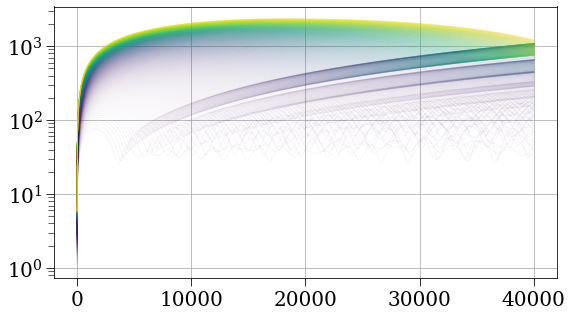

/home/jsipple/.conda/envs/jsipple/lib/python3.7/site-packages/IPython/core/pylabtools.py:128: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


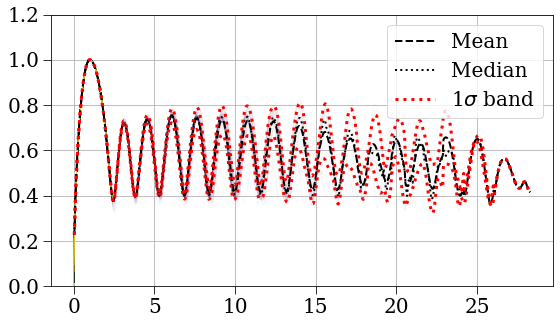

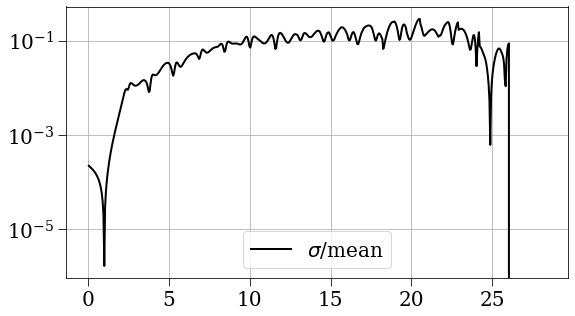

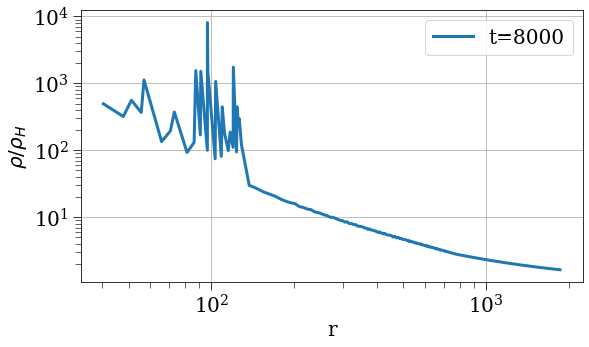

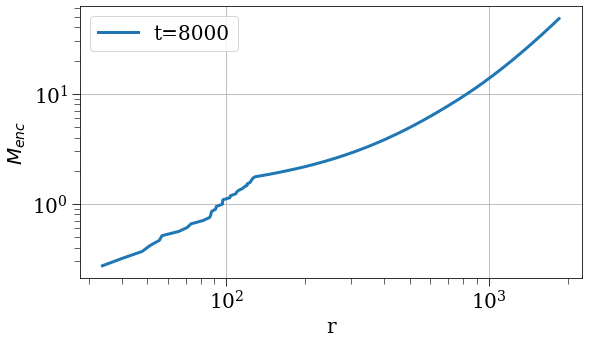

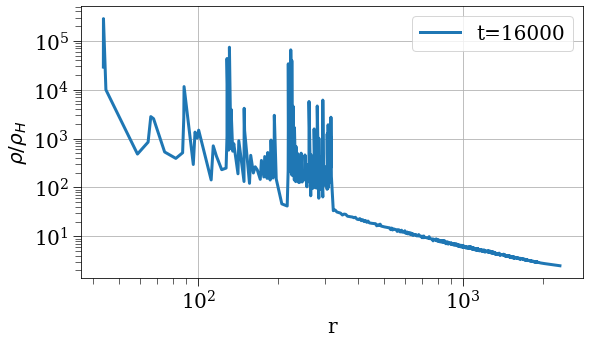

...

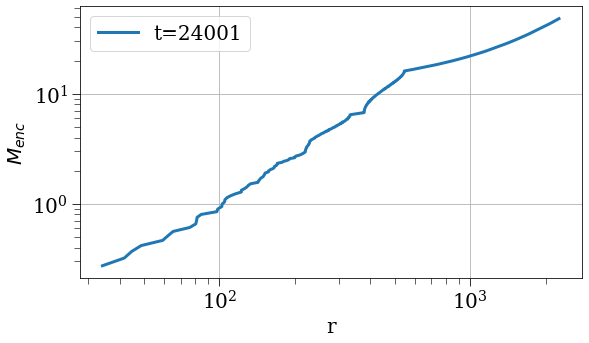

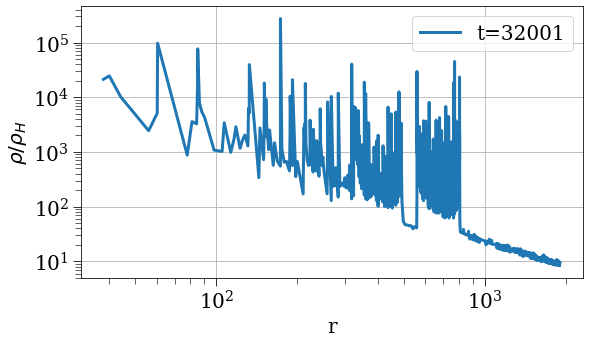

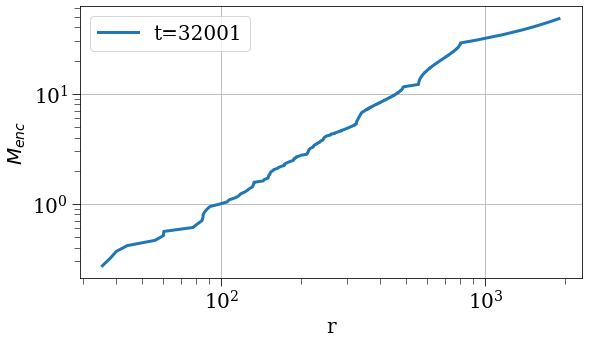

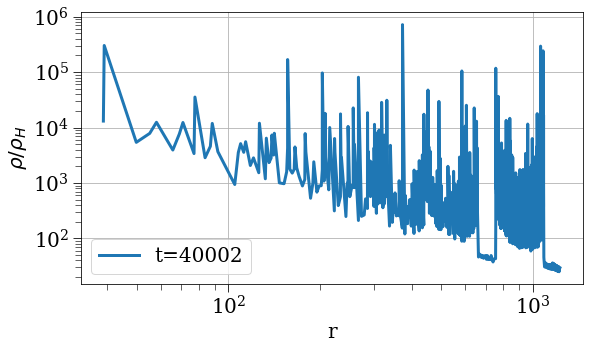

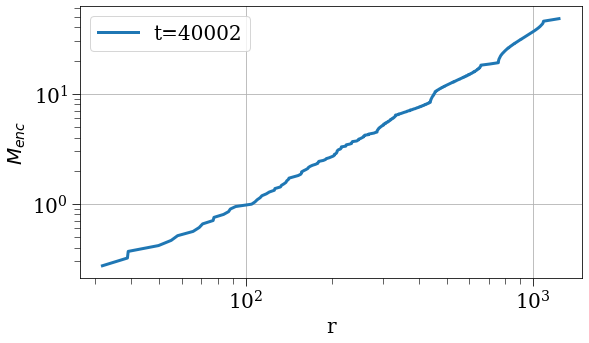

In [10]:
# gamma=-1
params, results =load_simulation_data('/home/jsipple/one_d_spherical_collapse/one-d-spherical-collapse-of-fuzzy-dark-matter/7-31-6.h5')
pprint(params)
plot_results(results, params=params, sc=None)

{'G': 1,
 'H': 0.6666666666666666,
 'N': 1000,
 'accel_strategy': 'grant_gmr_j_at_r_ta_soft',
 'ang_mom_strategy': 'zero',
 'delta': 0.01,
 'density_strategy': 'background_plus_power_law',
 'deque_size': 0,
 'drhodr_strategy': 'finite_diff',
 'dt': 1e-05,
 'dt_min': 0,
 'energy_strategy': 'kin_grav_rot_absorbed',
 'gamma': -1,
 'hbar2_over_m2': 0,
 'initial_mass_strategy': 'integrated_mass',
 'initial_radius_strategy': 'equal_mass',
 'initial_v_strategy': 'hubble',
 'j_coef': 0.5,
 'm_enc_strategy': 'inclusive',
 'm_pert': 1,
 'next_save_time': 0,
 'num_crossing': 0,
 'point_mass': 0,
 'point_mass_strategy': 'rmin_rho_r',
 'polytropic_coef': 0,
 'polytropic_index': -1,
 'pressure_strategy': 'zero',
 'problematic_shell_strategy': 'nothing',
 'r0_min': 1.005,
 'r_max': 6,
 'r_min': 1,
 'r_min_strategy': 'nothing',
 'r_small': 1,
 'r_ta_strategy': 'r_ta_cycloid',
 'relaxation_time': 0,
 'rho_bar': 0.05305164769729845,
 'safety_factor': 0.01,
 'save_dt': 1,
 'save_filename': '7-31-7.h5',
 

/home/jsipple/.conda/envs/jsipple/lib/python3.7/site-packages/IPython/core/events.py:88: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  func(*args, **kwargs)


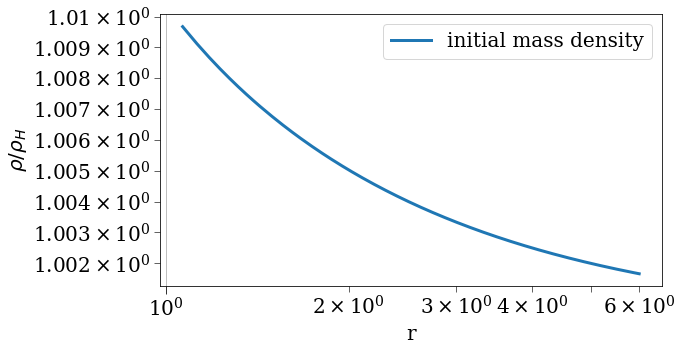

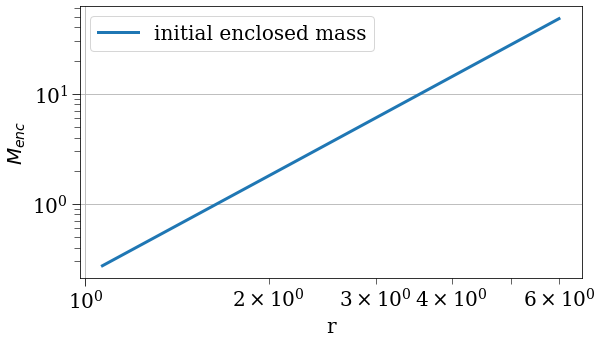

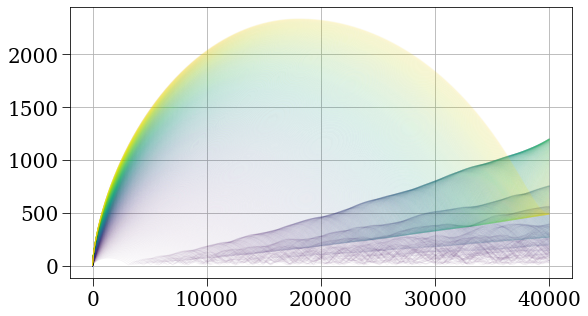

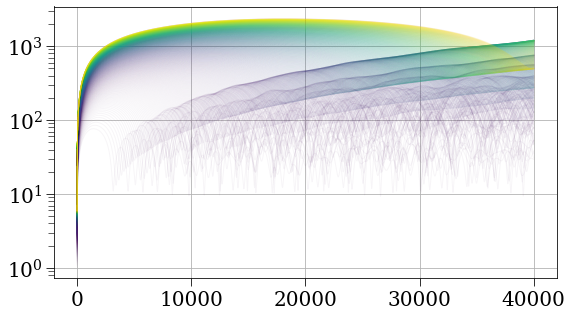

/home/jsipple/.conda/envs/jsipple/lib/python3.7/site-packages/IPython/core/pylabtools.py:128: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


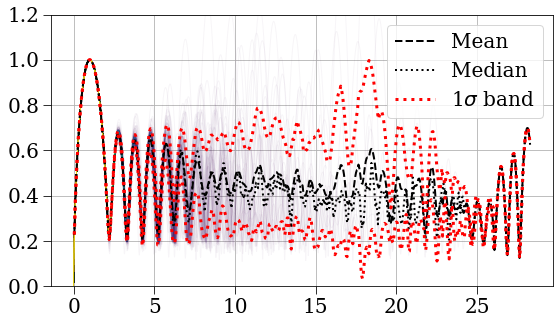

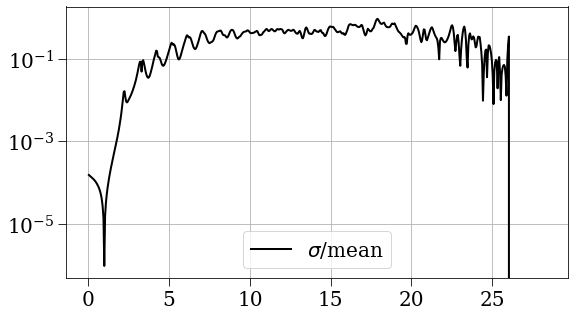

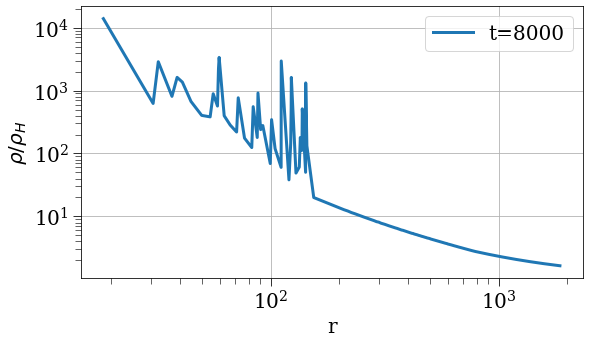

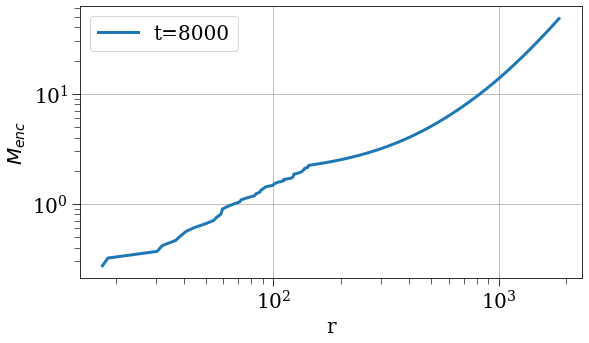

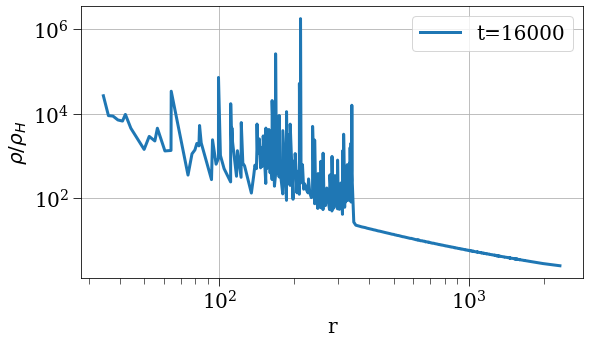

...

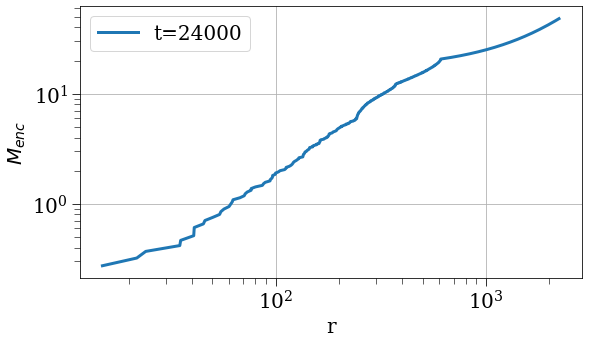

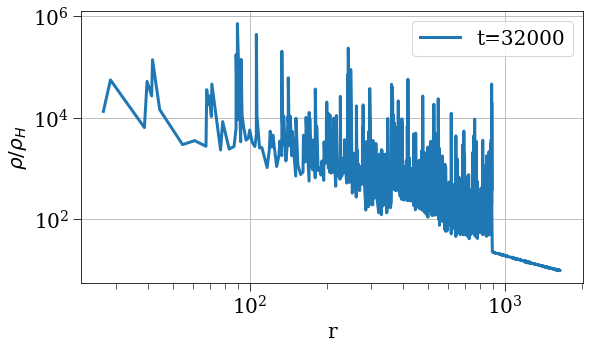

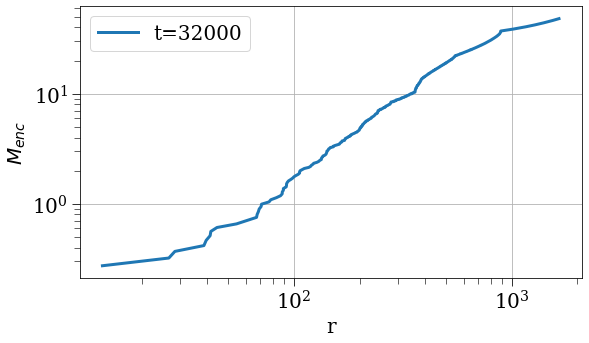

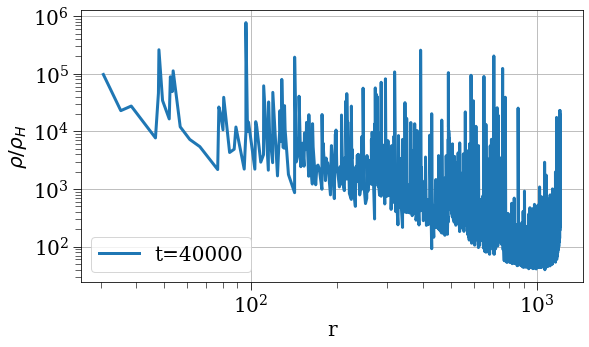

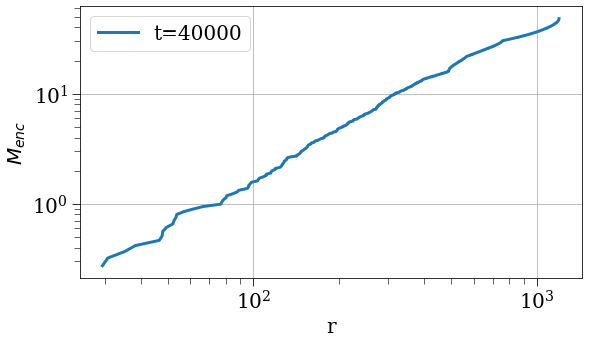

In [11]:
# gamma=-1, ran for longer
params, results =load_simulation_data('/home/jsipple/one_d_spherical_collapse/one-d-spherical-collapse-of-fuzzy-dark-matter/7-31-7.h5')
pprint(params)
plot_results(results, params=params, sc=None)

In [ ]:
params, results =load_simulation_data('/home/jsipple/one_d_spherical_collapse/one-d-spherical-collapse-of-fuzzy-dark-matter/7-31-8.h5')
pprint(params)
plot_results(results, params=params, sc=None)

{'G': 1,
 'H': 0.6666666666666666,
 'N': 10000,
 'accel_strategy': 'grant_gmr_j_at_r_ta_soft',
 'ang_mom_strategy': 'zero',
 'delta': 0.01,
 'density_strategy': 'background_plus_power_law',
 'deque_size': 0,
 'drhodr_strategy': 'finite_diff',
 'dt': 1e-05,
 'dt_min': 0,
 'energy_strategy': 'kin_grav_rot_absorbed',
 'gamma': -1,
 'hbar2_over_m2': 0,
 'initial_mass_strategy': 'integrated_mass',
 'initial_radius_strategy': 'equal_mass',
 'initial_v_strategy': 'hubble',
 'j_coef': 0.7,
 'm_enc_strategy': 'inclusive',
 'm_pert': 1,
 'next_save_time': 0,
 'num_crossing': 0,
 'point_mass': 0,
 'point_mass_strategy': 'rmin_rho_r',
 'polytropic_coef': 0,
 'polytropic_index': -1,
 'pressure_strategy': 'zero',
 'problematic_shell_strategy': 'nothing',
 'r0_min': 5e-05,
 'r_max': 0.5,
 'r_min': 0,
 'r_min_strategy': 'nothing',
 'r_small': 1,
 'r_ta_strategy': 'r_ta_cycloid',
 'relaxation_time': 0,
 'rho_bar': 0.05305164769729845,
 'safety_factor': 0.01,
 'save_dt': 0.01,
 'save_filename': '7-31-8.

{'G': 1,
 'H': 0.6666666666666666,
 'N': 1000,
 'accel_strategy': 'grant_gmr_j_at_r_ta_soft',
 'ang_mom_strategy': 'zero',
 'delta': 0.01,
 'density_strategy': 'background_plus_power_law',
 'deque_size': 0,
 'drhodr_strategy': 'finite_diff',
 'dt': 1e-05,
 'dt_min': 0,
 'energy_strategy': 'kin_grav_rot_absorbed',
 'gamma': -2.5,
 'hbar2_over_m2': 0,
 'initial_mass_strategy': 'integrated_mass',
 'initial_radius_strategy': 'equal_mass',
 'initial_v_strategy': 'hubble',
 'j_coef': 0.7,
 'm_enc_strategy': 'neighbor',
 'm_pert': 1,
 'next_save_time': 0,
 'num_crossing': 0,
 'point_mass': 0,
 'point_mass_strategy': 'rmin_rho_r',
 'polytropic_coef': 0,
 'polytropic_index': -1,
 'pressure_strategy': 'zero',
 'problematic_shell_strategy': 'nothing',
 'r0_min': 1.001,
 'r_max': 2,
 'r_min': 1,
 'r_min_strategy': 'nothing',
 'r_small': 1,
 'r_ta_strategy': 'r_ta_cycloid',
 'relaxation_time': 0,
 'rho_bar': 0.05305164769729845,
 'safety_factor': 0.01,
 'save_dt': 0.01,
 'save_filename': '7-31-9.h5

/home/jsipple/.conda/envs/jsipple/lib/python3.7/site-packages/IPython/core/events.py:88: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  func(*args, **kwargs)


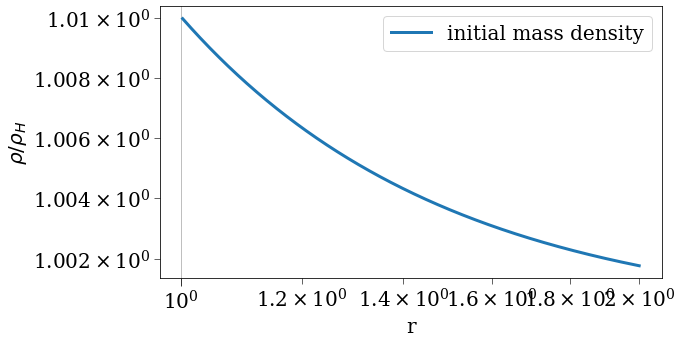

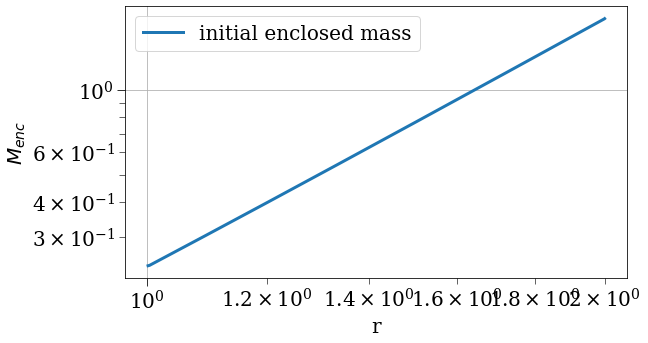

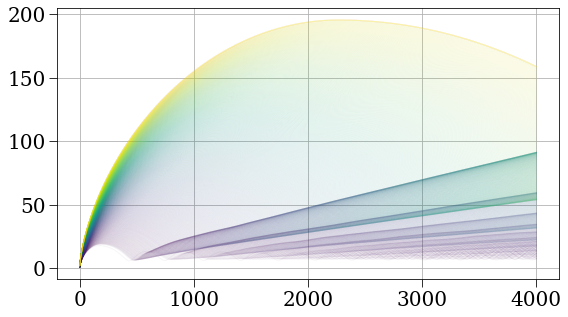

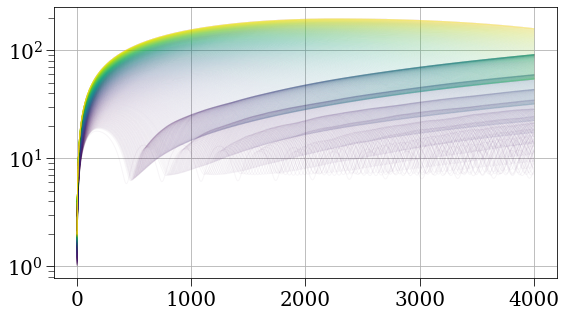

/home/jsipple/.conda/envs/jsipple/lib/python3.7/site-packages/IPython/core/pylabtools.py:128: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


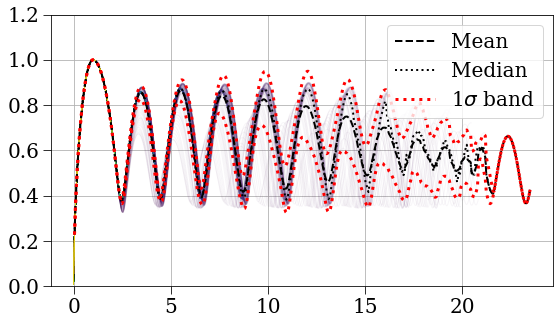

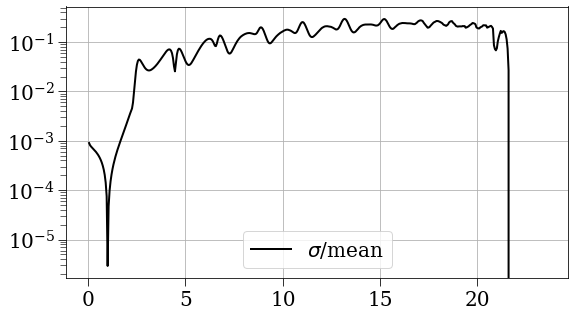

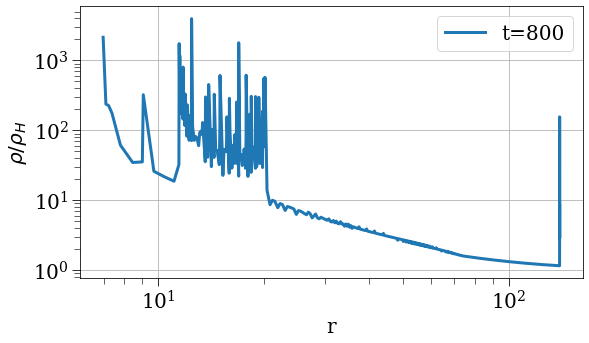

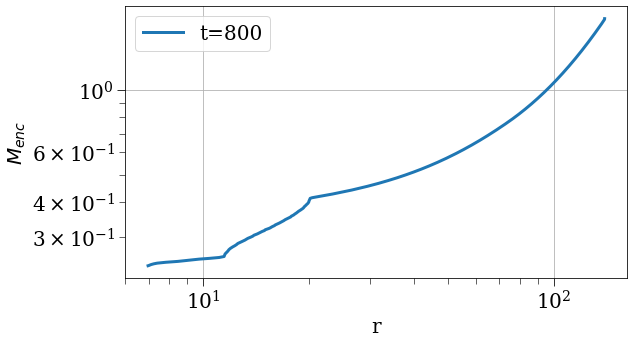

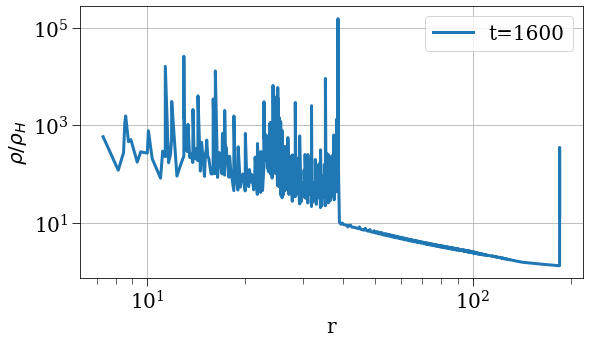

...

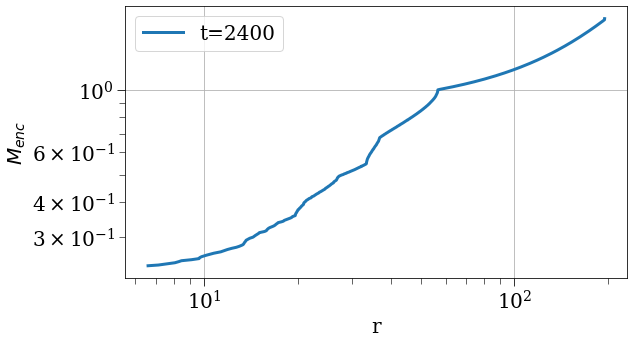

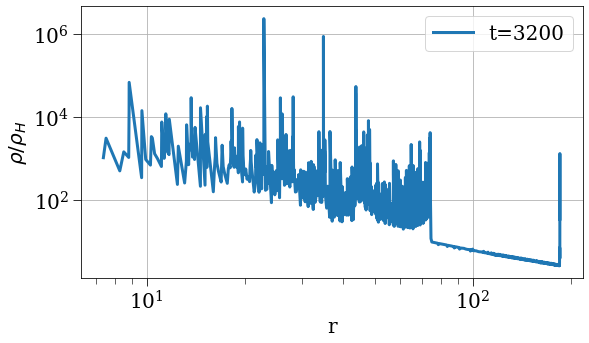

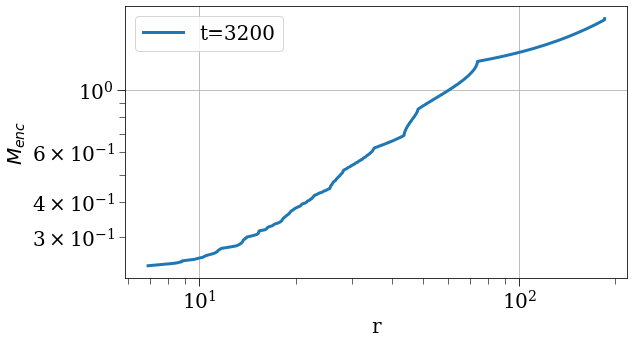

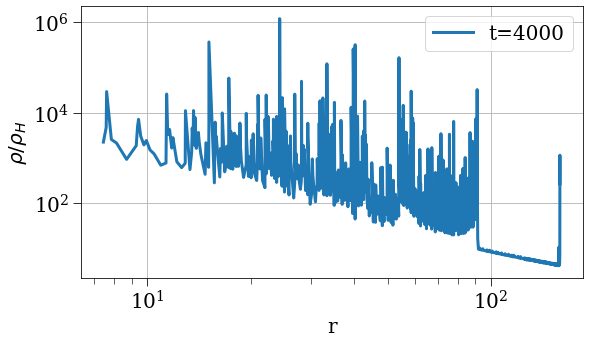

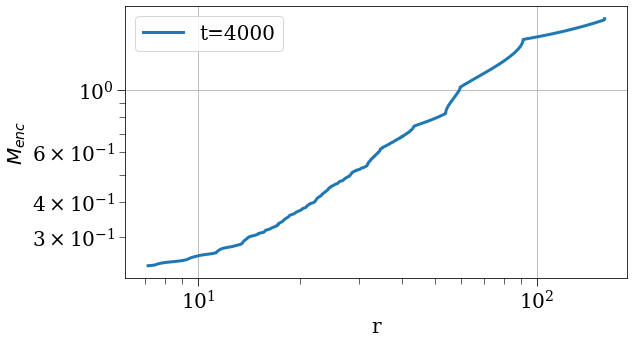

In [5]:
# neighbor 
params, results =load_simulation_data('/home/jsipple/one_d_spherical_collapse/one-d-spherical-collapse-of-fuzzy-dark-matter/7-31-9.h5')
pprint(params)
plot_results(results, params=params, sc=None)

{'G': 1,
 'H': 0.6666666666666666,
 'N': 1000,
 'accel_strategy': 'soft_new',
 'ang_mom_strategy': 'const',
 'delta': 0.01,
 'density_strategy': 'background_plus_power_law',
 'deque_size': 0,
 'drhodr_strategy': 'finite_diff',
 'dt': 1e-05,
 'dt_min': 0,
 'energy_strategy': 'kin_grav_rot_absorbed',
 'gamma': -2.5,
 'hbar2_over_m2': 0,
 'initial_mass_strategy': 'integrated_mass',
 'initial_radius_strategy': 'equal_mass',
 'initial_v_strategy': 'hubble',
 'j_coef': 0.01,
 'm_enc_strategy': 'neighbor',
 'm_pert': 1,
 'next_save_time': 0,
 'num_crossing': 0,
 'point_mass': 0,
 'point_mass_strategy': 'rmin_rho_r',
 'polytropic_coef': 0,
 'polytropic_index': -1,
 'pressure_strategy': 'zero',
 'problematic_shell_strategy': 'nothing',
 'r0_min': 1.001,
 'r_max': 2,
 'r_min': 1,
 'r_min_strategy': 'nothing',
 'r_small': 1,
 'r_ta_strategy': 'r_ta_cycloid',
 'relaxation_time': 0,
 'rho_bar': 0.05305164769729845,
 'safety_factor': 0.01,
 'save_dt': 1,
 'save_filename': '7-31-10.h5',
 'save_strate

/home/jsipple/.conda/envs/jsipple/lib/python3.7/site-packages/IPython/core/events.py:88: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  func(*args, **kwargs)


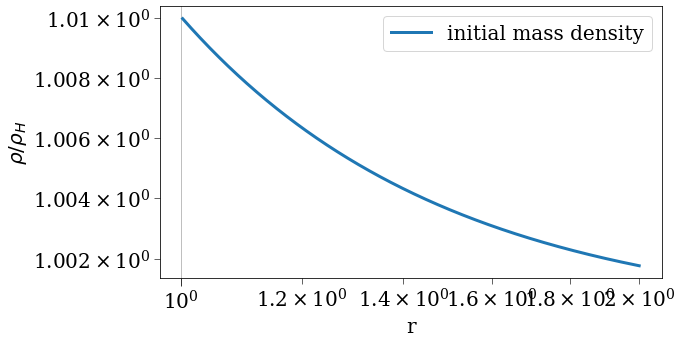

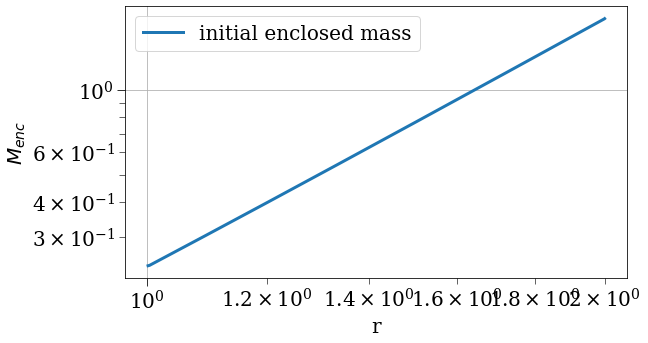

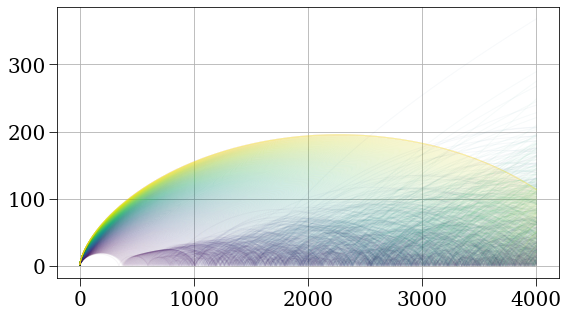

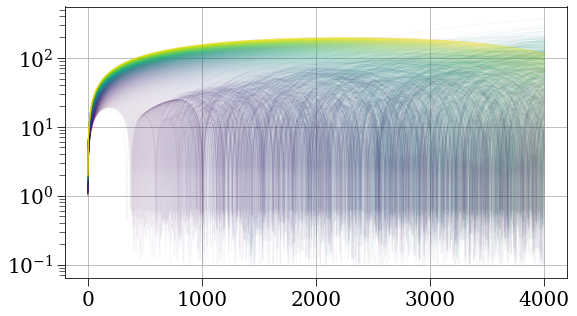

/home/jsipple/.conda/envs/jsipple/lib/python3.7/site-packages/IPython/core/pylabtools.py:128: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


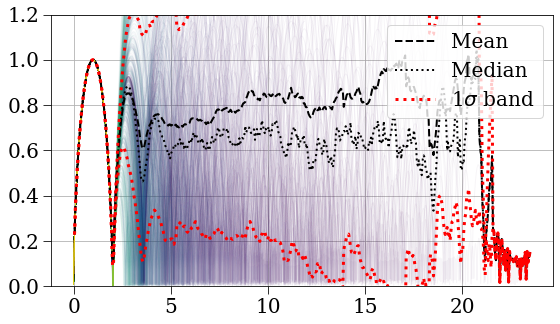

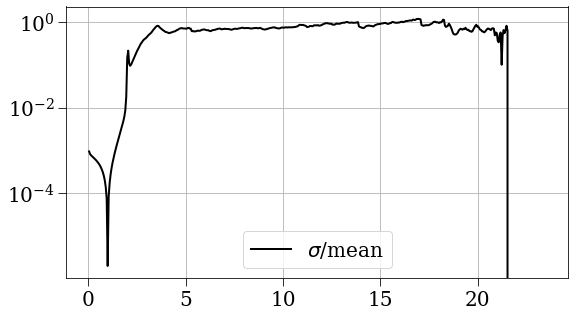

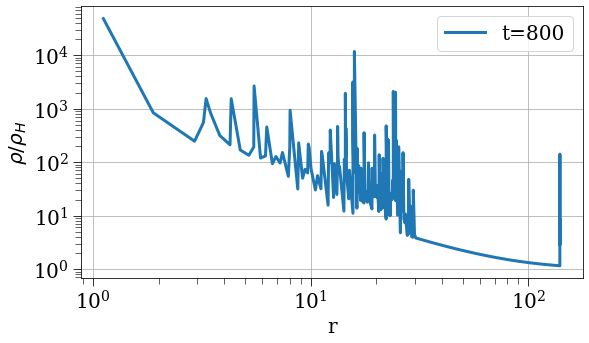

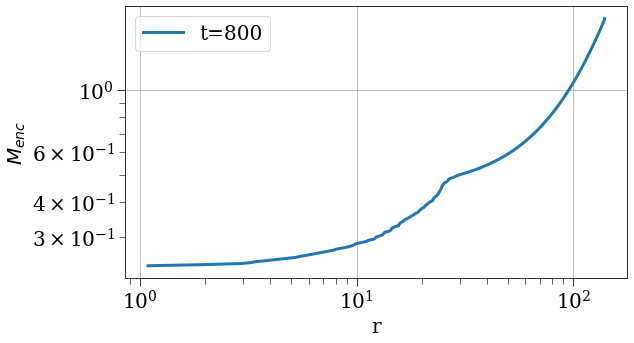

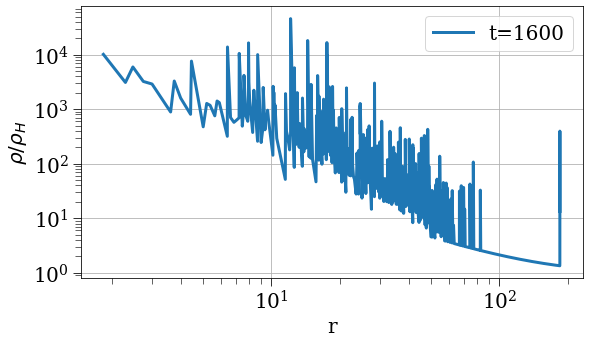

...

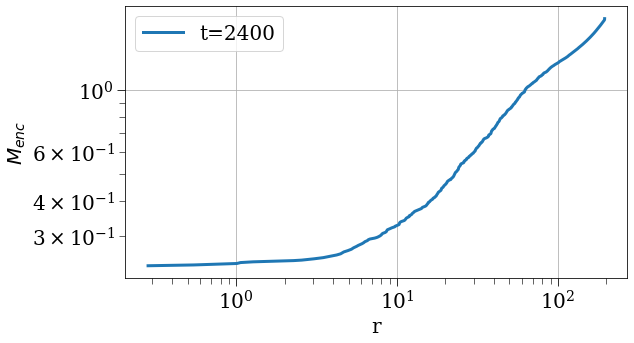

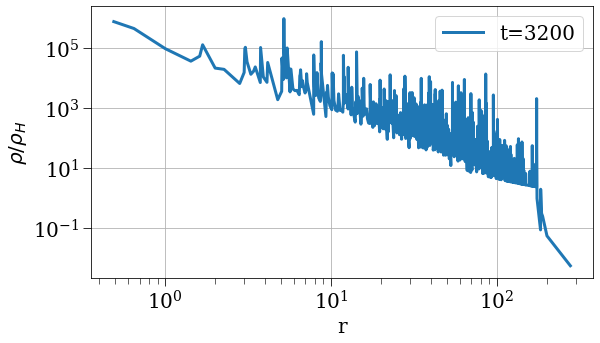

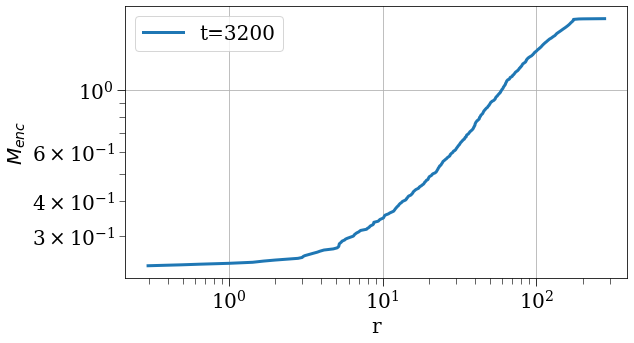

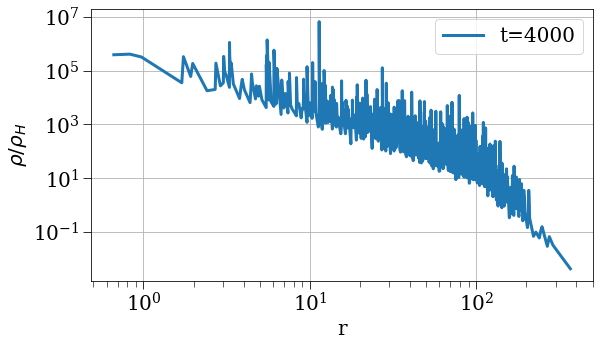

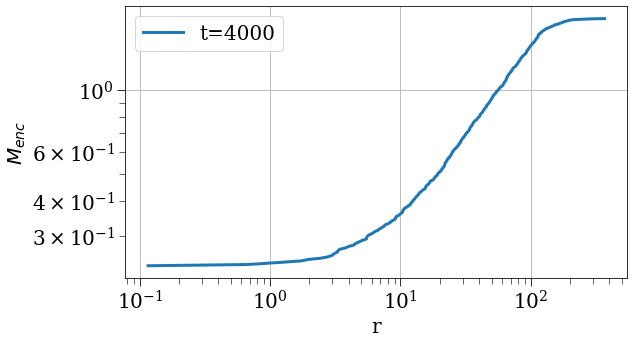

In [6]:
# neighbor 1e-2
params, results =load_simulation_data('/home/jsipple/one_d_spherical_collapse/one-d-spherical-collapse-of-fuzzy-dark-matter/7-31-10.h5')
pprint(params)
plot_results(results, params=params, sc=None)

{'G': 1,
 'H': 0.6666666666666666,
 'N': 1000,
 'accel_strategy': 'soft_new',
 'ang_mom_strategy': 'const',
 'delta': 0.01,
 'density_strategy': 'background_plus_power_law',
 'deque_size': 0,
 'drhodr_strategy': 'finite_diff',
 'dt': 1e-05,
 'dt_min': 0,
 'energy_strategy': 'kin_grav_rot_absorbed',
 'gamma': -2.5,
 'hbar2_over_m2': 0,
 'initial_mass_strategy': 'integrated_mass',
 'initial_radius_strategy': 'equal_mass',
 'initial_v_strategy': 'hubble',
 'j_coef': 0.01,
 'm_enc_strategy': 'inclusive',
 'm_pert': 1,
 'next_save_time': 0,
 'num_crossing': 0,
 'point_mass': 0,
 'point_mass_strategy': 'rmin_rho_r',
 'polytropic_coef': 0,
 'polytropic_index': -1,
 'pressure_strategy': 'zero',
 'problematic_shell_strategy': 'nothing',
 'r0_min': 1.001,
 'r_max': 2,
 'r_min': 1,
 'r_min_strategy': 'nothing',
 'r_small': 1,
 'r_ta_strategy': 'r_ta_cycloid',
 'relaxation_time': 0,
 'rho_bar': 0.05305164769729845,
 'safety_factor': 0.01,
 'save_dt': 1,
 'save_filename': '7-31-11.h5',
 'save_strat

/home/jsipple/.conda/envs/jsipple/lib/python3.7/site-packages/IPython/core/events.py:88: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  func(*args, **kwargs)


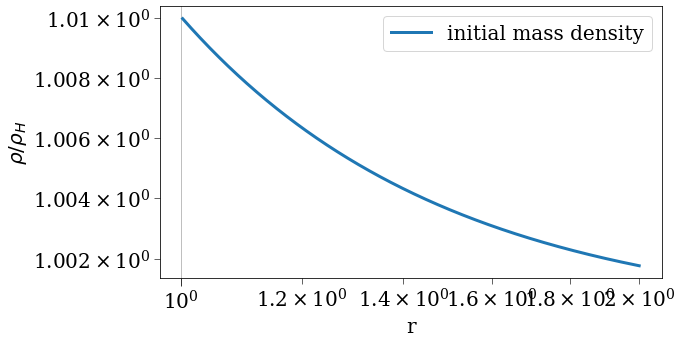

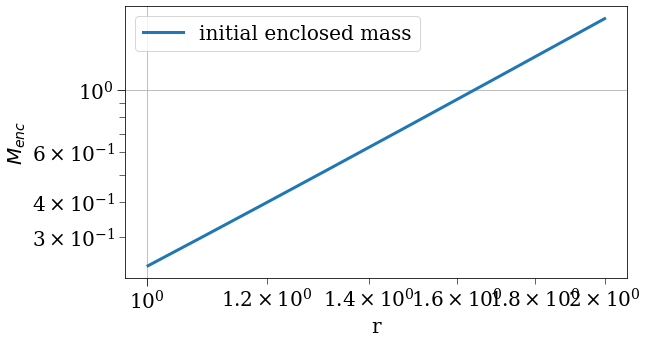

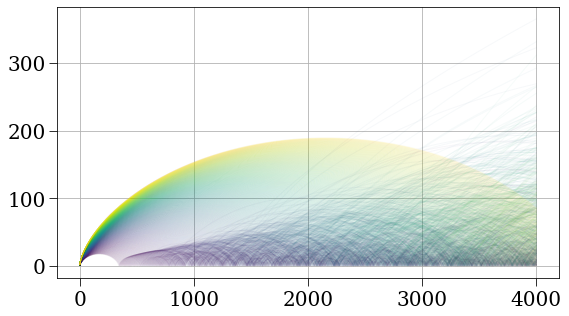

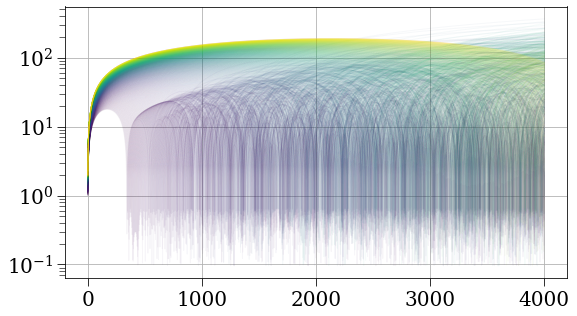

/home/jsipple/.conda/envs/jsipple/lib/python3.7/site-packages/IPython/core/pylabtools.py:128: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


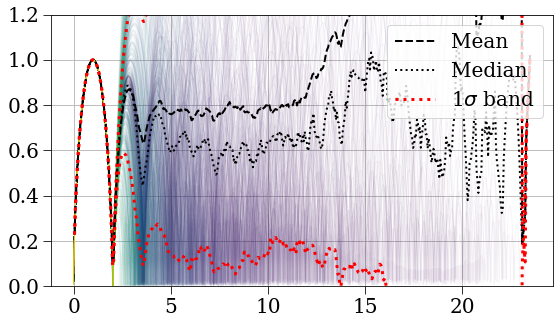

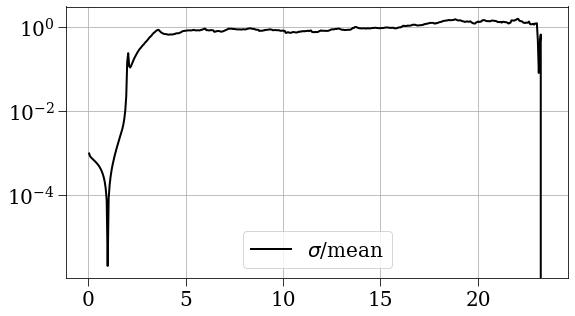

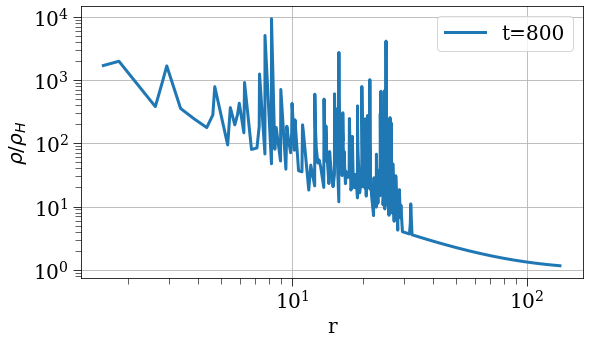

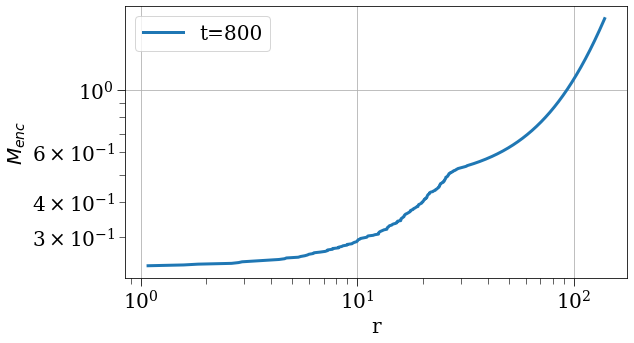

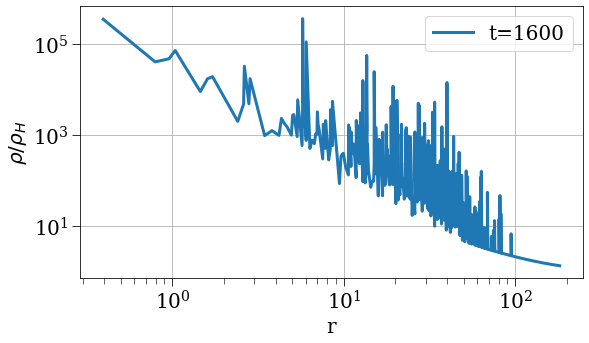

...

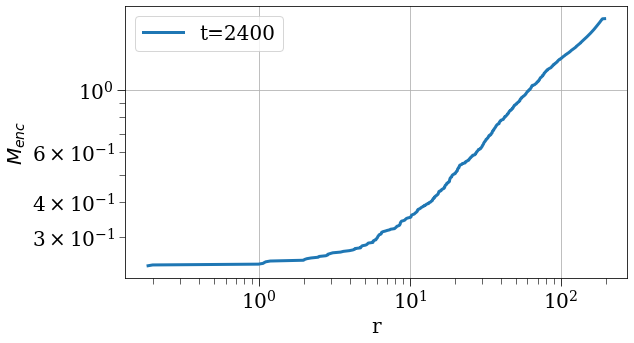

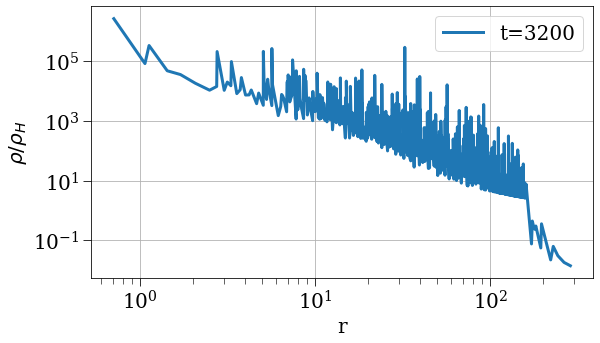

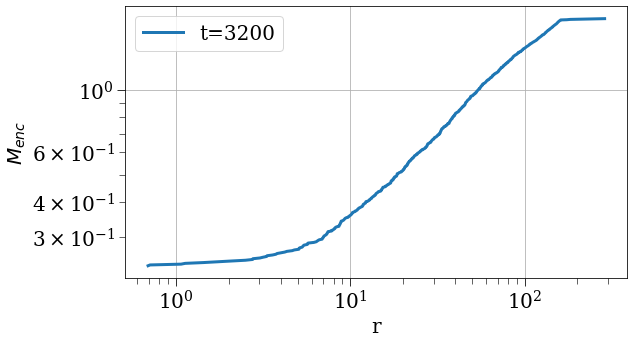

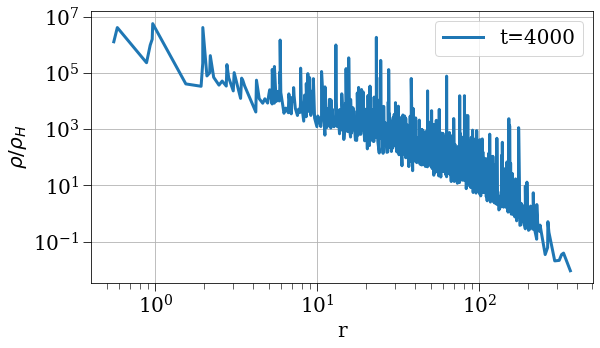

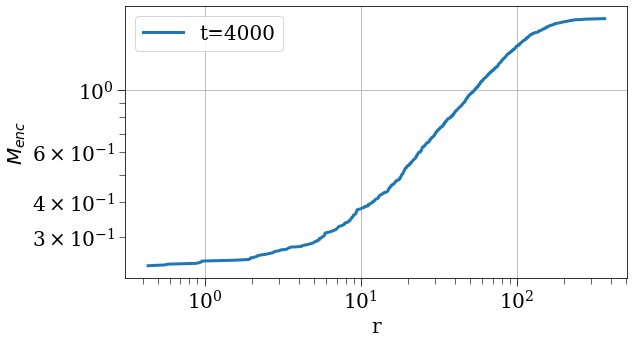

In [7]:
# softening 1e-5
params, results =load_simulation_data('/home/jsipple/one_d_spherical_collapse/one-d-spherical-collapse-of-fuzzy-dark-matter/7-31-11.h5')
pprint(params)
plot_results(results, params=params, sc=None)

In [6]:
import numpy as np
from scipy.interpolate import UnivariateSpline
import matplotlib.pyplot as plt

# Suppose r and rho are as above
r = np.linspace(0.1, 10.0, 500)
rho = np.array(1, 0.1, 0.01)  # your density values

# Fit a spline of degree k≥4 so you can take up to 3rd derivative
# s=0 forces interpolation (no smoothing), but you can set s>0 to regularize.
spline = UnivariateSpline(r, rho, k=5, s=0)

# Evaluate derivatives
rho1 = spline.derivative(n=1)(r)
rho2 = spline.derivative(n=2)(r)
rho3 = spline.derivative(n=3)(r)

# (Optional) Plot to check
plt.figure(figsize=(8, 6))
plt.plot(r, rho,   label=r'$\rho$')
plt.plot(r, rho1,  label=r'$\rho^{(1)}$')
plt.plot(r, rho2,  label=r'$\rho^{(2)}$')
plt.plot(r, rho3,  label=r'$\rho^{(3)}$')
plt.legend()
plt.xlabel('r')
plt.ylabel('derivatives')
plt.show()

TypeError: array() takes from 1 to 2 positional arguments but 3 were given

### cosmological units

In [44]:
from colossus.cosmology import cosmology
import numpy as np
import astropy.units as u

cosmo = cosmology.setCosmology('planck18')
little_h = cosmo.h
print(little_h)

def M_to_R(M, z):
    rho = cosmo.rho_m(z)
    return (3*M/(4*np.pi*rho))**(1/3)

def R_to_M(R, z):
    rho = cosmo.rho_m(z)
    return 4/3 * np.pi * rho * R**3

M = 1e10 * little_h
print(f'{M:.2e}', 'M_sol/h')
z = 499
rho = cosmo.rho_m(z)
print(f'{rho:.2e}', 'M_sol h^2 kpc^3')
R = M_to_R(M, z) # in physical kpc/h
R = R/1000 # in physical Mpc/h
R = R * (1+z) # in comoving Mpc/h
print(f'{R:.2e}', 'comoving Mpc/h')
sigma = cosmo.sigma(R=R, z=z)
print(sigma, 'dimensionless')


0.6766
6.77e+09 M_sol/h
1.08e+10 M_sol h^2 kpc^3
2.65e-01 comoving Mpc/h
0.01090775130701031 dimensionless


In [13]:
import pyccl as ccl
import numpy as np
import matplotlib.pyplot as plt

# define a cosmology (Planck18-like parameters)
cosmo = ccl.Cosmology(
    Omega_c=0.31-0.049,    # CDM density
    Omega_b=0.049,    # baryon density
    h=0.677,
    sigma8=0.818,
    n_s=0.96
)

Mvals = 1e9
z = 100
a = 1.0 / (1.0 + z)

sig = ccl.sigmaM(cosmo, Mvals, a)
print(sig)

dir(cosmo)

0.06238526124481427


['__class__',
 '__del__',
 '__delattr__',
 '__dict__',
 '__dir__',
 '__doc__',
 '__enter__',
 '__eq__',
 '__exit__',
 '__format__',
 '__ge__',
 '__getattribute__',
 '__getitem__',
 '__getstate__',
 '__gt__',
 '__hash__',
 '__init__',
 '__init_subclass__',
 '__le__',
 '__lt__',
 '__module__',
 '__ne__',
 '__new__',
 '__reduce__',
 '__reduce_ex__',
 '__repr__',
 '__setattr__',
 '__setitem__',
 '__setstate__',
 '__sizeof__',
 '__str__',
 '__subclasshook__',
 '__weakref__',
 '_background_on_input',
 '_build_config',
 '_build_cosmo',
 '_build_parameters',
 '_compute_linear_power_from_arrays',
 '_compute_linear_power_internal',
 '_config',
 '_config_init_kwargs',
 '_get_halo_model_nonlin_power',
 '_linear_power_on_input',
 '_params',
 '_params_init_kwargs',
 '_set_background_from_arrays',
 '_set_linear_power_from_arrays',
 'compute_distances',
 'compute_growth',
 'compute_linear_power',
 'compute_nonlin_power',
 'compute_sigma',
 'cosmo',
 'has_distances',
 'has_growth',
 'has_linear_power',

AttributeError: module 'pyccl' has no attribute '__version'